# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **2**, **4** and **6**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $50$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[117495.50135958  95611.25879778 123396.80896711 163945.61903468
  92681.20263534  92681.69654331 166962.85594269 128287.52178985
  85865.50347172 119257.05562057  86034.4775969   85969.93480342
 108170.57813688  53738.68354952  57126.84793488  83317.25550298
  71981.73815777 110738.61693473  74472.65917597  63227.95366503
 160920.31283036  92933.55858926 102216.11620354  62973.06639424
  83802.88617593 103666.06970946  68824.92112422 112969.63603961
  82286.50855935  90966.24299436  82257.98971196 182437.27830573
  99562.84804397  70940.73323924 130603.02513683  67282.02216372
 107014.65789057  52935.55780

Omni_P_RQi ================== 0.10459019288879436
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 95611.25879777755, 'S': 10000, 'W': 10000, 'P': 0.10459019288879436, 'dP': 0}, 'j': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086287}, 'k': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086287}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.10459019288879452
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 95611.25879777755, 'S': 10000, 'W': 10000, 'P': 0.10459019288879452, 'dP': 0}, 'j': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086305}, 'k': {'R': 87237.2766009738, 'S': 10000, 'W': 10000, 'P': 0.11462989664086305}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.10459019288879445
Initial Q HDX: 20000
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.06099583544153562
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 163945.61903467937, 'S': 10000, 'W': 10000, 'P': 0.06099583544153562, 'dP': 0}, 'j': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444682}, 'k': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444682}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.06099583544153576
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 163945.61903467937, 'S': 10000, 'W': 10000, 'P': 0.06099583544153576, 'dP': 0}, 'j': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444712}, 'k': {'R': 77073.28511100917, 'S': 10000, 'W': 10000, 'P': 0.12974664289444712}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.060995835441535605
Initial Q HDX: 19999.99999999998
config_init_state  

Omni_P_RQi ================== 0.10789616907073446
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92681.69654331479, 'S': 10000, 'W': 10000, 'P': 0.10789616907073446, 'dP': 0}, 'j': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.08770844320455154}, 'k': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.08770844320455154}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.10789616907073442
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 92681.69654331479, 'S': 10000, 'W': 10000, 'P': 0.10789616907073442, 'dP': 0}, 'j': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.0877084432045515}, 'k': {'R': 114014.10895731255, 'S': 10000, 'W': 10000, 'P': 0.0877084432045515}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.10789616907073465
Initial Q HDX: 20000.00000000003
config_init_state  <

Omni_P_RQi ================== 0.07794990393829036
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 128287.52178984831, 'S': 10000, 'W': 10000, 'P': 0.07794990393829036, 'dP': 0}, 'j': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334763}, 'k': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334763}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.07794990393829031
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 128287.52178984831, 'S': 10000, 'W': 10000, 'P': 0.07794990393829031, 'dP': 0}, 'j': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334756}, 'k': {'R': 105830.30288521064, 'S': 10000, 'W': 10000, 'P': 0.09449089464334756}}}
config_param a value =============  1
Omni_P_RQi ================== 0.0779499039382906
Initial Q HDX: 20000.000000000076
config_init_state  <class 'mode

Omni_P_RQi ================== 0.083852481079325
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 119257.05562057192, 'S': 10000, 'W': 10000, 'P': 0.083852481079325, 'dP': 0}, 'j': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084868}, 'k': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084868}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.08385248107932479
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 119257.05562057192, 'S': 10000, 'W': 10000, 'P': 0.08385248107932479, 'dP': 0}, 'j': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084843}, 'k': {'R': 97612.50149635863, 'S': 10000, 'W': 10000, 'P': 0.10244589419084843}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.08385248107932491
Initial Q HDX: 20000.000000000015
config_init_state  <clas

Omni_P_RQi ================== 0.11631973460101463
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 85969.9348034171, 'S': 10000, 'W': 10000, 'P': 0.11631973460101463, 'dP': 0}, 'j': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203545}, 'k': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203545}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11631973460101455
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 85969.9348034171, 'S': 10000, 'W': 10000, 'P': 0.11631973460101455, 'dP': 0}, 'j': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203538}, 'k': {'R': 99143.07131612096, 'S': 10000, 'W': 10000, 'P': 0.10086433542203538}}}
config_param a value =============  1
Omni_P_RQi ================== 0.116319734601015
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.a

config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 53738.683549520036, 'S': 10000, 'W': 10000, 'P': 0.1860856898510553, 'dP': 0}, 'j': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853129}, 'k': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853129}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.18608568985105572
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 53738.683549520036, 'S': 10000, 'W': 10000, 'P': 0.18608568985105572, 'dP': 0}, 'j': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853139}, 'k': {'R': 222454.13679694067, 'S': 10000, 'W': 10000, 'P': 0.04495308625853139}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.18608568985105525
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 53738.683549520036, 

Omni_P_RQi ================== 0.17504904193909085
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 57126.847934875026, 'S': 10000, 'W': 10000, 'P': 0.17504904193909085, 'dP': 0}, 'j': {'R': 93947.03753224776, 'S': 10000, 'W': 10000, 'P': 0.10644295192988344}, 'k': {'R': 93947.03753224776, 'S': 10000, 'W': 10000, 'P': 0.10644295192988344}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.17504904193909102
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 57126.847934875026, 'S': 10000, 'W': 10000, 'P': 0.17504904193909102, 'dP': 0}, 'j': {'R': 93947.03753224776, 'S': 10000, 'W': 10000, 'P': 0.10644295192988354}, 'k': {'R': 93947.03753224776, 'S': 10000, 'W': 10000, 'P': 0.10644295192988354}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.12002315654338673
Initial Q HDX: 19999.999999999996
config_init_state  <

Omni_P_RQi ================== 0.13892412514521238
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 71981.73815777064, 'S': 10000, 'W': 10000, 'P': 0.13892412514521238, 'dP': 0}, 'j': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938602}, 'k': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938602}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.1389241251452119
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 71981.73815777064, 'S': 10000, 'W': 10000, 'P': 0.1389241251452119, 'dP': 0}, 'j': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938567}, 'k': {'R': 98879.60449673777, 'S': 10000, 'W': 10000, 'P': 0.10113309059938567}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.13892412514521185
Initial Q HDX: 20000.0
config_init_state  <class 'model.

Omni_P_RQi ================== 0.13427746653132264
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 74472.65917597068, 'S': 10000, 'W': 10000, 'P': 0.13427746653132264, 'dP': 0}, 'j': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869354}, 'k': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869354}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.1342774665313227
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 74472.65917597068, 'S': 10000, 'W': 10000, 'P': 0.1342774665313227, 'dP': 0}, 'j': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869357}, 'k': {'R': 144911.36733928483, 'S': 10000, 'W': 10000, 'P': 0.06900769886869357}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.1342774665313228
Initial Q HDX: 20000.000000000022
config_init_state  <class 'mode

Omni_P_RQi ================== 0.062142558786485114
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 160920.31283035706, 'S': 10000, 'W': 10000, 'P': 0.062142558786485114, 'dP': 0}, 'j': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196505}, 'k': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.07735512832196505}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.062142558786484905
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 160920.31283035706, 'S': 10000, 'W': 10000, 'P': 0.062142558786484905, 'dP': 0}, 'j': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.0773551283219648}, 'k': {'R': 129273.91133498424, 'S': 10000, 'W': 10000, 'P': 0.0773551283219648}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.06214255878648488
Initial Q HDX: 20000.0
config_init_state  <cla

Omni_P_RQi ================== 0.0978319307308422
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 102216.11620353562, 'S': 10000, 'W': 10000, 'P': 0.0978319307308422, 'dP': 0}, 'j': {'R': 157670.4639355583, 'S': 10000, 'W': 10000, 'P': 0.06342341964622572}, 'k': {'R': 157670.4639355583, 'S': 10000, 'W': 10000, 'P': 0.06342341964622572}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.15879804768273365
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 62973.066394236994, 'S': 10000, 'W': 10000, 'P': 0.15879804768273365, 'dP': 0}, 'j': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.1576221971067703}, 'k': {'R': 63442.84106905442, 'S': 10000, 'W': 10000, 'P': 0.1576221971067703}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.15879804768273356
Initial Q HDX: 19999.999999999985
config_init_state  <clas

Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83802.88617592517, 'S': 10000, 'W': 10000, 'P': 0.11932763245179008, 'dP': 0}, 'j': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654888}, 'k': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.08265543420654888}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.11932763245179014
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 83802.88617592517, 'S': 10000, 'W': 10000, 'P': 0.11932763245179014, 'dP': 0}, 'j': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.0826554342065489}, 'k': {'R': 120984.18084660778, 'S': 10000, 'W': 10000, 'P': 0.0826554342065489}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.11932763245179025
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R':

Omni_P_RQi ================== 0.08851936104754675
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112969.63603960807, 'S': 10000, 'W': 10000, 'P': 0.08851936104754675, 'dP': 0}, 'j': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402222}, 'k': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402222}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.08851936104754653
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112969.63603960807, 'S': 10000, 'W': 10000, 'P': 0.08851936104754653, 'dP': 0}, 'j': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402193}, 'k': {'R': 83208.87345698303, 'S': 10000, 'W': 10000, 'P': 0.12017949029402193}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.08851936104754667
Initial Q HDX: 20000.000000000015
config_init_state  <

Omni_P_RQi ================== 0.10993088942476857
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90966.24299436348, 'S': 10000, 'W': 10000, 'P': 0.10993088942476857, 'dP': 0}, 'j': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.1177536560223435}, 'k': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.1177536560223435}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10993088942476899
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90966.24299436348, 'S': 10000, 'W': 10000, 'P': 0.10993088942476899, 'dP': 0}, 'j': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.11775365602234394}, 'k': {'R': 84923.0532434808, 'S': 10000, 'W': 10000, 'P': 0.11775365602234394}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.10993088942476861
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.ass

Omni_P_RQi ================== 0.05481335883142139
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 182437.2783057327, 'S': 10000, 'W': 10000, 'P': 0.05481335883142139, 'dP': 0}, 'j': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979676}, 'k': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979676}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.05481335883142126
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 182437.2783057327, 'S': 10000, 'W': 10000, 'P': 0.05481335883142126, 'dP': 0}, 'j': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979653}, 'k': {'R': 102250.45421452184, 'S': 10000, 'W': 10000, 'P': 0.09779907655979653}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.05481335883142134
Initial Q HDX: 20000.000000000015
config_init_state 

Omni_P_RQi ================== 0.14096273809683263
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 70940.73323923821, 'S': 10000, 'W': 10000, 'P': 0.14096273809683263, 'dP': 0}, 'j': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477183}, 'k': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477183}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.14096273809683274
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 70940.73323923821, 'S': 10000, 'W': 10000, 'P': 0.14096273809683274, 'dP': 0}, 'j': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477183009}, 'k': {'R': 116616.98134039092, 'S': 10000, 'W': 10000, 'P': 0.08575080477183009}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.07656790483622375
Initial Q HDX: 19999.999999999996
config_init_state  <clas

Omni_P_RQi ================== 0.14862811310378352
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 67282.02216371568, 'S': 10000, 'W': 10000, 'P': 0.14862811310378352, 'dP': 0}, 'j': {'R': 165383.6300138332, 'S': 10000, 'W': 10000, 'P': 0.060465476535758546}, 'k': {'R': 165383.6300138332, 'S': 10000, 'W': 10000, 'P': 0.060465476535758546}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.14862811310378365
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 67282.02216371568, 'S': 10000, 'W': 10000, 'P': 0.14862811310378365, 'dP': 0}, 'j': {'R': 165383.6300138332, 'S': 10000, 'W': 10000, 'P': 0.0604654765357586}, 'k': {'R': 165383.6300138332, 'S': 10000, 'W': 10000, 'P': 0.0604654765357586}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.09344514290954399
Initial Q HDX: 19999.999999999996
config_init_state  <cl

Omni_P_RQi ================== 0.18890893785663812
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52935.55780610538, 'S': 10000, 'W': 10000, 'P': 0.18890893785663812, 'dP': 0}, 'j': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215883}, 'k': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215883}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.1889089378566375
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 52935.55780610538, 'S': 10000, 'W': 10000, 'P': 0.1889089378566375, 'dP': 0}, 'j': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215845}, 'k': {'R': 90073.97902636697, 'S': 10000, 'W': 10000, 'P': 0.11101985399215845}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.18890893785663743
Initial Q HDX: 20000.0
config_init_state  <class 'model.

Omni_P_RQi ================== 0.09380990403592895
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 106598.55270899786, 'S': 10000, 'W': 10000, 'P': 0.09380990403592895, 'dP': 0}, 'j': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.1491123334205225}, 'k': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.1491123334205225}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.09380990403592891
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 106598.55270899786, 'S': 10000, 'W': 10000, 'P': 0.09380990403592891, 'dP': 0}, 'j': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.14911233342052244}, 'k': {'R': 67063.53371721627, 'S': 10000, 'W': 10000, 'P': 0.14911233342052244}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09380990403592895
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model

Omni_P_RQi ================== 0.09458938570254448
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 105720.10723747619, 'S': 10000, 'W': 10000, 'P': 0.09458938570254448, 'dP': 0}, 'j': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.0654234658582906}, 'k': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.0654234658582906}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09458938570254453
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 105720.10723747619, 'S': 10000, 'W': 10000, 'P': 0.09458938570254453, 'dP': 0}, 'j': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.06542346585829065}, 'k': {'R': 152850.35527864468, 'S': 10000, 'W': 10000, 'P': 0.06542346585829065}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.09458938570254462
Initial Q HDX: 20000.000000000022
config_init_state  <class 'm

Omni_P_RQi ================== 0.11026717576809754
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90688.81949992987, 'S': 10000, 'W': 10000, 'P': 0.11026717576809754, 'dP': 0}, 'j': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.0941829678062749}, 'k': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.0941829678062749}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.11026717576809716
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90688.81949992987, 'S': 10000, 'W': 10000, 'P': 0.11026717576809716, 'dP': 0}, 'j': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.0941829678062746}, 'k': {'R': 106176.31014313601, 'S': 10000, 'W': 10000, 'P': 0.0941829678062746}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.11026717576809712
Initial Q HDX: 20000.0
config_init_state  <class 'mode

Omni_P_RQi ================== 0.12632102272898427
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898427, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850333}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.12632102272898432
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 79163.38693247065, 'S': 10000, 'W': 10000, 'P': 0.12632102272898432, 'dP': 0}, 'j': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850337}, 'k': {'R': 128888.06274237928, 'S': 10000, 'W': 10000, 'P': 0.07758670420850337}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.12632102272898443
Initial Q HDX: 20000.000000000022
config_init_state  <class 'm

Omni_P_RQi ================== 0.08944591558204189
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111799.40341521545, 'S': 10000, 'W': 10000, 'P': 0.08944591558204189, 'dP': 0}, 'j': {'R': 118461.57947979252, 'S': 10000, 'W': 10000, 'P': 0.0844155551860241}, 'k': {'R': 118461.57947979252, 'S': 10000, 'W': 10000, 'P': 0.0844155551860241}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.08944591558204182
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111799.40341521545, 'S': 10000, 'W': 10000, 'P': 0.08944591558204182, 'dP': 0}, 'j': {'R': 118461.57947979252, 'S': 10000, 'W': 10000, 'P': 0.08441555518602405}, 'k': {'R': 118461.57947979252, 'S': 10000, 'W': 10000, 'P': 0.08441555518602405}}}
config_param a value =============  1
Omni_P_RQi ================== 0.08944591558204217
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model

Omni_P_RQi ================== 0.09001486722058602
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111092.75954931429, 'S': 10000, 'W': 10000, 'P': 0.09001486722058602, 'dP': 0}, 'j': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523549}, 'k': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523549}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.09001486722058581
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 111092.75954931429, 'S': 10000, 'W': 10000, 'P': 0.09001486722058581, 'dP': 0}, 'j': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523526}, 'k': {'R': 108470.51372880352, 'S': 10000, 'W': 10000, 'P': 0.09219095269523526}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.09001486722058595
Initial Q HDX: 20000.000000000015
config_init_stat

Omni_P_RQi ================== 0.12457329089288874
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 80274.02927484873, 'S': 10000, 'W': 10000, 'P': 0.12457329089288874, 'dP': 0}, 'j': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426667}, 'k': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426667}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.12457329089288868
Initial Q HDX: 19999.999999999985
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 80274.02927484873, 'S': 10000, 'W': 10000, 'P': 0.12457329089288868, 'dP': 0}, 'j': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426662}, 'k': {'R': 80193.22430095519, 'S': 10000, 'W': 10000, 'P': 0.12469881448426662}}}
config_param a value =============  0.92
Omni_P_RQi ================== 0.12457329089288896
Initial Q HDX: 20000.00000000003
config_init_state  <cl

config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 135294.9283846686, 'S': 10000, 'W': 10000, 'P': 0.07391260056377096, 'dP': 0}, 'j': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.1260960030489884}, 'k': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.1260960030489884}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.0739126005637709
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 135294.9283846686, 'S': 10000, 'W': 10000, 'P': 0.0739126005637709, 'dP': 0}, 'j': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.12609600304898833}, 'k': {'R': 79304.65485186709, 'S': 10000, 'W': 10000, 'P': 0.12609600304898833}}}
config_param a value =============  1
Omni_P_RQi ================== 0.07391260056377118
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 135294.9283846686, 'S': 10000, 'W': 10000, 

Omni_P_RQi ================== 0.11055778341106173
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90450.43859842316, 'S': 10000, 'W': 10000, 'P': 0.11055778341106173, 'dP': 0}, 'j': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.08574411120321745}, 'k': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.08574411120321745}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.11055778341106166
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90450.43859842316, 'S': 10000, 'W': 10000, 'P': 0.11055778341106166, 'dP': 0}, 'j': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.0857441112032174}, 'k': {'R': 116626.08498325384, 'S': 10000, 'W': 10000, 'P': 0.0857441112032174}}}
config_param a value =============  1
Omni_P_RQi ================== 0.11055778341106208
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.07285820950341838
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 137252.8925450854, 'S': 10000, 'W': 10000, 'P': 0.07285820950341838, 'dP': 0}, 'j': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342536}, 'k': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342536}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.07285820950341836
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 137252.8925450854, 'S': 10000, 'W': 10000, 'P': 0.07285820950341836, 'dP': 0}, 'j': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342531}, 'k': {'R': 123752.39939970698, 'S': 10000, 'W': 10000, 'P': 0.08080651404342531}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.07285820950341838
Initial Q HDX: 20000.00000000001
config_init_state  <class 'm

Omni_P_RQi ================== 0.14320520531082515
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 69829.8639235572, 'S': 10000, 'W': 10000, 'P': 0.14320520531082515, 'dP': 0}, 'j': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265448}, 'k': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265448}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.14320520531082537
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 69829.8639235572, 'S': 10000, 'W': 10000, 'P': 0.14320520531082537, 'dP': 0}, 'j': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265457}, 'k': {'R': 145655.1763336588, 'S': 10000, 'W': 10000, 'P': 0.06865530118265457}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.14320520531082526
Initial Q HDX: 20000
config_init_state  <class 'model.par

Omni_P_RQi ================== 0.07681731856416332
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130178.97769559965, 'S': 10000, 'W': 10000, 'P': 0.07681731856416332, 'dP': 0}, 'j': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546322}, 'k': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546322}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.07681731856416345
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 130178.97769559965, 'S': 10000, 'W': 10000, 'P': 0.07681731856416345, 'dP': 0}, 'j': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546333}, 'k': {'R': 136711.81710391006, 'S': 10000, 'W': 10000, 'P': 0.07314656634546333}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.07681731856416339
Initial Q HDX: 20000
config_init_state  <class 'm

Omni_P_RQi ================== 0.10236492824075569
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97689.70849547858, 'S': 10000, 'W': 10000, 'P': 0.10236492824075569, 'dP': 0}, 'j': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.07657995351932964}, 'k': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.07657995351932964}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.10236492824075562
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97689.70849547858, 'S': 10000, 'W': 10000, 'P': 0.10236492824075562, 'dP': 0}, 'j': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.0765799535193296}, 'k': {'R': 130582.47675060149, 'S': 10000, 'W': 10000, 'P': 0.0765799535193296}}}
config_param a value =============  1
Omni_P_RQi ================== 0.102364928240756
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.par

Omni_P_RQi ================== 0.08892432431275323
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112455.16991311932, 'S': 10000, 'W': 10000, 'P': 0.08892432431275323, 'dP': 0}, 'j': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106329}, 'k': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106329}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.08892432431275336
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112455.16991311932, 'S': 10000, 'W': 10000, 'P': 0.08892432431275336, 'dP': 0}, 'j': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106345}, 'k': {'R': 92343.83606496245, 'S': 10000, 'W': 10000, 'P': 0.10829093122106345}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.0889243243127533
Initial Q HDX: 20000
config_init_state  <class 'model.

Omni_P_RQi ================== 0.08893126410108008
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 112446.39442698039, 'S': 10000, 'W': 10000, 'P': 0.08893126410108008, 'dP': 0}, 'j': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465396}, 'k': {'R': 74921.44508323348, 'S': 10000, 'W': 10000, 'P': 0.13347313294465396}}}
config_param a value =============  1.1
Omni_P_RQi ================== 0.06069944287371311
Initial Q HDX: 19999.999999999996
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 164746.1578981092, 'S': 10000, 'W': 10000, 'P': 0.06069944287371311, 'dP': 0}, 'j': {'R': 76735.46625776659, 'S': 10000, 'W': 10000, 'P': 0.1303178372098296}, 'k': {'R': 76735.46625776659, 'S': 10000, 'W': 10000, 'P': 0.1303178372098296}}}
config_param a value =============  0.9
Omni_P_RQi ================== 0.06069944287371308
Initial Q HDX: 19999.999999999985
config_init_state  <cla

Omni_P_RQi ================== 0.10116967542338427
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98843.84780470106, 'S': 10000, 'W': 10000, 'P': 0.10116967542338427, 'dP': 0}, 'j': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614738}, 'k': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614738}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.10116967542338433
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98843.84780470106, 'S': 10000, 'W': 10000, 'P': 0.10116967542338433, 'dP': 0}, 'j': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614743}, 'k': {'R': 97528.39074057277, 'S': 10000, 'W': 10000, 'P': 0.10253424591614743}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.10116967542338441
Initial Q HDX: 20000.000000000022
config_init_state  <class 'model

Omni_P_RQi ================== 0.23404670864967486
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 42726.51411205347, 'S': 10000, 'W': 10000, 'P': 0.23404670864967486, 'dP': 0}, 'j': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.0914103153936439}, 'k': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.0914103153936439}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.23404670864967497
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 42726.51411205347, 'S': 10000, 'W': 10000, 'P': 0.23404670864967497, 'dP': 0}, 'j': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.09141031539364394}, 'k': {'R': 109396.84385658882, 'S': 10000, 'W': 10000, 'P': 0.09141031539364394}}}
config_param a value =============  1.08
Omni_P_RQi ================== 0.2340467086496752
Initial Q HDX: 20000.000000000022
config_init_state  <class 'mode

Omni_P_RQi ================== 0.11019216903914952
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914952, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306456}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306456}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.11019216903914916
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 90750.55049009151, 'S': 10000, 'W': 10000, 'P': 0.11019216903914916, 'dP': 0}, 'j': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306435}, 'k': {'R': 160288.76163240927, 'S': 10000, 'W': 10000, 'P': 0.06238740569306435}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.11019216903914911
Initial Q HDX: 20000.0
config_init_state  <class '

Omni_P_RQi ================== 0.10739075617557278
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 93117.88422134794, 'S': 10000, 'W': 10000, 'P': 0.10739075617557278, 'dP': 0}, 'j': {'R': 122517.92318939857, 'S': 10000, 'W': 10000, 'P': 0.0816207109921472}, 'k': {'R': 122517.92318939857, 'S': 10000, 'W': 10000, 'P': 0.0816207109921472}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.10739075617557295
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 93117.88422134794, 'S': 10000, 'W': 10000, 'P': 0.10739075617557295, 'dP': 0}, 'j': {'R': 122517.92318939857, 'S': 10000, 'W': 10000, 'P': 0.08162071099214734}, 'k': {'R': 122517.92318939857, 'S': 10000, 'W': 10000, 'P': 0.08162071099214734}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.10739075617557288
Initial Q HDX: 20000
config_init_state  <class 'model

Omni_P_RQi ================== 0.06189604918936017
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 161561.20028609165, 'S': 10000, 'W': 10000, 'P': 0.06189604918936017, 'dP': 0}, 'j': {'R': 70637.85158869908, 'S': 10000, 'W': 10000, 'P': 0.1415671594632677}, 'k': {'R': 70637.85158869908, 'S': 10000, 'W': 10000, 'P': 0.1415671594632677}}}
config_param a value =============  1
Omni_P_RQi ================== 0.061896049189360404
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 161561.20028609165, 'S': 10000, 'W': 10000, 'P': 0.061896049189360404, 'dP': 0}, 'j': {'R': 70637.85158869908, 'S': 10000, 'W': 10000, 'P': 0.14156715946326823}, 'k': {'R': 70637.85158869908, 'S': 10000, 'W': 10000, 'P': 0.14156715946326823}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.061896049189360196
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.

Omni_P_RQi ================== 0.13000870704778655
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 76917.92516884551, 'S': 10000, 'W': 10000, 'P': 0.13000870704778655, 'dP': 0}, 'j': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314739}, 'k': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314739}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.1300087070477865
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 76917.92516884551, 'S': 10000, 'W': 10000, 'P': 0.1300087070477865, 'dP': 0}, 'j': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314734}, 'k': {'R': 93003.37329919385, 'S': 10000, 'W': 10000, 'P': 0.10752298164314734}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.13000870704778655
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.p

config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 134599.42759768563, 'S': 10000, 'W': 10000, 'P': 0.07429452099818551, 'dP': 0}, 'j': {'R': 116603.55162645421, 'S': 10000, 'W': 10000, 'P': 0.0857606810471395}, 'k': {'R': 116603.55162645421, 'S': 10000, 'W': 10000, 'P': 0.0857606810471395}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.07429452099818547
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 134599.42759768563, 'S': 10000, 'W': 10000, 'P': 0.07429452099818547, 'dP': 0}, 'j': {'R': 116603.55162645421, 'S': 10000, 'W': 10000, 'P': 0.08576068104713946}, 'k': {'R': 116603.55162645421, 'S': 10000, 'W': 10000, 'P': 0.08576068104713946}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.07429452099818551
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 134599.42759768563, 'S': 10000,

Omni_P_RQi ================== 0.08465356727260653
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 118128.5127394265, 'S': 10000, 'W': 10000, 'P': 0.08465356727260653, 'dP': 0}, 'j': {'R': 61158.05716418927, 'S': 10000, 'W': 10000, 'P': 0.16351075334445778}, 'k': {'R': 61158.05716418927, 'S': 10000, 'W': 10000, 'P': 0.16351075334445778}}}
config_param a value =============  1
Omni_P_RQi ================== 0.08465356727260685
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 118128.5127394265, 'S': 10000, 'W': 10000, 'P': 0.08465356727260685, 'dP': 0}, 'j': {'R': 61158.05716418927, 'S': 10000, 'W': 10000, 'P': 0.1635107533444584}, 'k': {'R': 61158.05716418927, 'S': 10000, 'W': 10000, 'P': 0.1635107533444584}}}
config_param a value =============  1.02
Omni_P_RQi ================== 0.08465356727260658
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts

Omni_P_RQi ================== 0.0730215754632614
Initial Q HDX: 20000.000000000015
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 136945.82644318874, 'S': 10000, 'W': 10000, 'P': 0.0730215754632614, 'dP': 0}, 'j': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.0757311269407423}, 'k': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.0757311269407423}}}
config_param a value =============  0.98
Omni_P_RQi ================== 0.07302157546326137
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 136945.82644318874, 'S': 10000, 'W': 10000, 'P': 0.07302157546326137, 'dP': 0}, 'j': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}, 'k': {'R': 132046.10051326393, 'S': 10000, 'W': 10000, 'P': 0.07573112694074224}}}
config_param a value =============  1
Omni_P_RQi ================== 0.07302157546326164
Initial Q HDX: 20000.000000000076
config_init_state  <class 'model.p

Omni_P_RQi ================== 0.11122186327436429
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 89910.3800781669, 'S': 10000, 'W': 10000, 'P': 0.11122186327436429, 'dP': 0}, 'j': {'R': 66740.52171809219, 'S': 10000, 'W': 10000, 'P': 0.14983401002226776}, 'k': {'R': 66740.52171809219, 'S': 10000, 'W': 10000, 'P': 0.14983401002226776}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.11122186327436423
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 89910.3800781669, 'S': 10000, 'W': 10000, 'P': 0.11122186327436423, 'dP': 0}, 'j': {'R': 66740.52171809219, 'S': 10000, 'W': 10000, 'P': 0.1498340100222677}, 'k': {'R': 66740.52171809219, 'S': 10000, 'W': 10000, 'P': 0.1498340100222677}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.11122186327436429
Initial Q HDX: 20000.00000000001
config_init_state  <class 'model.par

Omni_P_RQi ================== 0.0908356348129923
Initial Q HDX: 20000.00000000003
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 110088.95375242874, 'S': 10000, 'W': 10000, 'P': 0.0908356348129923, 'dP': 0}, 'j': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067568}, 'k': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067568}}}
config_param a value =============  0.94
Omni_P_RQi ================== 0.09083563481299207
Initial Q HDX: 19999.99999999998
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 110088.95375242874, 'S': 10000, 'W': 10000, 'P': 0.09083563481299207, 'dP': 0}, 'j': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067534}, 'k': {'R': 75059.1436925547, 'S': 10000, 'W': 10000, 'P': 0.13322827184067534}}}
config_param a value =============  0.96
Omni_P_RQi ================== 0.09083563481299223
Initial Q HDX: 20000.000000000015
config_init_state  <class 

Omni_P_RQi ================== 0.09983415852476973
Initial Q HDX: 20000.000000000007
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100166.11696605742, 'S': 10000, 'W': 10000, 'P': 0.09983415852476973, 'dP': 0}, 'j': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869426}, 'k': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869426}}}
config_param a value =============  1.04
Omni_P_RQi ================== 0.09983415852476969
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100166.11696605742, 'S': 10000, 'W': 10000, 'P': 0.09983415852476969, 'dP': 0}, 'j': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869421}, 'k': {'R': 101907.37572170106, 'S': 10000, 'W': 10000, 'P': 0.09812832416869421}}}
config_param a value =============  1.06
Omni_P_RQi ================== 0.09983415852476973
Initial Q HDX: 20000.00000000001
config_init_state  <class 

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 11, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 5, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 6, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 7, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 8, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 13, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 16, 16, 16, 16,

addliq - Sq delta Sq 5381.287001157489
addliq - Sq delta S 5381.28700115749
POOL ADD LIQUIDITY Timestep ===  10 delta W  5378.893208416951
addliq - Sq delta Sqaddliq - Sq delta Sq 5377.616870494515
addliq - Sq delta S 5377.616870494514
POOL ADD LIQUIDITY Timestep ===  10 delta W  5375.207603686913
 3943.3074477994483
addliq - Sq delta Sq 5183.793242795637
addliq - Sq delta S 5183.793242795637
POOL ADD LIQUIDITY Timestep ===  10 delta W  5181.052543996537
addliq - Sq delta Saddliq - Sq delta Sqaddliq - Sq delta Sq 4235.248464878559
addliq - Sq delta S 4235.24846487856
POOL ADD LIQUIDITY Timestep ===  10 delta W  4234.45353896878
 3943.3074477994473
POOL ADD LIQUIDITY Timestep ===  10 delta W  3942.1709829431425
 4230.743088629965
addliq - Sq delta Sqaddliq - Sq delta S  4034.950136858248
addliq - Sq delta S 4034.9501368582487
POOL ADD LIQUIDITY Timestep ===  10 delta W  4034.3624971448853
4230.743088629965
POOL ADD LIQUIDITY Timestep ===  10 delta W  4228.220461988833
154255.0155229.0
P

154255.0
154051.0POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  4476.310360029896 delta S  4255
POOL REMOVE LIQUIDITY share fraction of pool = 0.17135227647763132
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2452980970216152
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2452980970216152
154255.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4237.80042909238 delta S  4051
POOL REMOVE LIQUIDITY share fraction of pool = 0.16703512476980792
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2464124932364935
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2464124932364935
154051.0
154255.0
addliq - Sq delta SqPOOL REMOVE LIQUIDITY Timestep ===   5194.583607131102
addliq - Sq delta S 5194.583607131103
POOL ADD LIQUIDITY Timestep ===  10 delta W  5191.8200460354365
154051.0
POOL REMOVE LIQUIDITY Timestep ===  90 90delta W  4629.930036278085 delta S  4255
POOL REMOVE LIQUIDITY share fraction of pool = 0.17273585196956326
POOL REMOVE LIQUIDITY share fraction of reserve = 0.237

addliq - Sq delta Sq155394.0addliq - Sq delta Sq 2954.5027123893224
addliq - Sq delta S 2954.502712389323
POOL ADD LIQUIDITY Timestep ===  10 delta W  2953.9960467081937
 
2846.2556033587393
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta S addliq - Sq delta Sq 902846.255603358739  
delta W  5439.09041256295 delta S  5394
POOL REMOVE LIQUIDITY share fraction of pool = 0.21228198966636228
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3371947072277445
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3371947072277445
3182.2892318287245POOL ADD LIQUIDITY Timestep === 155394.0

 10 delta W addliq - Sq delta S 3182.2892318287245
POOL ADD LIQUIDITY Timestep ===  10 delta W  3181.6439542116705
 2847.301868310782
addliq - Sq delta Sq 5507.9364399180995
addliq - Sq delta S 5507.936439918099
POOL ADD LIQUIDITY Timestep ===  10 delta W  5505.371510171012
155394.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  addliq - Sq delta Sq5619.550124888549  delta S 4881.324095511777
addliq - Sq

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5576.28181583516 delta S  5394
POOL REMOVE LIQUIDITY share fraction of pool = 0.2122338890122691
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31783335343198654
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31783335343198654
155394.0
addliq - Sq delta Sqaddliq - Sq delta Sq  2953.235858541323
addliq - Sq delta S 2953.2358585413235
POOL ADD LIQUIDITY Timestep ===  10 delta W  2952.7374779275838
5206.896500797028
addliq - Sq delta S 5206.896500797027
POOL ADD LIQUIDITY Timestep ===  10 delta W  5205.431232350514
addliq - Sq delta Sq 4460.536203456665
addliq - Sq delta S 4460.536203456664
POOL ADD LIQUIDITY Timestep ===  10 delta W  4477.744784813158
addliq - Sq delta Sq 5809.698999005736
addliq - Sq delta S 5809.698999005736
POOL ADD LIQUIDITY Timestep ===  10 delta W  5811.745249443963
153049.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3296.677855923082 delta S  3049
POOL REMOVE LIQUIDITY share fraction of pool = 0.13285162

152994.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3020.498568452238 delta S  2994
POOL REMOVE LIQUIDITY share fraction of pool = 0.13045899011935988
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2201910314134757
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2201910314134757
152994.0
152994.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2984.4425361479575 delta S  2994
POOL REMOVE LIQUIDITY share fraction of pool = 0.13009224318118398
POOL REMOVE LIQUIDITY share fraction of reserve = 0.23279905135185014
POOL REMOVE LIQUIDITY weight fraction of pool = 0.23279905135185014
152994.0
153897.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4018.0051168986624 delta S  3897
POOL REMOVE LIQUIDITY share fraction of pool = 0.16220294973331778
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24804140088534182
POOL REMOVE LIQUIDITY weight fraction of pool = 0.24804140088534182
153897.0
addliq - Sq delta Sq 2946.910138613187
addliq - Sq delta S 2946.910138613187
POOL ADD LIQUI

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4016.4482413881633 delta S  3897
POOL REMOVE LIQUIDITY share fraction of pool = 0.16478819411441517
POOL REMOVE LIQUIDITY share fraction of reserve = 0.25784431442452427
POOL REMOVE LIQUIDITY weight fraction of pool = 0.25784431442452427
153897.0
155823.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5818.6027034340195 delta S  5823
POOL REMOVE LIQUIDITY share fraction of pool = 0.22344712308869452
POOL REMOVE LIQUIDITY share fraction of reserve = 0.355597061304306
POOL REMOVE LIQUIDITY weight fraction of pool = 0.355597061304306
155823.0
155823.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6102.9771753904115 delta S  5823
POOL REMOVE LIQUIDITY share fraction of pool = 0.2273923266647302
POOL REMOVE LIQUIDITY share fraction of reserve = 0.333240457890417
POOL REMOVE LIQUIDITY weight fraction of pool = 0.333240457890417
155823.0
155823.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5893.791262425497 delta S  5823
POOL REMOVE LIQUI

155815.0
POOL REMOVE LIQUIDITY Timestep === 155815.0 
90 delta W  5952.989104914733 delta S  5815
POOL REMOVE LIQUIDITY share fraction of pool = 0.2248902800169876
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3406226324784372
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3406226324784372
POOL REMOVE LIQUIDITY Timestep ===  155815.090 delta W  6049.106812329299 delta S  5815
POOL REMOVE LIQUIDITY share fraction of pool = 0.23104032224061952
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3497889671883789
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3497889671883789
155815.0

154192.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4433.62887537588 delta S  4192
POOL REMOVE LIQUIDITY share fraction of pool = 0.17435720248651668
POOL REMOVE LIQUIDITY share fraction of reserve = 0.25575375917663484
POOL REMOVE LIQUIDITY weight fraction of pool = 0.25575375917663484
154192.0
155811.0
POOL REMOVE LIQUIDITY Timestep ===  90addliq - Sq delta Sq 6011.611277778771
addliq - Sq

POOL REMOVE LIQUIDITY Timestep ===  90addliq - Sq delta Sq  delta W 4570.446238507483 
addliq - Sq delta S 4570.446238507485
POOL ADD LIQUIDITY Timestep ===  10 delta W  4568.661768641213
5959.207087199237 delta S  5815
POOL REMOVE LIQUIDITY share fraction of pool = 0.22254904433728998
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3322009676351821
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3322009676351821
155815.0
addliq - Sq delta Sq 4413.820781390507
addliq - Sq delta S 4413.820781390507
POOL ADD LIQUIDITY Timestep ===  10 delta W  4413.326762653533
addliq - Sq delta Sq 7394.969620568581
addliq - Sq delta S 7394.969620568581
POOL ADD LIQUIDITY Timestep ===  10 delta W  7434.367523567871
addliq - Sq delta Sq 7390.697986489595
addliq - Sq delta S 7390.697986489596
POOL ADD LIQUIDITY Timestep ===  10 delta W  7430.204113143905
addliq - Sq delta Sq 8807.497400305481
addliq - Sq delta S 8807.497400305483
POOL ADD LIQUIDITY Timestep ===  10 delta W  8805.875853956082
addliq -

154622.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4822.267552950276 delta S  4622
POOL REMOVE LIQUIDITY share fraction of pool = 0.18803750175453252
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2801392563035873
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2801392563035873
154622.0
154622.0addliq - Sq delta Sq 4399.909969365928
addliq - Sq delta S 4399.909969365928
POOL ADD LIQUIDITY Timestep ===  10 delta W  4399.527638620328

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4650.263439240528 delta S  4622
POOL REMOVE LIQUIDITY share fraction of pool = 0.18688152419058843
POOL REMOVE LIQUIDITY share fraction of reserve = 0.30144493568172415
POOL REMOVE LIQUIDITY weight fraction of pool = 0.30144493568172415
154622.0
159304.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  9121.013740766364 delta S  9304
POOL REMOVE LIQUIDITY share fraction of pool = 0.33163735703752034
POOL REMOVE LIQUIDITY share fraction of reserve = 0.584816769906369
POOL REMOVE LIQUIDITY weight fra

156946.0
156946.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7257.391690078369 delta S  6946
POOL REMOVE LIQUIDITY share fraction of pool = 0.2609441326480665
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3801799706431033
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3801799706431033
156946.0
156946.0
POOL REMOVE LIQUIDITY Timestep ===  addliq - Sq delta Sq 5772.591256285524
addliq - Sq delta S 5772.591256285524
POOL ADD LIQUIDITY Timestep ===  10 delta W  5770.848080207482
90 delta W  7174.014748820453 delta S  6946
POOL REMOVE LIQUIDITY share fraction of pool = 0.2584136375164217
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38007464337699737
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38007464337699737
156946.0
addliq - Sq delta Sq 5757.391036222949
addliq - Sq delta S 5757.391036222949
POOL ADD LIQUIDITY Timestep ===  10 delta W  5755.746656925608
addliq - Sq delta Sq 7219.903171601548
addliq - Sq delta S 7219.903171601548
POOL ADD LIQUIDITY Timestep === 

154515.0addliq - Sq delta Sq
 POOL REMOVE LIQUIDITY Timestep ===  7872.017634837086
addliq - Sq delta S 7872.017634837085
POOL ADD LIQUIDITY Timestep ===  10 delta W  7884.9697764620505
90 delta W  4929.97388390314 delta S  4515
POOL REMOVE LIQUIDITY share fraction of pool = 0.18165344028810326
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2489843559421212
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2489843559421212
154515.0
addliq - Sq delta Sq154515.0 
POOL REMOVE LIQUIDITY Timestep ===  5050.171139989276
90addliq - Sq delta S  5050.171139989276
POOL ADD LIQUIDITY Timestep === delta W  10 delta W  5055.058160684567
 5256.986868499528156001.0
 delta S  4515
POOL REMOVE LIQUIDITY share fraction of pool = 0.18615001375420132
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24254996175698904
POOL REMOVE LIQUIDITY weight fraction of pool = 0.24254996175698904
154515.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6358.110390686718 delta S  6001
POOL REMOVE LIQUIDITY share

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7976.5652975449875 delta S  7907
POOL REMOVE LIQUIDITY share fraction of pool = 0.28297742484708477
POOL REMOVE LIQUIDITY share fraction of reserve = 0.42824845337031003
POOL REMOVE LIQUIDITY weight fraction of pool = 0.42824845337031003
157907.0
addliq - Sq delta Sq 3026.23007180265
addliq - Sq delta S 3026.23007180265addliq - Sq delta Sq 7209.174741913293
addliq - Sq delta S 7209.174741913293
POOL ADD LIQUIDITY Timestep ===  10 delta W  7211.622536989295

POOL ADD LIQUIDITY Timestep ===  10 delta W  3025.880247125594
addliq - Sq delta Sq 6887.189792619852
addliq - Sq delta S 6887.189792619853
POOL ADD LIQUIDITY Timestep ===  10 delta W  addliq - Sq delta Sq 3107.0983959955474
addliq - Sq delta S 3107.0983959955474
POOL ADD LIQUIDITY Timestep ===  10 delta W  3106.4218567289367
6897.874006172257
addliq - Sq delta Sq 6237.181770463824
addliq - Sq delta S 6237.181770463824
POOL ADD LIQUIDITY Timestep ===  10 delta W  6238.2331188861035
add

addliq - Sq delta Sq 8293.535622464377
addliq - Sq delta Sqaddliq - Sq delta S 8293.535622464377
POOL ADD LIQUIDITY Timestep ===  10 delta W  8291.987399997455
 3188.9271733260784
addliq - Sq delta S 3188.927173326079
POOL ADD LIQUIDITY Timestep ===  10 delta W  3188.483127797273
156713.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6935.102355756263 delta S  6713
POOL REMOVE LIQUIDITY share fraction of pool = 0.2583619112864091
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3937301713605002
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3937301713605002
156713.0
156713.0
POOL REMOVE LIQUIDITY Timestep === 153107.0 90 delta W  6703.362527842178 delta S  6713
POOL REMOVE LIQUIDITY share fraction of pool = 0.2582309425306835
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4355015906290939
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4355015906290939
156713.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3121.0764281104366 delta S  3107
POOL REMOVE LIQUIDITY share f

157939.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  8954.275903506483 delta S  7939
POOL REMOVE LIQUIDITY share fraction of pool = 0.277318668691973
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35609764672935423
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35609764672935423
157939.0
157939.0
POOL REMOVE LIQUIDITY Timestep === addliq - Sq delta Sq 5913.209838107355
addliq - Sq delta S 5913.209838107354
POOL ADD LIQUIDITY Timestep ===  10 delta W  5915.88727918565
 90 delta W  8815.524589630413 delta S  7939
POOL REMOVE LIQUIDITY share fraction of pool = 0.28588916174923745
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3785905966404056
POOL REMOVE LIQUIDITY weight fraction of pool = 0.37859059664040556
157939.0
addliq - Sq delta Sq 4538.308728456469
addliq - Sq delta S 4538.308728456468
POOL ADD LIQUIDITY Timestep ===  10 delta W  4540.026865881716
addliq - Sq delta Sq 4528.137651520137
addliq - Sq delta S 4528.137651520137
POOL ADD LIQUIDITY Timestep ===  10 delta

155966.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6066.88054289095 delta S  5966
POOL REMOVE LIQUIDITY share fraction of pool = 0.23237774699621716
POOL REMOVE LIQUIDITY share fraction of reserve = 0.363753799933739
POOL REMOVE LIQUIDITY weight fraction of pool = 0.363753799933739
155966.0
addliq - Sq delta Sq 6665.1886295202985
addliq - Sq delta S 6665.188629520299
POOL ADD LIQUIDITY Timestep ===  10 delta W  6665.461752612403
addliq - Sq delta Sq 4562.728213781841
addliq - Sq delta S 4562.728213781841
POOL ADD LIQUIDITY Timestep ===  10 delta W  4563.237141567321
addliq - Sq delta Sq 6712.753886438835
addliq - Sq delta S 6712.753886438837
POOL ADD LIQUIDITY Timestep ===  10 delta W  6712.400665173797
addliq - Sq delta Sq 5909.778359077677
addliq - Sq delta S 5909.778359077676
POOL ADD LIQUIDITY Timestep ===  10 delta W  5907.159420381476
155966.0
POOL REMOVE LIQUIDITY Timestep === 155966.0
 90 delta W  5972.245568059583 delta S  5966
POOL REMOVE LIQUIDITY share fraction of poo

addliq - Sq delta Sq 7439.712051786339
addliq - Sq delta S 7439.712051786338
POOL ADD LIQUIDITY Timestep ===  10 delta W  7433.418685463429
addliq - Sq delta Sq 4573.22712832684
addliq - Sq delta S 4573.22712832684
POOL ADD LIQUIDITY Timestep ===  10 delta W  4573.652631056214
addliq - Sq delta Sq 5694.131247031262
addliq - Sq delta S 5694.131247031261
POOL ADD LIQUIDITY Timestep ===  10 delta W  5693.051101280897
154823.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4812.455853546975 delta S  4823
POOL REMOVE LIQUIDITY share fraction of pool = 0.19937823830924375
POOL REMOVE LIQUIDITY share fraction of reserve = 0.36675984394716593
POOL REMOVE LIQUIDITY weight fraction of pool = 0.36675984394716593
154823.0
155966.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6075.257781987265 delta S  5966
POOL REMOVE LIQUIDITY share fraction of pool = 0.22834230004448666
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34745008790222587
POOL REMOVE LIQUIDITY weight fraction of pool = 0.347

POOL REMOVE LIQUIDITY Timestep ===  90 delta W 156076.0
POOL REMOVE LIQUIDITY Timestep ===  155496.0
6056.515425934268POOL REMOVE LIQUIDITY Timestep ===    POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5726.002276745274 delta S  5496
POOL REMOVE LIQUIDITY share fraction of pool = 0.21832001549473917
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3256256004205683
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3256256004205683
155496.0delta S 
 6076
POOL REMOVE LIQUIDITY share fraction of pool = 0.23067466475701487
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3668148038726672
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3668148038726672
156076.0
9090 delta W  6349.9100946703165 delta S  6076
POOL REMOVE LIQUIDITY share fraction of pool = 0.2373130130771856
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35195799753726087
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35195799753726087
 delta W  156076.0
4589.631813308745 delta S  4425
POOL REMOVE LIQUIDITY sh

addliq - Sq delta Sq 5189.730008805378
addliq - Sq delta S 5189.730008805378
POOL ADD LIQUIDITY Timestep ===  10 delta W  5188.9897852703625
addliq - Sq delta Sq 4652.287969598298
addliq - Sq delta S 4652.287969598298
POOL ADD LIQUIDITY Timestep ===  10 delta W  4651.313800606302
addliq - Sq delta Sqaddliq - Sq delta Sq 5806.811943566176
addliq - Sq delta S 5806.811943566176
POOL ADD LIQUIDITY Timestep ===  10 delta W  5803.353584956084
 4462.924599482712
addliq - Sq delta S 4462.924599482712
POOL ADD LIQUIDITY Timestep ===  10 delta W  4460.771996212747
addliq - Sq delta Sq 5365.914234407893
addliq - Sq delta S 5365.914234407893
POOL ADD LIQUIDITY Timestep ===  10 delta W  5373.196865365937
155496.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5923.937036268616 delta S  5496
POOL REMOVE LIQUIDITY share fraction of pool = 0.2182196634909635
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3077881880853143
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3077881880853143
155496.0

addliq - Sq delta Sq 6180.942934964283
addliq - Sq delta S 6180.942934964283
POOL ADD LIQUIDITY Timestep ===  10 delta W  6175.33100822232
152740.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2801.0412229361314 delta S  2740
POOL REMOVE LIQUIDITY share fraction of pool = 0.12015276913847961
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1917403406985739
POOL REMOVE LIQUIDITY weight fraction of pool = 0.1917403406985739
152740.0
155021.0
POOL REMOVE LIQUIDITY Timestep ===  90 152740.0delta W 152740.0
 
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  2813.0609287465227 delta S  2740
POOL REMOVE LIQUIDITY share fraction of pool = 0.12060049533709163
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1912091500666904
POOL REMOVE LIQUIDITY weight fraction of pool = 0.19120915006669043
152740.0
POOL REMOVE LIQUIDITY Timestep === 5503.279403350168 delta S  5021
POOL REMOVE LIQUIDITY share fraction of pool = 0.19802751833104706
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2693

155021.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  157048.05871.617728512391
 delta S  5021
POOL REMOVE LIQUIDITY share fraction of pool = 0.19635285756543666
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2503117277557779
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2503117277557779
155021.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7070.30216336962 delta S  7048
POOL REMOVE LIQUIDITY share fraction of pool = 0.2620802517722985
POOL REMOVE LIQUIDITY share fraction of reserve = 0.41227939423171844
POOL REMOVE LIQUIDITY weight fraction of pool = 0.41227939423171844
157048.0
addliq - Sq delta Sqaddliq - Sq delta Sq 4582.142728118403
addliq - Sq delta S 4582.142728118404
POOL ADD LIQUIDITY Timestep ===  10 delta W  4600.105287102195
 6292.948317795956
addliq - Sq delta S 6292.948317795956
POOL ADD LIQUIDITY Timestep ===  10 delta W  6298.728564468816
addliq - Sq delta Sq 3791.149757775326
addliq - Sq delta S 3791.149757775326
POOL ADD LIQUIDITY Timestep ===  10 delta

157431.0
157048.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6983.189803310892 delta S  7048
POOL REMOVE LIQUIDITY share fraction of pool = 0.2679197848437366
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4626917888987669
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4626917888987669
157048.0
addliq - Sq delta Sq 6741.255136163513
addliq - Sq delta S 6741.255136163514
POOL ADD LIQUIDITY Timestep ===  10 delta W  6745.137122339407
addliq - Sq delta Sq 7021.714120561825
addliq - Sq delta S 7021.714120561825
POOL ADD LIQUIDITY Timestep ===  10 delta W  7020.862720082068
addliq - Sq delta Sq 6555.801472056313
addliq - Sq delta S 6555.801472056313
POOL ADD LIQUIDITY Timestep ===  10 delta W  6555.852535191683
157048.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6943.651979251752 delta S  7048
POOL REMOVE LIQUIDITY share fraction of pool = 0.2561624510720347
POOL REMOVE LIQUIDITY share fraction of reserve = 0.40777677448972266
POOL REMOVE LIQUIDITY weight fraction of pool 

154672.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4907.1880205217 delta S  4672
POOL REMOVE LIQUIDITY share fraction of pool = 0.1889109502394947
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2760603301334656
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2760603301334656
154672.0
159445.0
154672.0
POOL REMOVE LIQUIDITY Timestep ===  POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4898.397432716291 90 delta W  delta S 9714.92091528133 delta S  9445
POOL REMOVE LIQUIDITY share fraction of pool = 0.33549679641999036
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5018027686990253
POOL REMOVE LIQUIDITY weight fraction of pool = 0.5018027686990253
159445.0 159445.04672

POOL REMOVE LIQUIDITY share fraction of pool = 0.18901067972946384
POOL REMOVE LIQUIDITY share fraction of reserve = 0.27715512862704267
POOL REMOVE LIQUIDITY weight fraction of pool = 0.27715512862704267

154672.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  10578.22361234655 delta S 157694.0 9445
PO

154672.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4981.041832532453 delta S  4672
POOL REMOVE LIQUIDITY share fraction of pool = 0.18911080924532506
POOL REMOVE LIQUIDITY share fraction of reserve = 0.26998318018336215
POOL REMOVE LIQUIDITY weight fraction of pool = 0.26998318018336215
154672.0
addliq - Sq delta Sq 8607.64967893796
addliq - Sq delta S 8607.649678937962
POOL ADD LIQUIDITY Timestep ===  10 delta W  8607.652960468256
159445.0
addliq - Sq delta Sq 9611.646081877021
addliq - Sq delta S 9611.646081877021
POOL ADD LIQUIDITY Timestep ===  10 delta W  9603.149020619183
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  9977.61743159231 delta S  9445
POOL REMOVE LIQUIDITY share fraction of pool = 0.3242418050138325
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4500155277796461
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4500155277796461
159445.0
addliq - Sq delta Sq 7361.855717354087
addliq - Sq delta S 7361.855717354086
POOL ADD LIQUIDITY Timestep ===  10 delta 

154729.0 addliq - Sq delta Sq
3797.31689259485 3784.299485949602
addliq - Sq delta S 3784.299485949602
POOL ADD LIQUIDITY Timestep ===  10 delta W  3783.8152939193756

addliq - Sq delta S 3797.316892594849
POOL ADD LIQUIDITY Timestep ===  10 delta W  3796.747703878326
addliq - Sq delta Sq 3673.5440388032293
addliq - Sq delta S 3673.544038803229
POOL ADD LIQUIDITY Timestep ===  10 delta W  3674.660119519995
154729.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4729.1825876410485 delta S  4729
POOL REMOVE LIQUIDITY share fraction of pool = 0.19044983915341618
POOL REMOVE LIQUIDITY share fraction of reserve = 0.314237472279988
POOL REMOVE LIQUIDITY weight fraction of pool = 0.314237472279988
154729.0
addliq - Sq delta Sq 4548.828069170955
addliq - Sq delta S 4548.828069170955
POOL ADD LIQUIDITY Timestep ===  10 delta W  4548.339378546737
addliq - Sq delta Sq 4414.495696941535
addliq - Sq delta S 4414.495696941535
POOL ADD LIQUIDITY Timestep ===  10 delta W  4415.778264049314
addliq - S

addliq - Sq delta Sq 5623.891870716203
addliq - Sq delta S 5623.891870716204
POOL ADD LIQUIDITY Timestep ===  10 delta W  5623.510992414751
addliq - Sq delta Sq 5920.461571571187
addliq - Sq delta S 5920.461571571187
POOL ADD LIQUIDITY Timestep ===  10 delta W  5928.489662540348
154729.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4729.98548537906 delta S  4729
POOL REMOVE LIQUIDITY share fraction of pool = 0.189298234328497
POOL REMOVE LIQUIDITY share fraction of reserve = 0.30820573609305235
POOL REMOVE LIQUIDITY weight fraction of pool = 0.30820573609305235
154729.0
153934.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4191.052435401136 delta S  3934
POOL REMOVE LIQUIDITY share fraction of pool = 0.1635417331055989
POOL REMOVE LIQUIDITY share fraction of reserve = 0.23531830921030156
POOL REMOVE LIQUIDITY weight fraction of pool = 0.23531830921030153
153934.0
154690.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5142.88306138731 delta S  4690
POOL REMOVE LIQUIDITY share fr

158079.0
155513.0POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  8372.178663156095 delta S  8079
POOL REMOVE LIQUIDITY share fraction of pool = 0.3023595625316569
POOL REMOVE LIQUIDITY share fraction of reserve = 0.45890566072924777
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4589056607292477
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5690.144933477126 delta S  5513
POOL REMOVE LIQUIDITY share fraction of pool = 0.21572002127203047
POOL REMOVE LIQUIDITY share fraction of reserve = 0.32297662728188453
POOL REMOVE LIQUIDITY weight fraction of pool = 0.32297662728188453
158079.0155513.0

158079.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  8626.380274377756 delta S  8079
POOL REMOVE LIQUIDITY share fraction of pool = 0.2943550656988702
POOL REMOVE LIQUIDITY share fraction of reserve = 0.41357461223669584
POOL REMOVE LIQUIDITY weight fraction of pool = 0.41357461223669584
158079.0
addliq - Sq delta Sq 5326.428060806559
addliq - Sq delta S 5326.428060806559
POOL ADD LIQUIDIT

156316.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6266.916794811627 delta S  6316
POOL REMOVE LIQUIDITY share fraction of pool = 0.23902145426909902
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3886259431781271
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3886259431781271
156316.0
addliq - Sq delta Sq 5722.893564753695
addliq - Sq delta S 5722.8935647536955
POOL ADD LIQUIDITY Timestep ===  10 delta W  5726.84042857153
156316.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6379.016773596166 delta S  6316
POOL REMOVE LIQUIDITY share fraction of pool = 0.24554002776166592
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3969798754088632
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3969798754088632
156316.0
addliq - Sq delta Sq 6446.324065787589
addliq - Sq delta S 6446.324065787589
POOL ADD LIQUIDITY Timestep ===  10 delta W  6443.901389877862
156316.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6398.844744965968 delta S  6316
POOL REMOVE LIQUIDITY share f

POOL REMOVE LIQUIDITY weight fraction of pool = 0.199712603121546
addliq - Sq delta Sq153547.0
 3576.2669370961294
addliq - Sq delta S 3576.2669370961294
POOL ADD LIQUIDITY Timestep ===  10 delta W  3574.4633080196536
addliq - Sq delta Sq 3573.9673937201724
addliq - Sq delta S 3573.9673937201715
POOL ADD LIQUIDITY Timestep ===  10 delta W  3572.1654533069664
addliq - Sq delta Sq 5275.31121509834
addliq - Sq delta S 5275.31121509834
POOL ADD LIQUIDITY Timestep ===  10 delta W  5277.902840224846
addliq - Sq delta Sqaddliq - Sq delta Sq  5852.460175613268addliq - Sq delta Sq 
4532.389083376629addliq - Sq delta S4050.1683537644694
addliq - Sq delta S 4050.1683537644694
POOL ADD LIQUIDITY Timestep ===  10 delta W  4056.8041291215864
 5852.460175613269
POOL ADD LIQUIDITY Timestep ===  10 delta W  5847.827628775087

addliq - Sq delta Saddliq - Sq delta Sq 6158.956902393313
addliq - Sq delta S 6158.956902393313
POOL ADD LIQUIDITY Timestep ===  10 delta W  6156.431537362245
 4532.38908337663
PO

154472.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4586.178511224305 delta S  4472
POOL REMOVE LIQUIDITY share fraction of pool = 0.18227701866435592
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2810751015388833
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2810751015388833
154500.0154472.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4536.955796522858 delta S  4500
POOL REMOVE LIQUIDITY share fraction of pool = 0.18412543964951814
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29997453559479026
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29997453559479026
154500.0
158861.0
POOL REMOVE LIQUIDITY Timestep === 154500.0 
90POOL REMOVE LIQUIDITY Timestep ===   90 delta W  4702.451046111103 delta S delta W  9222.097022006914 delta S  8861
POOL REMOVE LIQUIDITY share fraction of pool = 0.3250973751604056
POOL REMOVE LIQUIDITY share fraction of reserve = 0.48761300849400824
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4876130084940082
158861.0
 4500
POOL R

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4501.936229909517 delta S  4500
POOL REMOVE LIQUIDITY share fraction of pool = 0.18422119146066734
POOL REMOVE LIQUIDITY share fraction of reserve = 0.309364370905684
POOL REMOVE LIQUIDITY weight fraction of pool = 0.309364370905684
154500.0
addliq - Sq delta Sq 4454.942784958045
addliq - Sq delta S 4454.942784958044
POOL ADD LIQUIDITY Timestep ===  10 delta W  4453.358308927713
addliq - Sq delta Sq 7638.8144776025765
addliq - Sq delta S 7638.814477602576
POOL ADD LIQUIDITY Timestep ===  10 delta W  7652.297353422885
addliq - Sq delta Sq 8057.702204590205
addliq - Sq delta S 8057.702204590206
POOL ADD LIQUIDITY Timestep ===  10 delta W  8059.8384096668005
155665.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5737.456234211792 delta S  5665
POOL REMOVE LIQUIDITY share fraction of pool = 0.22261489446390648
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35257487407062194
POOL REMOVE LIQUIDITY weight fraction of pool = 0.352574874070

addliq - Sq delta Sq 4212.634422530563
addliq - Sq delta S 4212.634422530563
POOL ADD LIQUIDITY Timestep ===  10 delta W  4211.53973904672
155665.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5811.5713715080965 delta S  5665
POOL REMOVE LIQUIDITY share fraction of pool = 0.22247750636378816
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34087694953114844
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34087694953114844
155665.0
155665.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5857.03718459082 delta S  5665
POOL REMOVE LIQUIDITY share fraction of pool = 0.22065214085437357
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3292027782272582
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3292027782272582
155665.0
156228.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6778.0862571204725 delta S  6228
POOL REMOVE LIQUIDITY share fraction of pool = 0.23605573306626326
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3220626466011643
POOL REMOVE LIQUIDITY weight fr

addliq - Sq delta Sq 3693.2262797680983
addliq - Sq delta S 3693.2262797680983
POOL ADD LIQUIDITY Timestep ===  10 delta W  3692.566551783579
156228.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6689.4254086615 delta S  6228
POOL REMOVE LIQUIDITY share fraction of pool = 0.23360165847094758
POOL REMOVE LIQUIDITY share fraction of reserve = 0.321188135934958
POOL REMOVE LIQUIDITY weight fraction of pool = 0.321188135934958
156228.0
154099.0154099.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4297.542308093 delta S  4099
POOL REMOVE LIQUIDITY share fraction of pool = 0.16934309670176992
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24999088593620433
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2499908859362043
154099.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4369.349841503799 delta S  4099
POOL REMOVE LIQUIDITY share fraction of pool = 0.16830378040265803
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2403483131808238
POOL REMOVE LIQUIDITY weight fraction

addliq - Sq delta Sq 3591.2989774296348
addliq - Sq delta S 3591.2989774296348
POOL ADD LIQUIDITY Timestep ===  10 delta W  3590.237709686222
155527.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5612.066037520213 delta S  5527
POOL REMOVE LIQUIDITY share fraction of pool = 0.22010838074235384
POOL REMOVE LIQUIDITY share fraction of reserve = 0.351796497784482
POOL REMOVE LIQUIDITY weight fraction of pool = 0.351796497784482
155527.0
153695.0
POOL REMOVE LIQUIDITY Timestep === 153695.0 90 delta W  3982.6836962773564 delta S  3695
POOL REMOVE LIQUIDITY share fraction of pool = 0.1553406236140523
POOL REMOVE LIQUIDITY share fraction of reserve = 0.21989419265895602
POOL REMOVE LIQUIDITY weight fraction of pool = 0.21989419265895602
153695.0

addliq - Sq delta Sq POOL REMOVE LIQUIDITY Timestep ===  6053.69657304191690 delta W  4039.032316240804 delta S  3695
POOL REMOVE LIQUIDITY share fraction of pool = 0.15249708423885514
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2090292903

addliq - Sq delta Sq addliq - Sq delta Sq3625.397312813452 
4222.358971154873addliq - Sq delta S 3625.397312813452
POOL ADD LIQUIDITY Timestep ===  10 delta W  3624.4517412998166

addliq - Sq delta S 4222.358971154873
POOL ADD LIQUIDITY Timestep ===  10 delta W  4222.32835538281
addliq - Sq delta Sq 3619.134762601199
addliq - Sq delta S 3619.1347626011984
POOL ADD LIQUIDITY Timestep ===  10 delta W  3618.197999991929
addliq - Sq delta Sq 5558.186186531937
addliq - Sq delta S 5558.186186531937
POOL ADD LIQUIDITY Timestep ===  10 delta W  5556.229485326258
154490.0
155527.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5608.759031501237 delta S  5527
POOL REMOVE LIQUIDITY share fraction of pool = 0.2165613608025028
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33783317671112295
POOL REMOVE LIQUIDITY weight fraction of pool = 0.33783317671112295
155527.0POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4653.319261623851 delta S  
4490155527.0

POOL REMOVE LIQUIDITY Timestep ===  90 

POOL REMOVE LIQUIDITY weight fraction of pool = 0.2559701476688331
154490.0
154490.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4769.310727120399 delta S  4490
POOL REMOVE LIQUIDITY share fraction of pool = 0.18092317737993835
POOL REMOVE LIQUIDITY share fraction of reserve = 0.25726506197994237
POOL REMOVE LIQUIDITY weight fraction of pool = 0.25726506197994237
154490.0
154490.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4893.348700494611 delta S  4490
POOL REMOVE LIQUIDITY share fraction of pool = 0.18389713437143723
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2557494819413904
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2557494819413904
154490.0
153642.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3795.7634799997677 delta S  3642
POOL REMOVE LIQUIDITY share fraction of pool = 0.15491534937767373
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2355870068498577
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2355870068498577
addliq - Sq delta Sq 5518.4

157160.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7199.328134361844 delta S  7160
POOL REMOVE LIQUIDITY share fraction of pool = 0.2666478828227004
POOL REMOVE LIQUIDITY share fraction of reserve = 0.420408038250731
POOL REMOVE LIQUIDITY weight fraction of pool = 0.420408038250731
157160.0
addliq - Sq delta Sq 5284.2424755161155
addliq - Sq delta S 5284.2424755161155
POOL ADD LIQUIDITY Timestep ===  10 delta W  5282.270018672126
addliq - Sq delta Sq 6598.142945349144
addliq - Sq delta S 6598.142945349144
POOL ADD LIQUIDITY Timestep ===  10 delta W  6599.972244827101
157160.0
addliq - Sq delta Sq 6325.710650155841
addliq - Sq delta SPOOL REMOVE LIQUIDITY Timestep ===   906325.710650155842
POOL ADD LIQUIDITY Timestep ===  10 delta W  6333.77906575407
 delta W  7059.510258004098 delta S  7160
POOL REMOVE LIQUIDITY share fraction of pool = 0.26645061141391746
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4482186663857196
POOL REMOVE LIQUIDITY weight fraction of pool = 0.448218

155310.0addliq - Sq delta Sq
POOL REMOVE LIQUIDITY Timestep ===   906695.298175732109
addliq - Sq delta S 6695.2981757321095
POOL ADD LIQUIDITY Timestep ===  10 delta W  6697.025171548555
 delta W  5325.389869941927 delta S  5310
POOL REMOVE LIQUIDITY share fraction of pool = 0.21157864344798766
POOL REMOVE LIQUIDITY share fraction of reserve = 0.349217416613177
POOL REMOVE LIQUIDITY weight fraction of pool = 0.349217416613177
155310.0
addliq - Sq delta Sq 7095.788567958764
addliq - Sq delta S 7095.788567958763
POOL ADD LIQUIDITY Timestep ===  10 delta W  7090.898893258068
157160.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7134.51873044476 delta S  7160
POOL REMOVE LIQUIDITY share fraction of pool = 0.266646289542622
POOL REMOVE LIQUIDITY share fraction of reserve = 0.4318247576218393
POOL REMOVE LIQUIDITY weight fraction of pool = 0.4318247576218393
157160.0
157160.0
155310.0POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  7253.979487088756 delta S  7160
POOL REMOVE LIQUIDITY sh

addliq - Sq delta Sqaddliq - Sq delta Sq 3786.169776814001
addliq - Sq delta S 3786.169776814001
POOL ADD LIQUIDITY Timestep ===  10 delta W  3785.320401807125
 addliq - Sq delta Sq6755.7430921047735
 3333.906464925671
addliq - Sq delta S 3333.9064649256716addliq - Sq delta S 6755.7430921047735
POOL ADD LIQUIDITY Timestep ===  10 delta W  6756.609581611184

POOL ADD LIQUIDITY Timestep ===  10 delta W  3333.5117275284256
153840.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3945.432862209937 delta S  3840
POOL REMOVE LIQUIDITY share fraction of pool = 0.16150550314401038
POOL REMOVE LIQUIDITY share fraction of reserve = 0.25248099930805695
POOL REMOVE LIQUIDITY weight fraction of pool = 0.25248099930805695
153840.0
153219.0153219.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3278.48076715928 delta S  3219
POOL REMOVE LIQUIDITY share fraction of pool = 0.1385192580535557
POOL REMOVE LIQUIDITY share fraction of reserve = 0.222748105279187
POOL REMOVE LIQUIDITY weight fraction of p

153219.0155118.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3314.4981316357726 delta S  3219
POOL REMOVE LIQUIDITY share fraction of pool = 0.1390569119067943
POOL REMOVE LIQUIDITY share fraction of reserve = 0.21808611538372064
POOL REMOVE LIQUIDITY weight fraction of pool = 0.21808611538372064
POOL REMOVE LIQUIDITY Timestep === 153219.0
 90 delta W  5265.699339177431 delta S  5118
POOL REMOVE LIQUIDITY share fraction of pool = 0.20531614693483305
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3155176456668433
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3155176456668433
155118.0
addliq - Sq delta Sq 5095.874802643352
addliq - Sq delta S 5095.874802643352
POOL ADD LIQUIDITY Timestep ===  10 delta W  5094.060501159494
157372.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  7546.05326020038 delta S  7372
POOL REMOVE LIQUIDITY share fraction of pool = 0.27591380891260275
POOL REMOVE LIQUIDITY share fraction of reserve = 0.41975516454448425
POOL REMOVE LIQUIDITY weight fr

154446.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4635.345452509929 delta S  4446
POOL REMOVE LIQUIDITY share fraction of pool = 0.18192290411132653
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2713263755330815
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2713263755330815
154446.0
addliq - Sq delta Sq 3691.4106055549696
addliq - Sq delta S 3691.4106055549687
POOL ADD LIQUIDITY Timestep ===  10 delta W  3691.020783290262
addliq - Sq delta Sq 4607.784560520209
addliq - Sq delta S 4607.784560520209
POOL ADD LIQUIDITY Timestep ===  10 delta W  4606.447717617871
156164.0
POOL REMOVE LIQUIDITY Timestep ===  addliq - Sq delta Sq90 delta W   6712.461382138766 4456.188695532183delta S  6164
POOL REMOVE LIQUIDITY share fraction of pool = 0.2363817921456641
POOL REMOVE LIQUIDITY share fraction of reserve = 0.32457411361877314
POOL REMOVE LIQUIDITY weight fraction of pool = 0.32457411361877314
156164.0

addliq - Sq delta S 4456.188695532184
POOL ADD LIQUIDITY Timestep ===  10 de

addliq - Sq delta Sq 2947.589059678761
addliq - Sq delta S 2947.5890596787603
POOL ADD LIQUIDITY Timestep ===  10 delta W  2947.0334772621027
addliq - Sq delta Sq 4771.464981959383
addliq - Sq delta S 4771.464981959383
POOL ADD LIQUIDITY Timestep ===  10 delta W  4771.303106056938
addliq - Sq delta Sq 5747.058484176365
addliq - Sq delta S 5747.058484176365
POOL ADD LIQUIDITY Timestep ===  10 delta W  5746.575795148308
156164.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6602.861939440282 delta S  6164
POOL REMOVE LIQUIDITY share fraction of pool = 0.2340586562908971
POOL REMOVE LIQUIDITY share fraction of reserve = 0.32551740838806276
POOL REMOVE LIQUIDITY weight fraction of pool = 0.32551740838806276
156164.0
addliq - Sq delta Sq 6341.005168449255
addliq - Sq delta S 6341.005168449255
POOL ADD LIQUIDITY Timestep ===  10 delta W  6337.073518427492
154446.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4675.171940217179 delta S  4446
POOL REMOVE LIQUIDITY share fraction of pool = 

154446.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4736.479317551109 delta S  4446
POOL REMOVE LIQUIDITY share fraction of pool = 0.1827579501496933
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2632158698162542
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2632158698162542
154446.0
addliq - Sq delta Sq 4715.442247886853
addliq - Sq delta S 4715.442247886852
POOL ADD LIQUIDITY Timestep === 153034.0 
10 POOL REMOVE LIQUIDITY Timestep === delta W   4714.74207285509190 delta W  3248.4992938876335 delta S  3034
POOL REMOVE LIQUIDITY share fraction of pool = 0.13098359071808036
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1880621507140833
POOL REMOVE LIQUIDITY weight fraction of pool = 0.1880621507140833

153034.0
153034.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3226.8557183324615 delta S  3034
POOL REMOVE LIQUIDITY share fraction of pool = 0.13160551104524454
POOL REMOVE LIQUIDITY share fraction of reserve = 0.19185244027896156
POOL REMOVE LIQUIDITY weight fr

153008.0161702.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  11802.718779430561 delta S  11702
POOL REMOVE LIQUIDITY share fraction of pool = 0.3885076556421383
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5878401335481914
POOL REMOVE LIQUIDITY weight fraction of pool = 0.5878401335481914
POOL REMOVE LIQUIDITY Timestep === 161702.0
 90 delta W  3114.226482577279 delta S  3008
POOL REMOVE LIQUIDITY share fraction of pool = 0.13004330618562193
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1994483520456598
POOL REMOVE LIQUIDITY weight fraction of pool = 0.1994483520456598
153008.0
161702.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  11716.804953373668 delta S  11702
POOL REMOVE LIQUIDITY share fraction of pool = 0.3959761590235405
POOL REMOVE LIQUIDITY share fraction of reserve = 0.628109330288677
POOL REMOVE LIQUIDITY weight fraction of pool = 0.628109330288677
161702.0
addliq - Sq delta Sq 4785.722329018533
addliq - Sq delta S 4785.722329018533
POOL ADD LIQUIDITY T

addliq - Sq delta Sq 10068.407664064536
addliq - Sq delta S 10068.407664064536
POOL ADD LIQUIDITY Timestep ===  10 delta W  10082.551614049904
addliq - Sq delta Sq 2957.581349225148
addliq - Sq delta S 2957.581349225148
POOL ADD LIQUIDITY Timestep ===  10 delta W  2957.014884119063
addliq - Sq delta Sq 3771.4231615216586
addliq - Sq delta S 3771.423161521659
POOL ADD LIQUIDITY Timestep ===  10 delta W  3770.534712331096
153008.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3179.6157258875155 delta S  3008
POOL REMOVE LIQUIDITY share fraction of pool = 0.1300269428503623
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1912152956941599
POOL REMOVE LIQUIDITY weight fraction of pool = 0.1912152956941599
153829.0
153008.0POOL REMOVE LIQUIDITY Timestep ===  
90 delta W  3888.804726396052 delta S  3829
POOL REMOVE LIQUIDITY share fraction of pool = 0.16181719731222097
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2636158669271506
POOL REMOVE LIQUIDITY weight fraction of pool = 0.

addliq - Sq delta Sq 4807.041875268396
addliq - Sq delta S 4807.041875268395
POOL ADD LIQUIDITY Timestep ===  10 delta W  4805.046492405537
155509.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5400.807882512753 delta S  5509
POOL REMOVE LIQUIDITY share fraction of pool = 0.21711102499660367
POOL REMOVE LIQUIDITY share fraction of reserve = 0.403037583461199
POOL REMOVE LIQUIDITY weight fraction of pool = 0.403037583461199
155509.0
addliq - Sq delta Sq155509.0
 POOL REMOVE LIQUIDITY Timestep === 3658.8125679311897
addliq - Sq delta S 3658.8125679311897
POOL ADD LIQUIDITY Timestep ===  10 delta W  3658.7976868262604
 90 delta W  155509.05659.950363443272 
delta S  5509
POOL REMOVE LIQUIDITY share fraction of pool = 0.22159196817266594
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34885060297447146
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34885060297447146
155509.0
addliq - Sq delta SqPOOL REMOVE LIQUIDITY Timestep ===  90 delta W  5536.936932141504 delta S  5509
POOL R

155509.0
addliq - Sq delta Sq 5160.248794007306
addliq - Sq delta S 5160.248794007307
POOL ADD LIQUIDITY Timestep ===  POOL REMOVE LIQUIDITY Timestep === 10  delta W  5159.134099648345
90 delta W  5488.767946114892 delta S  5509
POOL REMOVE LIQUIDITY share fraction of pool = 0.22153672854548975
POOL REMOVE LIQUIDITY share fraction of reserve = 0.39522243067064733
POOL REMOVE LIQUIDITY weight fraction of pool = 0.39522243067064733
155509.0addliq - Sq delta Sq154853.0

 5357.173029990353
addliq - Sq delta S 5357.173029990353
POOL ADD LIQUIDITY Timestep ===  10 delta W  5355.03587817864
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4923.529567280346 delta S  4853
POOL REMOVE LIQUIDITY share fraction of pool = 0.19424037431492125
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3036451270576655
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3036451270576655
154853.0
addliq - Sq delta Sq 5354.780337346431
addliq - Sq delta S 5354.780337346432
POOL ADD LIQUIDITY Timestep ===  10 delt

159531.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  9492.487680734579 delta S  9531
POOL REMOVE LIQUIDITY share fraction of pool = 0.3509503005715047
POOL REMOVE LIQUIDITY share fraction of reserve = 0.6539467331381386
POOL REMOVE LIQUIDITY weight fraction of pool = 0.6539467331381386
159531.0
addliq - Sq delta Sq159531.0
 5005.126560257414
addliq - Sq delta S 5005.126560257414
POOL ADD LIQUIDITY Timestep ===  10 delta W  5003.275461378979
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  9328.655797939955 delta S  9531
POOL REMOVE LIQUIDITY share fraction of pool = 0.34234484463846465
POOL REMOVE LIQUIDITY share fraction of reserve = 0.6784723213623469
POOL REMOVE LIQUIDITY weight fraction of pool = 0.6784723213623469
159531.0
159531.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  9147.072057126124 delta S  9531
POOL REMOVE LIQUIDITY share fraction of pool = 0.3287210011236807
POOL REMOVE LIQUIDITY share fraction of reserve = 0.5987792752882062
POOL REMOVE LIQUIDITY weight fracti

155916.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5951.995583878075 delta S  5916
POOL REMOVE LIQUIDITY share fraction of pool = 0.23252321294995906
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38112254814558655
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38112254814558655
155916.0
155916.0156500.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5920.269616485837 delta S  5916
POOL REMOVE LIQUIDITY share fraction of pool = 0.2264351512710426
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35912019202697737
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35912019202697737
155916.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6827.552536353647 delta S  6500
POOL REMOVE LIQUIDITY share fraction of pool = 0.24476648970155876
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3504430545805098
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3504430545805098
156500.0
153094.0
POOL REMOVE LIQUIDITY Timestep ===  156500.090 delta W  153094.03310.6901941269725
 1

addliq - Sq delta S 5647.5491555485105
POOL ADD LIQUIDITY Timestep ===  10 delta W  5646.352114268955
153094.0
POOL REMOVE LIQUIDITY Timestep === 153094.0 90 delta W  3639.7507706429697 delta S  3094
POOL REMOVE LIQUIDITY share fraction of pool = 0.13097396234509692
POOL REMOVE LIQUIDITY share fraction of reserve = 0.16777487745694172
POOL REMOVE LIQUIDITY weight fraction of pool = 0.16777487745694172

153094.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3317.566068229839 delta S  3094
POOL REMOVE LIQUIDITY share fraction of pool = 0.13240941623625024
POOL REMOVE LIQUIDITY share fraction of reserve = 0.1884494610338172
POOL REMOVE LIQUIDITY weight fraction of pool = 0.1884494610338172
153094.0
addliq - Sq delta Sq 6339.56376496811
addliq - Sq delta S 6339.56376496811
POOL ADD LIQUIDITY Timestep ===  10 delta W  6341.038259249741
addliq - Sq delta Sq 6281.37222176008
addliq - Sq delta S 6281.372221760081
POOL ADD LIQUIDITY Timestep ===  10 delta W  6278.392151286265
addliq - Sq delt

addliq - Sq delta Sq 4642.787208901151
addliq - Sq delta S 4642.787208901151
POOL ADD LIQUIDITY Timestep ===  10 delta W  4641.392740202834
addliq - Sq delta Sq 4814.291762418521
addliq - Sq delta S 4814.291762418521
POOL ADD LIQUIDITY Timestep ===  10 delta W  4815.10746117606
156500.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6665.675255148527 delta S  6500
POOL REMOVE LIQUIDITY share fraction of pool = 0.2502541809776992
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3839166861439037
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3839166861439037
156500.0
155884.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6043.9449898489465 delta S  5884
POOL REMOVE LIQUIDITY share fraction of pool = 0.2298521268569218
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3517204037929743
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3517204037929743
155884.0
addliq - Sq delta Sq 6556.352763041811
addliq - Sq delta S 6556.35276304181
POOL ADD LIQUIDITY Timestep ===  10 delta W 

addliq - Sq delta Sq 5341.523463795287
addliq - Sq delta S 5341.523463795287
POOL ADD LIQUIDITY Timestep ===  10 delta W  5345.690037489579
153714.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3802.962193664802 delta S  3714
POOL REMOVE LIQUIDITY share fraction of pool = 0.15670105629455067
POOL REMOVE LIQUIDITY share fraction of reserve = 0.24663999605864848
POOL REMOVE LIQUIDITY weight fraction of pool = 0.24663999605864848
153714.0154493.0
POOL REMOVE LIQUIDITY Timestep === 
 90 delta W  4715.528771906582 delta S  4493
POOL REMOVE LIQUIDITY share fraction of pool = 0.182502781776098
POOL REMOVE LIQUIDITY share fraction of reserve = 0.26729231197443365154493.0

POOL REMOVE LIQUIDITY weight fraction of pool = 0.26729231197443365POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4695.669456318652 delta S  4493
POOL REMOVE LIQUIDITY share fraction of pool = 0.1837248892050796
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2730632441637521
POOL REMOVE LIQUIDITY weight fraction of p

addliq - Sq delta Sq 3830.93142927829
addliq - Sq delta S 3830.93142927829
POOL ADD LIQUIDITY Timestep ===  10 delta W  3834.0730434318493
addliq - Sq delta Sq 5436.606068857609
addliq - Sq delta S 5436.606068857609
POOL ADD LIQUIDITY Timestep ===  10 delta W  5443.421771718206
154493.0
POOL REMOVE LIQUIDITY Timestep ===  addliq - Sq delta Sq90 delta W  4573.809844065667 delta S  4493
POOL REMOVE LIQUIDITY share fraction of pool = 0.1811185571452714
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2797151974742327
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2797151974742327
 154493.04448.3042164600565
addliq - Sq delta S 4448.3042164600565
POOL ADD LIQUIDITY Timestep === 
 10 delta W  4450.372851280908
addliq - Sq delta Sq 4467.100093272274
addliq - Sq delta S 4467.100093272274
POOL ADD LIQUIDITY Timestep ===  10 delta W  4465.2688190693925
155938.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6778.770742577743 delta S  5938
POOL REMOVE LIQUIDITY share fraction of pool = 0.

POOL ADD LIQUIDITY Timestep ===  10 delta W  5750.104625929345
addliq - Sq delta Sq 3716.2156359599485
addliq - Sq delta S 3716.215635959948
POOL ADD LIQUIDITY Timestep ===  10 delta W  3715.4221905862028
156279.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6546.888291854092 delta S  6279
POOL REMOVE LIQUIDITY share fraction of pool = 0.23906135990080335
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34859418743783255
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34859418743783255
156279.0
153651.0154844.0

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5204.261857899823 delta S  4844
POOL REMOVE LIQUIDITY share fraction of pool = 0.19508144201631494
POOL REMOVE LIQUIDITY share fraction of reserve = 0.27562136250363733
POOL REMOVE LIQUIDITY weight fraction of pool = 0.27562136250363733
154844.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  3759.226403378998 delta S  3651
POOL REMOVE LIQUIDITY share fraction of pool = 0.1553652573407316
POOL REMOVE LIQUIDITY share fracti

155561.0
156279.0
POOL REMOVE LIQUIDITY Timestep ===  90 POOL REMOVE LIQUIDITY Timestep === delta W   90 delta W  6384.889183587328 delta S  6279
POOL REMOVE LIQUIDITY share fraction of pool = 0.2438663114033381
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3844623488671873
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3844623488671873
6671.278447518924156279.0 
delta S  addliq - Sq delta Sq5561
 3409.728223540988
addliq - Sq delta S 3409.728223540988
POOL REMOVE LIQUIDITY share fraction of pool = 0.21929709565795055POOL ADD LIQUIDITY Timestep ===  10 delta W 
POOL REMOVE LIQUIDITY share fraction of reserve = 0.277103626006019
POOL REMOVE LIQUIDITY weight fraction of pool = 0.277103626006019
155561.0 3410.937653000019

addliq - Sq delta Sq 153651.03408.58974668034
addliq - Sq delta S 
3408.5897466803394POOL REMOVE LIQUIDITY Timestep ===  
90 delta W  3681.9853812707715 delta S  3651
POOL REMOVE LIQUIDITY share fraction of pool = 0.15394599501489917
POOL REMOVE LIQUIDITY share

addliq - Sq delta Sq 6725.254750670164
addliq - Sq delta S 6725.254750670164
POOL ADD LIQUIDITY Timestep ===  10 delta W  6745.790275478986
154541.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  4693.6196407509005 delta S  4541
POOL REMOVE LIQUIDITY share fraction of pool = 0.18464317841951883
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2784607132549425
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2784607132549425
154541.0
addliq - Sq delta Sqaddliq - Sq delta Sq 7782.395223320779
addliq - Sq delta S 7782.395223320779
POOL ADD LIQUIDITY Timestep ===  10 delta W  7778.118994237469
addliq - Sq delta Sq 5062.011229564661
addliq - Sq delta S 5062.011229564662
POOL ADD LIQUIDITY Timestep ===  10 delta W  5067.784360870949
 6701.816963681101
addliq - Sq delta S 6701.816963681101
POOL ADD LIQUIDITY Timestep ===  10 delta W  6722.883817303761
addliq - Sq delta Sq 4231.0267667932785
addliq - Sq delta S 4231.026766793279
POOL ADD LIQUIDITY Timestep ===  10 delta W  4231.7492849474

155678.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5823.407007179823 delta S  5678
POOL REMOVE LIQUIDITY share fraction of pool = 0.22283459879990167
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3412877183196959
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3412877183196959
155678.0
158040.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  8116.30420997761 delta S  8040
POOL REMOVE LIQUIDITY share fraction of pool = 0.30110310511587035
POOL REMOVE LIQUIDITY share fraction of reserve = 0.49023813087890744
POOL REMOVE LIQUIDITY weight fraction of pool = 0.49023813087890744
158040.0
addliq - Sq delta Sq 4427.773332543084
addliq - Sq delta S 4427.773332543084
POOL ADD LIQUIDITY Timestep ===  10 delta W  4425.867391574712
addliq - Sq delta Sq 4804.887136407627
addliq - Sq delta S 4804.887136407627
POOL ADD LIQUIDITY Timestep ===  10 delta W  4803.989282894104
155678.0
addliq - Sq delta Sq POOL REMOVE LIQUIDITY Timestep === 4527.4937727752595
addliq - Sq delta S 4527.49377277

154991.0
POOL REMOVE LIQUIDITY Timestep === 154991.0 90 delta W  5047.628114818387 delta S  4991
POOL REMOVE LIQUIDITY share fraction of pool = 0.20486495356482878
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34194758173762646
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34194758173762646
154991.0

154593.0
POOL REMOVE LIQUIDITY Timestep ===  POOL REMOVE LIQUIDITY Timestep === 90 delta W   5175.033385021294 delta S  499190
 delta W  4762.123404174839 delta S  4593
POOL REMOVE LIQUIDITY share fraction of pool = 0.18967499320972675
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29127360258022345
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29127360258022345
POOL REMOVE LIQUIDITY share fraction of pool = 0.19895741909089237154593.0

POOL REMOVE LIQUIDITY share fraction of reserve = 0.29659368285570376
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29659368285570376
154991.0
155395.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6175.869115150427 delta S  5395
PO

addliq - Sq delta Sq155395.0
 5459.2149156908945
addliq - Sq delta S 5459.214915690894
POOL ADD LIQUIDITY Timestep ===  10 delta W  5455.343784250707
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  6167.517517731051 delta S  5395
POOL REMOVE LIQUIDITY share fraction of pool = 0.21406342035624393
POOL REMOVE LIQUIDITY share fraction of reserve = 0.28151551884866355
POOL REMOVE LIQUIDITY weight fraction of pool = 0.28151551884866355
155395.0
155395.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5859.47711041691 delta S  5395
POOL REMOVE LIQUIDITY share fraction of pool = 0.2119075555890367
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29246768028095577
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29246768028095577
155395.0
addliq - Sq delta Sq 5198.397949239714
addliq - Sq delta S 5198.397949239715
POOL ADD LIQUIDITY Timestep ===  10 delta W  5195.900100347551
155395.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  5653.331372574217 delta S  5395
POOL REMOVE LIQUIDITY shar

In [8]:
import pickle
filename = 'experiment' + '_block1_RforR_sigma3_sweepA_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,234991.00,117495.50,10000.00,126330.08,63165.04,10000,117495.50,63165.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,234991.00,117495.50,10000.00,126330.08,63165.04,10000,118495.50,62634.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,1
2,8,234991.00,117495.50,10000.00,126330.08,63165.04,10000,116639.50,63634.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,2
3,12,234991.00,117495.50,10000.00,126330.08,63165.04,10000,117639.50,63095.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,3
4,16,234991.00,117495.50,10000.00,126330.08,63165.04,10000,115810.50,64095.04,7421607933.16,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
111095,441083,185344.31,92672.15,10000.00,138008.79,69004.40,10000,79084.15,81191.40,6394509975.52,...,20350.73,m r_i_out r_i_in h q_i ...,1035072570340.25,i,1000,99,10,11,4,96
111096,441087,185344.31,92672.15,10000.00,138008.79,69004.40,10000,80084.15,80181.40,6394509975.52,...,20350.73,m r_i_out r_i_in h q_i ...,1035072570340.25,j,1000,99,10,11,4,97
111097,441091,185344.31,92672.15,10000.00,138008.79,69004.40,10000,79101.15,81181.40,6394509975.52,...,20350.73,m r_i_out r_i_in h q_i ...,1035072570340.25,j,1000,99,10,11,4,98
111098,441095,185344.31,92672.15,10000.00,138008.79,69004.40,10000,78142.15,82181.40,6394509975.52,...,20350.73,m r_i_out r_i_in h q_i ...,1035072570340.25,i,1000,99,10,11,4,99
111099,441099,185344.31,92672.15,10000.00,138008.79,69004.40,10000,79142.15,81146.40,6394509975.52,...,20350.73,m r_i_out r_i_in h q_i ...,1035072570340.25,i,1000,99,10,11,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

111100

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

111100

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10], dtype=int64)

In [16]:
experiments.run.unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30007,437491,185336.31,92668.15,10000.00,138008.79,69004.40,10000,92668.15,69004.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
30004,437495,185336.31,92668.15,10000.00,138008.79,69004.40,10000,93668.15,68270.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,1
30003,437499,185336.31,92668.15,10000.00,138008.79,69004.40,10000,92320.15,69270.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,2
30002,437503,185336.31,92668.15,10000.00,138008.79,69004.40,10000,91011.15,70270.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,3
30001,437507,185336.31,92668.15,10000.00,138008.79,69004.40,10000,89738.15,71270.40,6394509975.52,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30117,437875,185344.31,92672.15,10000.00,138008.79,69004.40,10000,82632.15,77708.40,6394509975.52,...,20277.08,m r_i_out r_i_in h q_i ...,1027707970383.61,i,1000,99,2,3,4,96
30115,437879,185344.31,92672.15,10000.00,138008.79,69004.40,10000,83632.15,76782.40,6394509975.52,...,20277.08,m r_i_out r_i_in h q_i ...,1027707970383.61,j,1000,99,2,3,4,97
30114,437883,185344.31,92672.15,10000.00,138008.79,69004.40,10000,82560.15,77782.40,6394509975.52,...,20277.08,m r_i_out r_i_in h q_i ...,1027707970383.61,i,1000,99,2,3,4,98
30008,437887,185344.31,92672.15,10000.00,138008.79,69004.40,10000,83560.15,76854.40,6394509975.52,...,20277.08,m r_i_out r_i_in h q_i ...,1027707970383.61,i,1000,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([117495.50135958, 112977.63603961, 112296.1753212 , 162290.1753212 ,
       162969.63603961, 112290.1753212 , 118824.92112422,  68828.92112422,
       112969.63603961, 140966.24299436,  90970.24299436,  82257.98971196,
       132257.98971196, 132286.50855935,  82286.50855935,  82288.50855935,
        90966.24299436, 112973.06639424,  62973.06639424,  83802.88617593,
       133802.88617593,  62977.06639424,  84517.21258366, 134516.21258366,
       102221.11620354, 152216.11620354,  84516.21258366, 153666.06970946,
       211561.20028609, 161561.20028609, 103666.06970946, 103668.06970946,
        68824.92112422,  83805.88617593, 161571.20028609, 130607.02513683,
       103025.28983708,  67282.02216372, 117282.02216372, 180603.02513683,
        67284.02216372, 102458.35073539,  52458.35073539, 130603.02513683,
       157014.65789057, 107016.65789057,  52935.55780611, 102935.55780611,
       153023.28983708, 107014.65789057, 103023.28983708, 232437.27830573,
       182437.27830573, 1

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([117495.50135958, 112969.63603961,  82257.98971196, 112290.1753212 ,
        82286.50855935,  90966.24299436,  83802.88617593,  62973.06639424,
        84516.21258366, 103666.06970946, 161561.20028609,  68824.92112422,
        67282.02216372,  52458.35073539, 130603.02513683,  52935.55780611,
       107014.65789057, 103023.28983708,  99562.84804397, 182437.27830573,
        93117.88422135, 108843.04166626,  70940.73323924, 111261.18377294,
       108170.57813688,  53738.68354952,  57126.84793488,  84201.59076479,
        79621.8676403 , 119257.05562057,  85969.93480342,  92668.15450814,
        86034.4775969 ,  76917.92516885, 160920.31283036, 100166.11696606,
       102216.11620354,  92933.55858926,  71981.73815777, 134599.42759769,
        83317.25550298,  74472.65917597,  63227.95366503,  84970.44067322,
       110738.61693473, 112446.39442698,  90450.43859842,  76154.65308934,
       111351.95223329,  80274.02927485, 121962.7820952 , 135294.92838467,
        62185.61505883, 1

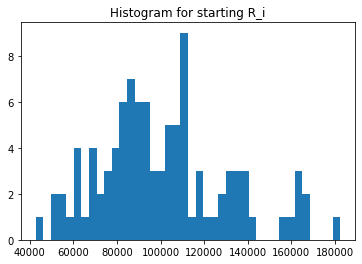

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([234991.00271916, 225955.27207922, 224592.3506424 , 324580.3506424 ,
       325940.27207922, 224580.3506424 , 237650.84224845, 137657.84224845,
       225939.27207922, 281933.48598873, 181940.48598873, 164515.97942392,
       264515.97942392, 264574.0171187 , 164573.0171187 , 164578.0171187 ,
       181932.48598873, 225946.13278847, 125946.13278847, 167605.77235185,
       267606.77235185, 125953.13278847, 169033.42516732, 269032.42516732,
       204441.23240707, 304433.23240707, 169032.42516732, 307333.13941892,
       423122.40057218, 323122.40057218, 207332.13941892, 207336.13941892,
       137649.84224845, 167610.77235185, 323142.40057218, 261215.05027367,
       206050.57967415, 134564.04432743, 234564.04432743, 361207.05027367,
       134568.04432743, 204917.70147078, 104916.70147078, 261206.05027367,
       314030.31578113, 214034.31578113, 105871.11561221, 205872.11561221,
       306046.57967415, 214029.31578113, 206046.57967415, 464874.55661147,
       364874.55661147, 2

In [24]:
experiments.UNI_Si.unique()

array([10000., 14452., 14425., 17264., 15496., 16078., 16076., 17939.,
       15966., 15916., 14891., 14823., 13094., 17431., 13828., 19531.,
       14672., 19445., 14853., 12740., 15021., 15369., 17048., 14593.,
       14493., 14622., 15815., 18752., 13714., 19304., 15938., 16279.,
       14192., 15823., 15395., 15811., 16500., 13107., 17907., 14991.,
       15380., 16946., 15884., 16001., 16713., 14515., 14446., 16565.,
       15527., 13695., 16164., 14490., 14099., 13034., 16228., 18040.,
       13577., 13840., 13219., 13609., 17372., 15118., 15678., 15841.,
       15310., 13642., 17160., 15665., 15191., 14729., 14860., 13829.,
       14541., 15513., 15561., 17694., 15509., 13934., 14690., 18861.,
       14472., 13008., 14500., 15058., 16316., 21702., 18079., 13547.,
       15806., 13897., 15394., 13651., 12994., 15229., 13049., 14844.,
       14051., 14232., 14255.])

In [25]:
experiments.UNI_Qj.unique()

array([126330.07812691, 166417.74691397, 151424.95502607, 145009.08008456,
       169846.10648696, 120902.33976273, 206574.98846482, 126885.68213811,
       241968.36169322, 233907.20126638, 315340.92787112, 407207.78853768,
       141275.7031774 , 148395.17811222, 183536.1501879 , 330767.26002767,
       483603.23970664, 155101.37746275, 180147.95805273, 204500.90842904,
       141670.10928841, 210232.78907844, 245035.8463788 , 233233.96268078,
       195327.49717513, 214392.97531279, 203948.53075824, 198286.14263224,
       187894.0750645 , 233207.10325291, 444908.27359388, 151935.21055775,
       195225.00299272, 217438.57152212, 138008.79081839, 107285.97759644,
       186006.74659839, 258547.82266997, 255287.2673226 , 203814.7514434 ,
       148879.41820321, 197759.20899348, 220566.11177506, 252163.28119865,
       289822.73467857, 136861.96132253, 149842.89016647, 366476.50947373,
       233252.16996651, 158609.30970373, 135860.52037312, 156594.55296553,
       215660.46618058, 1

In [26]:
experiments.UNI_Rj.unique()

array([ 63165.03906345,  83208.87345698,  75712.47751304,  72504.54004228,
        84923.05324348,  60451.16988137, 103287.49423241,  63442.84106905,
       120984.18084661, 116953.60063319, 157670.46393556, 203603.89426884,
        70637.8515887 ,  74197.58905611,  91768.07509395, 165383.63001383,
       241801.61985332,  77550.68873137,  90073.97902637, 102250.45421452,
        70835.0546442 , 105116.39453922, 122517.9231894 , 116616.98134039,
        97663.74858756, 107196.4876564 , 101974.26537912,  99143.07131612,
        93947.03753225, 116603.55162645, 222454.13679694,  75967.60527887,
        97612.50149636, 108719.28576106,  69004.39540919,  53642.98879822,
        93003.37329919, 129273.91133498, 127643.6336613 , 101907.3757217 ,
        74439.70910161,  98879.60449674, 110283.05588753, 126081.64059932,
       144911.36733928,  68430.98066127,  74921.44508323, 183238.25473686,
       116626.08498325,  79304.65485187,  67930.26018656,  78297.27648277,
       107830.23309029,  

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([ 63165.03906345,  83208.87345698,  60451.16988137,  75712.47751304,
       103287.49423241,  84923.05324348, 120984.18084661,  63442.84106905,
       116953.60063319, 203603.89426884,  70637.8515887 ,  72504.54004228,
       165383.63001383, 241801.61985332,  74197.58905611,  90073.97902637,
        77550.68873137,  91768.07509395,  70835.0546442 , 102250.45421452,
       122517.9231894 , 105116.39453922, 116616.98134039,  97663.74858756,
       101974.26537912, 222454.13679694,  93947.03753225,  75967.60527887,
       107196.4876564 ,  97612.50149636,  99143.07131612,  69004.39540919,
        53642.98879822,  93003.37329919, 129273.91133498, 101907.3757217 ,
       157670.46393556,  74439.70910161,  98879.60449674, 116603.55162645,
       110283.05588753, 144911.36733928, 127643.6336613 , 126081.64059932,
        68430.98066127,  74921.44508323, 116626.08498325, 183238.25473686,
        67930.26018656,  80193.22430096, 107830.23309029,  79304.65485187,
       113322.92096438, 1

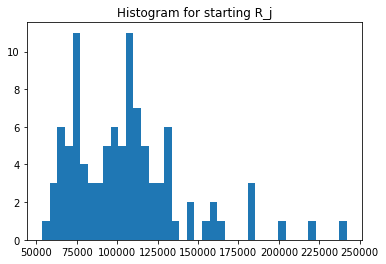

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([117495.50135958,  99450.63603961, 100450.63603961, ...,
        77159.58086518,  78119.58086518,  80173.58086518])

In [31]:
experiments.UNI_ji.unique()

array([63165.03906345, 94826.87345698, 93885.87345698, ...,
       80066.63247634, 78035.63247634, 81146.39540919])

In [32]:
experiments.UNI_Sij.unique()

array([7.42160793e+09, 9.40007615e+09, 8.50176737e+09, 4.99011925e+09,
       7.72513110e+09, 4.97259171e+09, 8.49916728e+09, 3.99519024e+09,
       1.01388235e+10, 9.88447537e+09, 1.61164625e+10, 2.11068155e+10,
       1.14123361e+10, 9.69042959e+09, 9.45424900e+09, 1.11273451e+10,
       1.26845142e+10, 8.29906042e+09, 4.76811632e+09, 1.86542946e+10,
       7.05253978e+09, 1.14411881e+10, 1.14086098e+10, 8.27289416e+09,
       1.08661843e+10, 8.53518455e+09, 1.10306152e+10, 8.52332338e+09,
       5.36689813e+09, 1.56947713e+10, 1.19543925e+10, 6.39659321e+09,
       1.16409795e+10, 9.33523621e+09, 6.39450998e+09, 4.61514652e+09,
       7.15362651e+09, 2.08027983e+10, 8.07064575e+09, 1.02076661e+10,
       6.91794707e+09, 7.11752580e+09, 9.18848155e+09, 1.07132126e+10,
       1.07919349e+10, 7.57795215e+09, 8.42464636e+09, 1.39544457e+10,
       1.05488805e+10, 1.07295176e+10, 7.56416709e+09, 6.35045503e+09,
       1.31512752e+10, 1.26418732e+10, 6.43743324e+09, 9.87537959e+09,
      

In [33]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


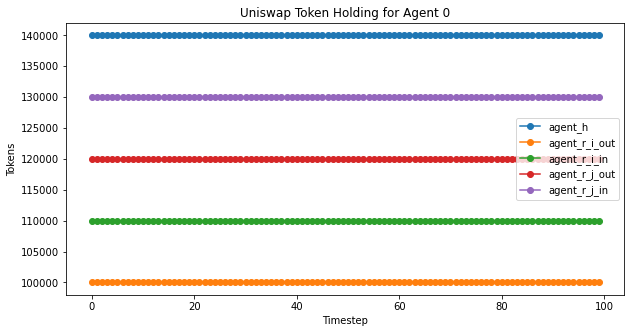

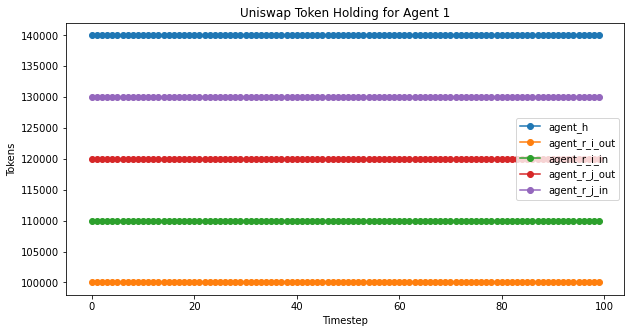

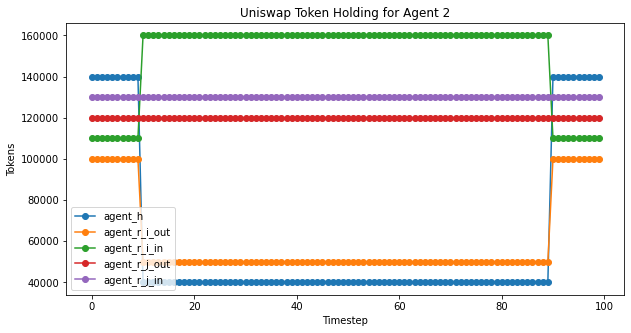

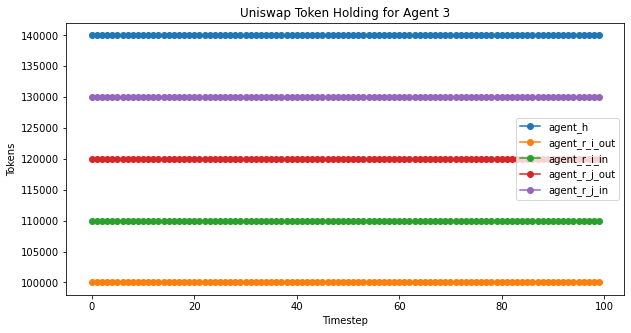

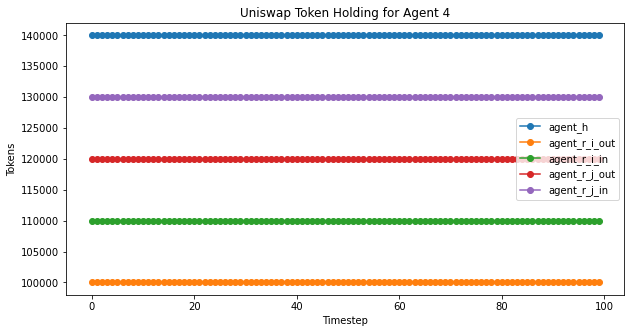

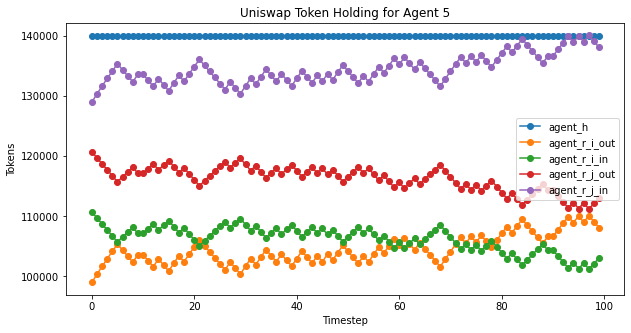

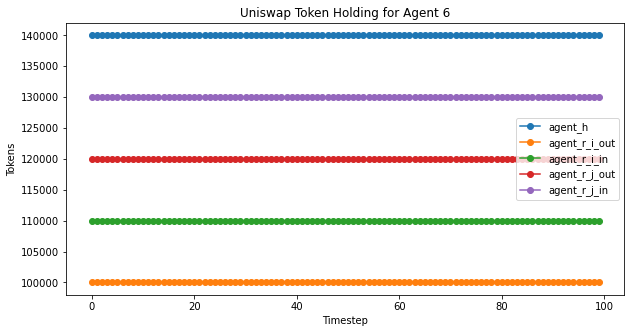

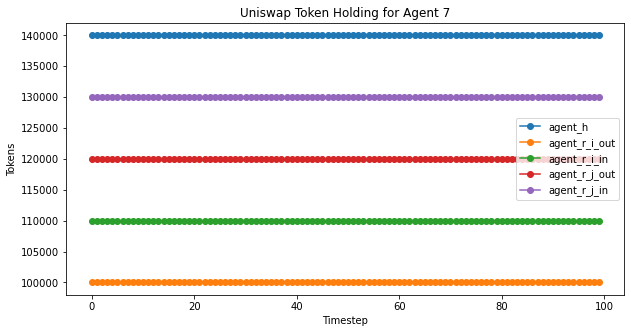

In [34]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


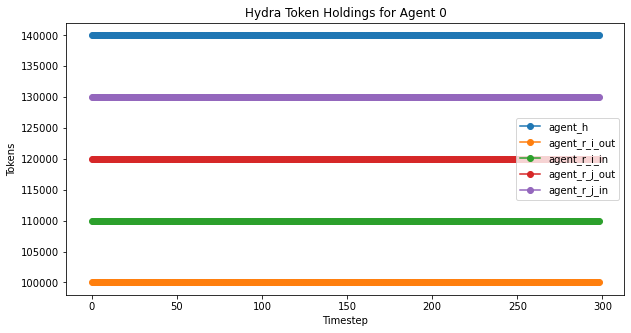

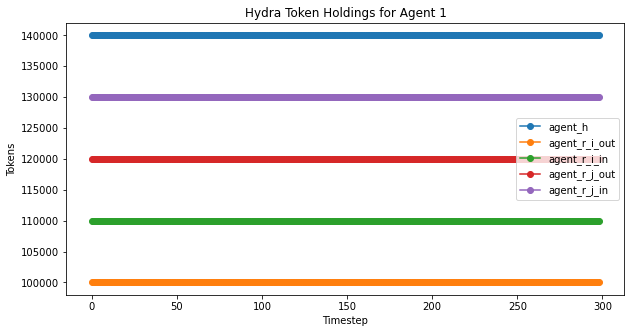

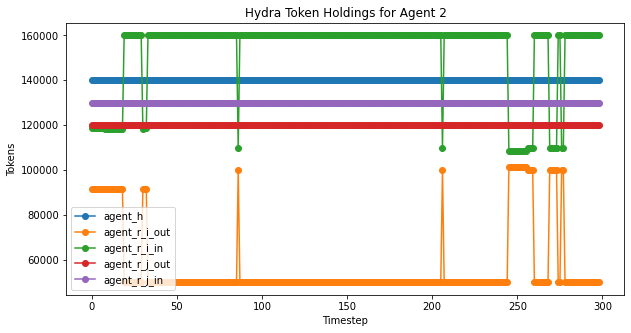

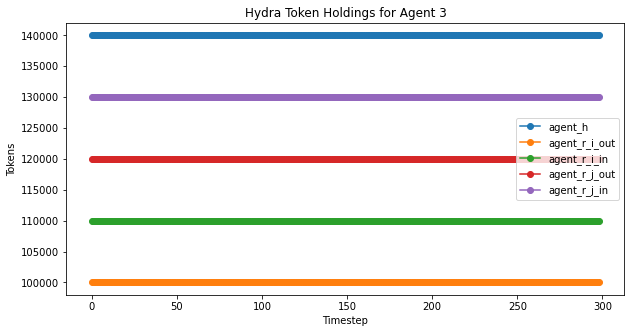

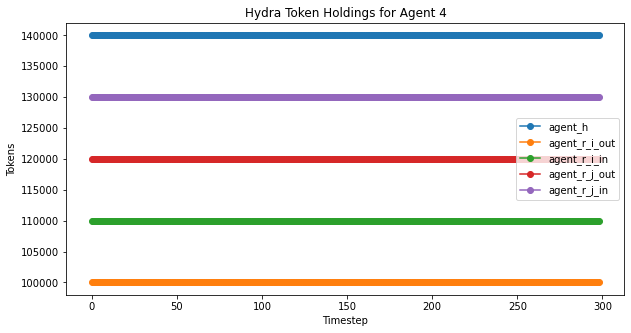

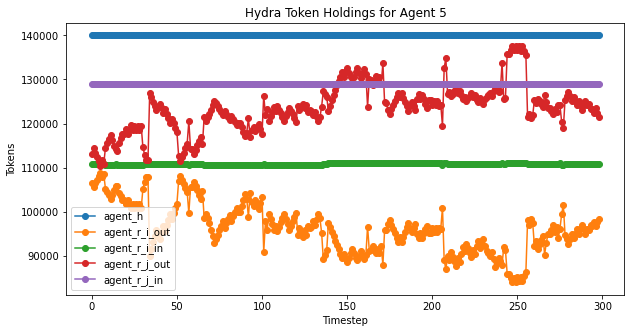

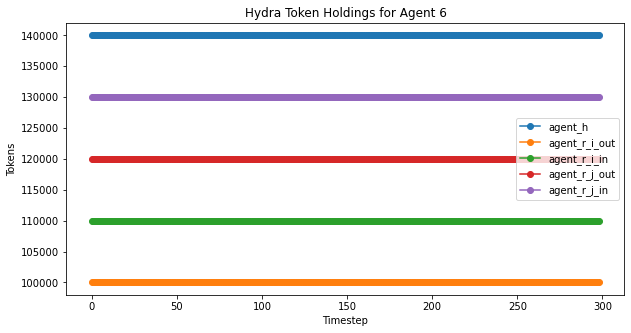

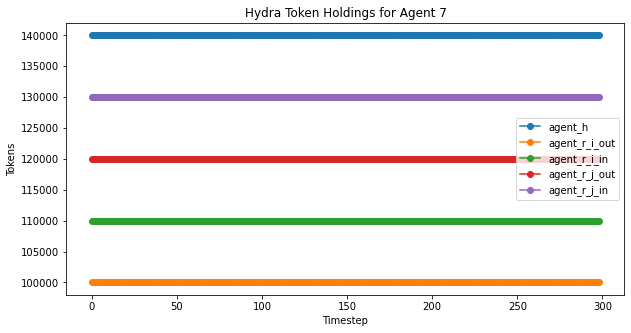

In [35]:
hydra_agent_plot(experiments,'Hydra Token Holdings for Agent ', 299)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

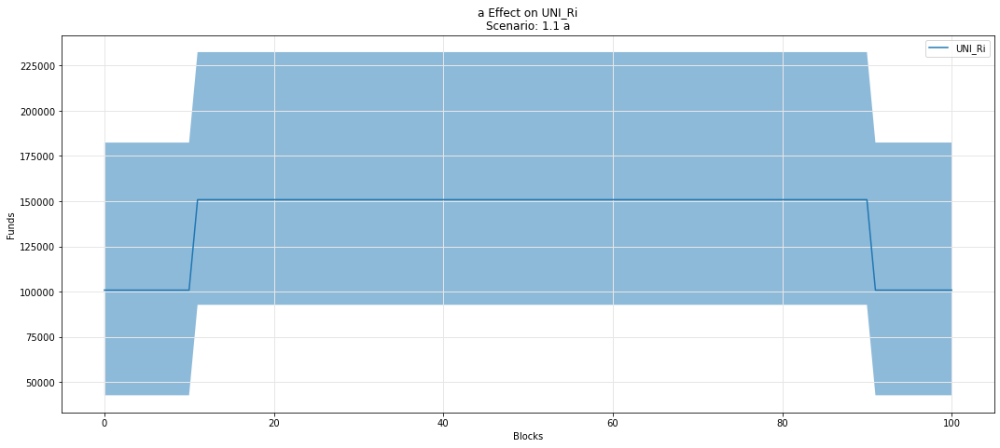

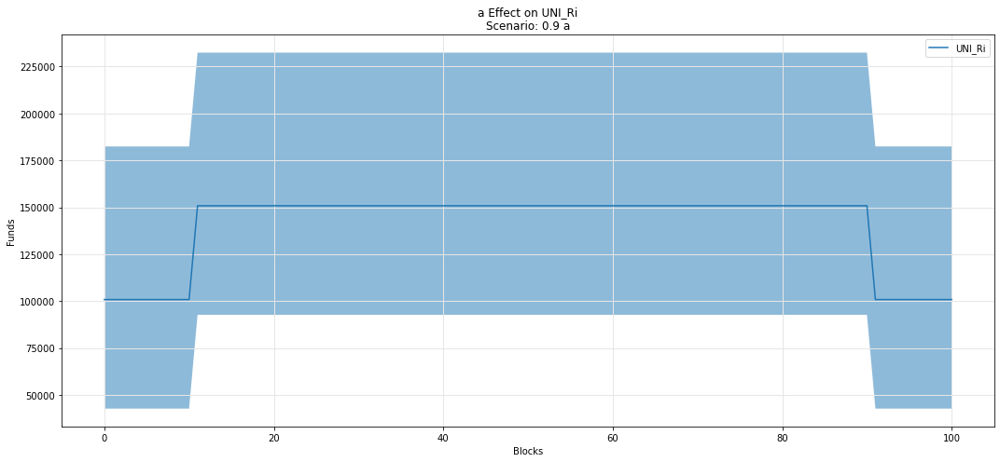

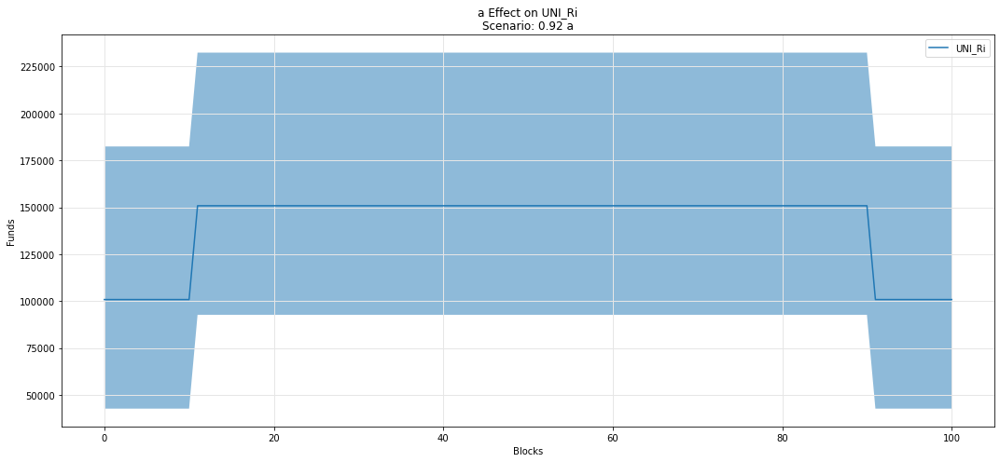

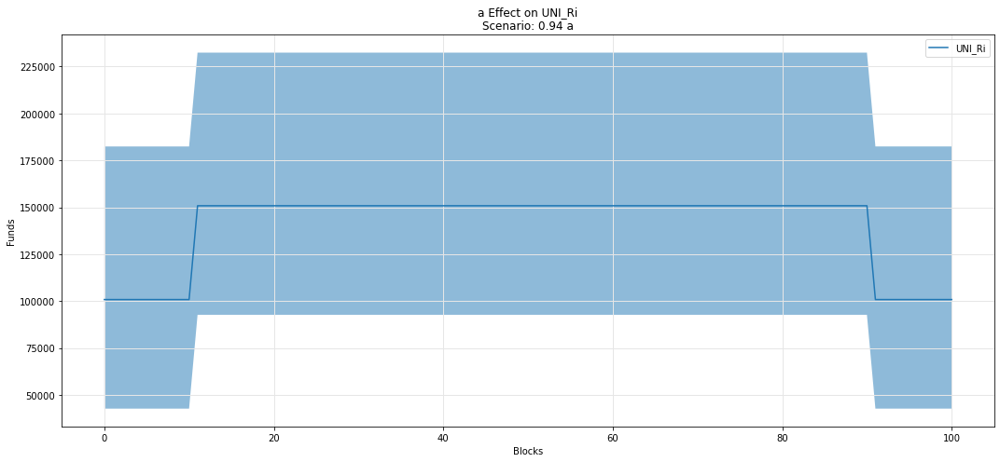

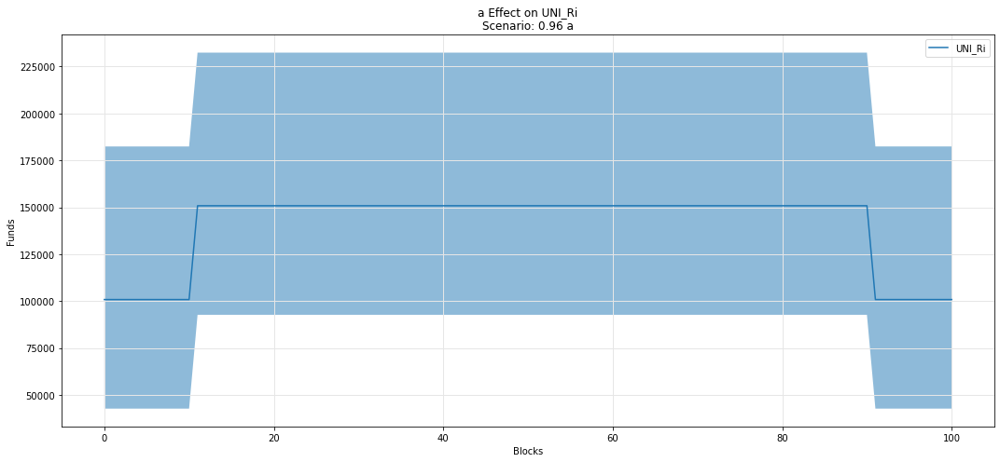

...

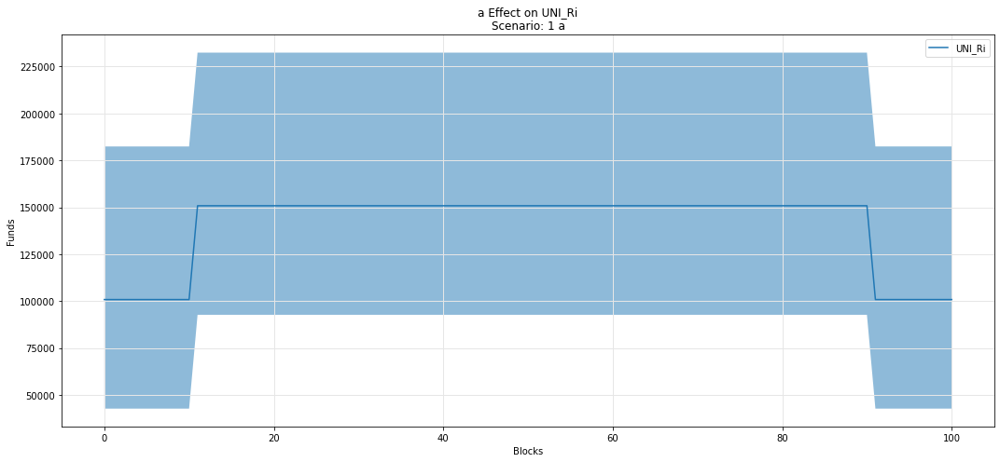

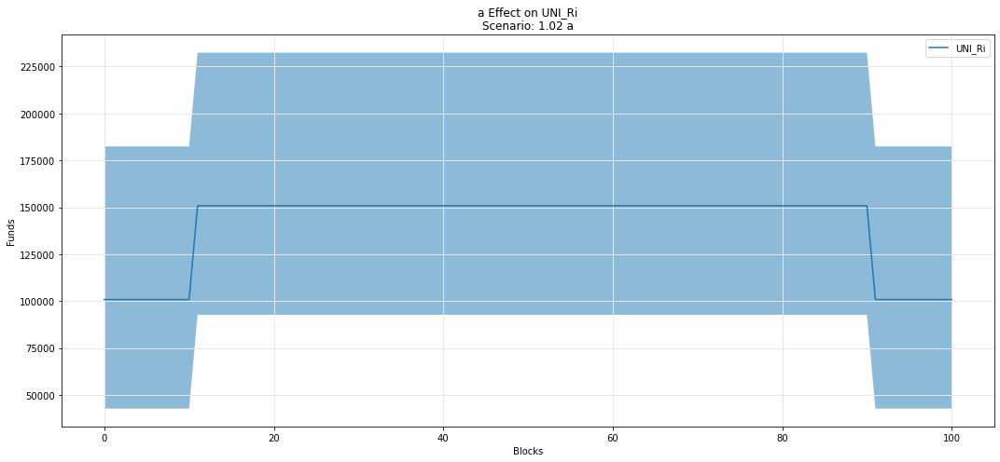

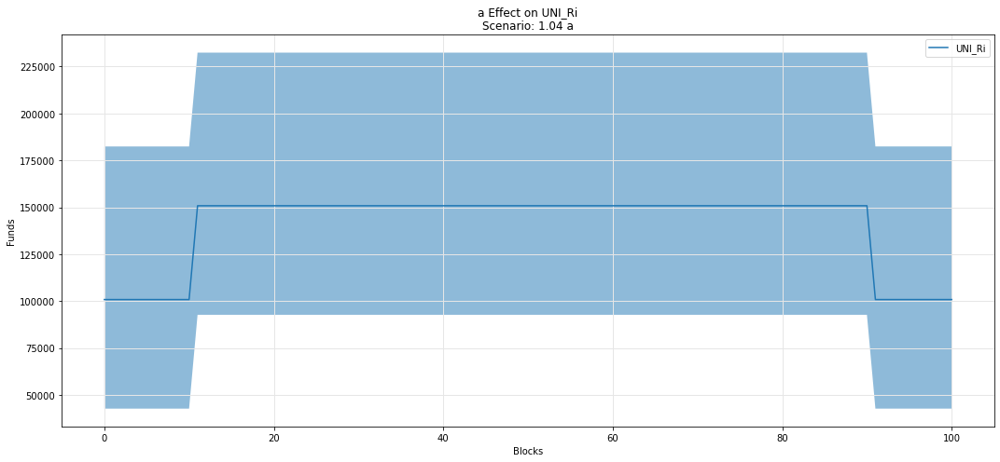

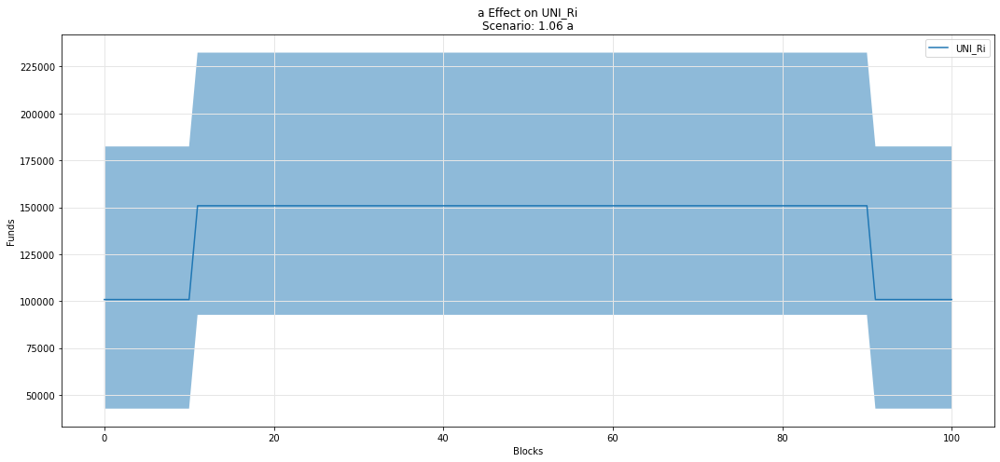

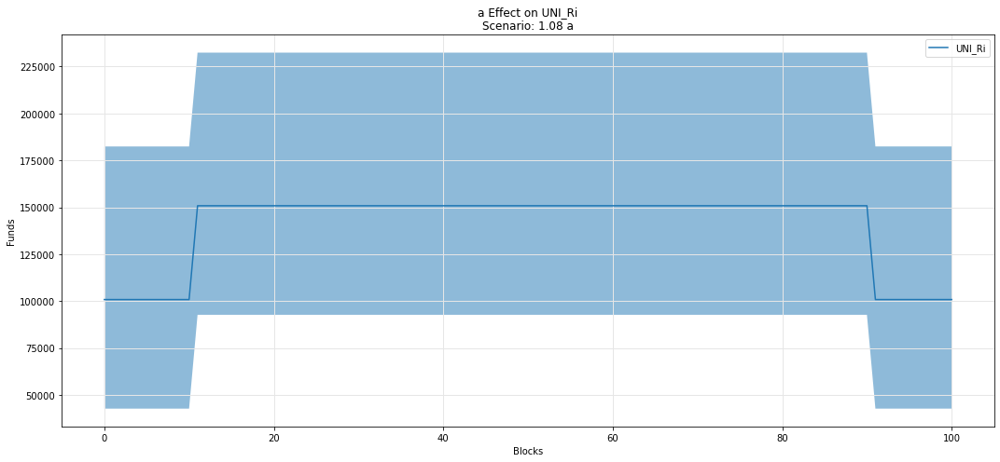

In [36]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

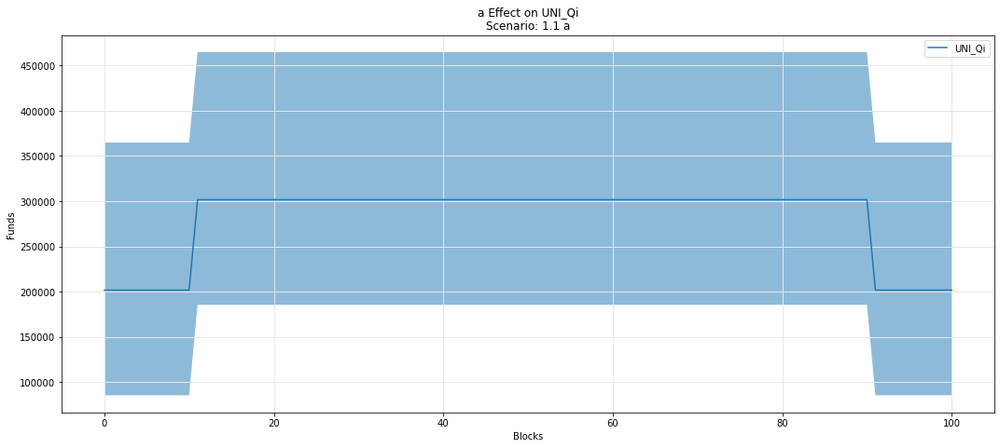

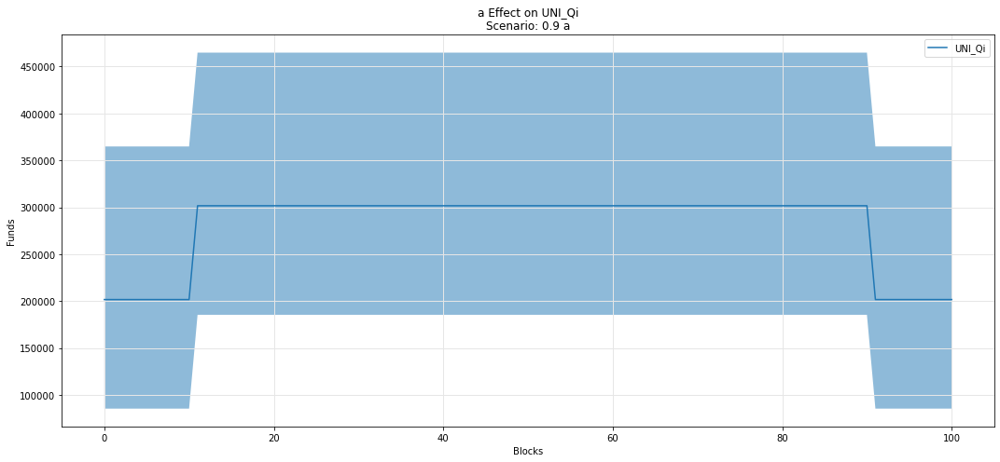

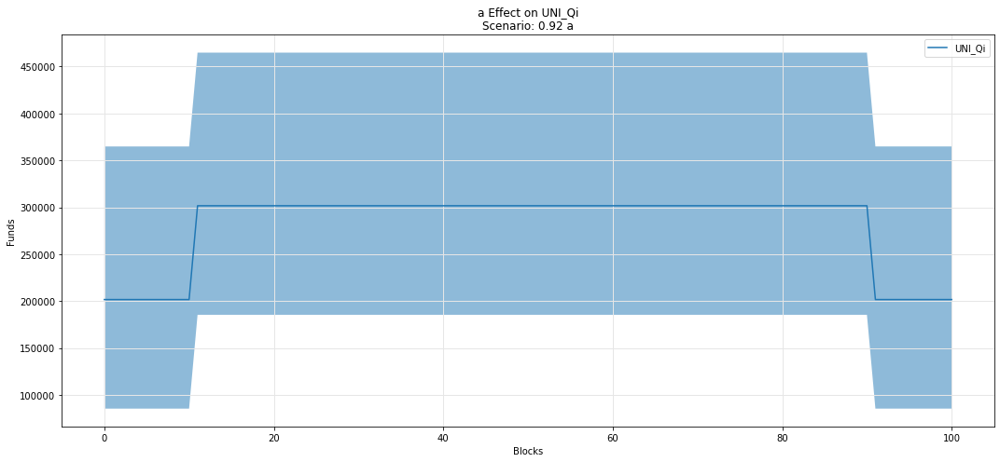

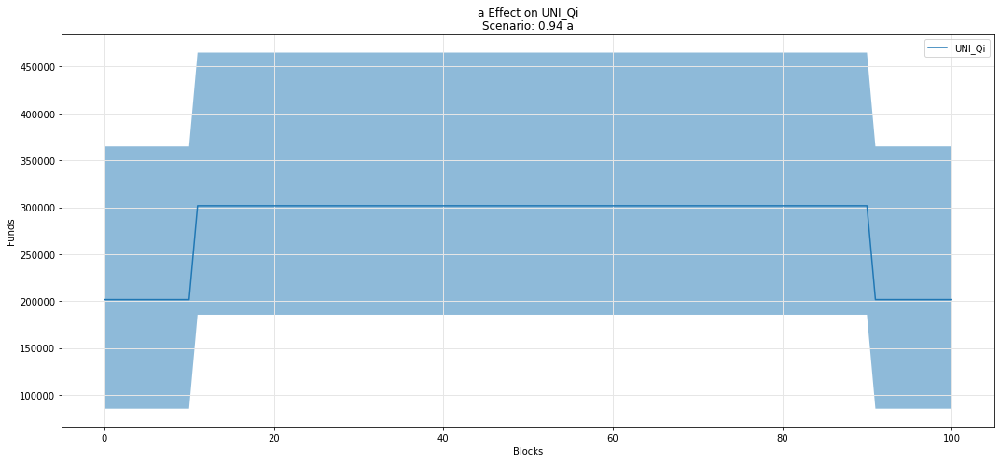

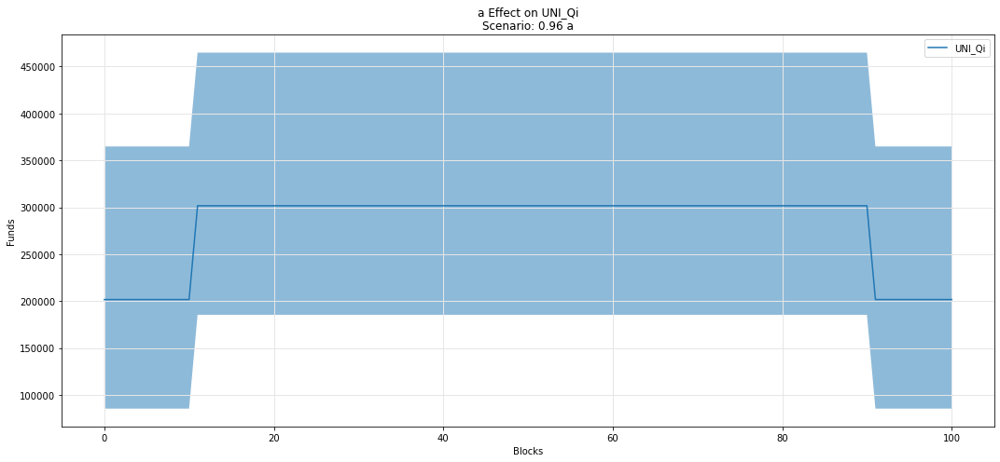

...

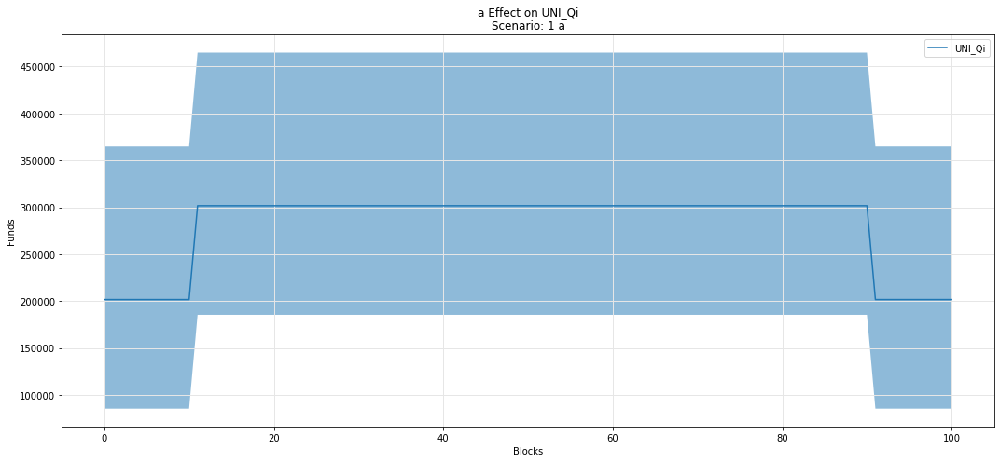

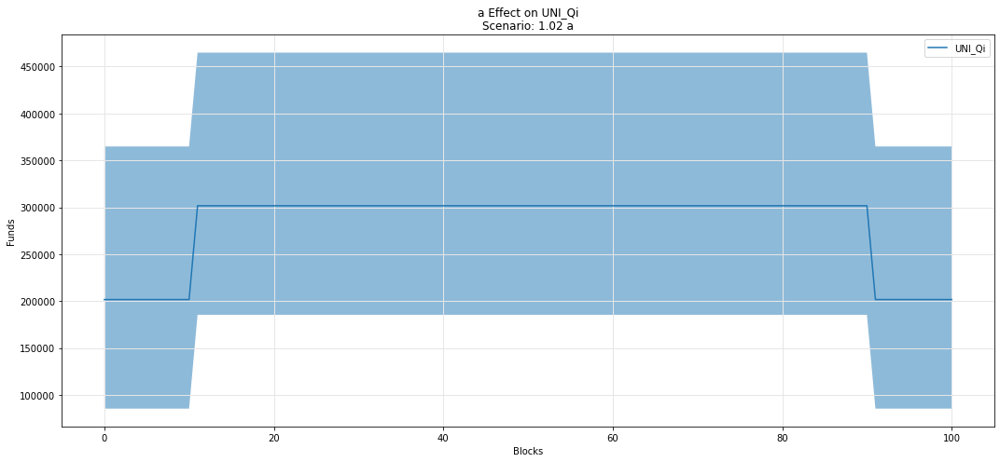

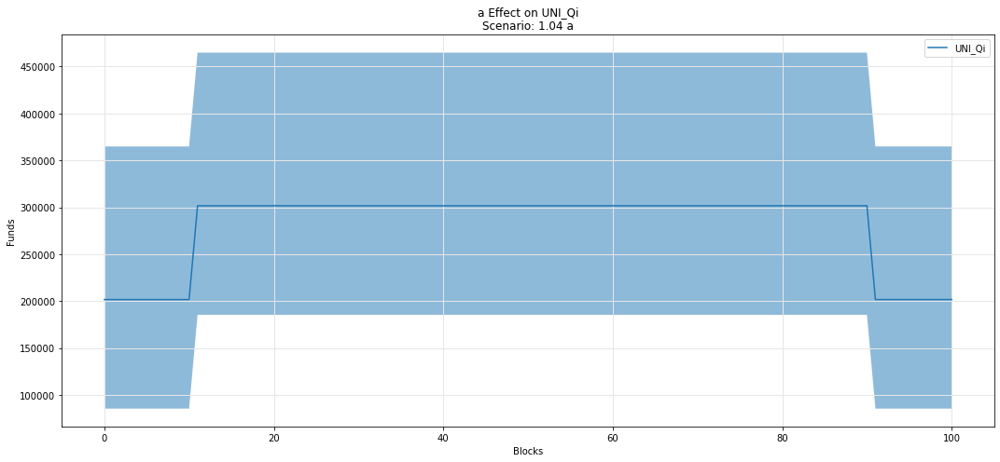

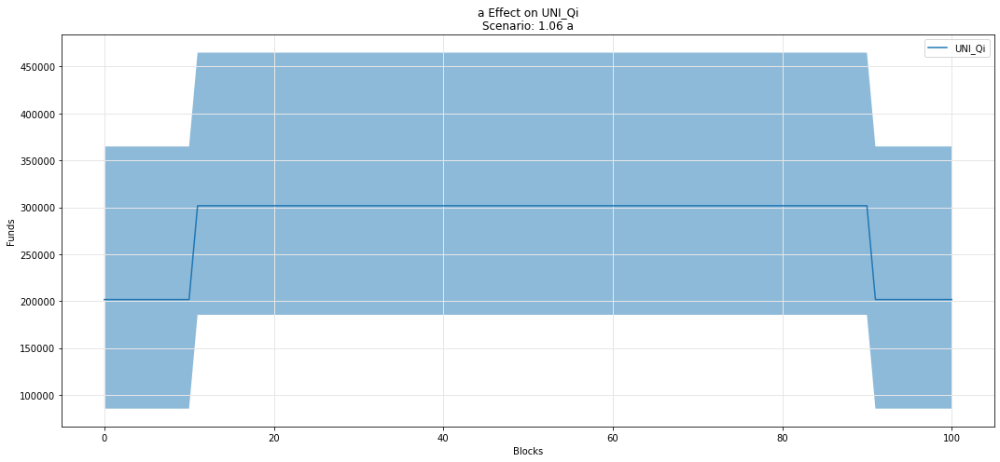

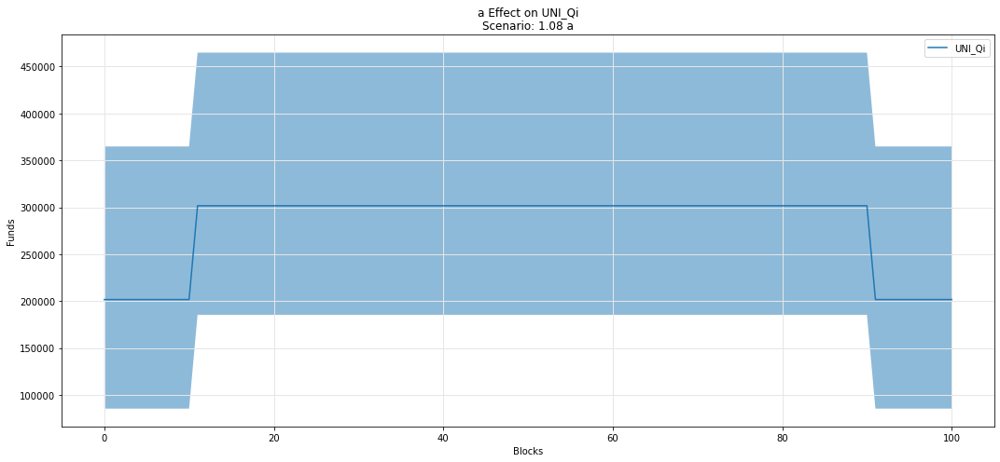

In [37]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

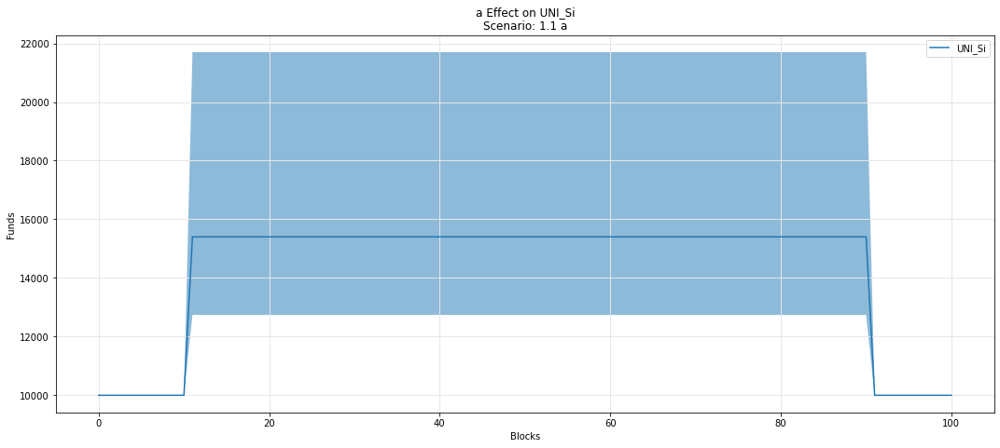

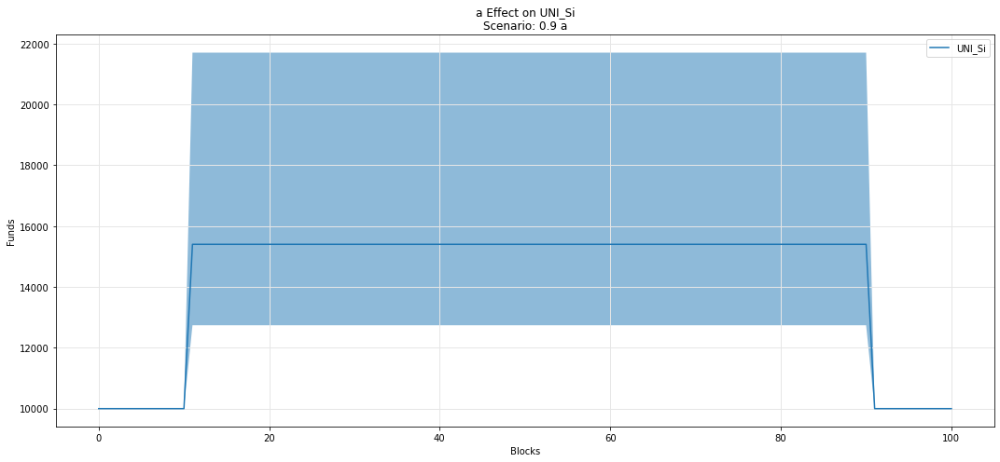

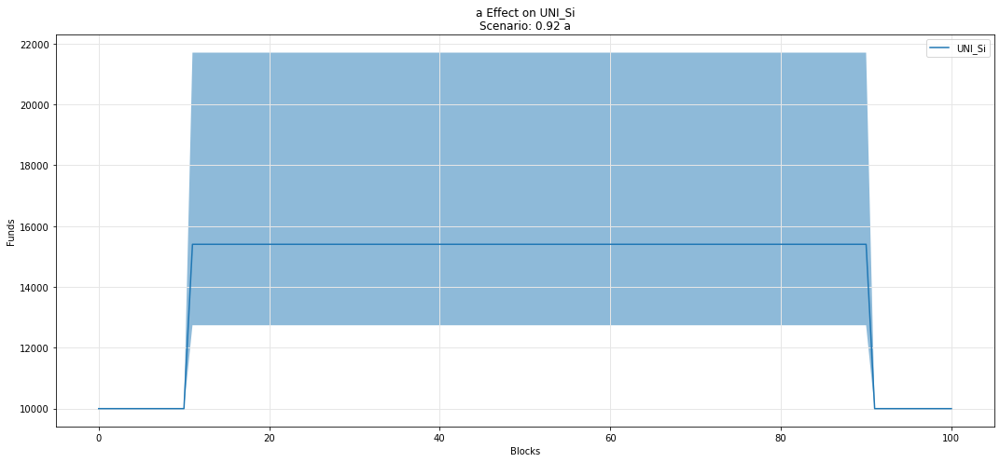

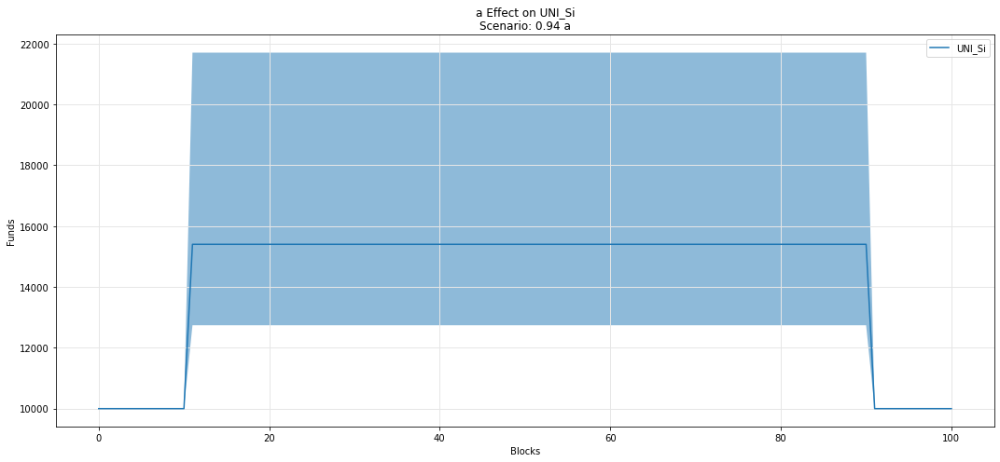

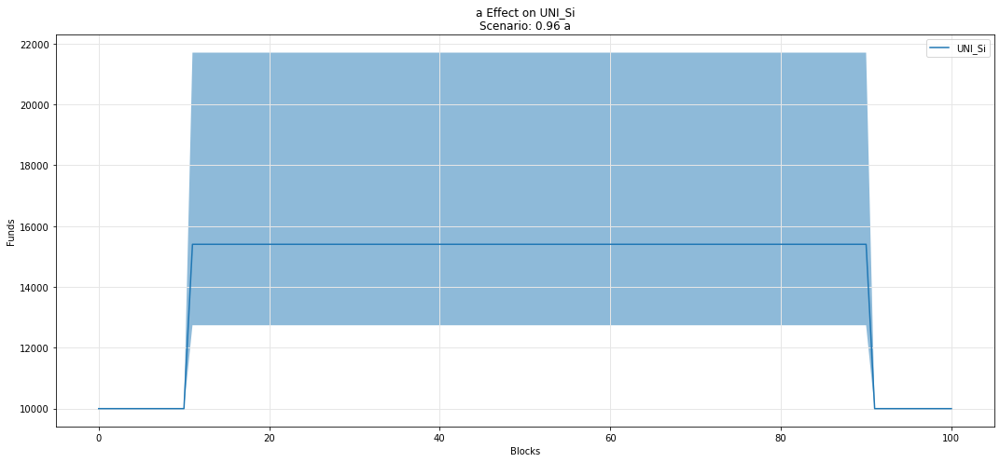

...

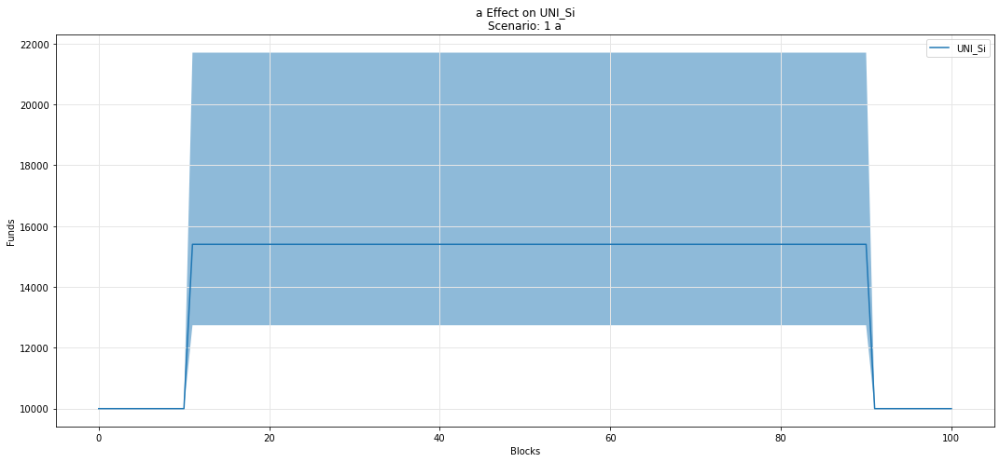

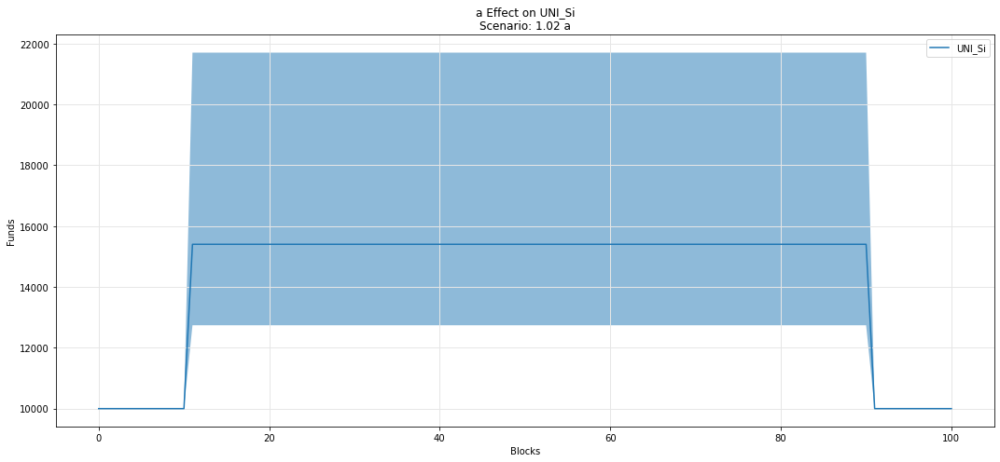

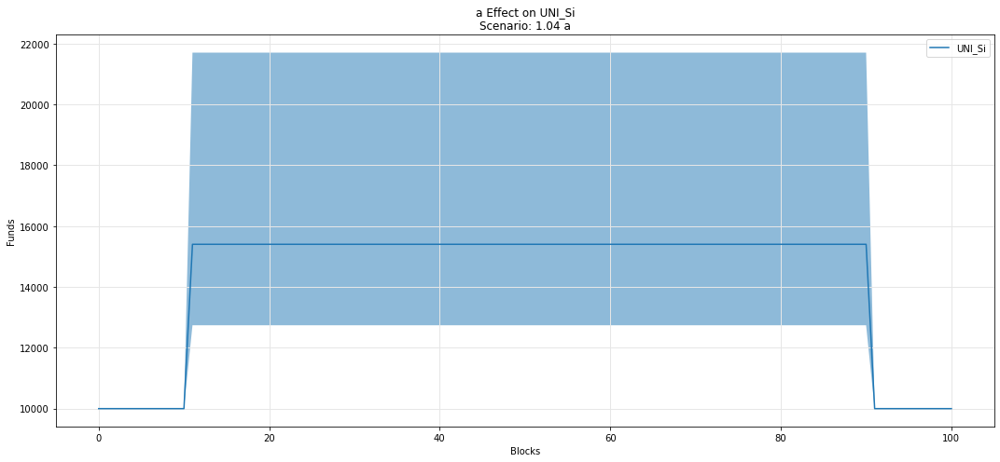

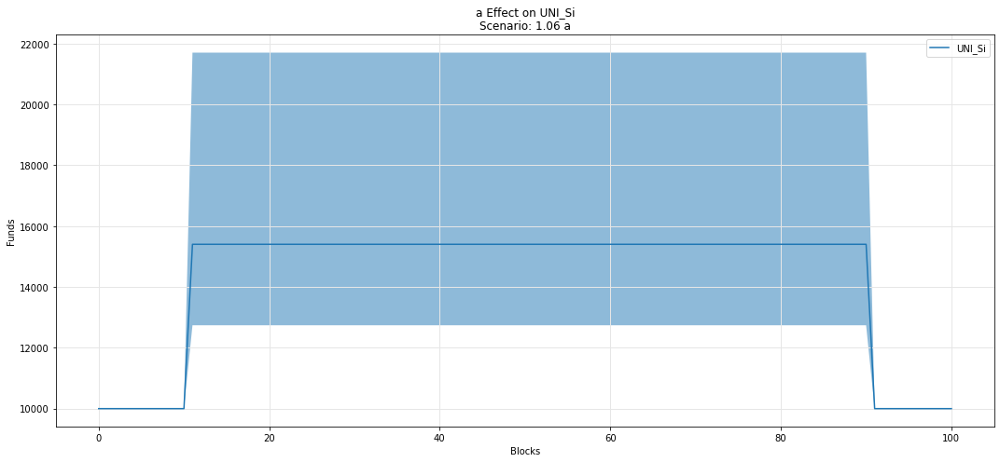

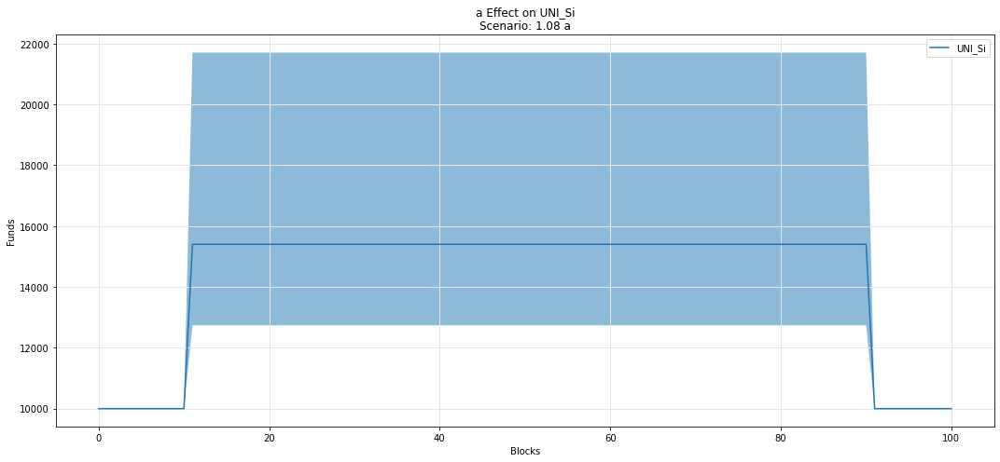

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

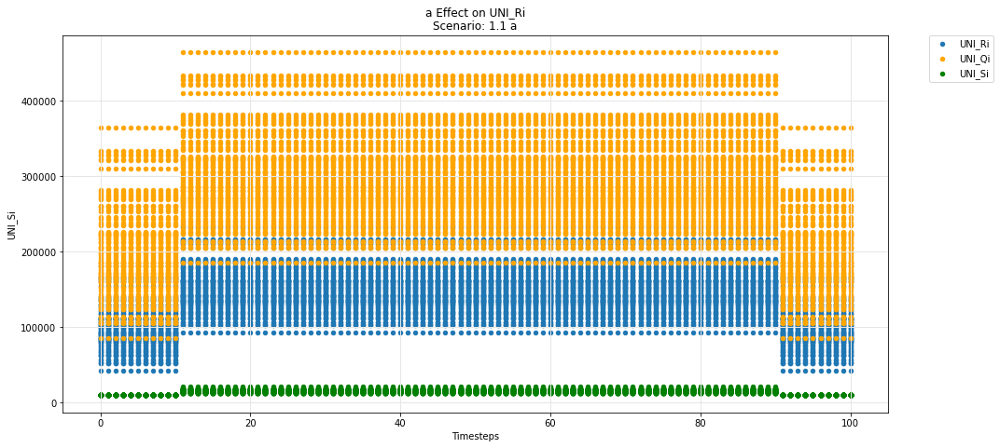

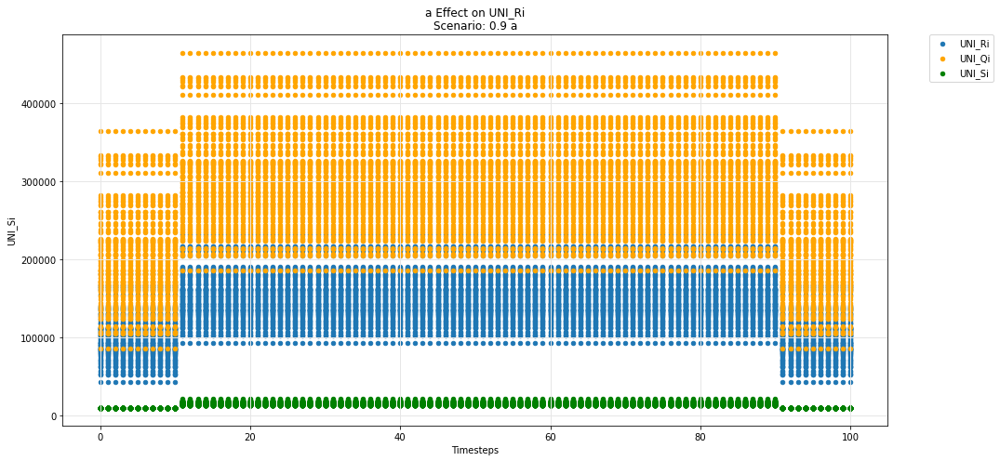

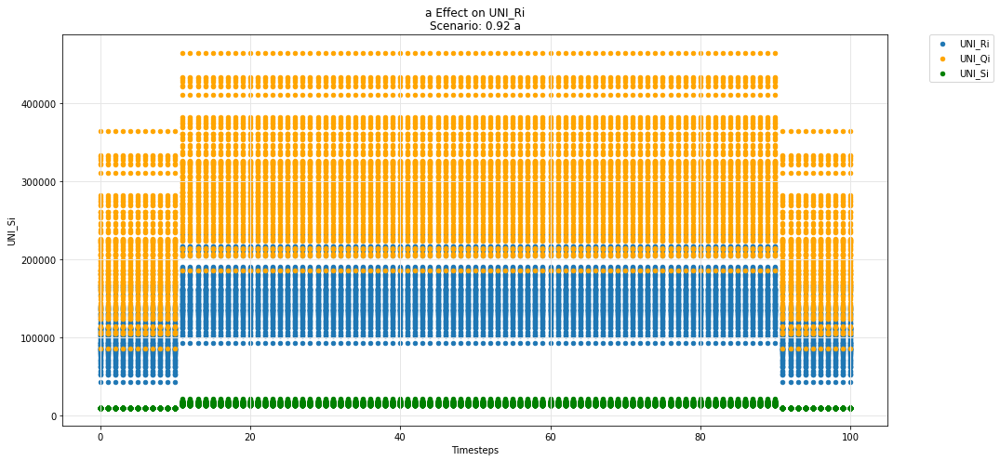

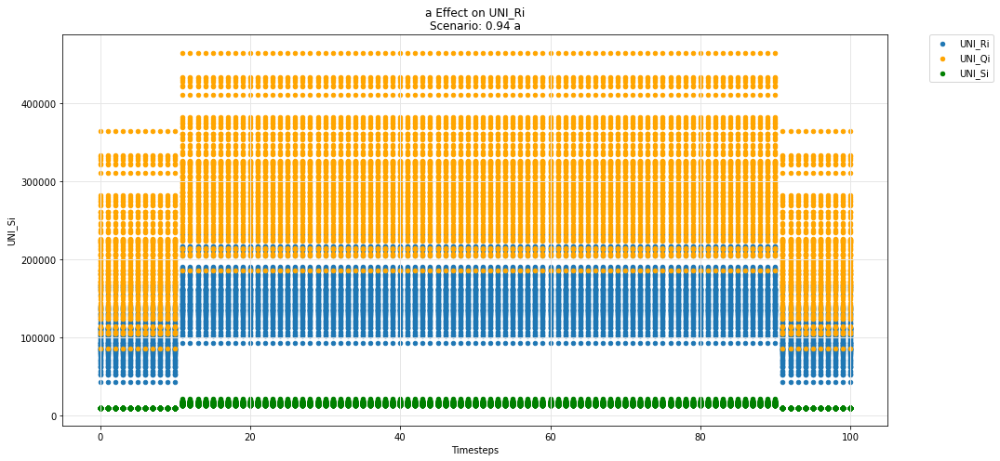

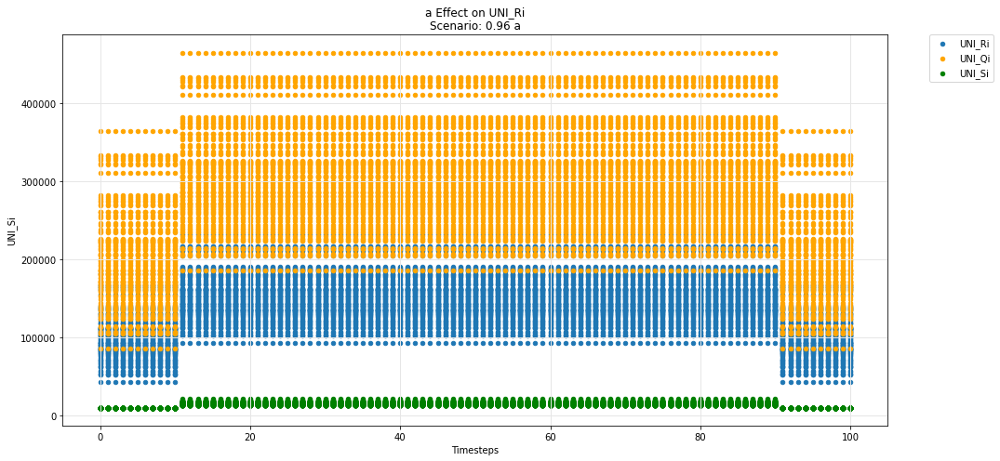

...

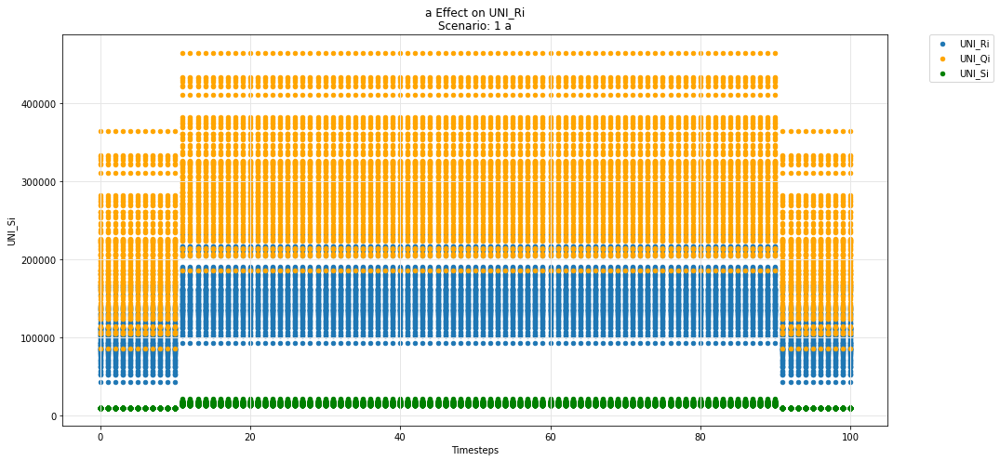

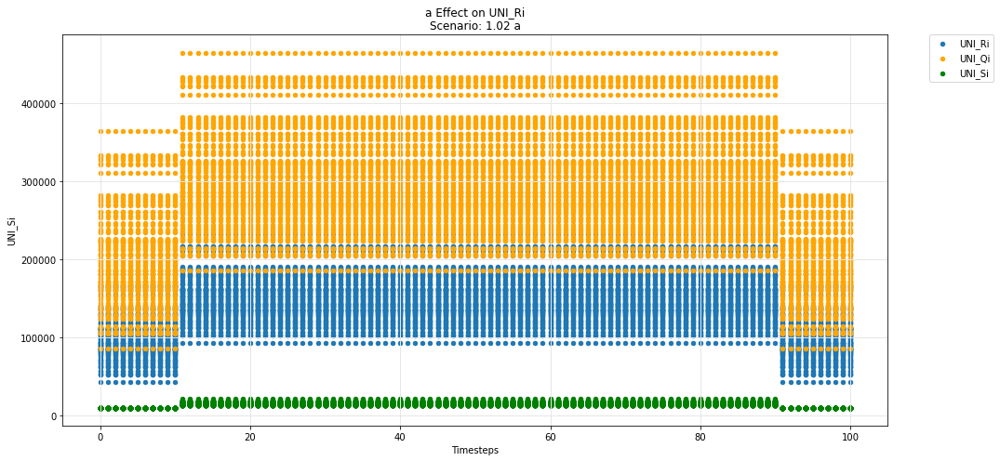

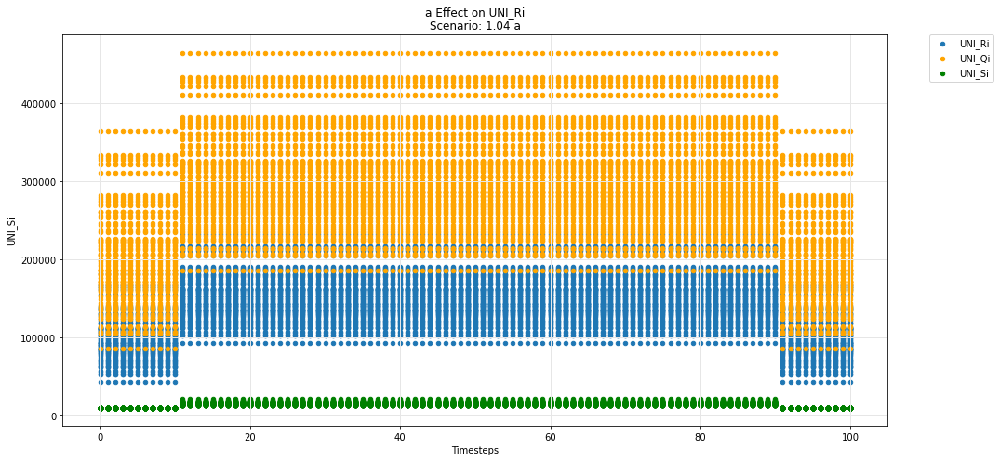

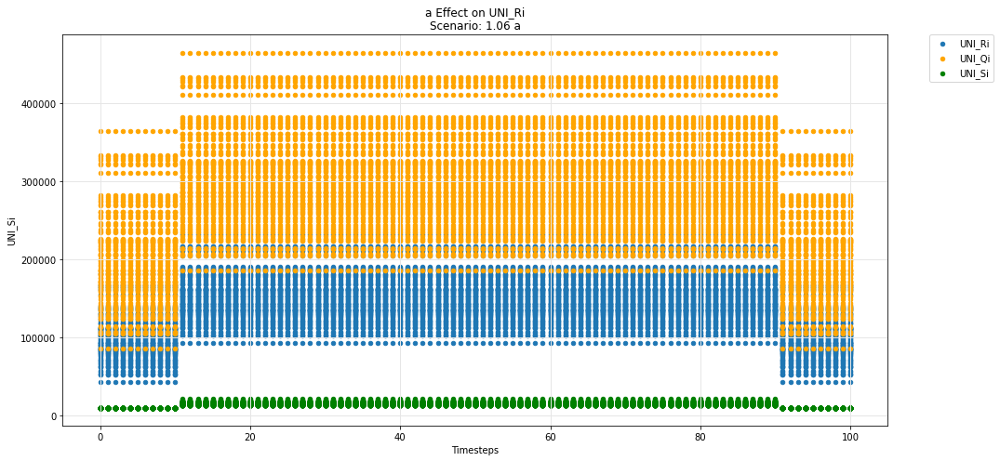

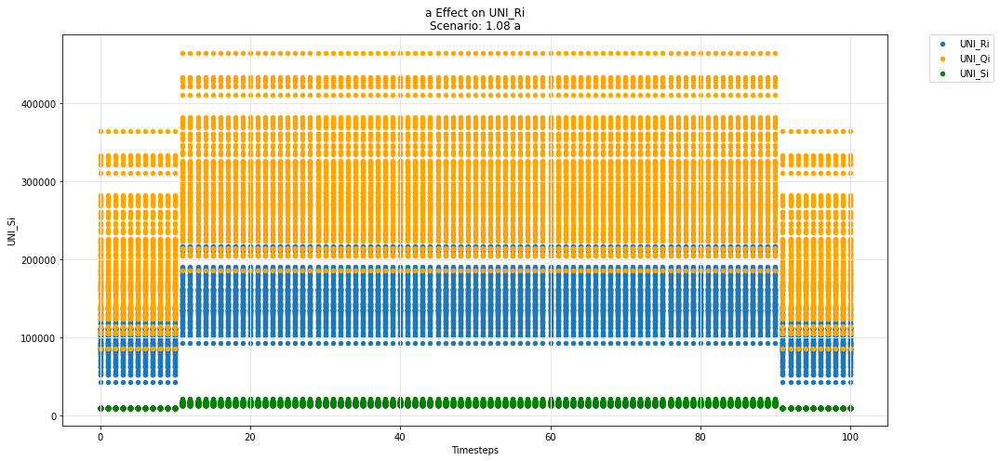

In [39]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

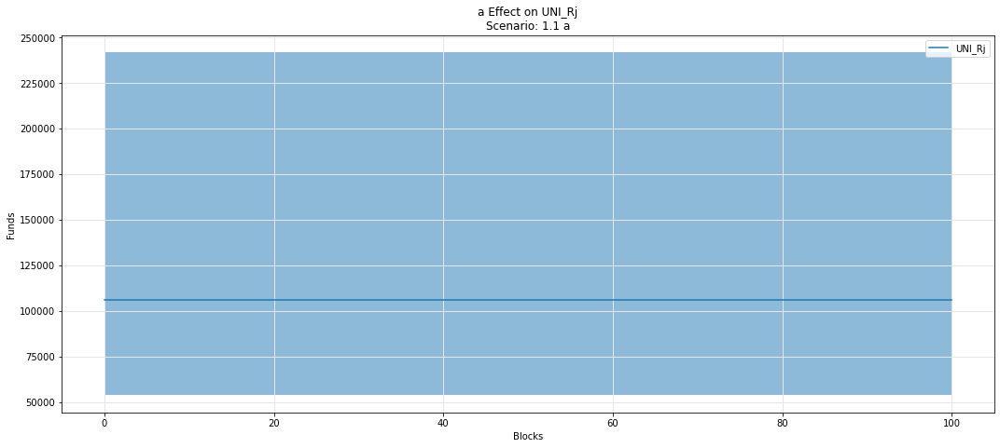

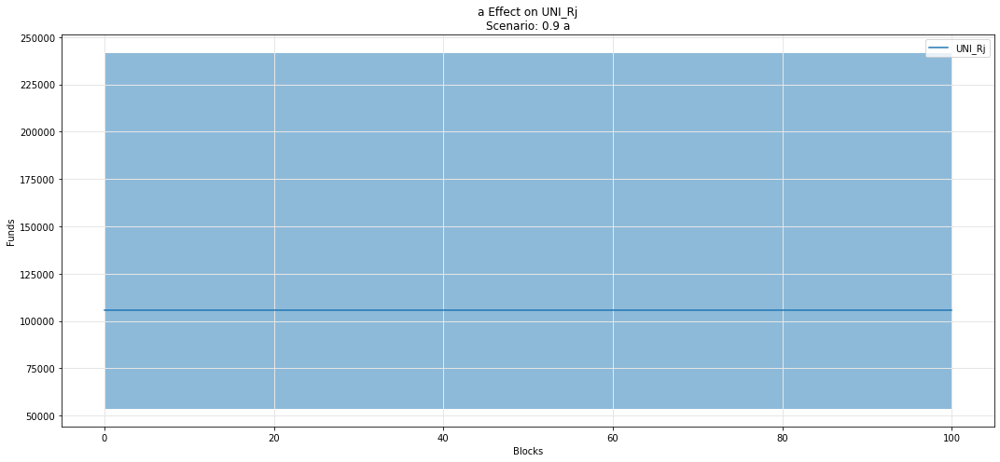

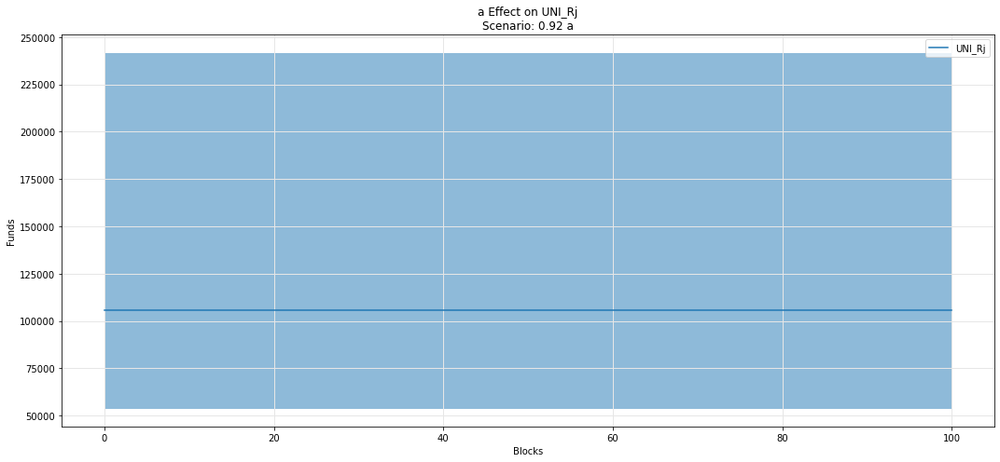

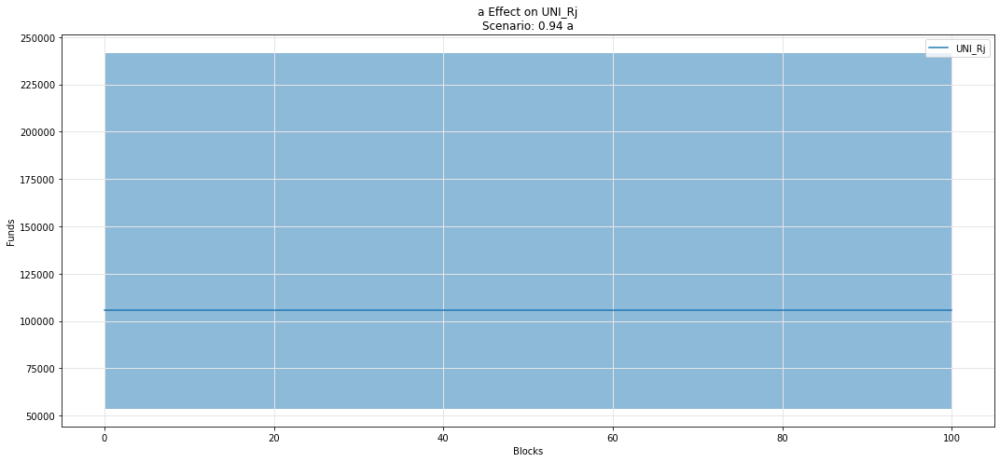

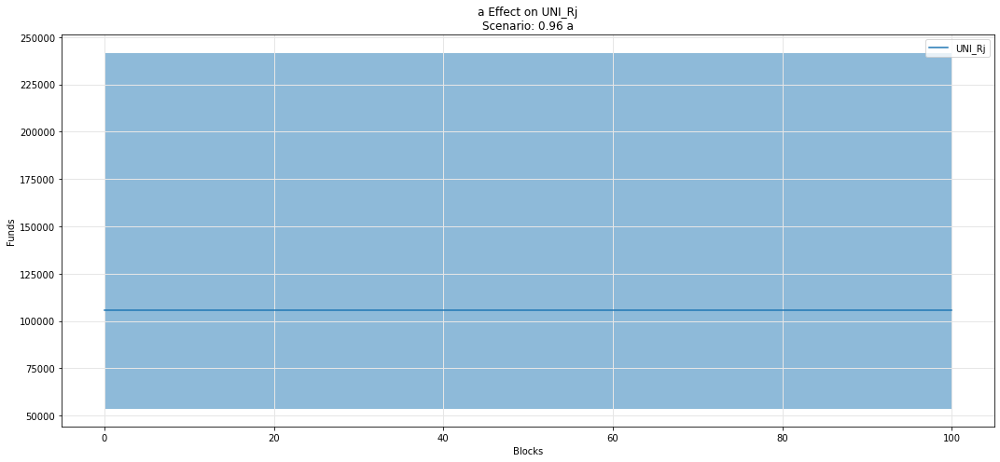

...

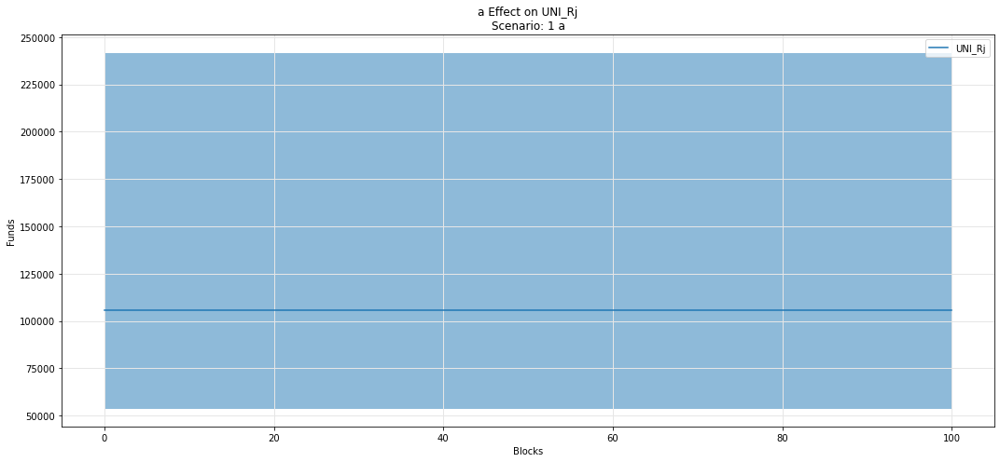

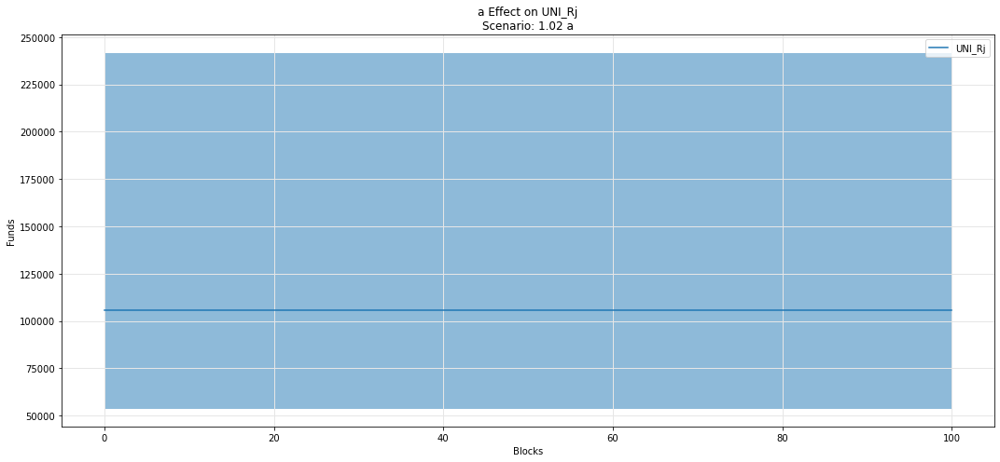

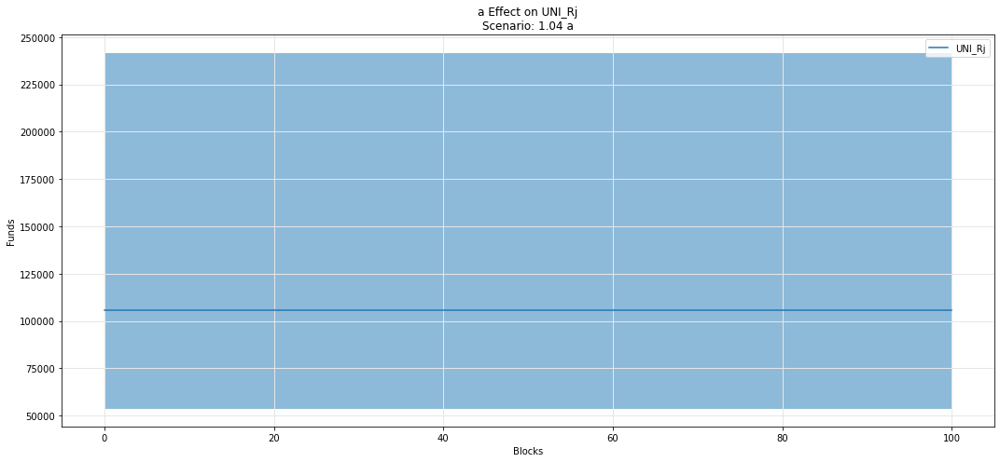

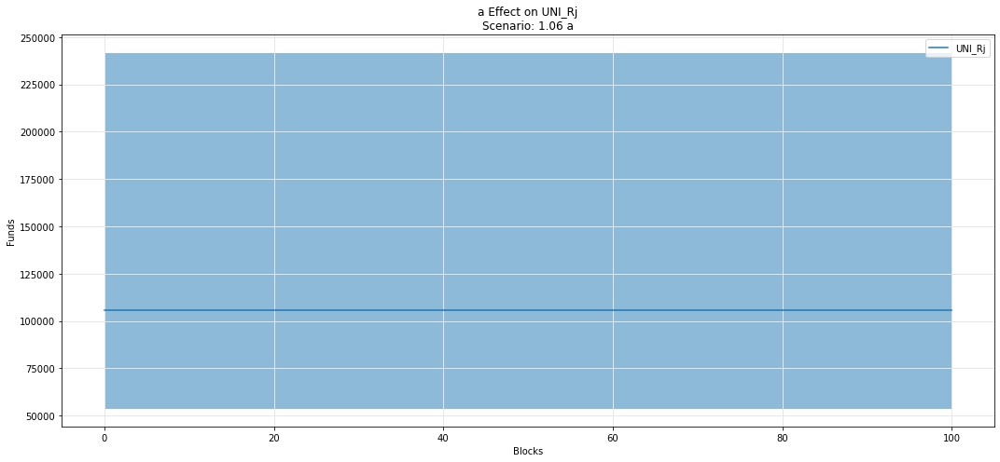

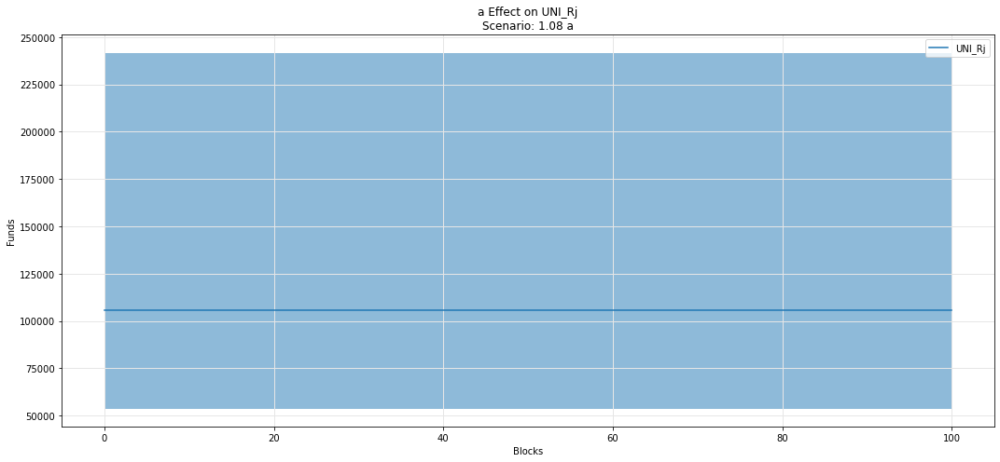

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

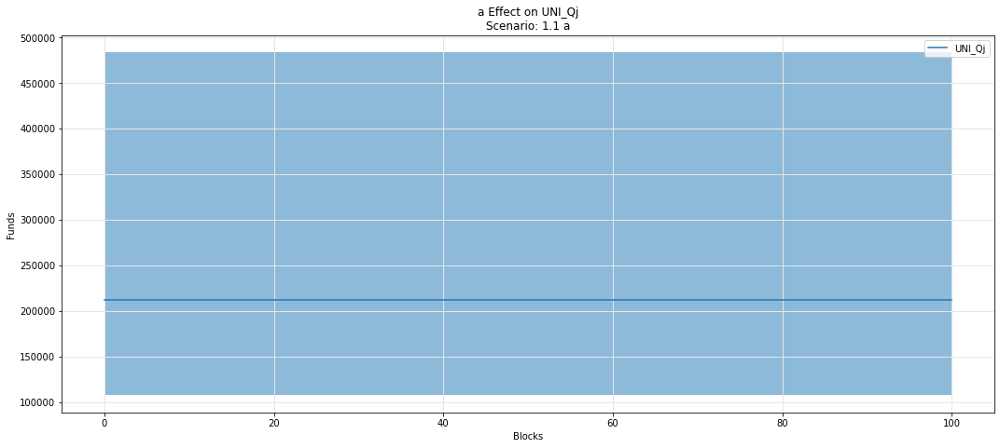

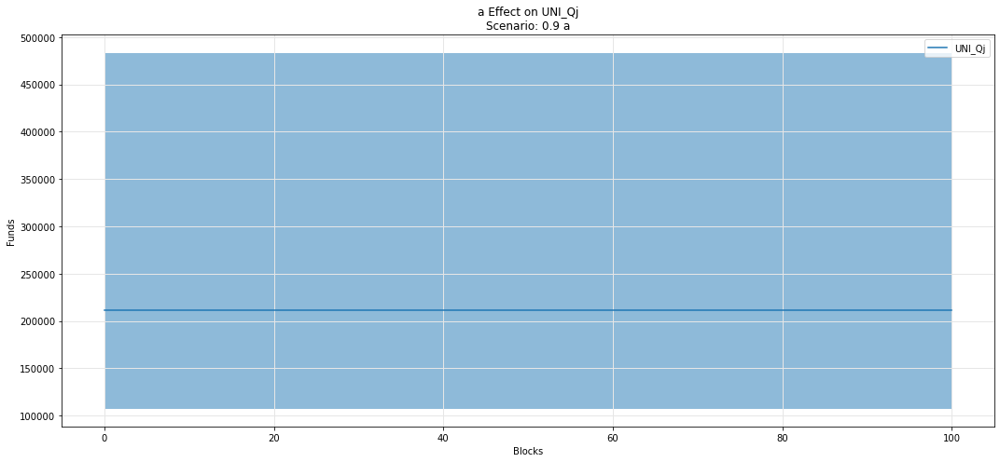

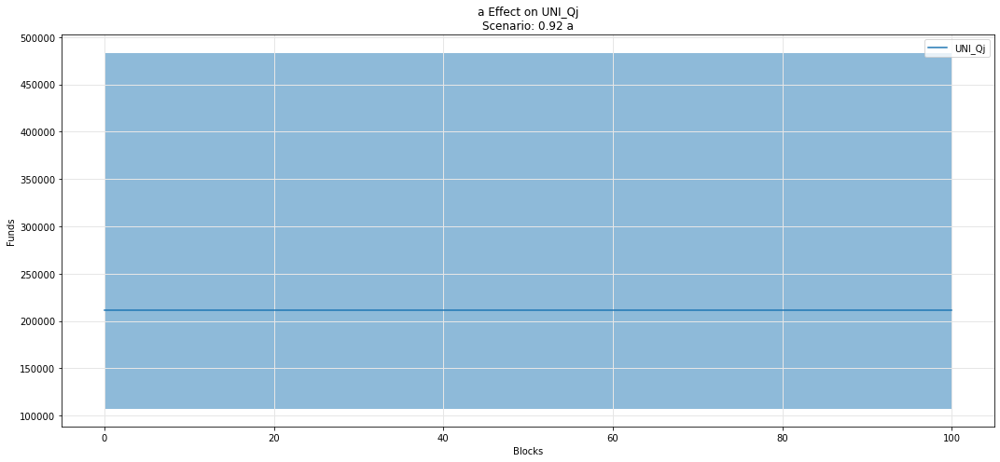

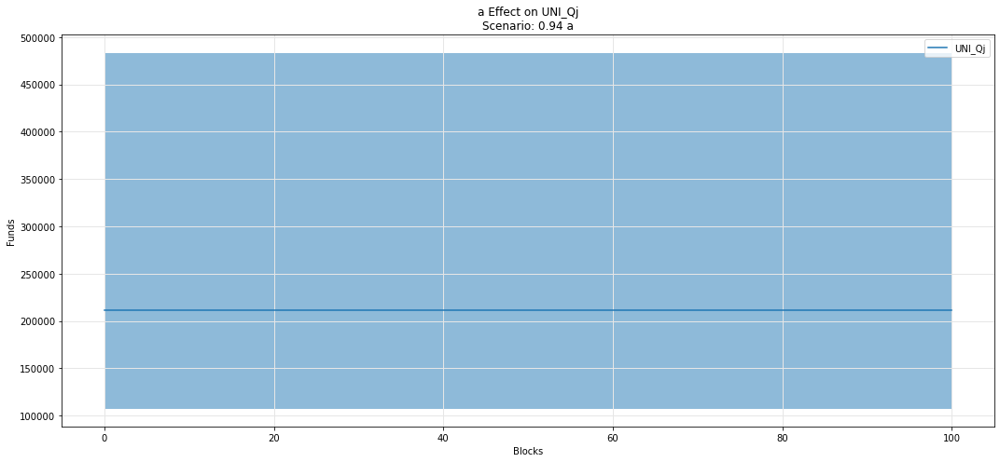

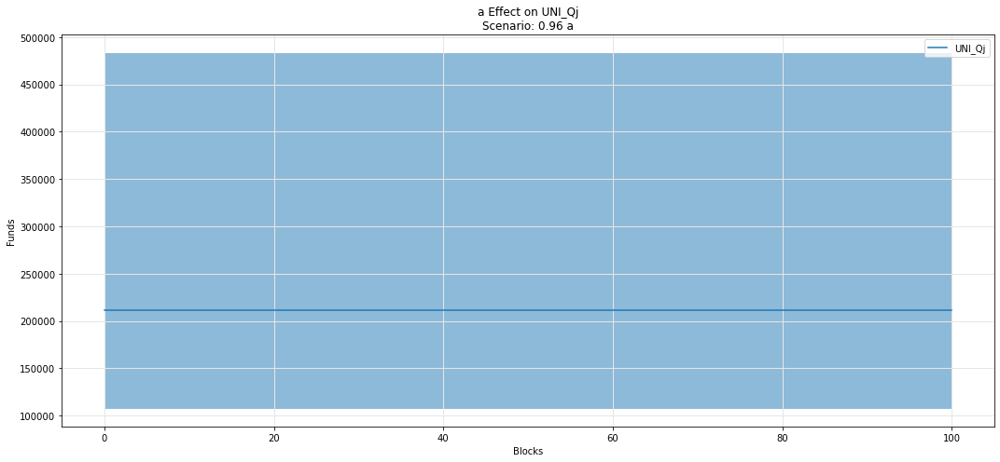

...

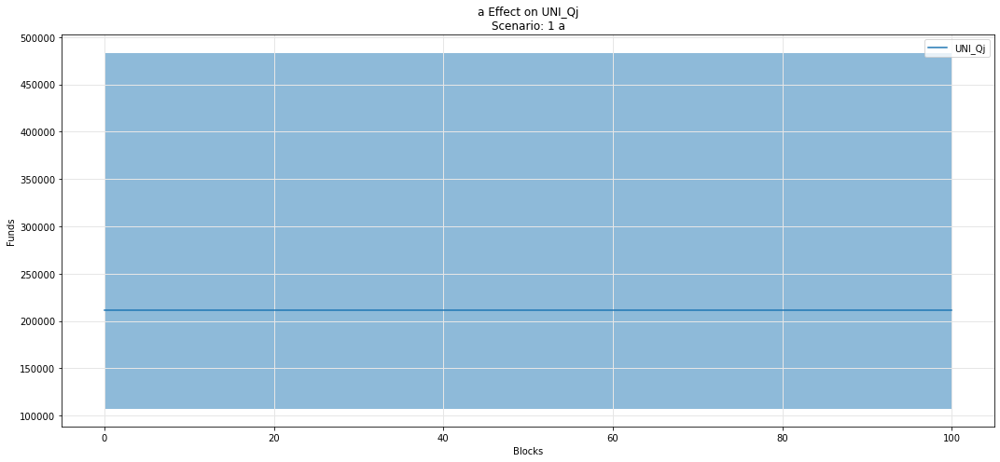

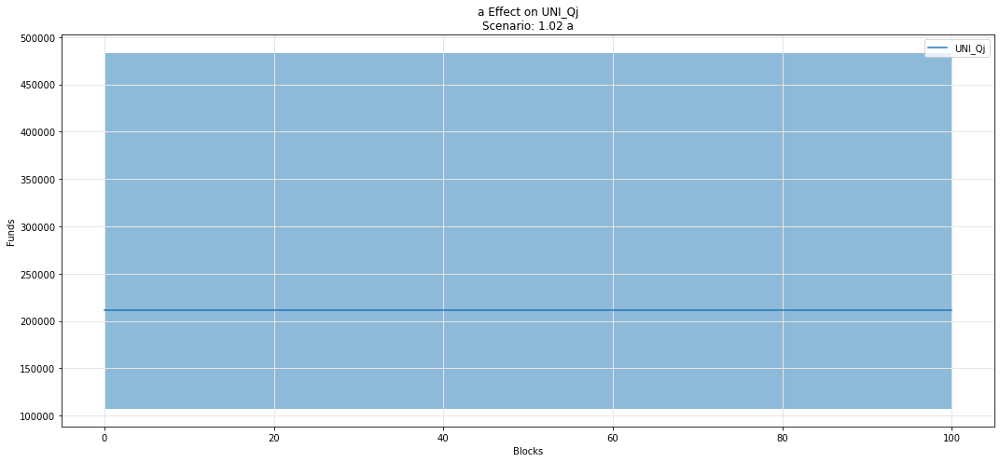

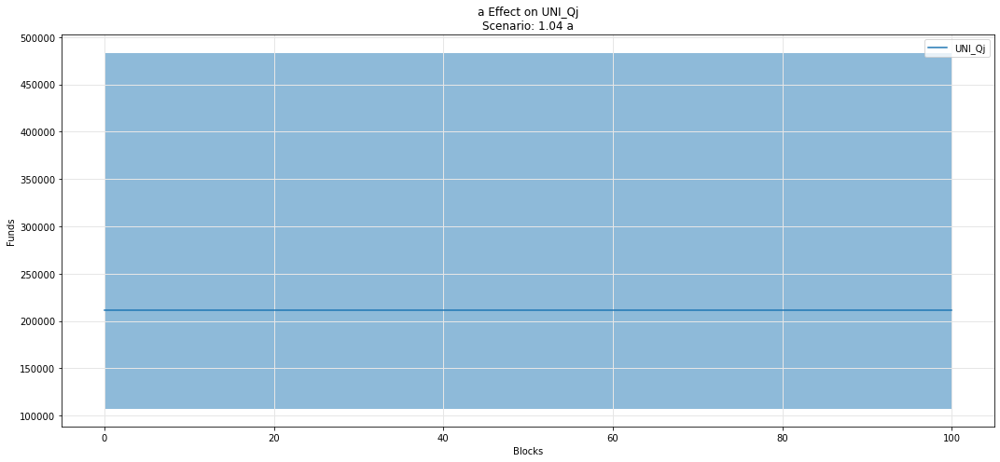

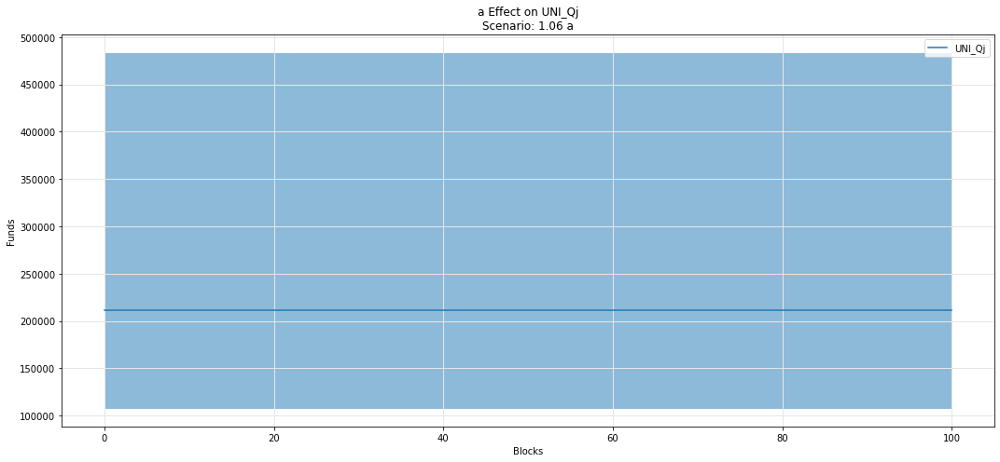

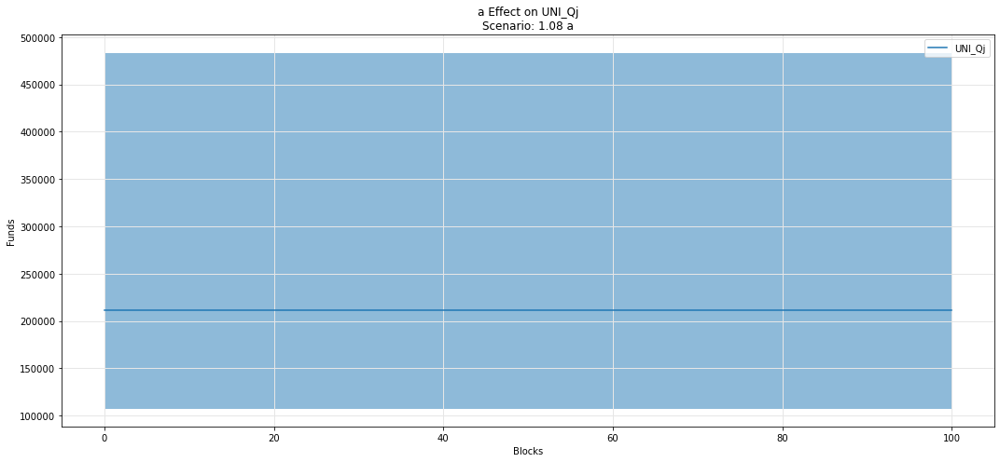

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

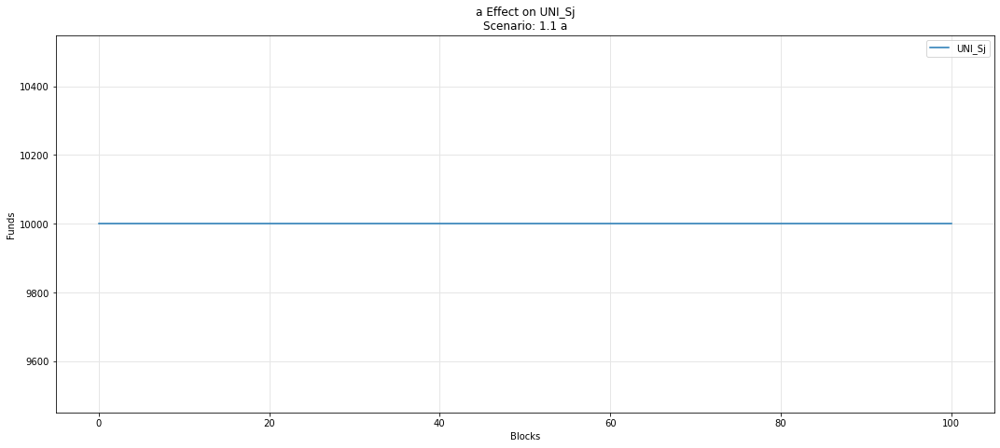

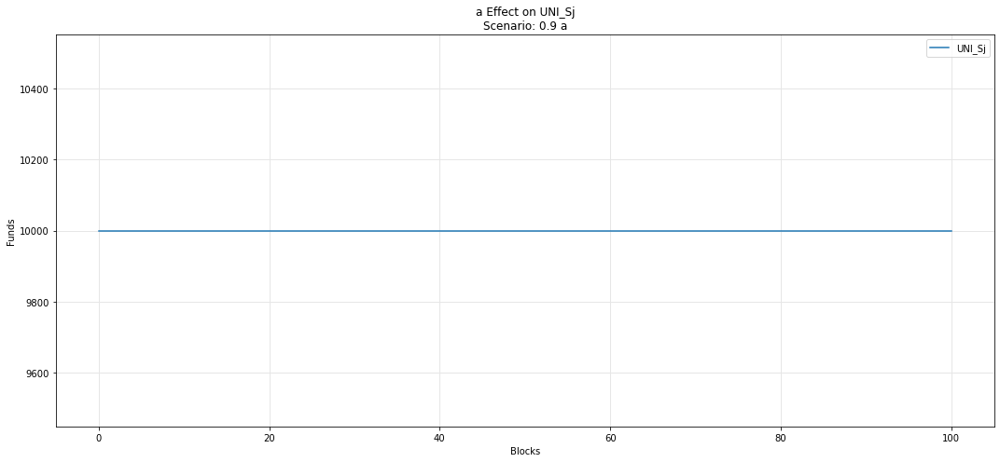

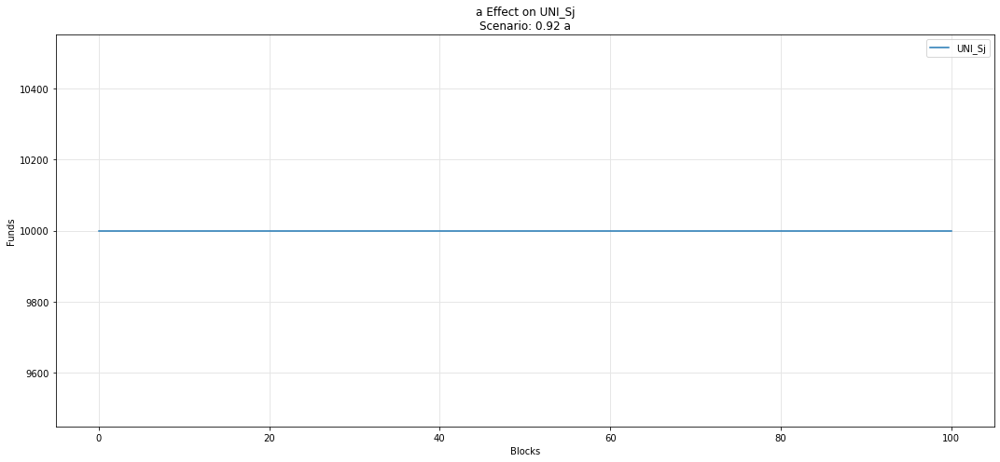

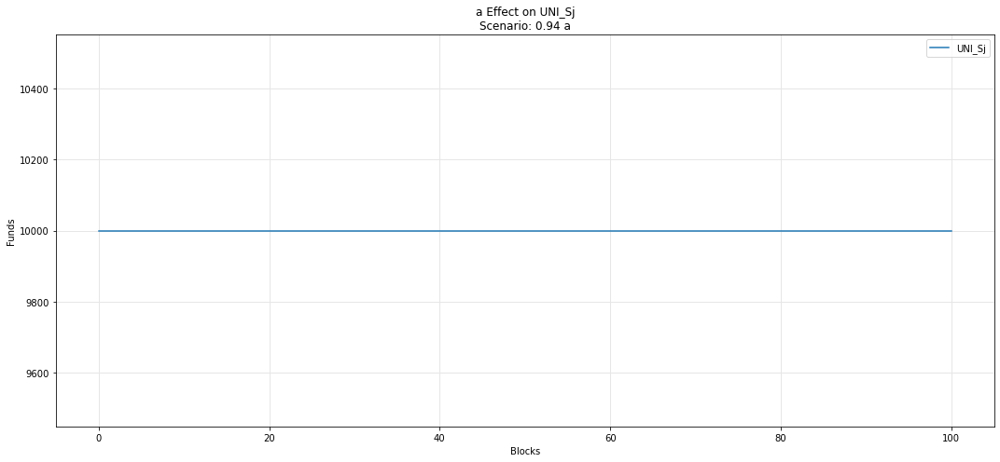

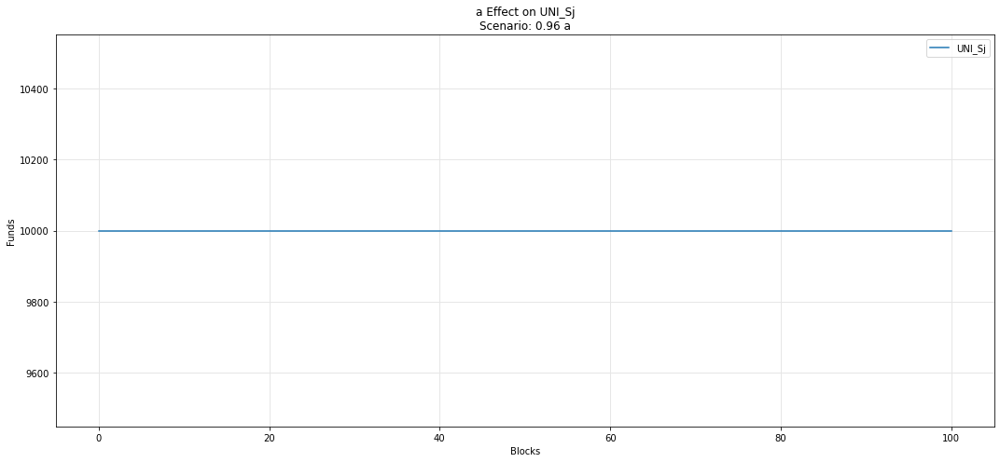

...

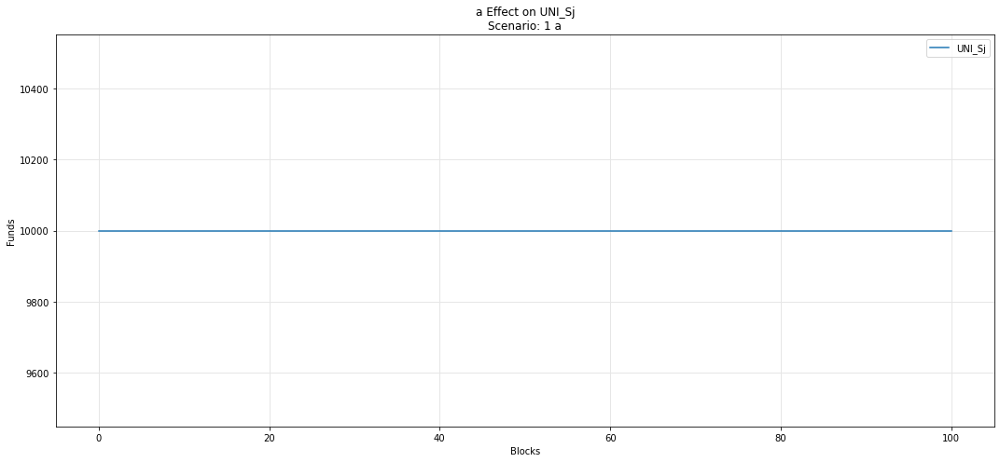

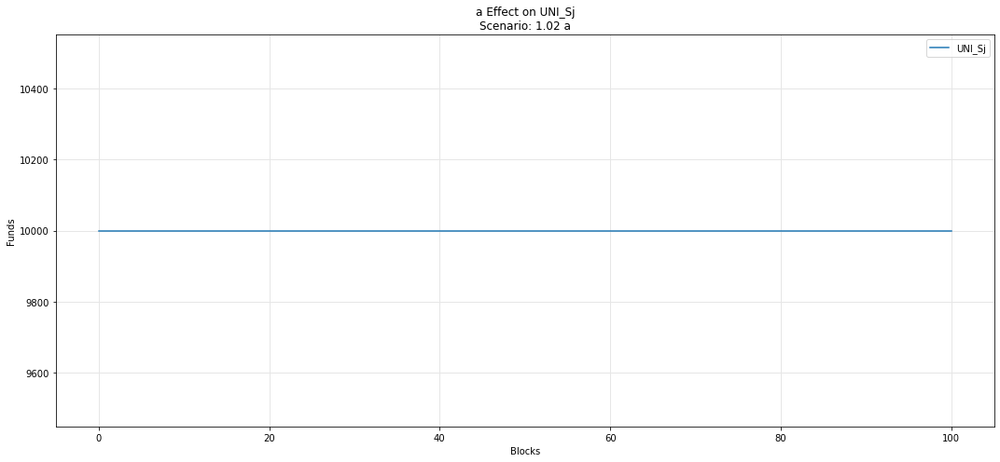

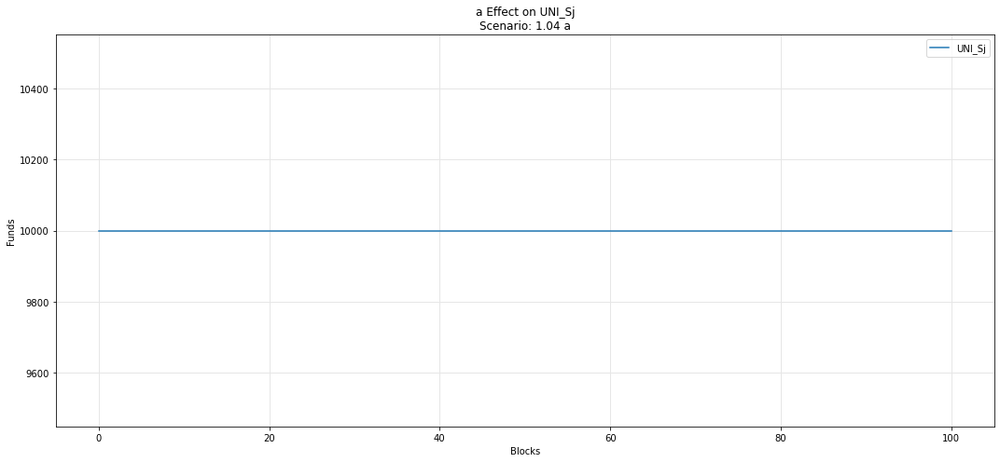

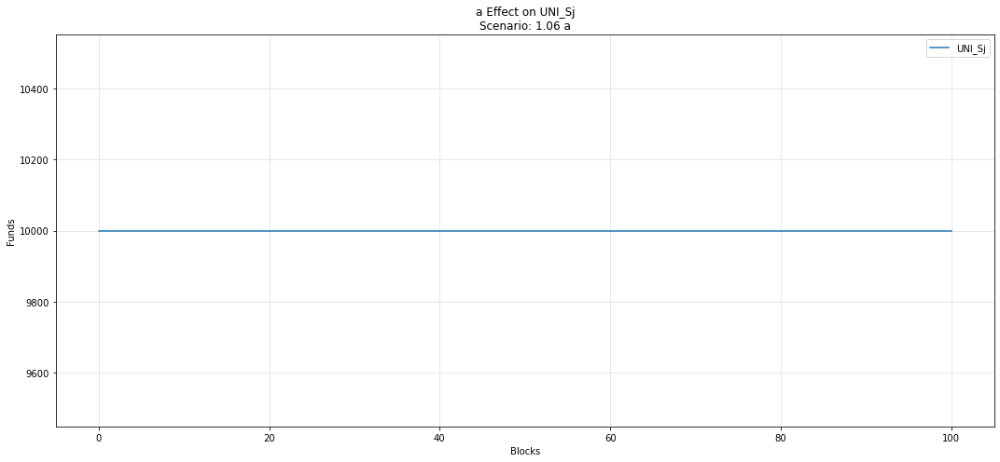

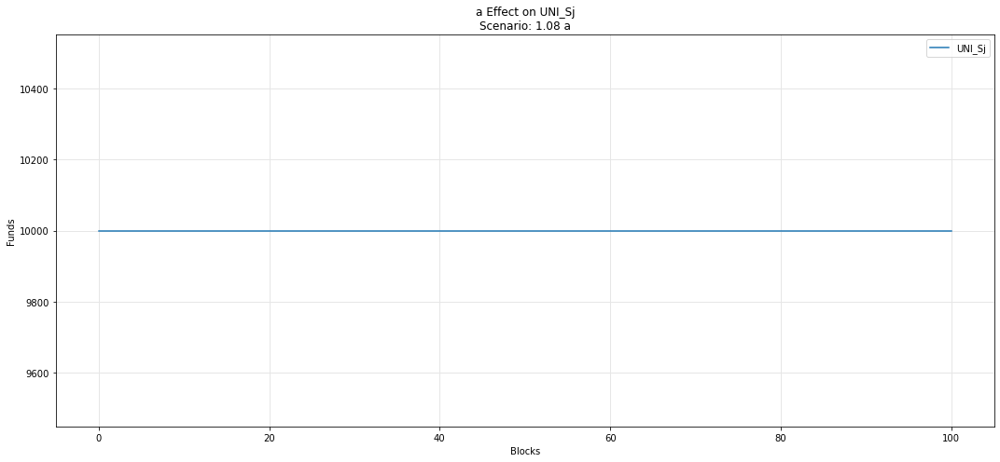

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

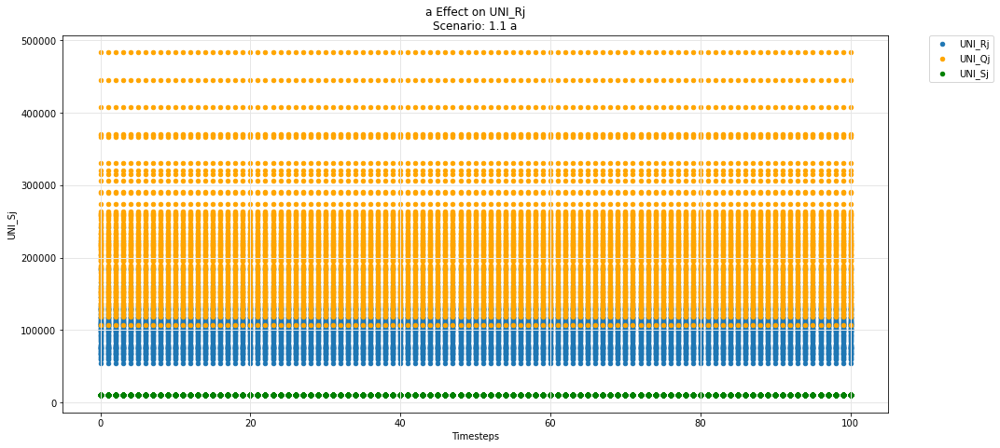

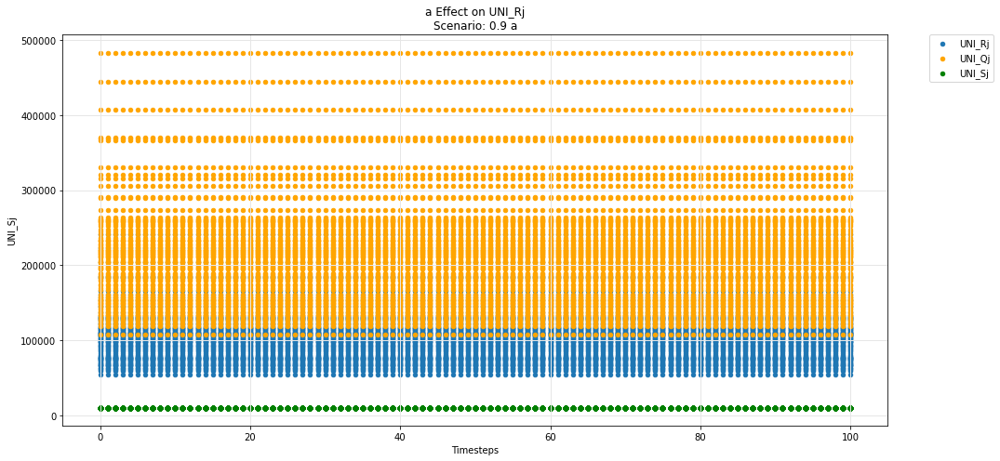

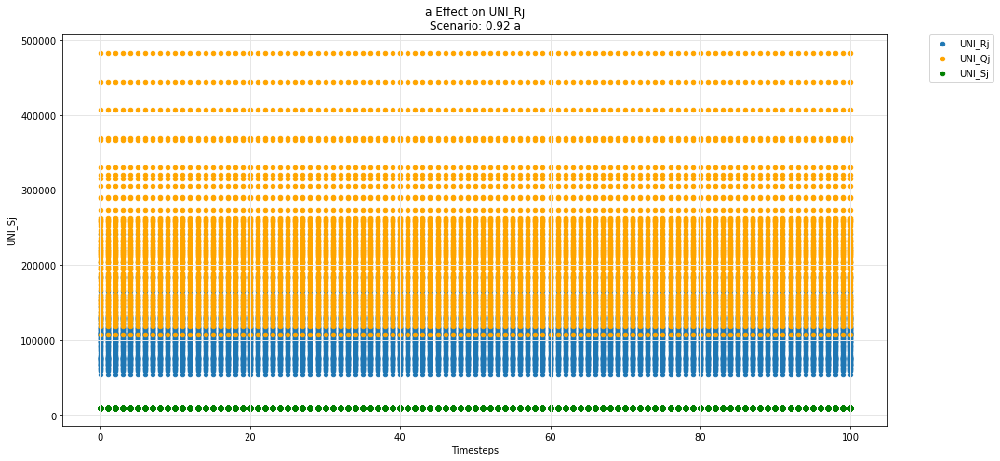

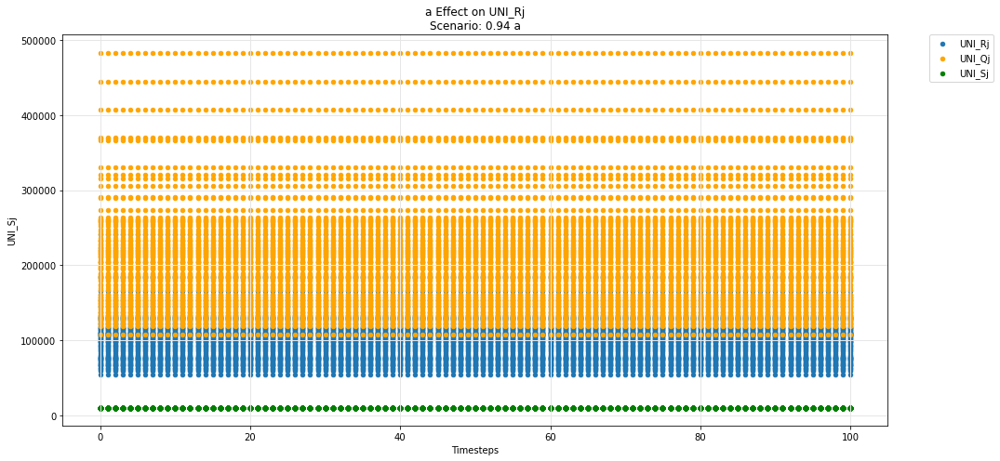

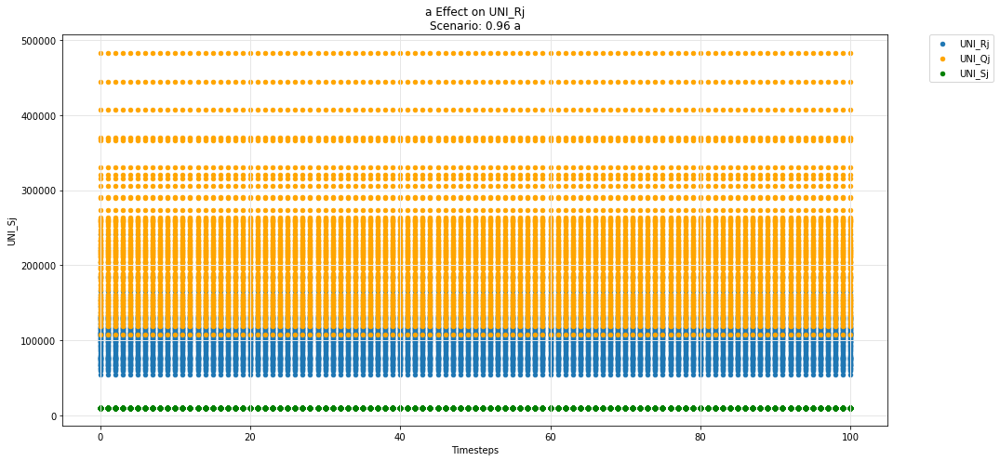

...

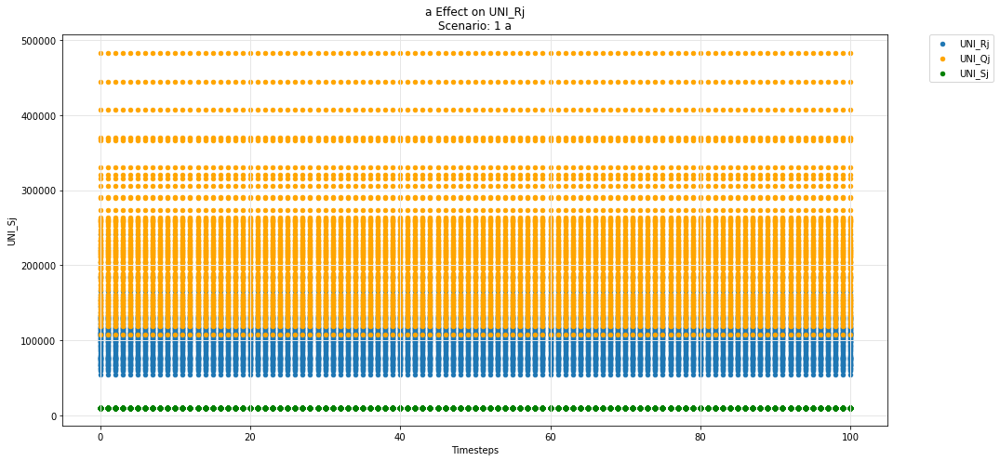

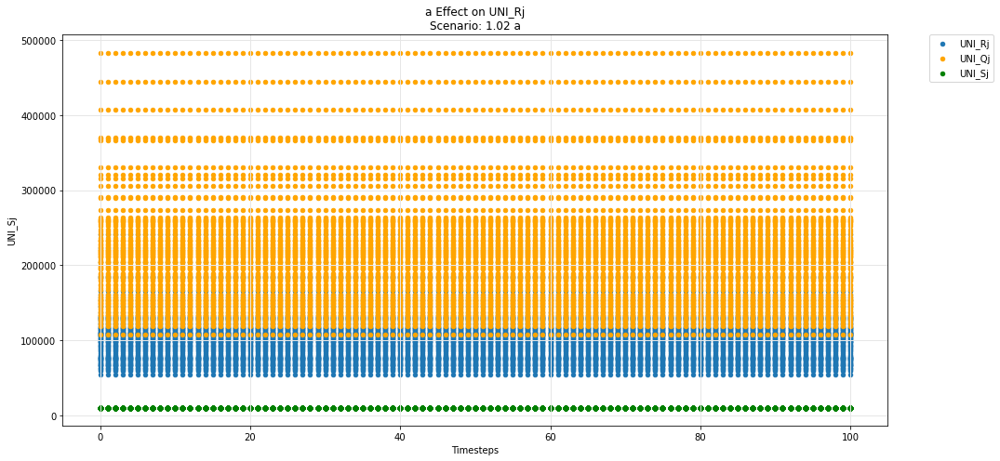

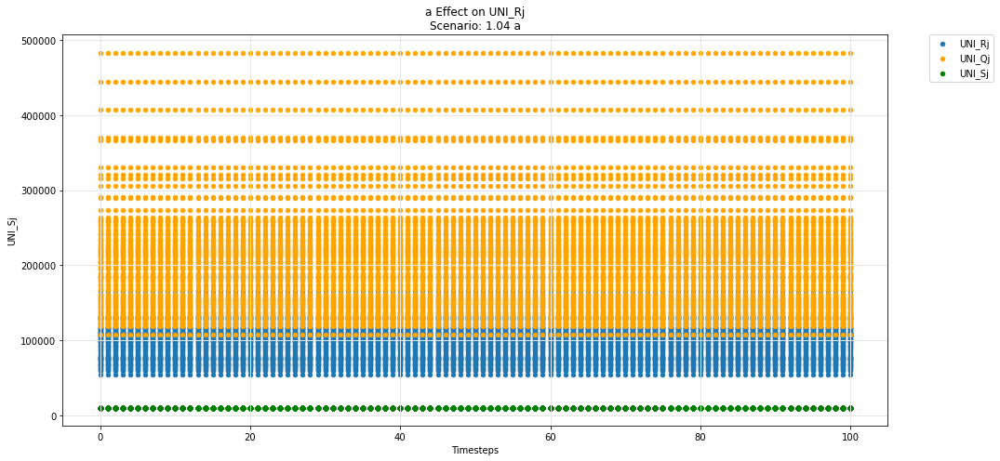

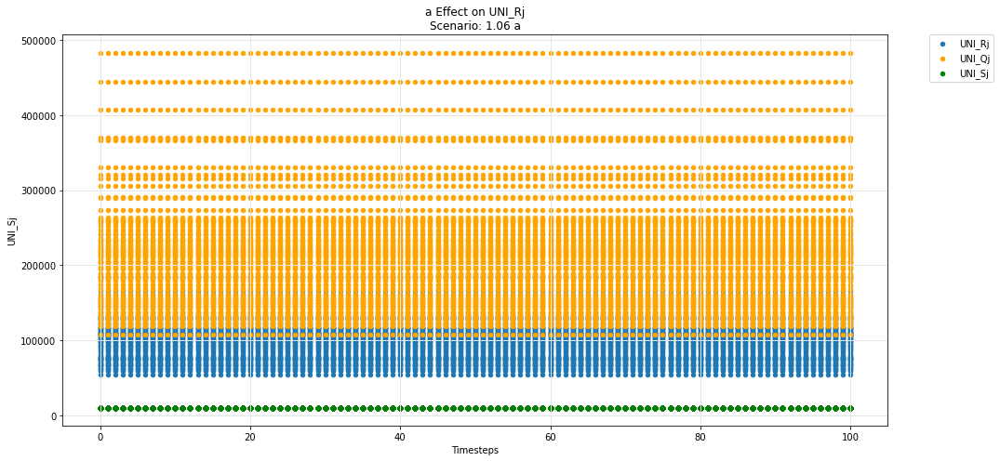

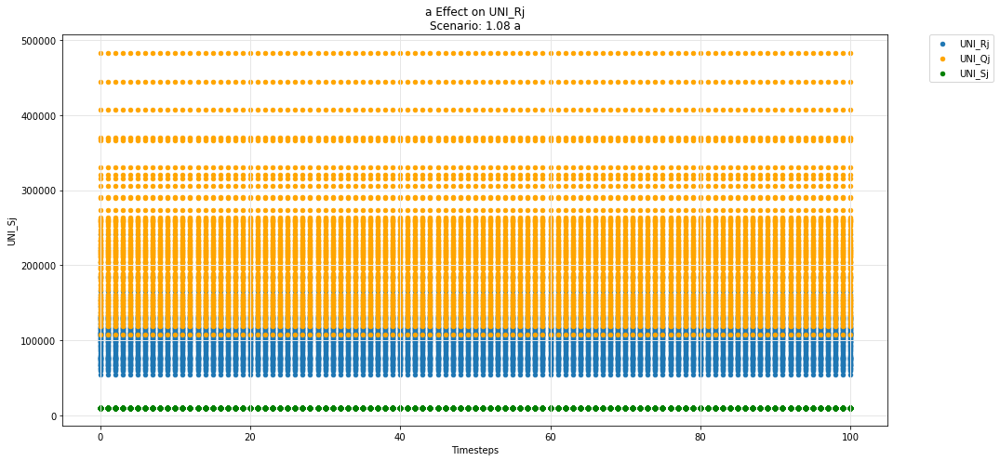

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

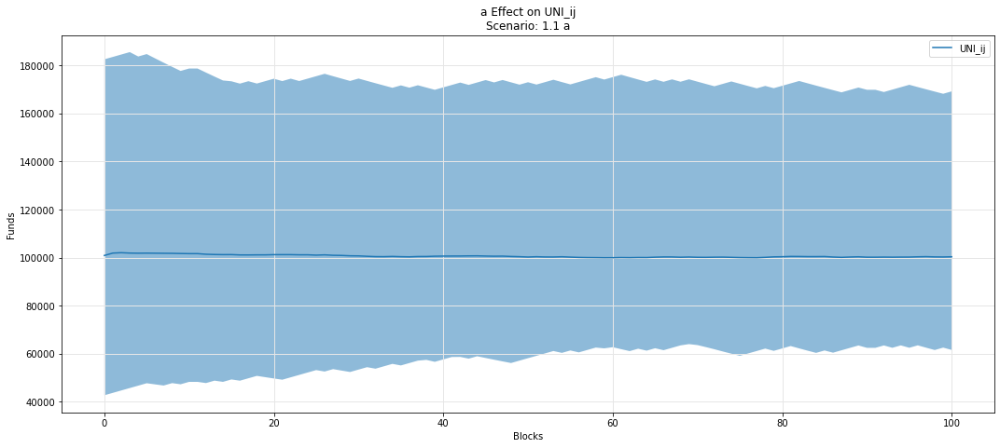

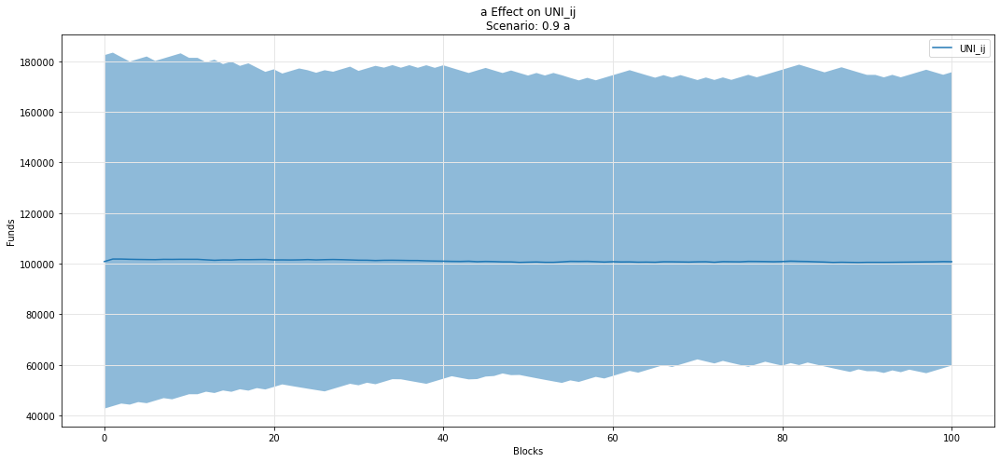

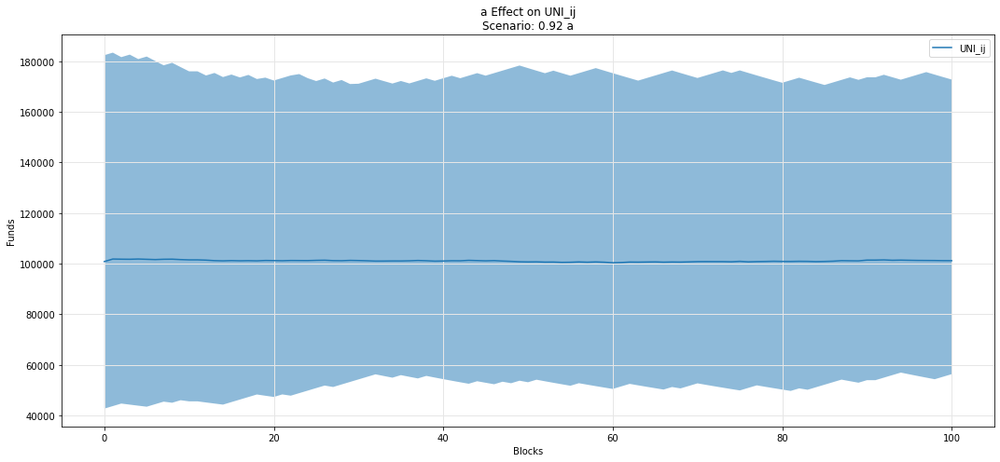

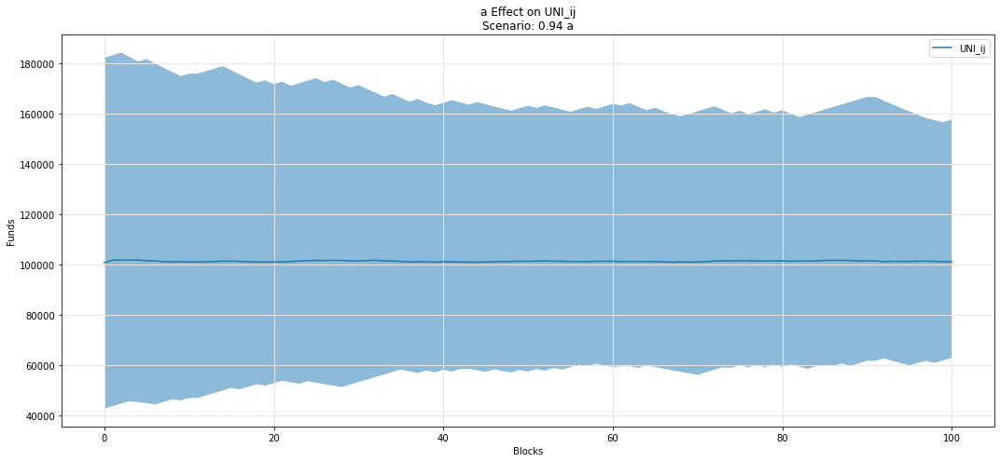

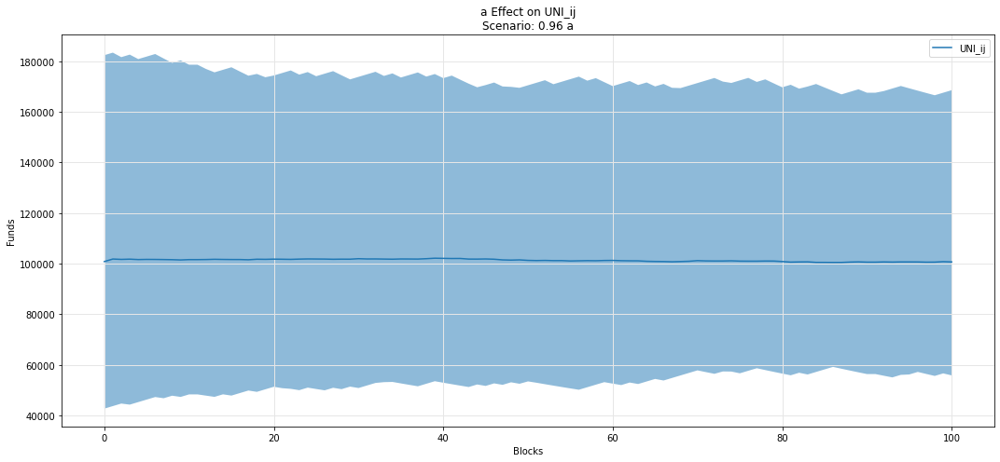

...

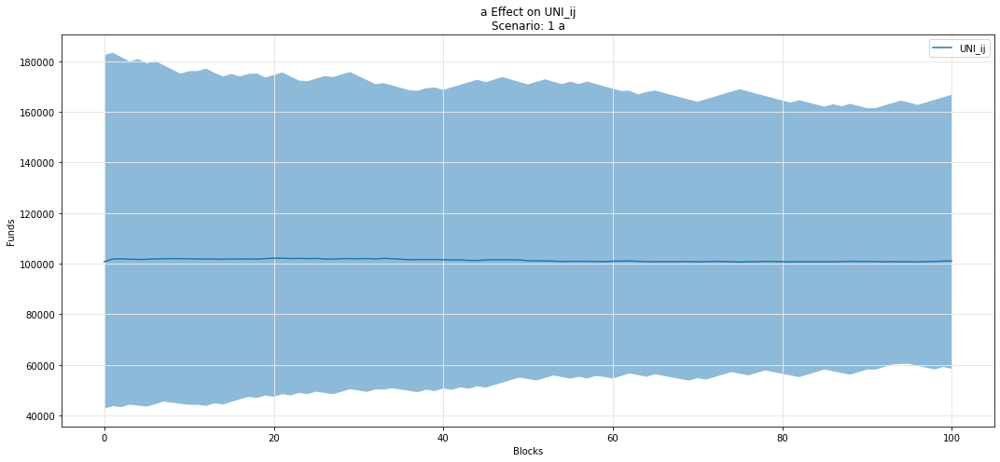

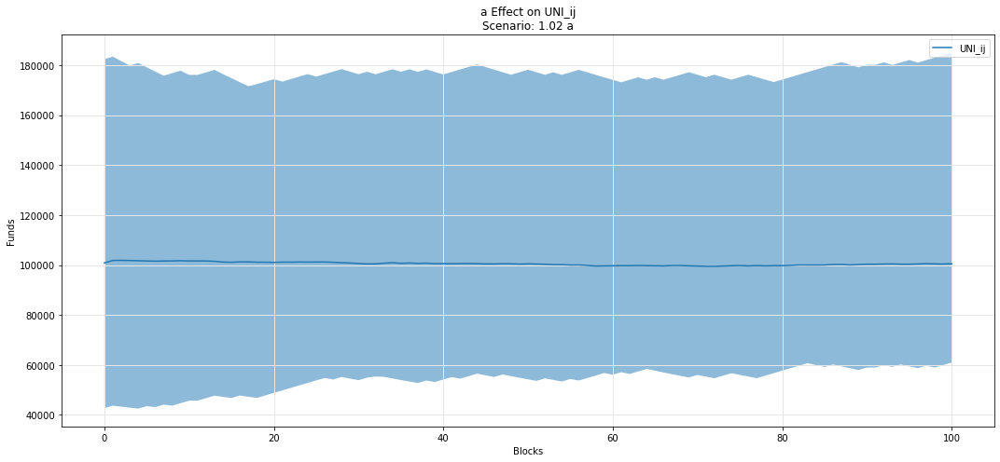

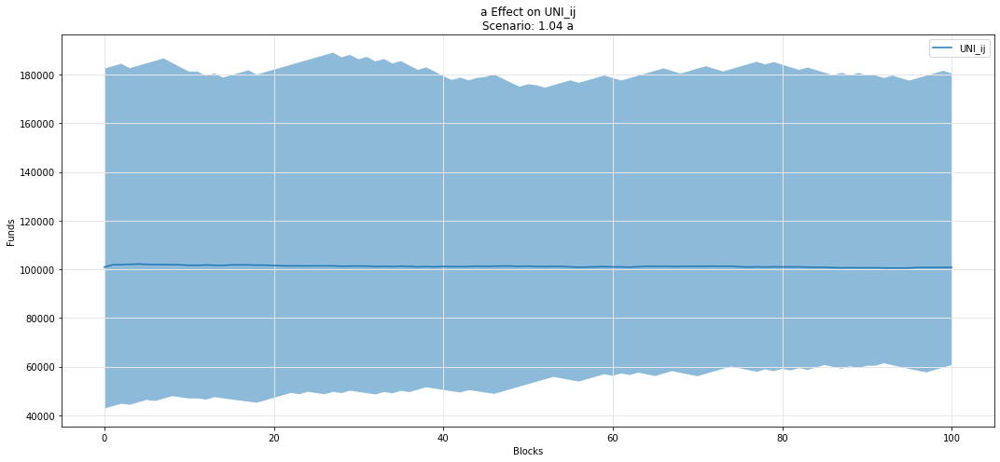

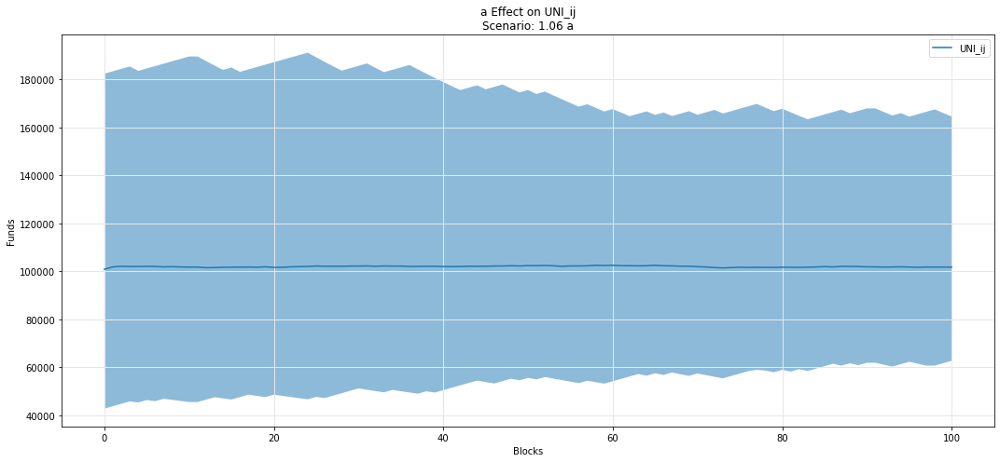

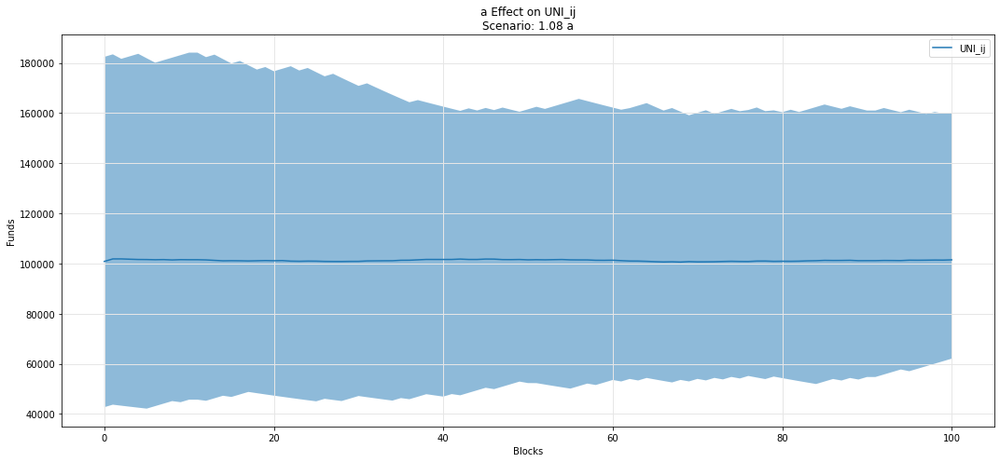

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

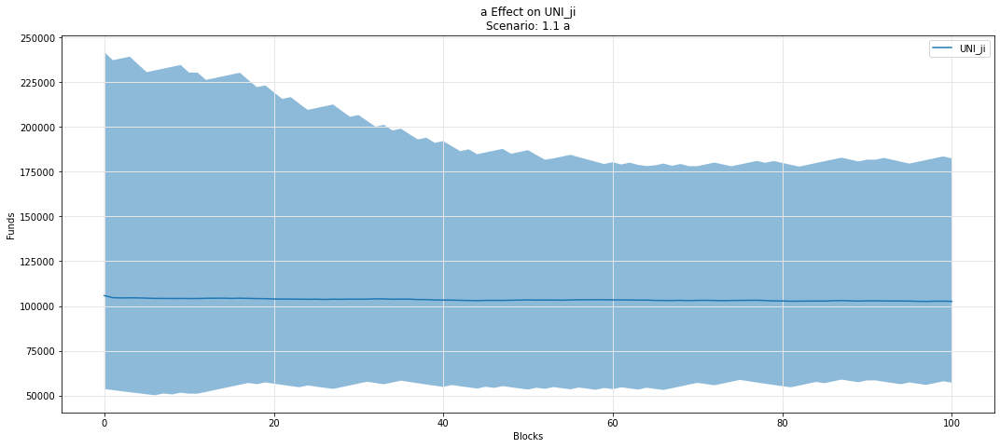

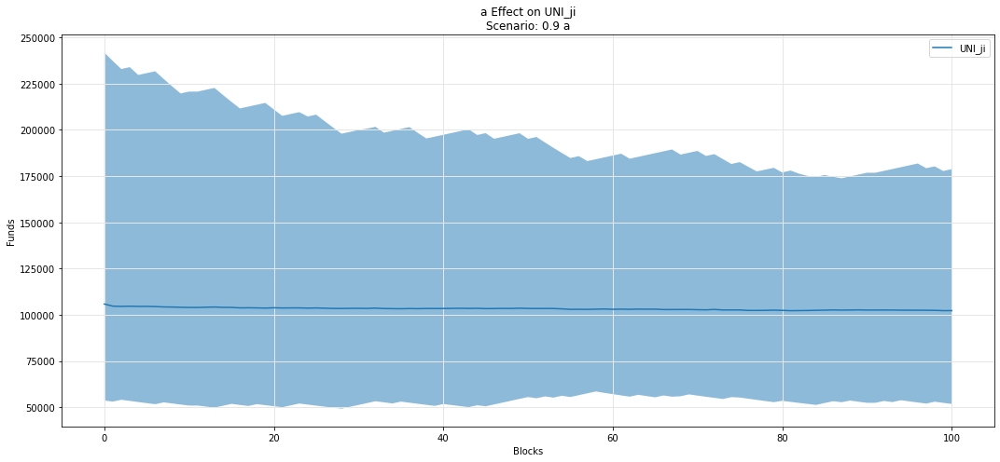

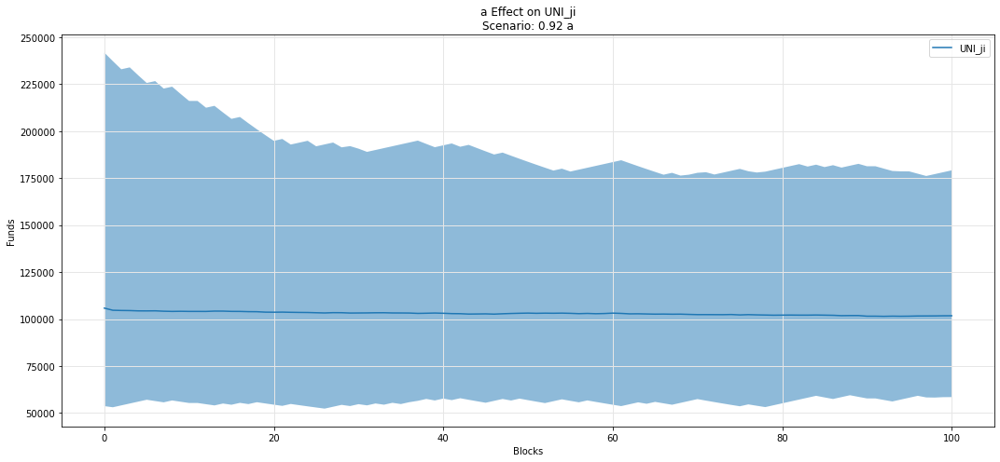

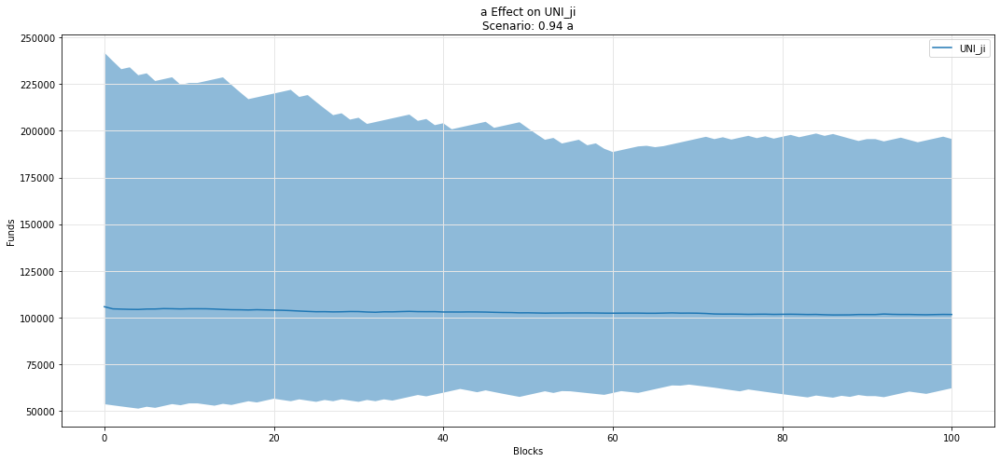

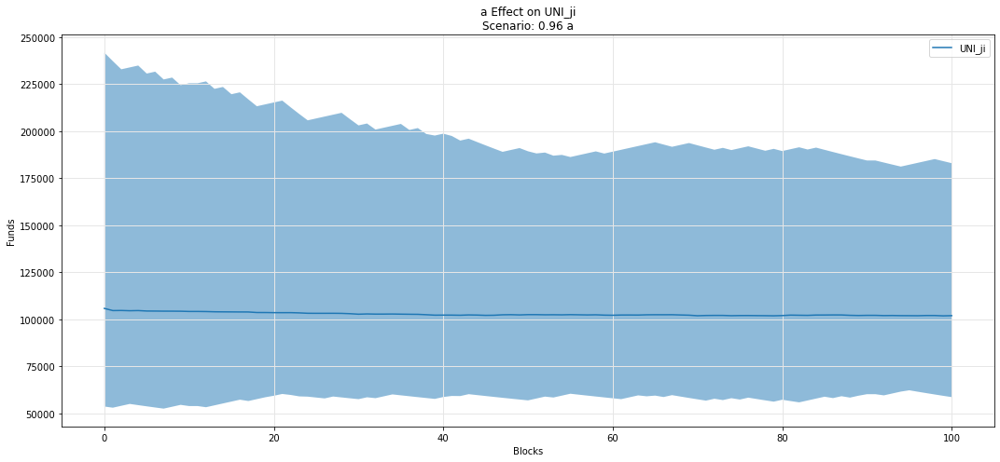

...

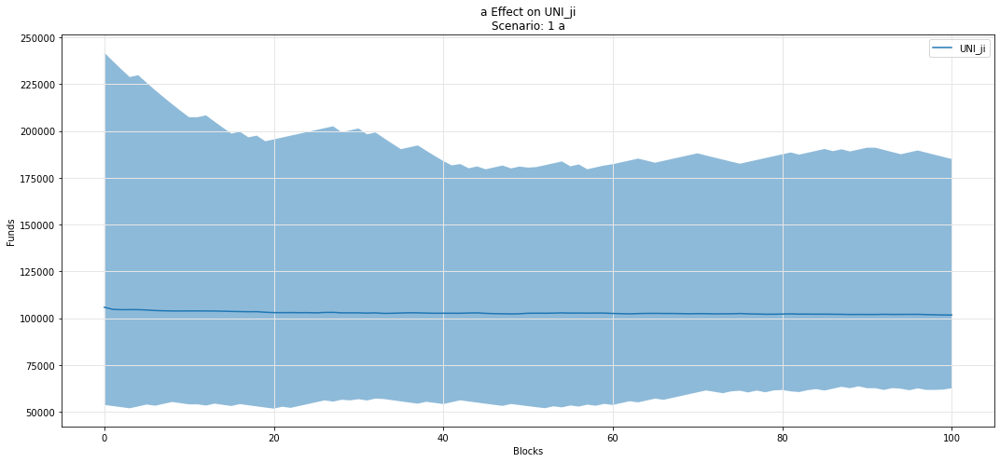

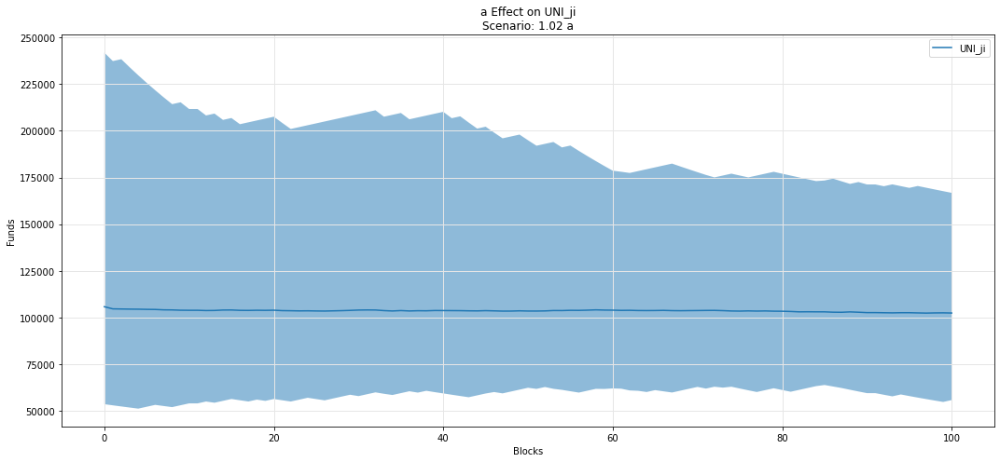

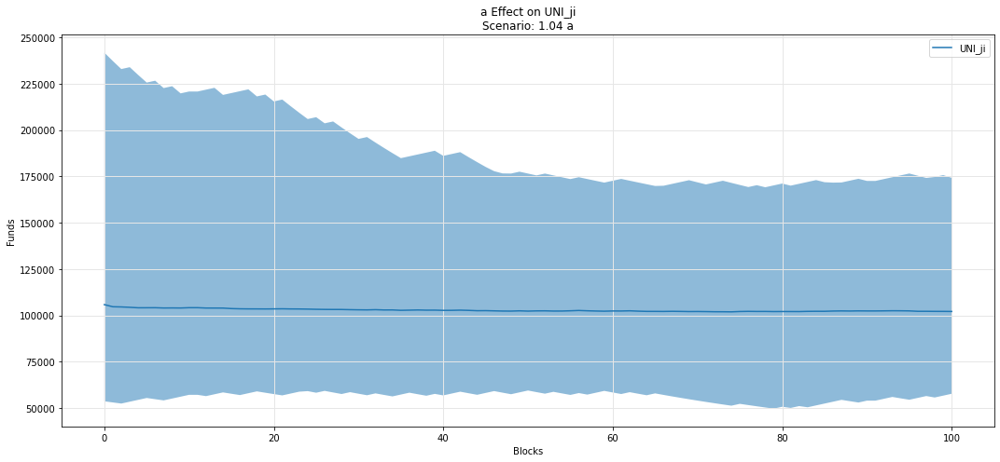

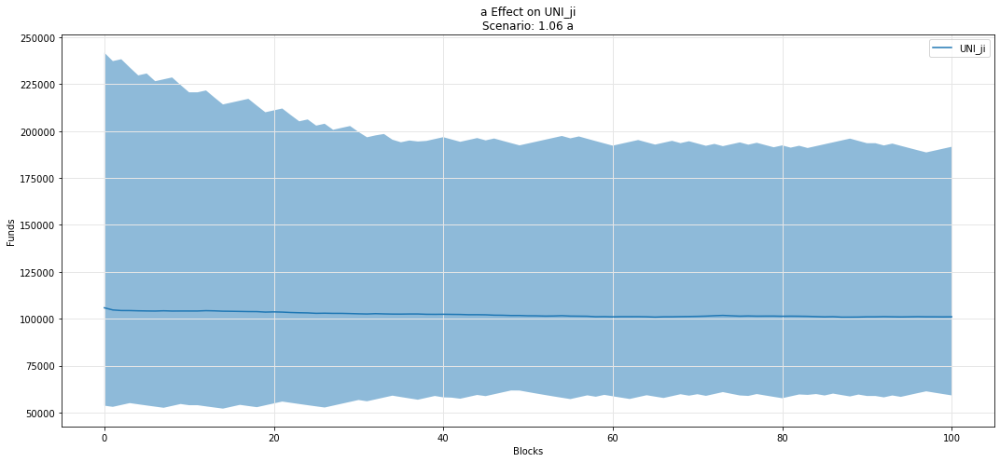

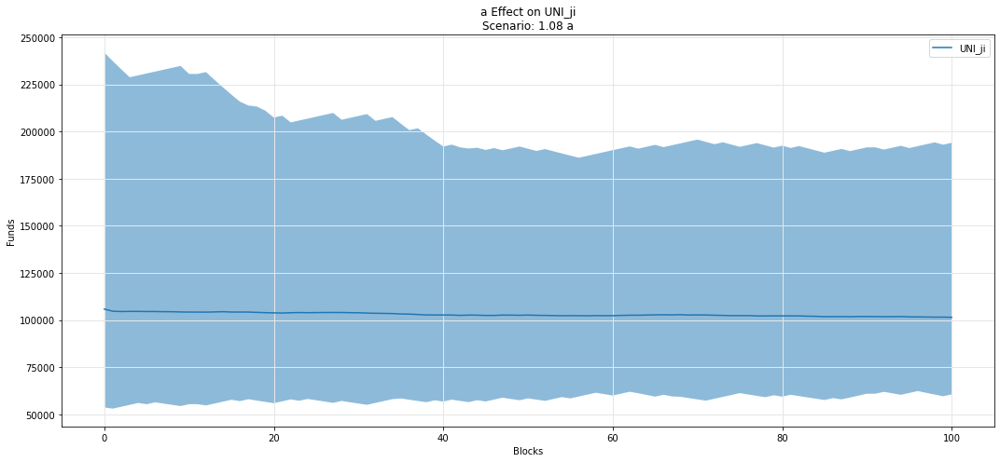

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

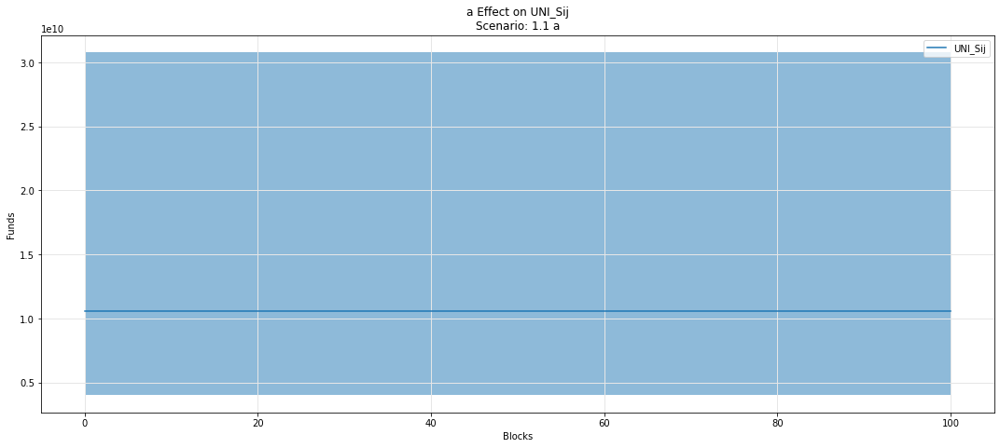

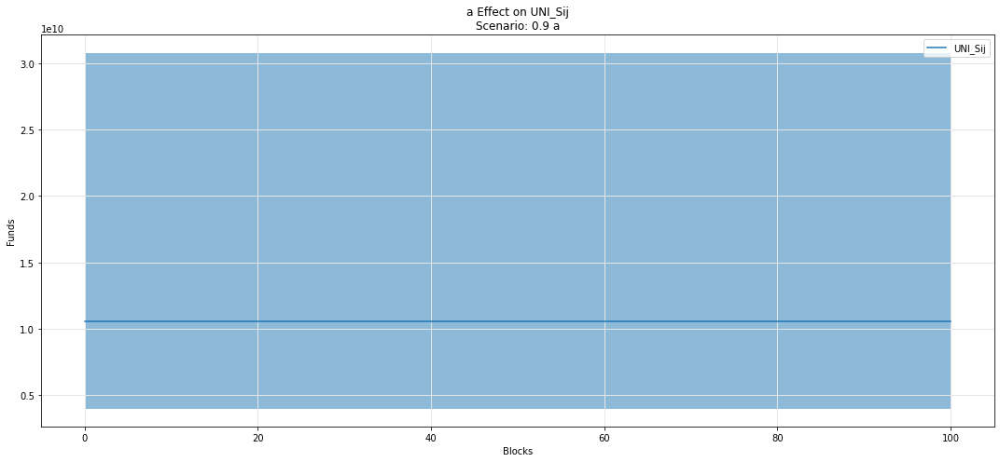

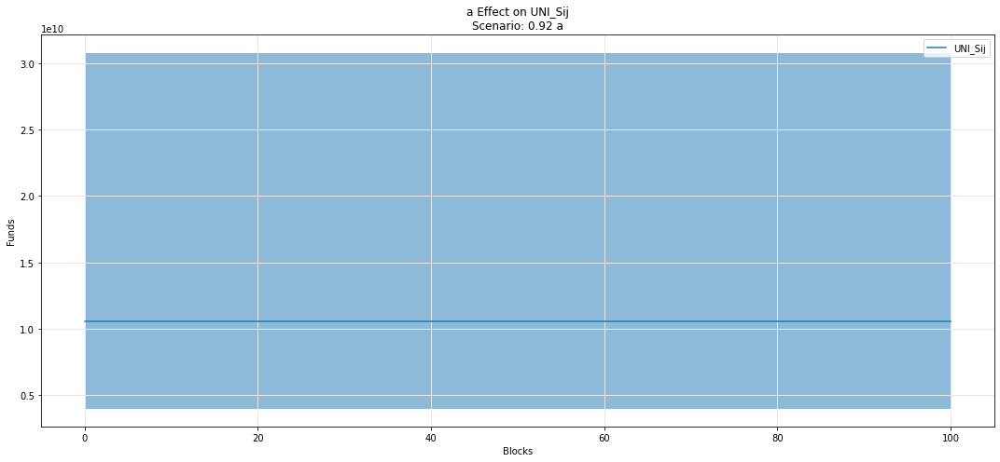

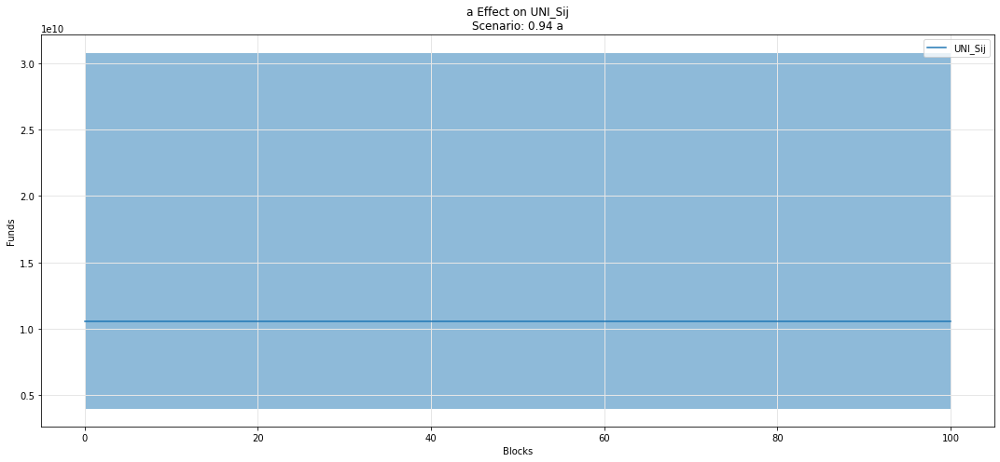

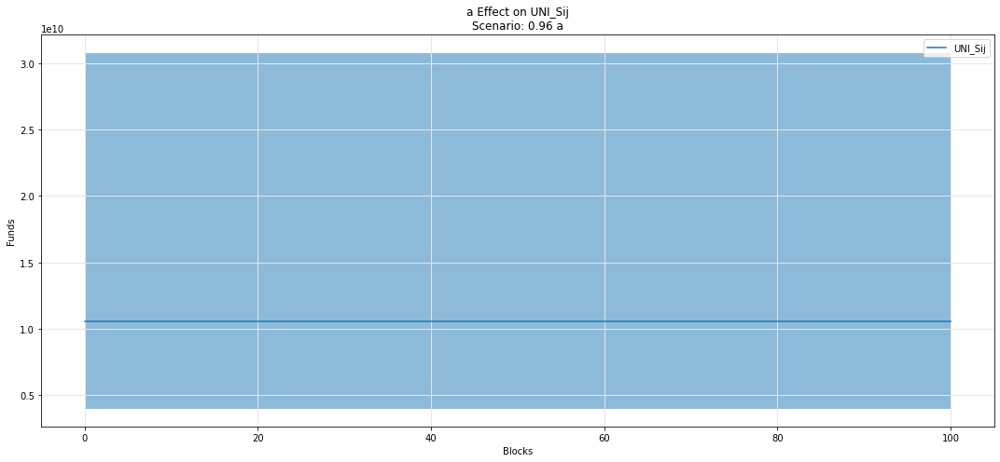

...

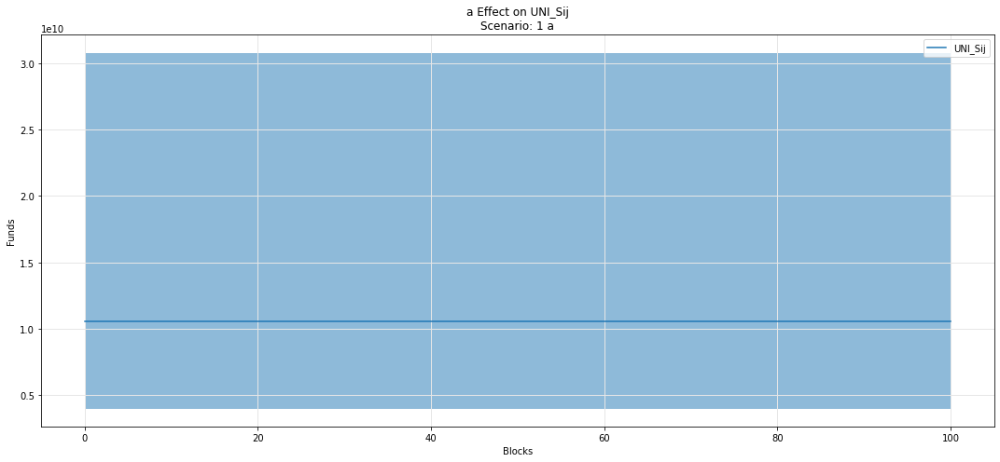

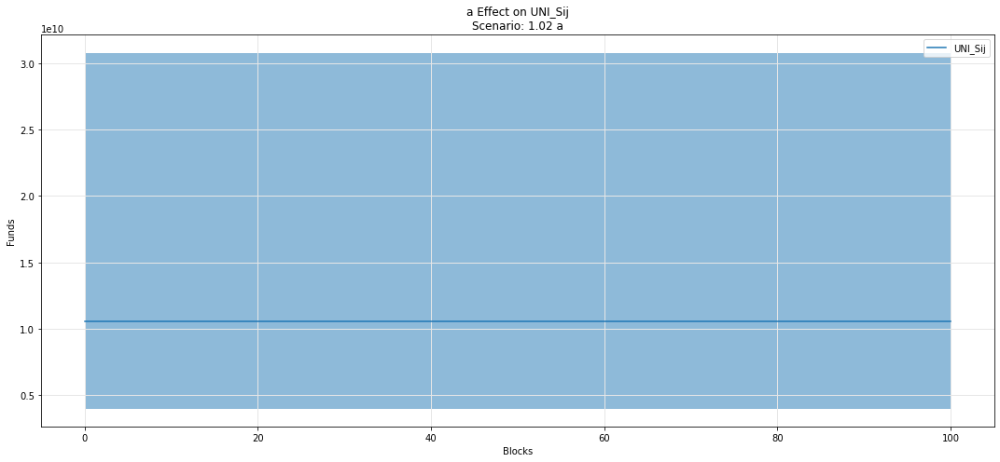

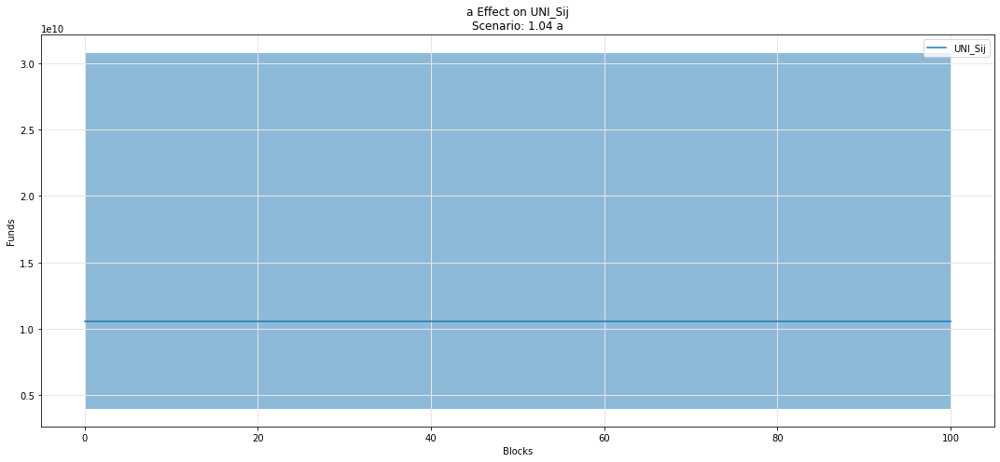

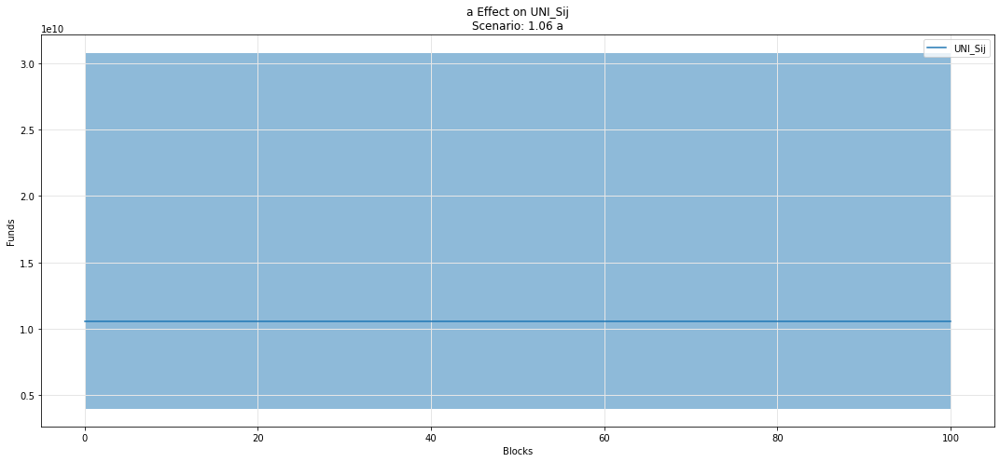

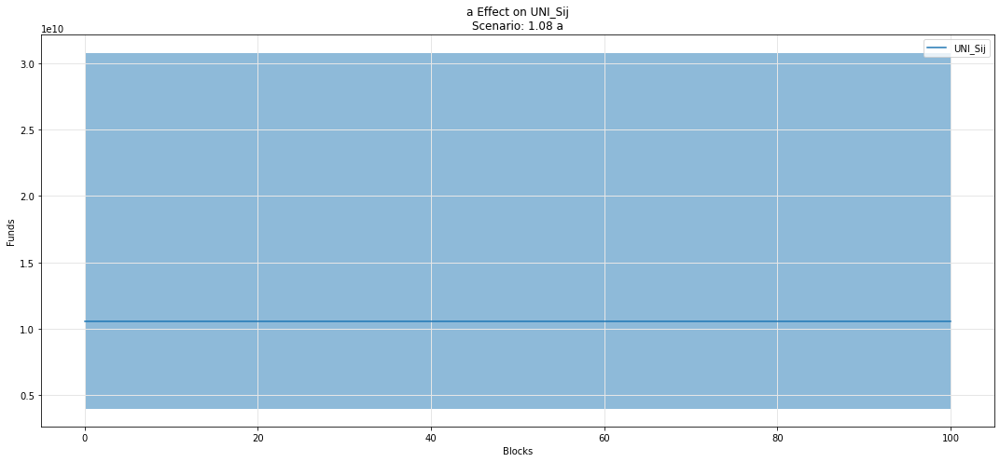

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

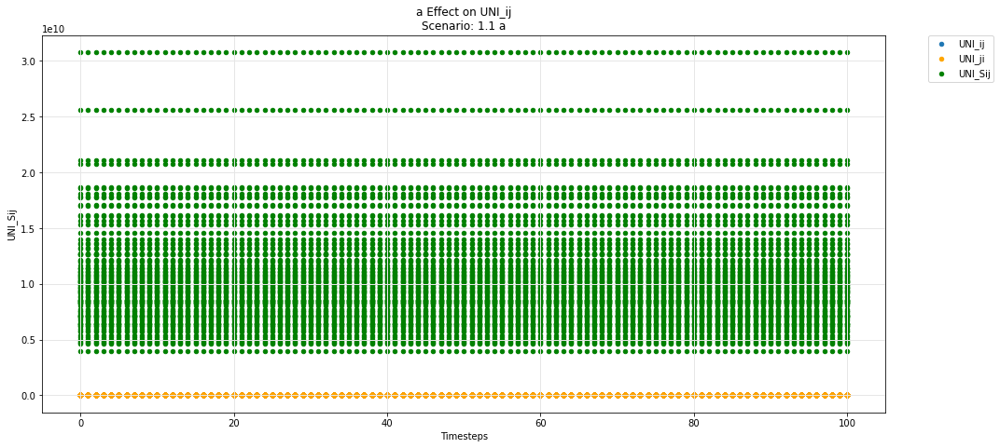

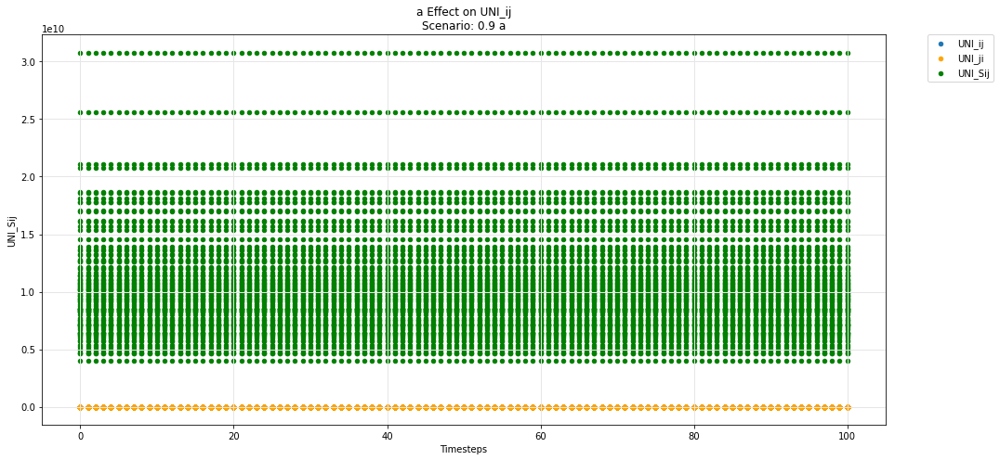

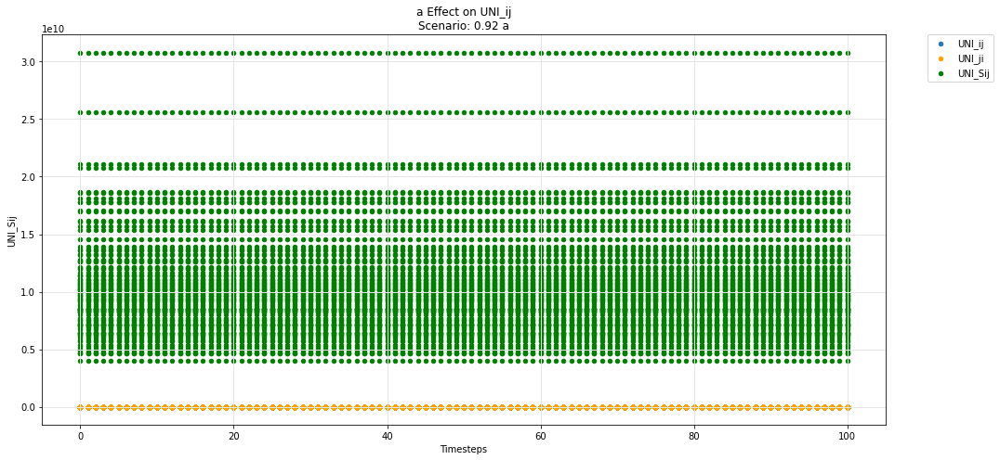

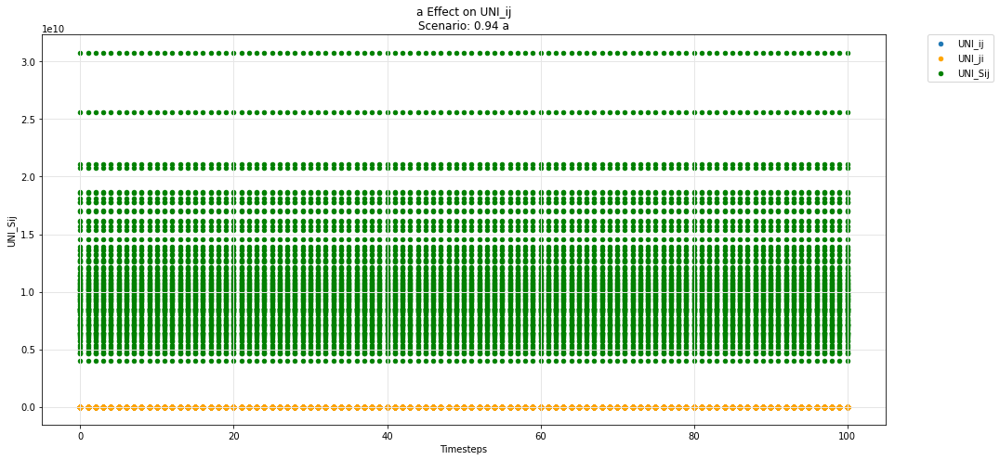

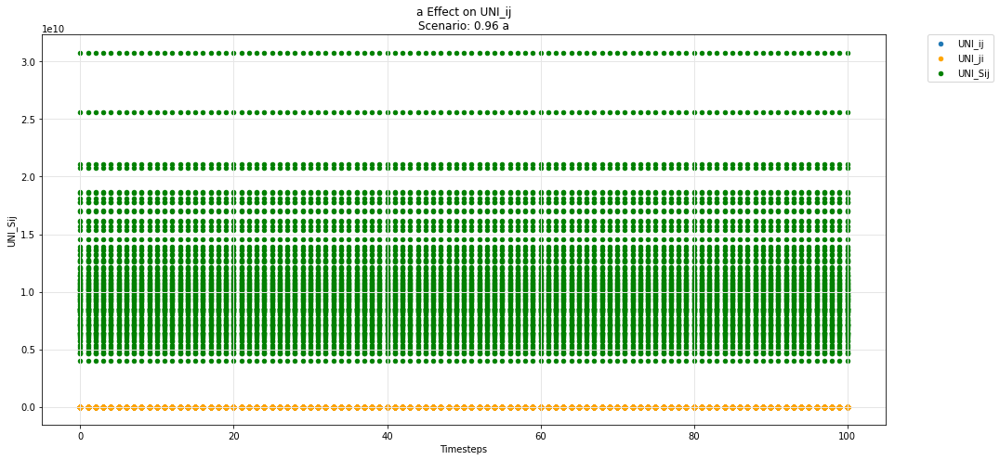

...

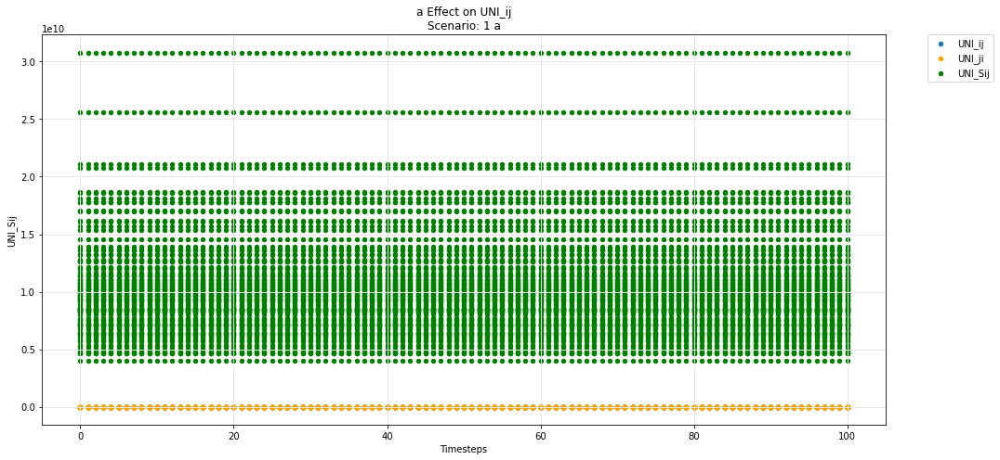

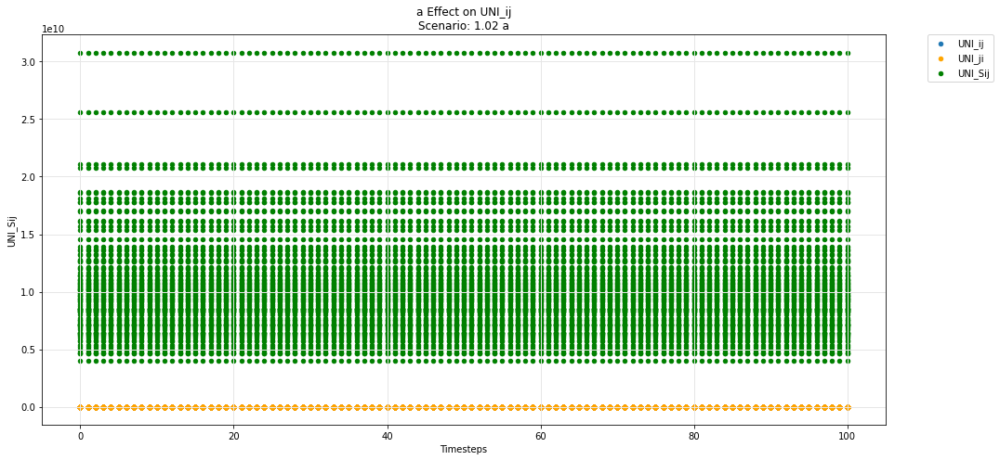

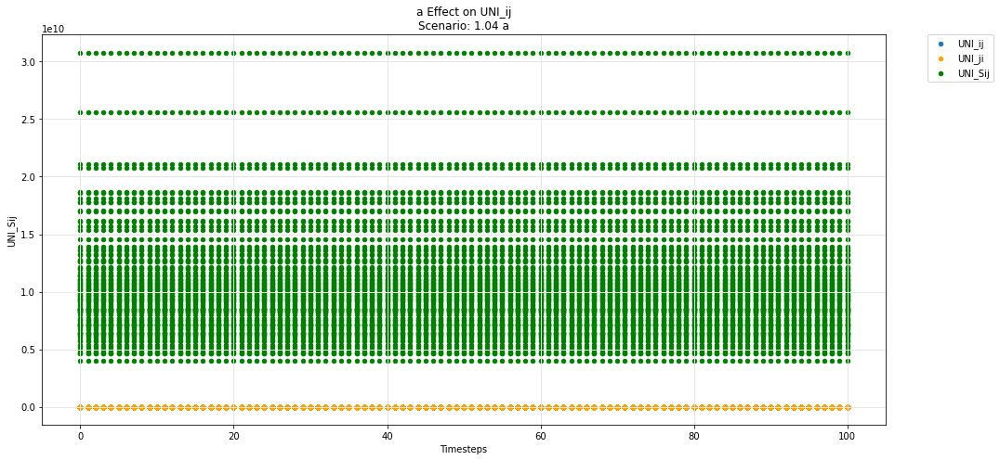

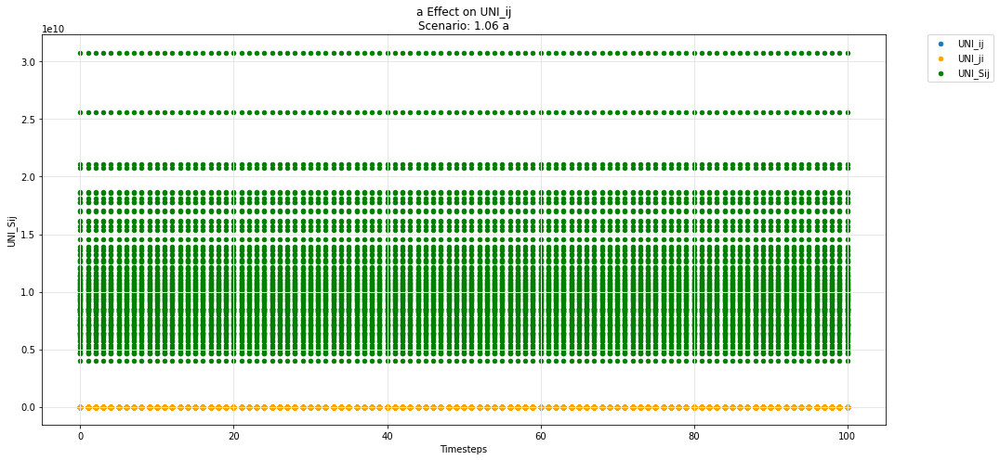

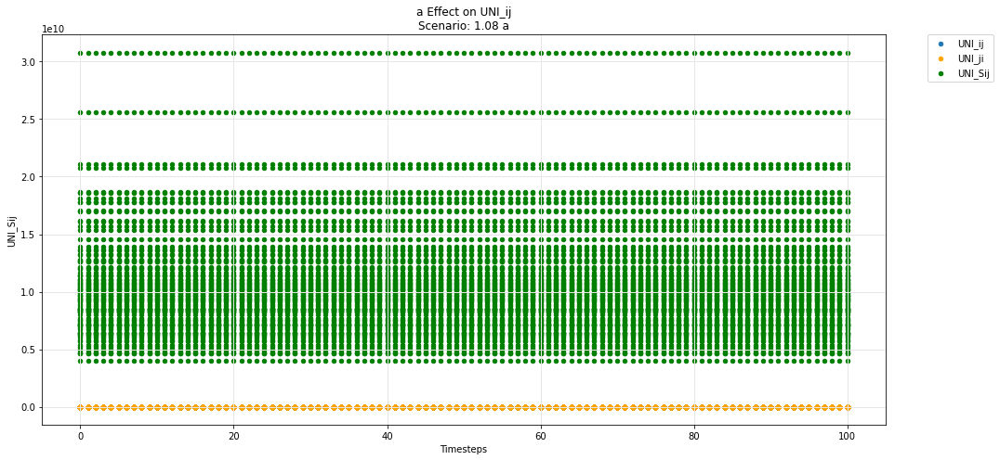

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

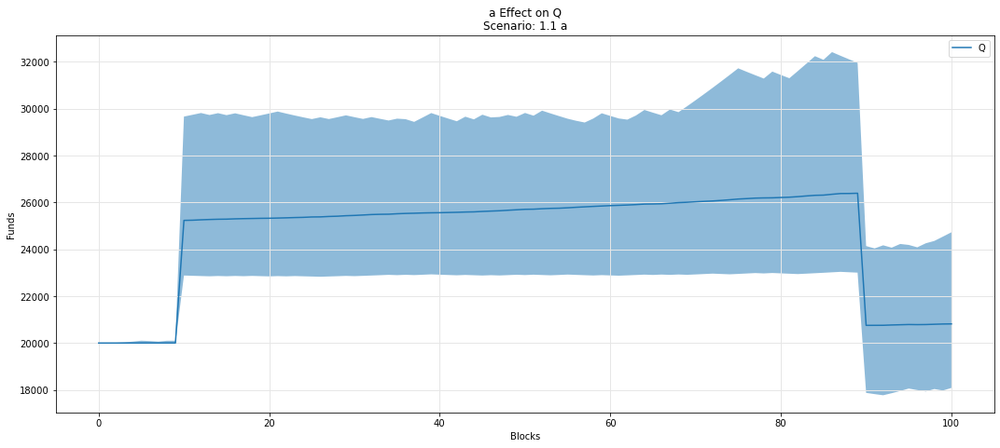

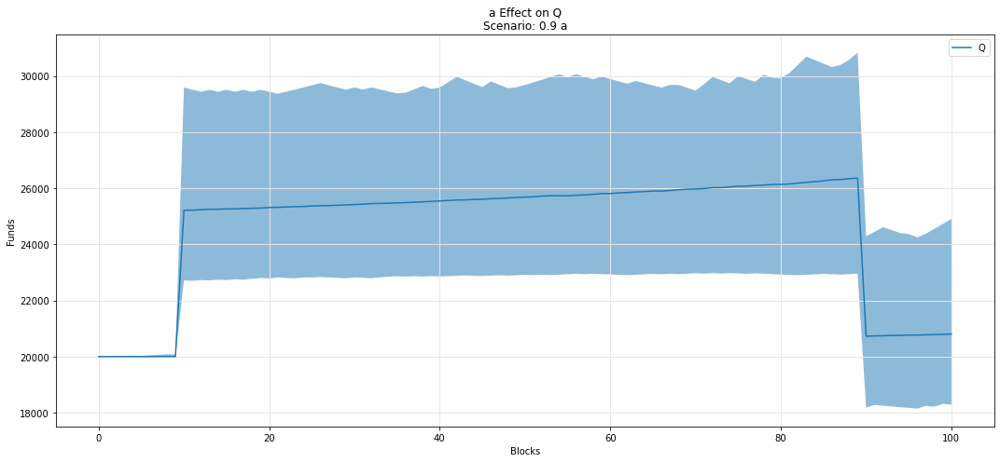

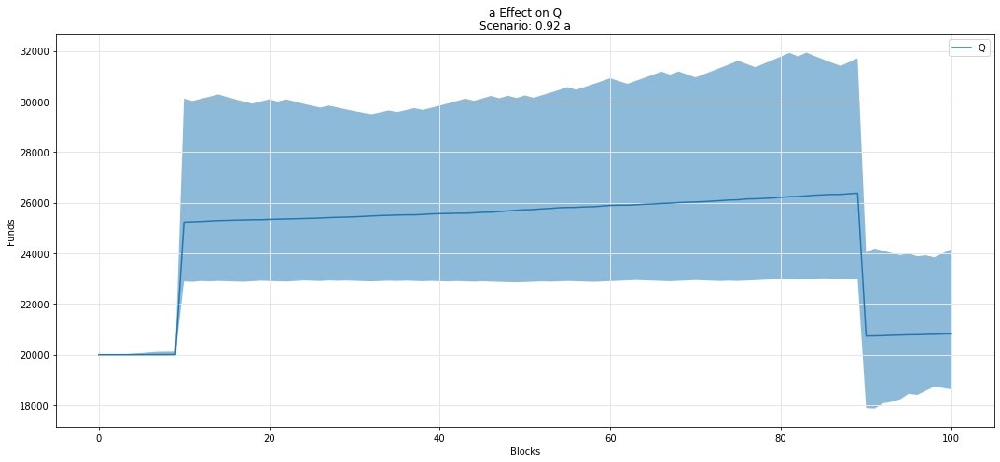

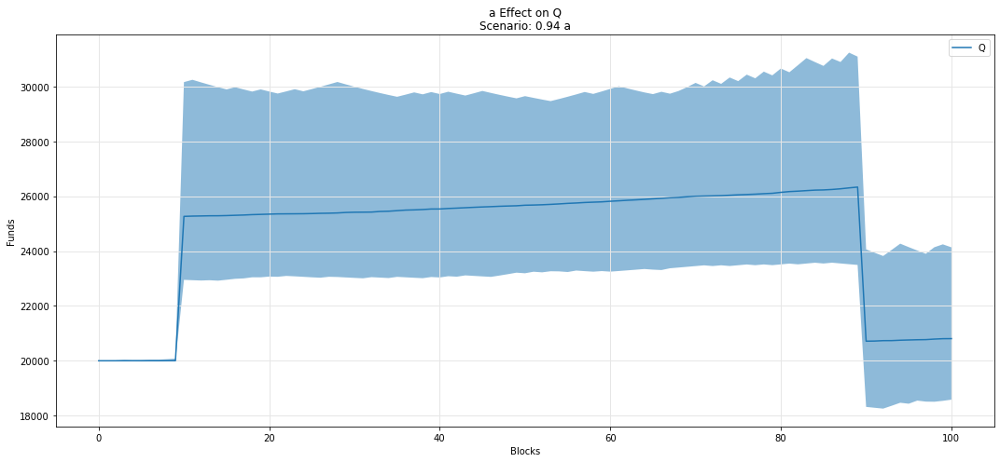

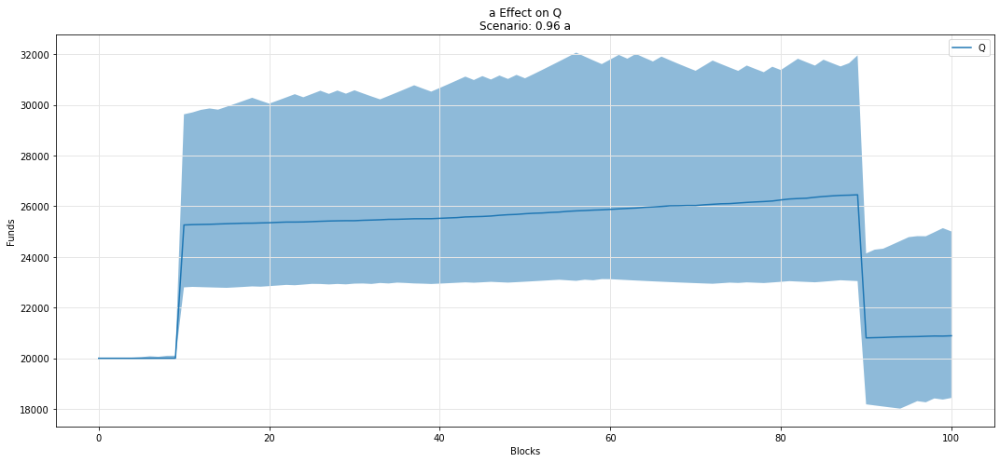

...

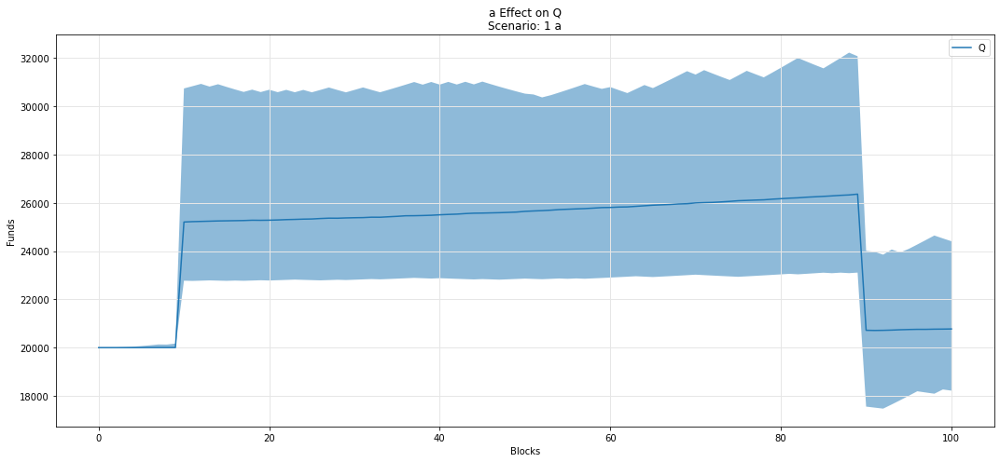

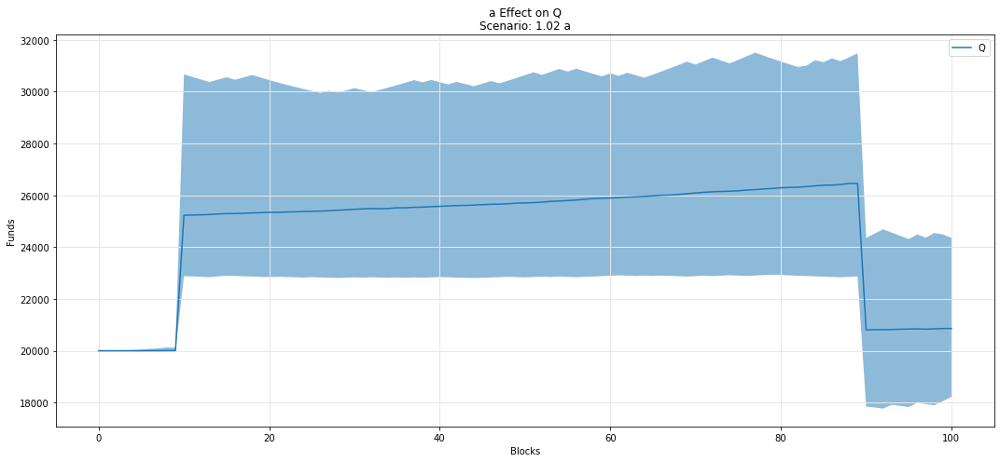

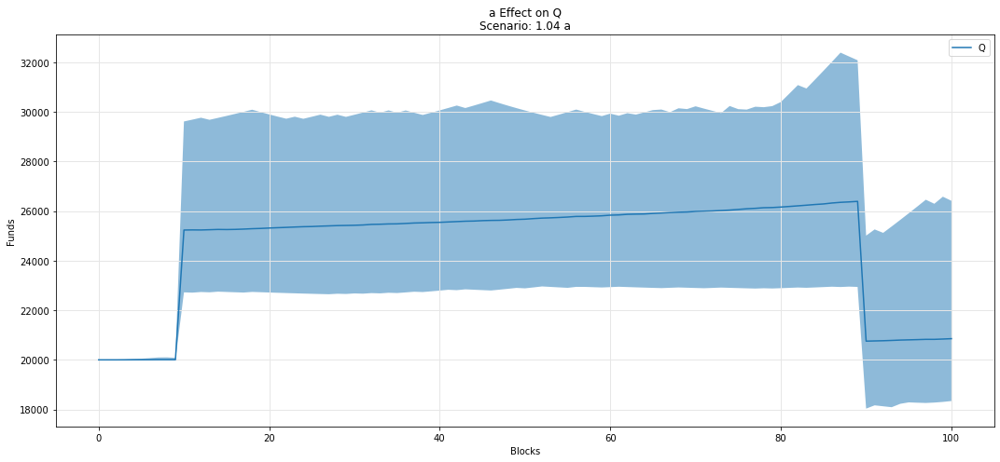

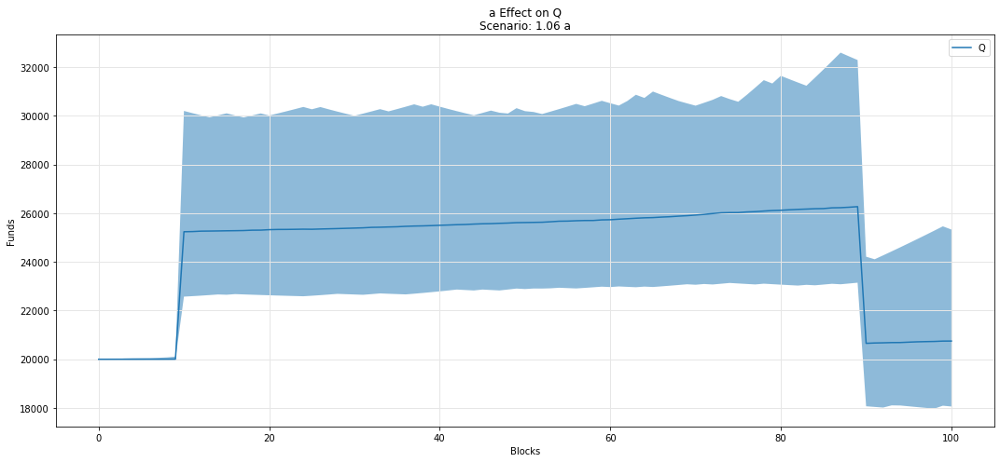

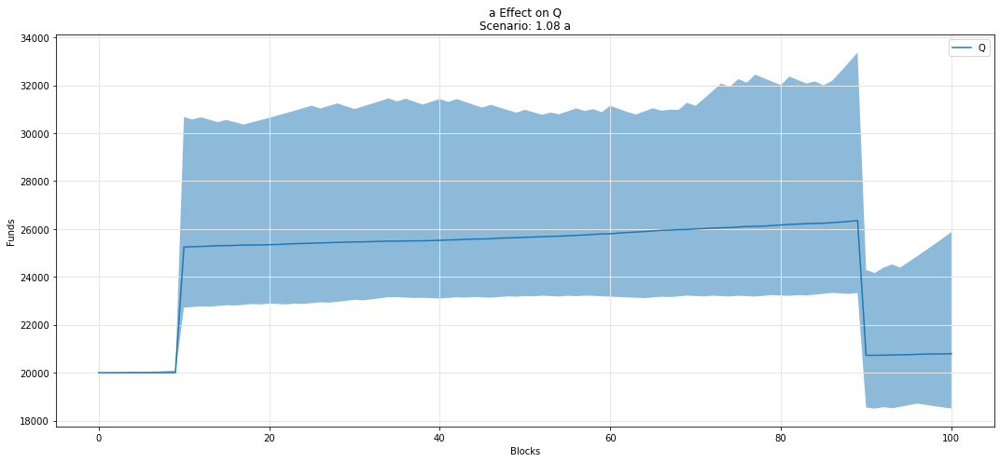

In [48]:
param_fan_plot3(experiments, config_ids, 'a','Q')

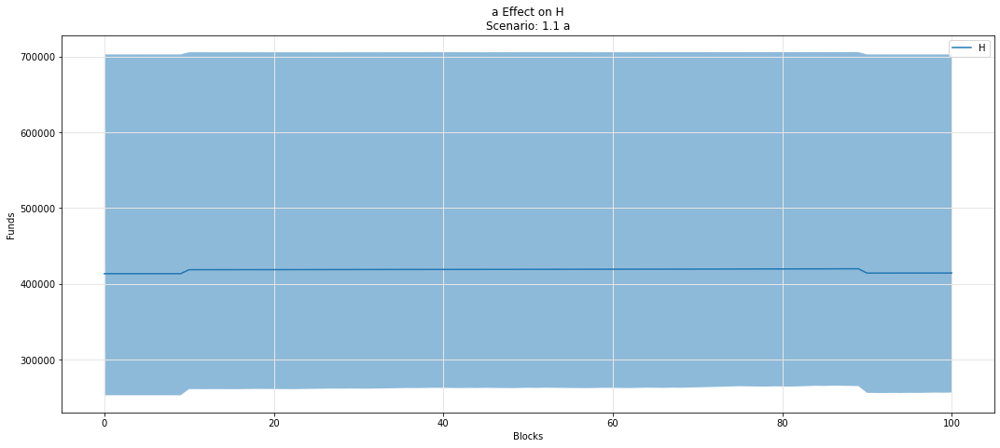

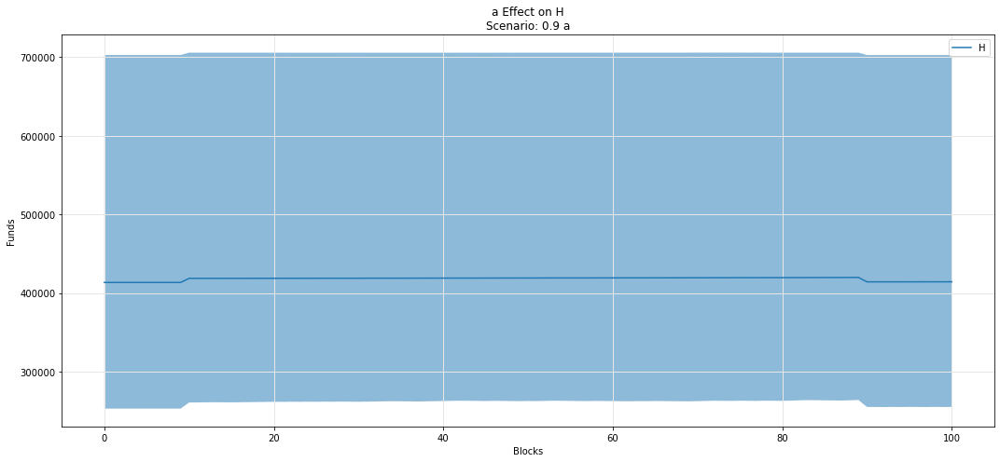

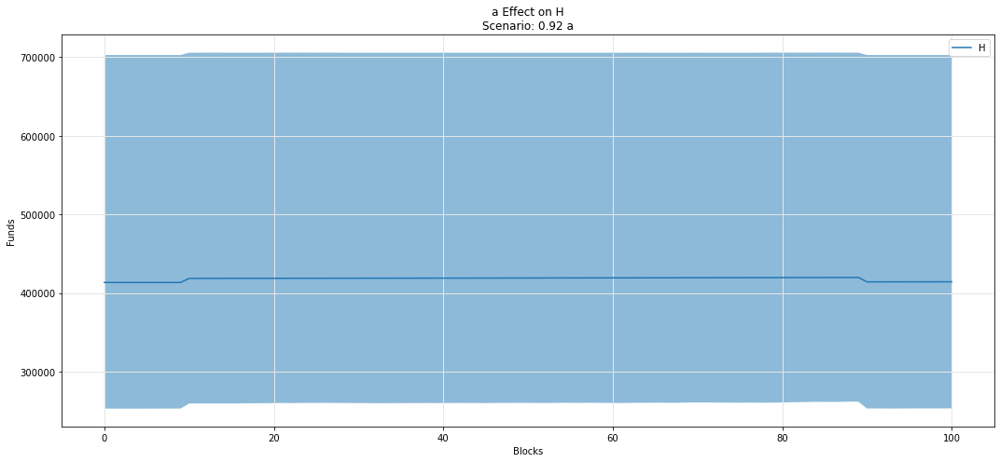

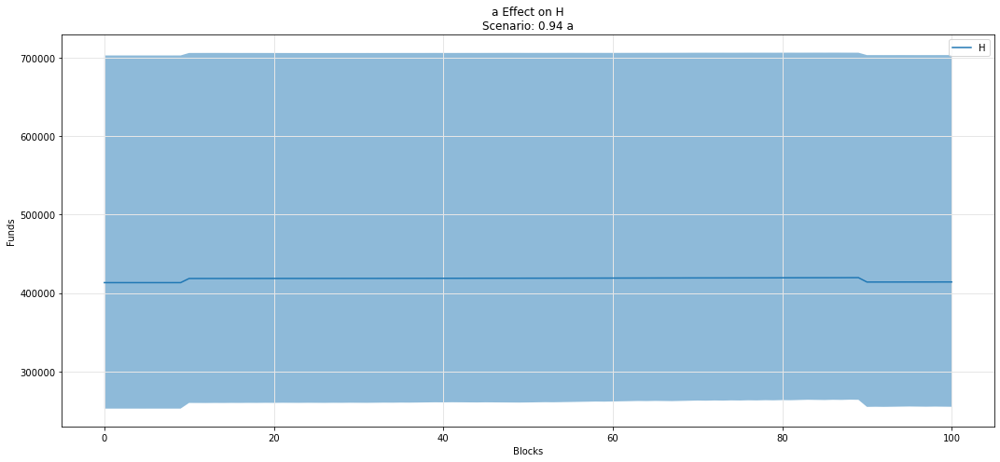

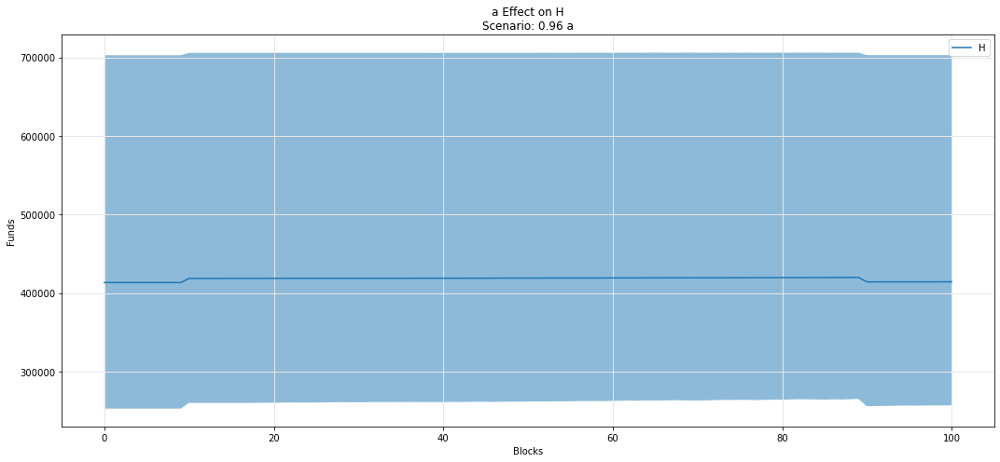

...

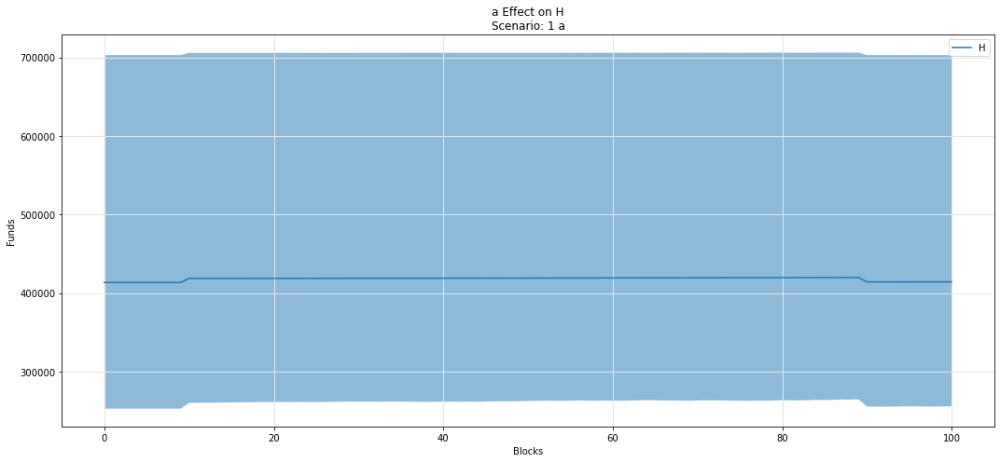

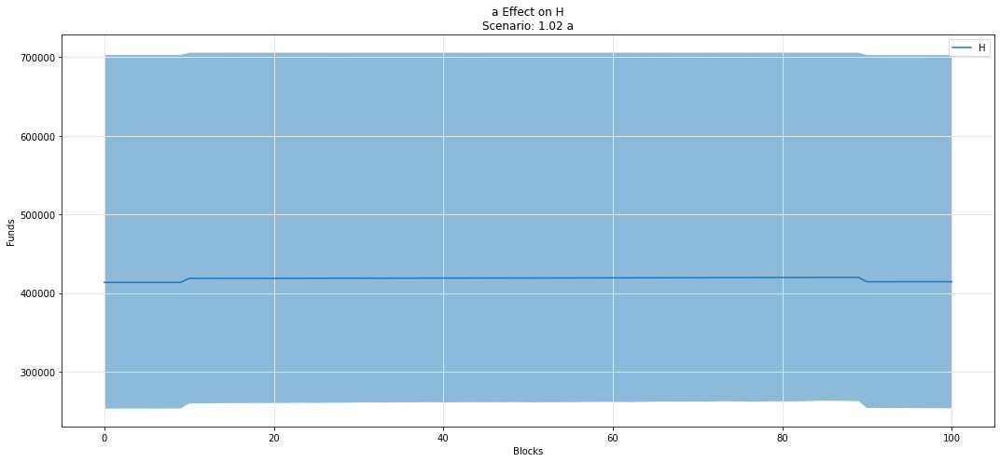

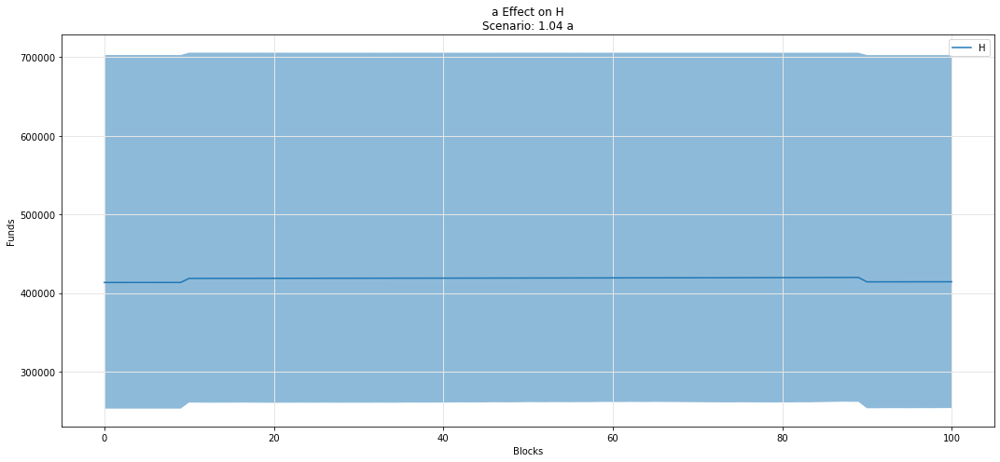

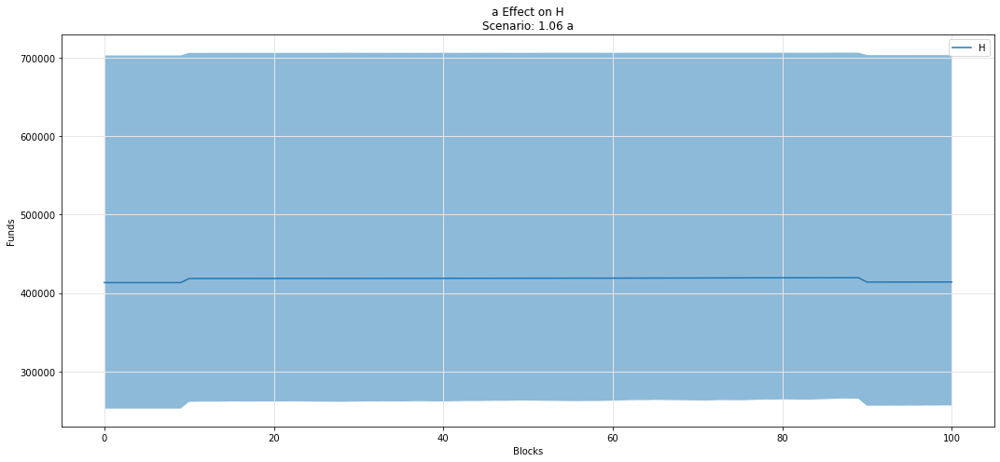

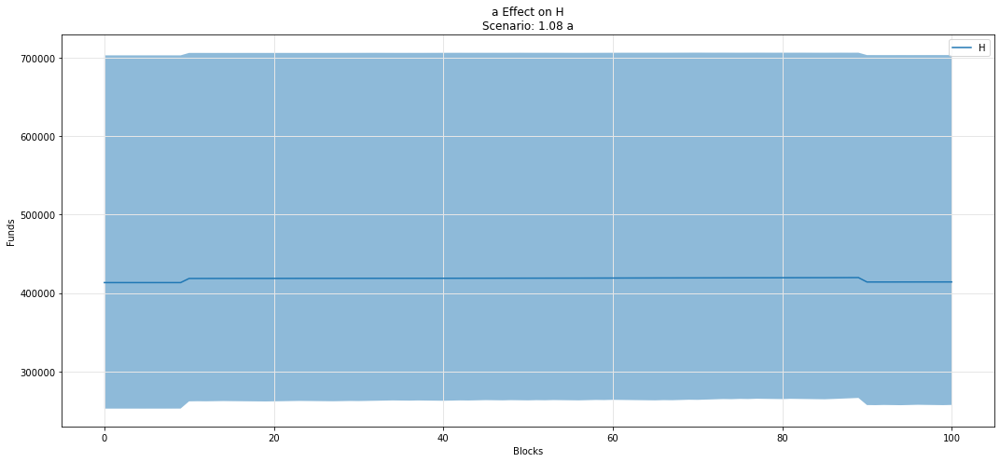

In [49]:
param_fan_plot3(experiments, config_ids, 'a','H')

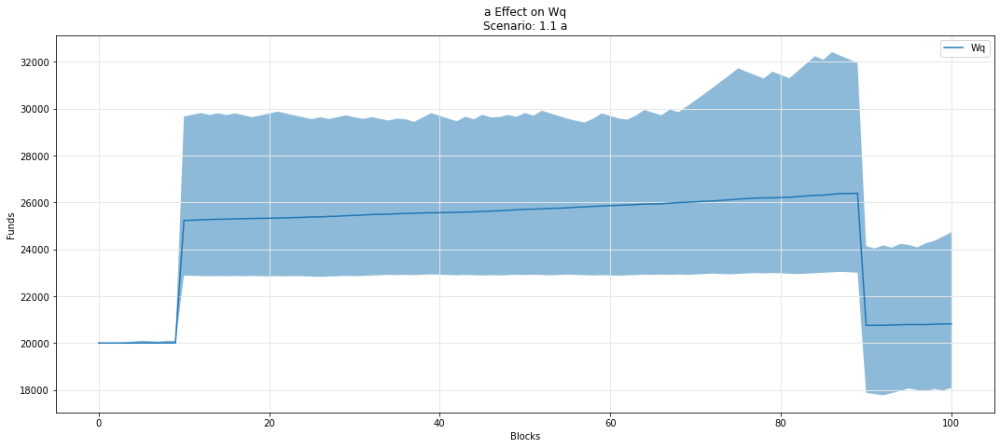

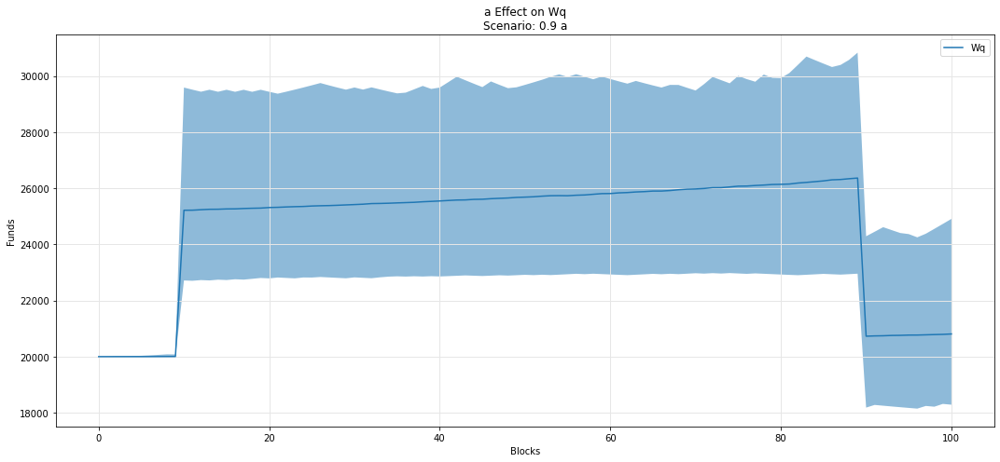

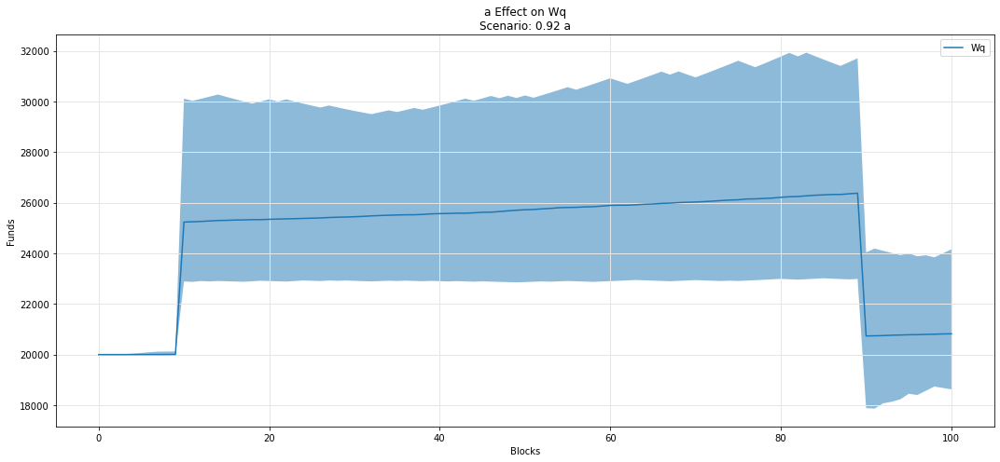

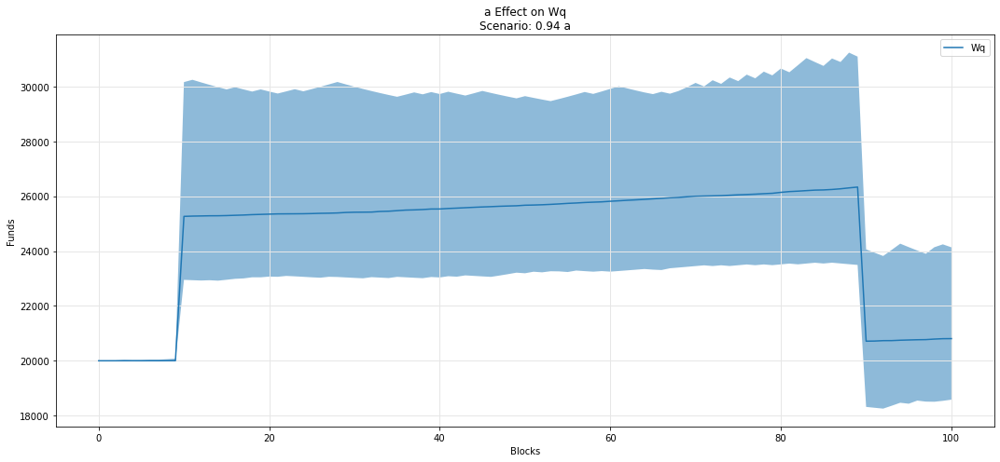

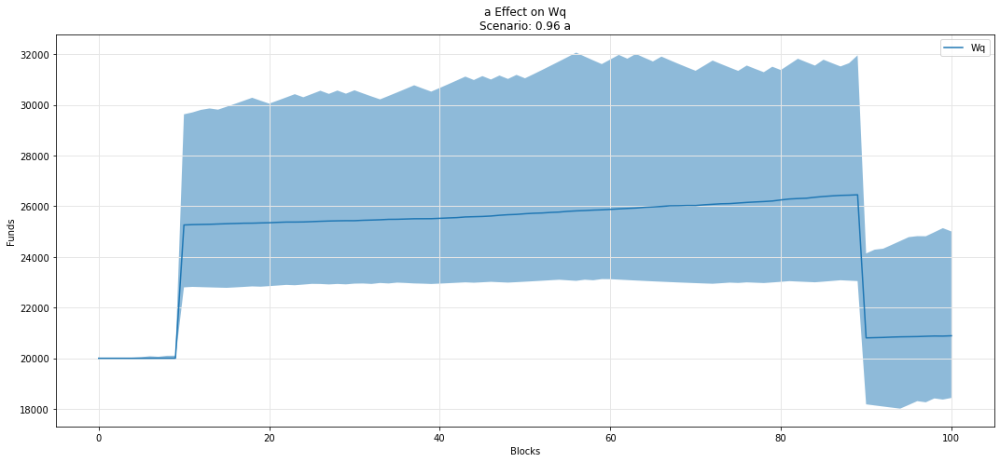

...

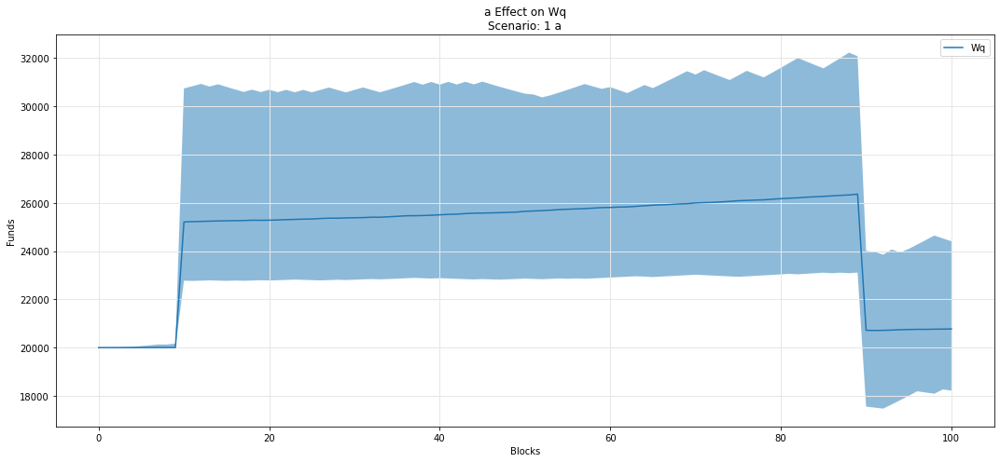

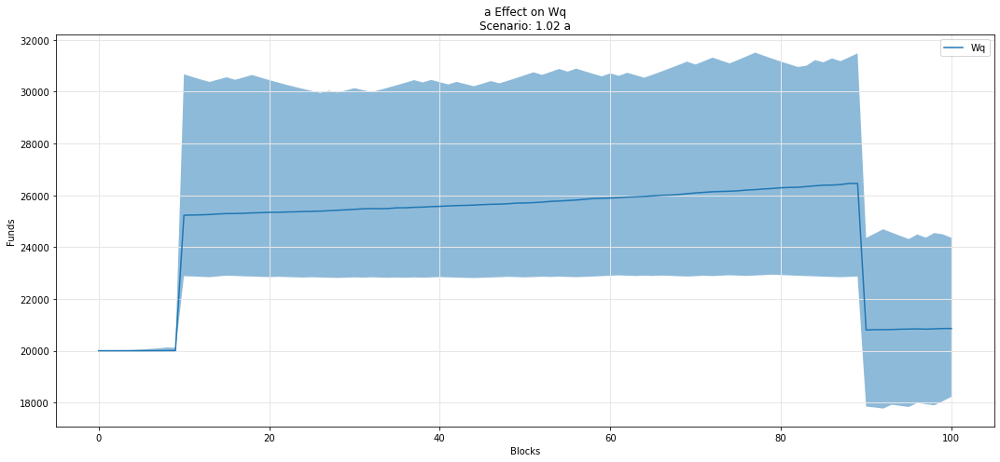

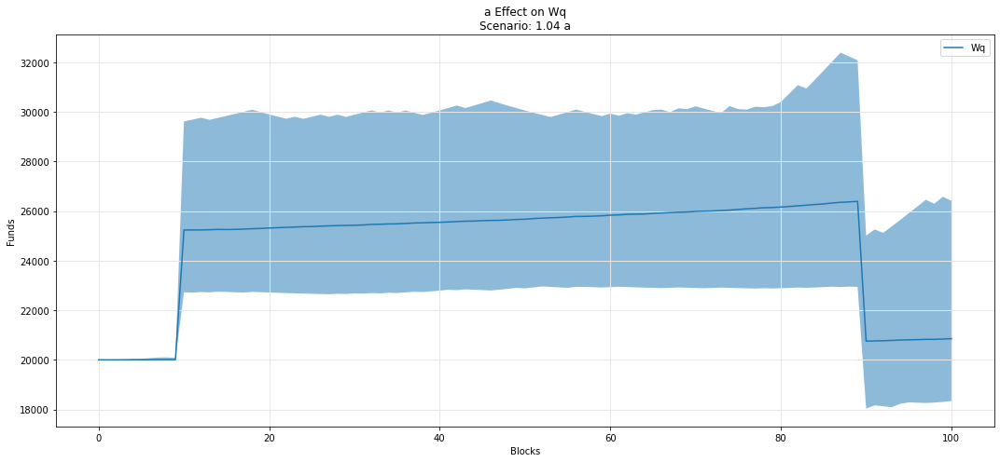

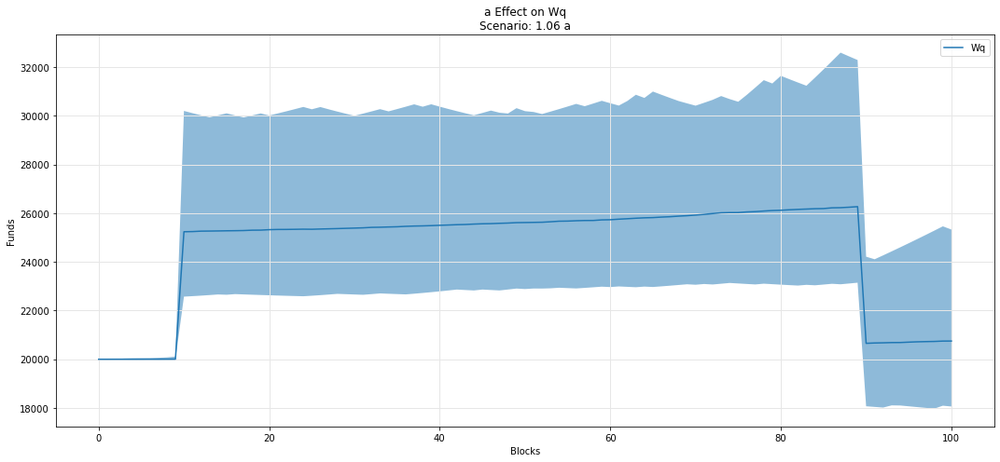

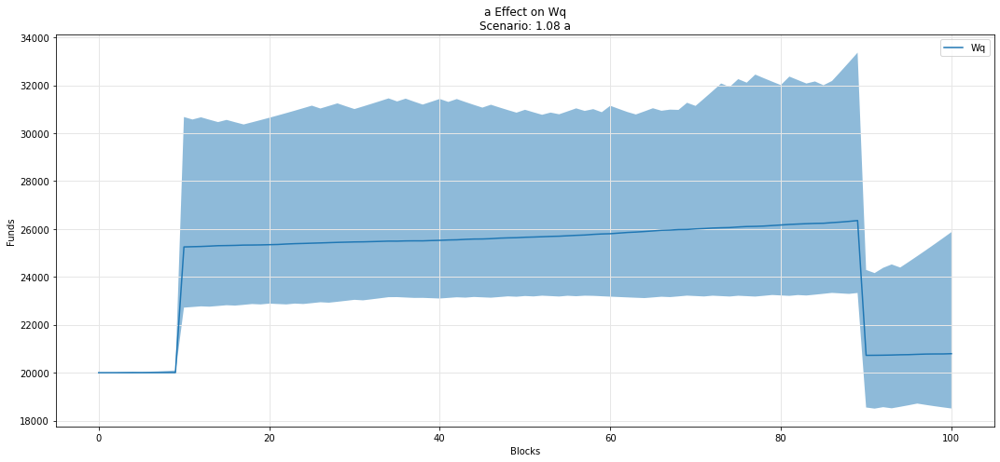

In [50]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

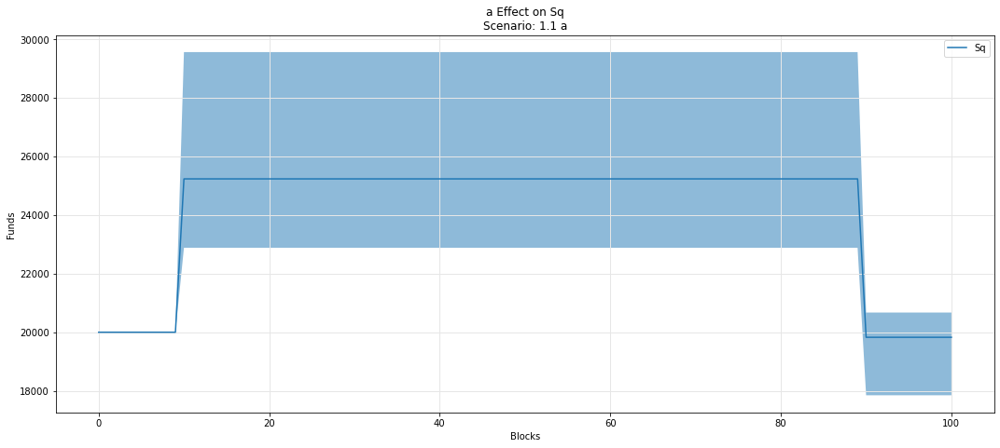

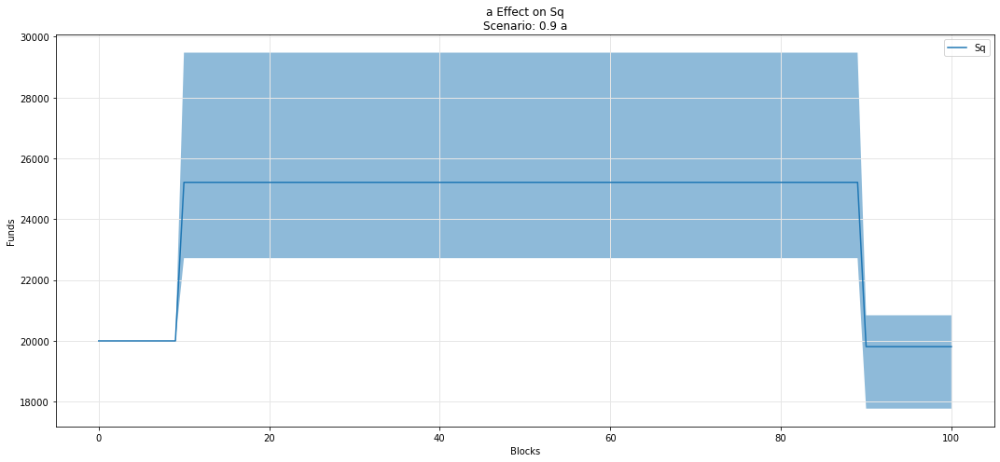

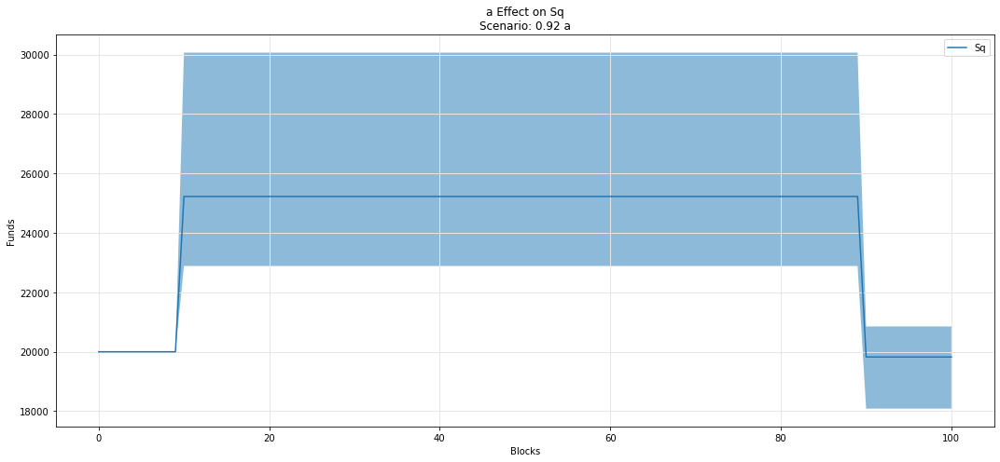

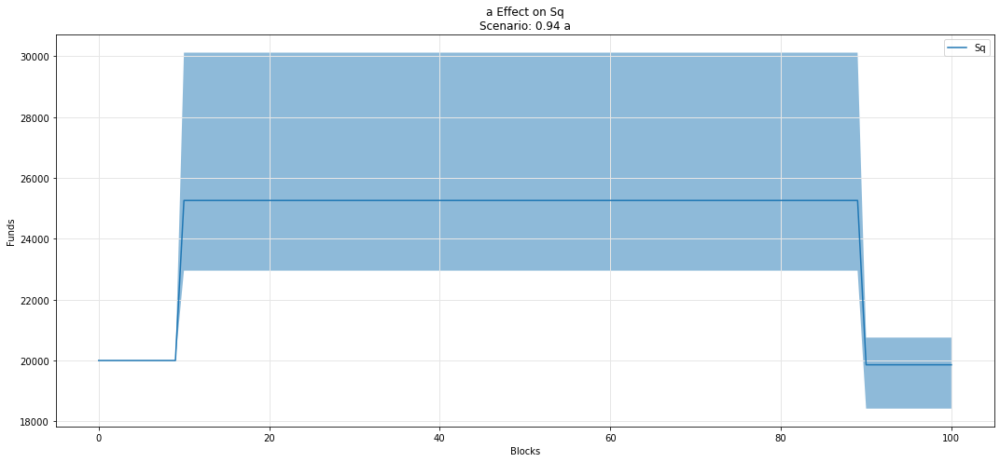

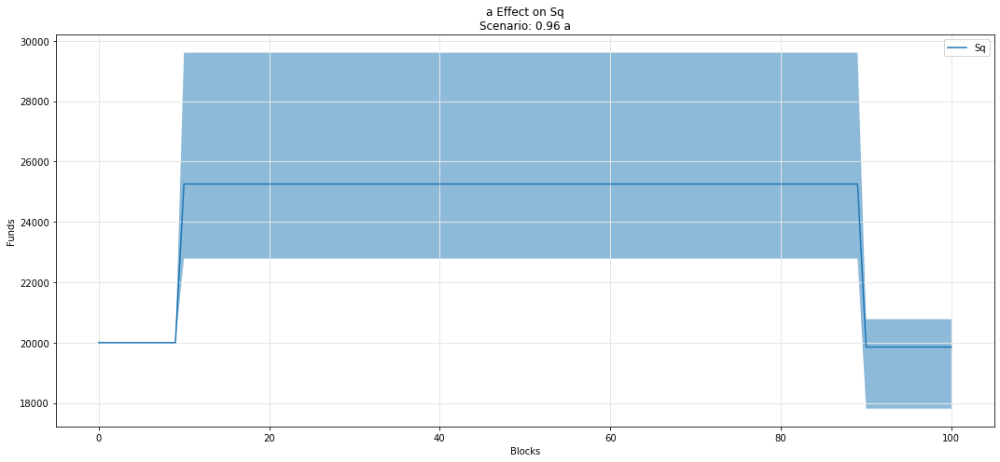

...

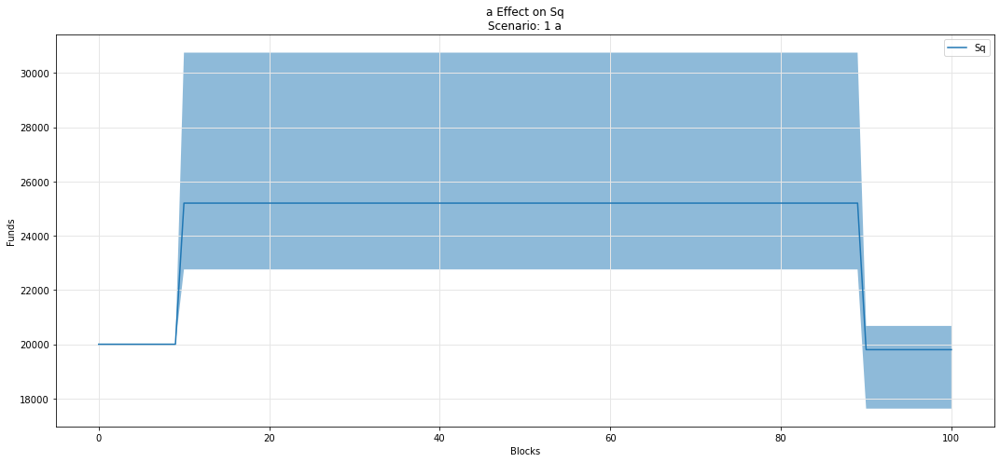

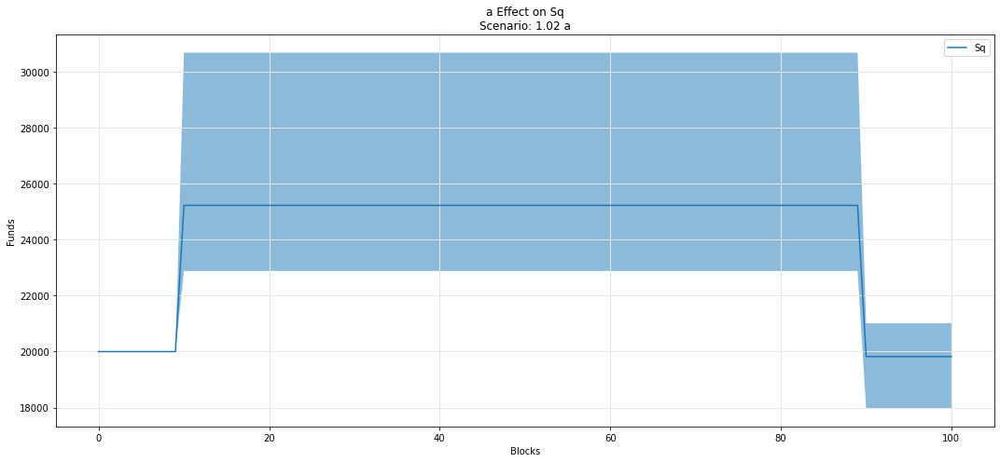

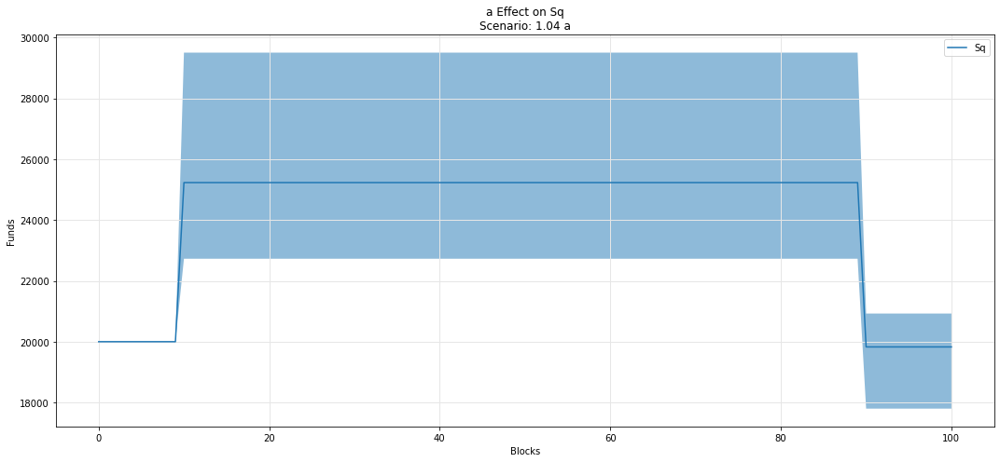

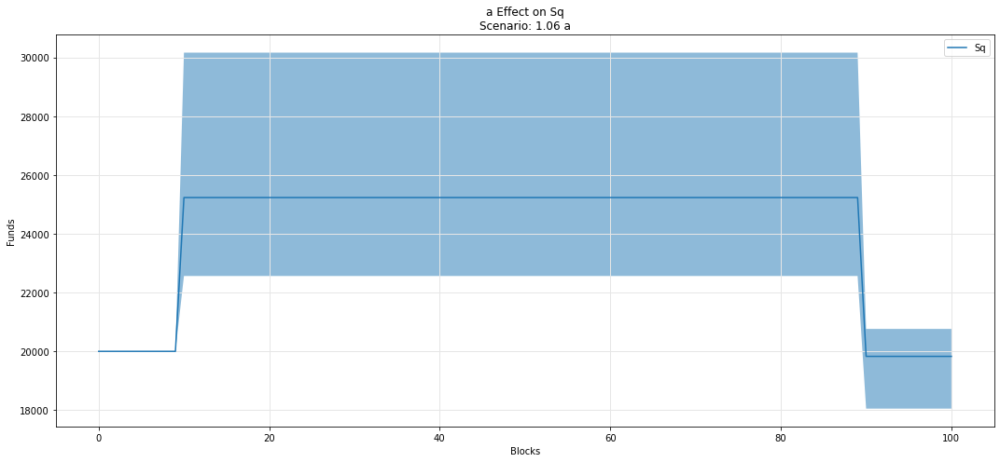

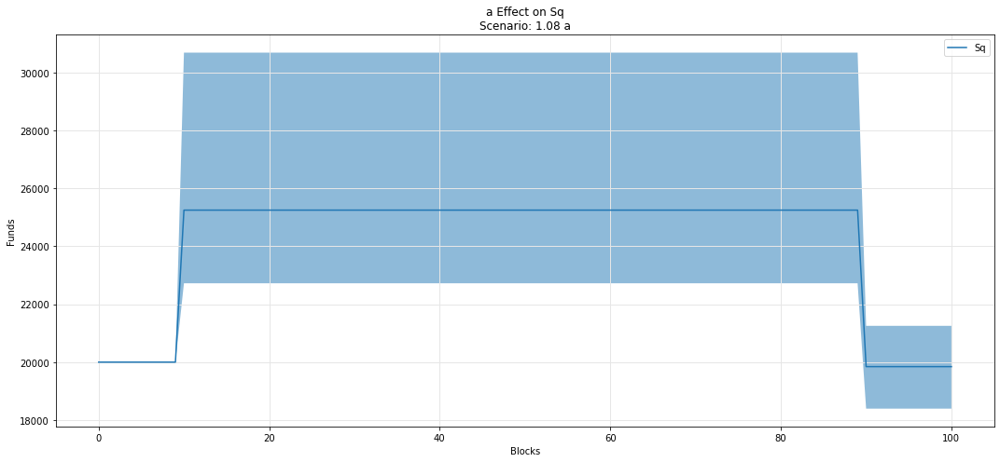

In [51]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

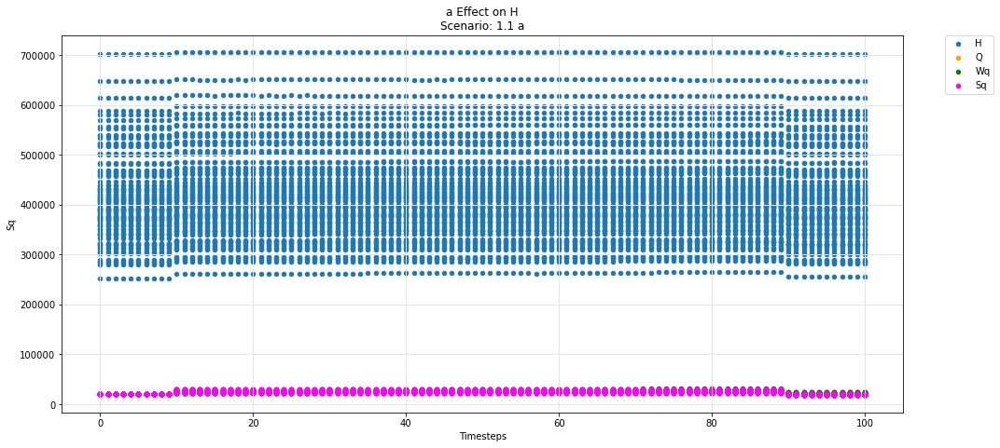

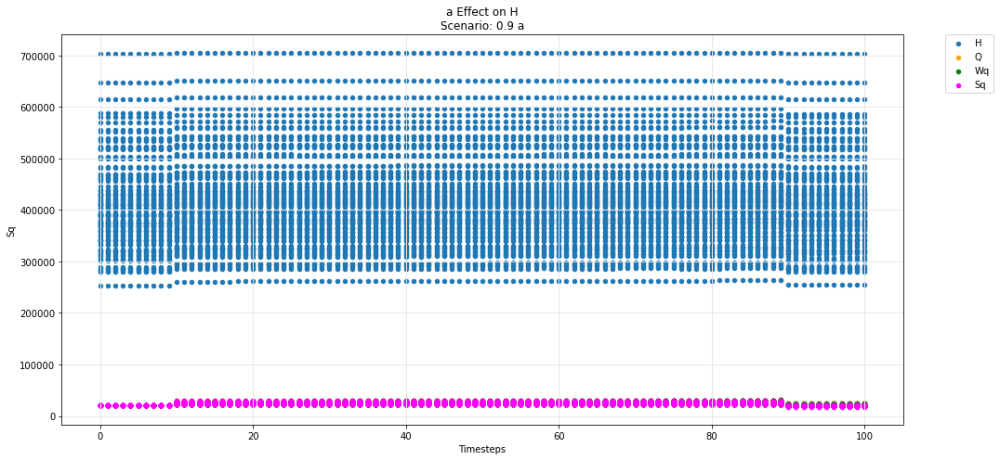

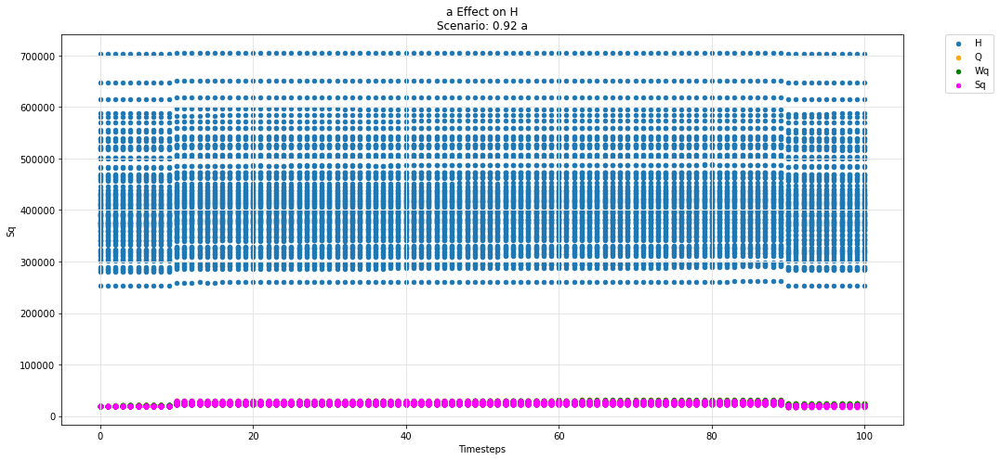

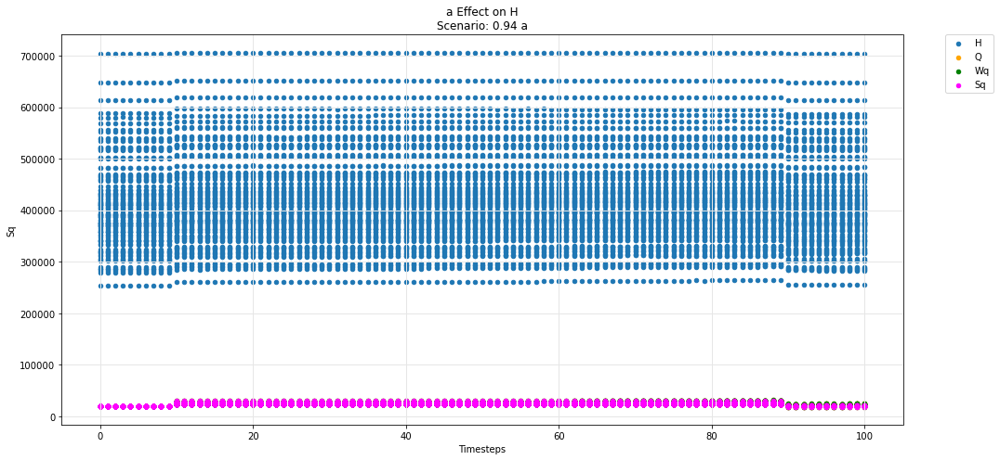

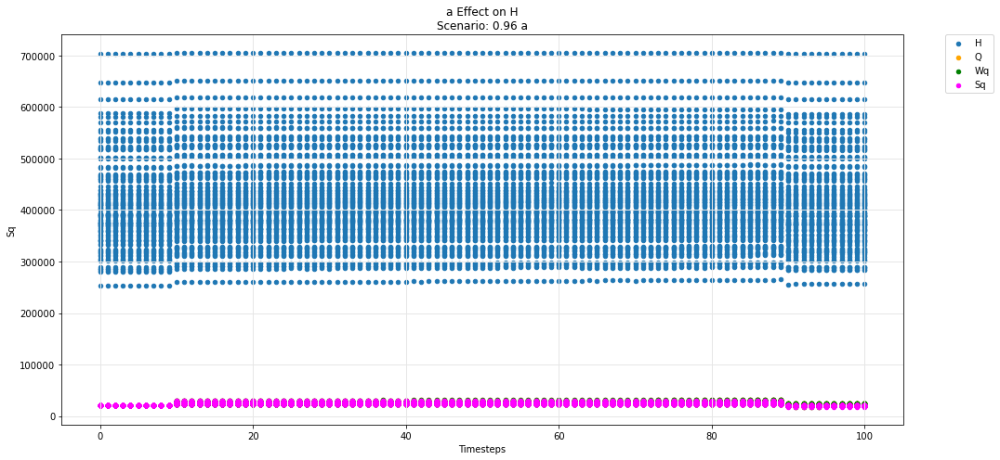

...

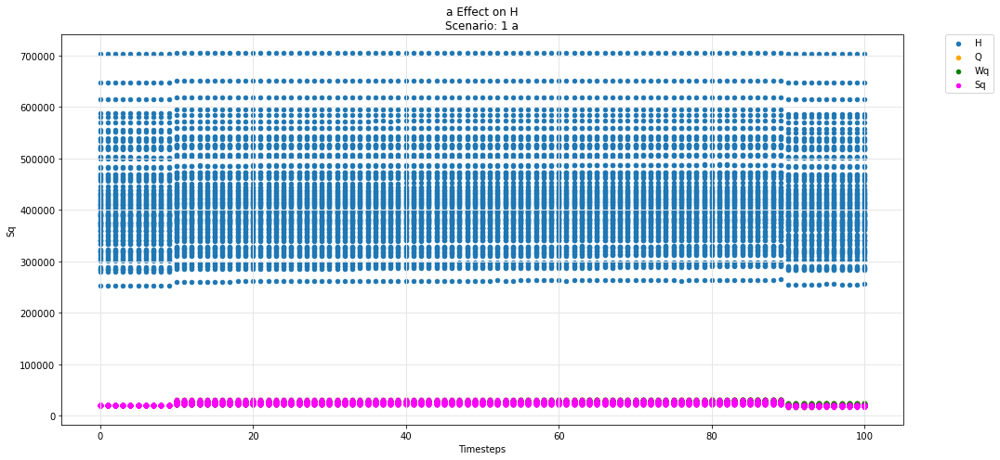

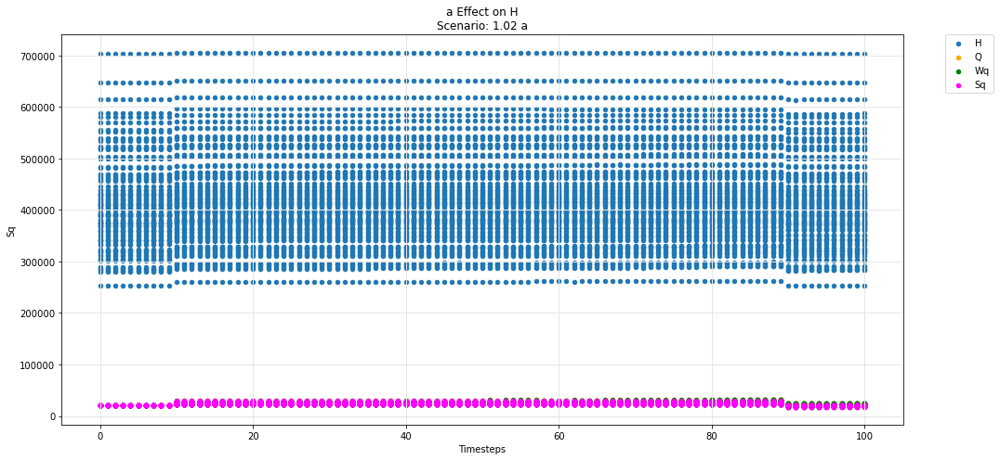

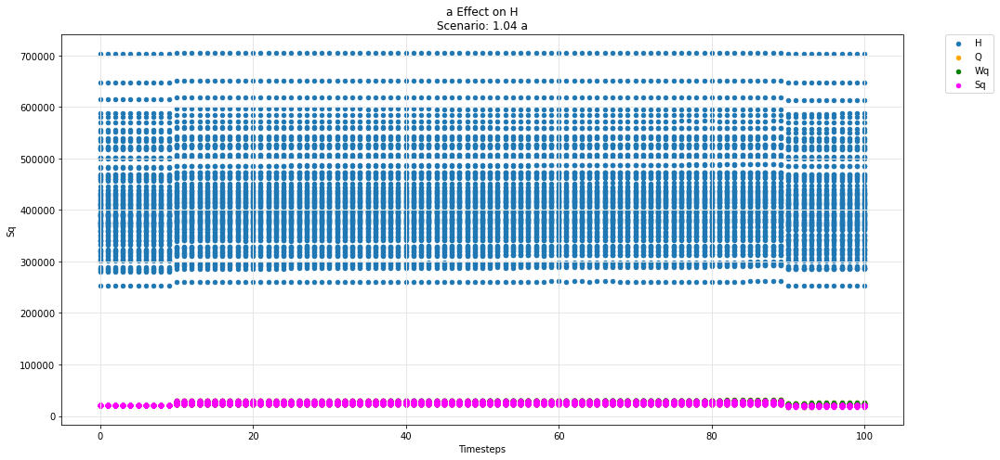

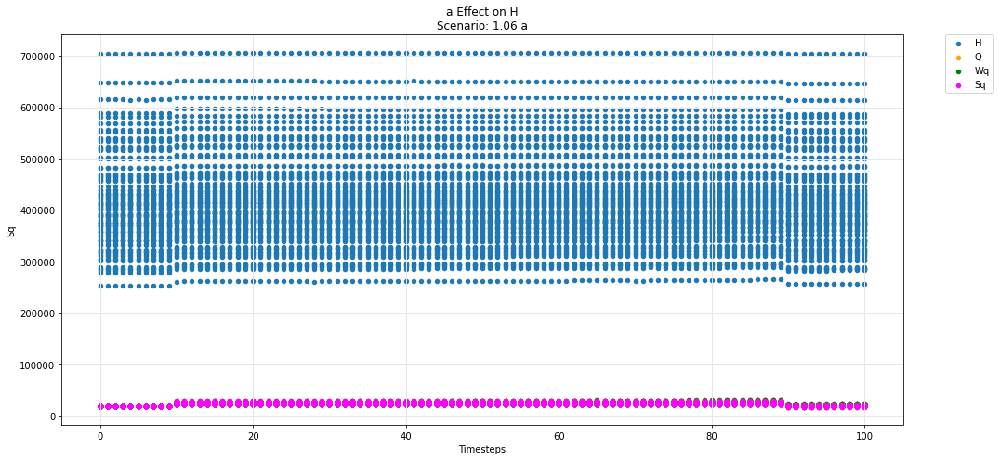

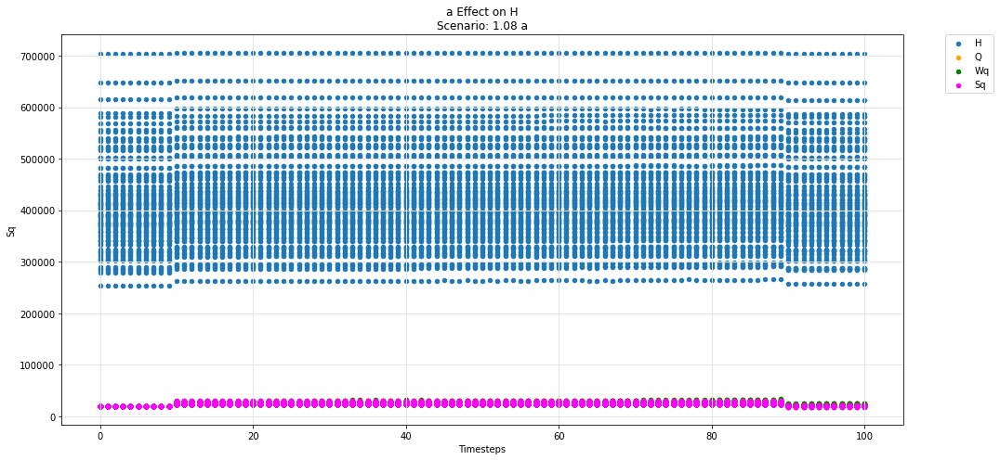

In [52]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

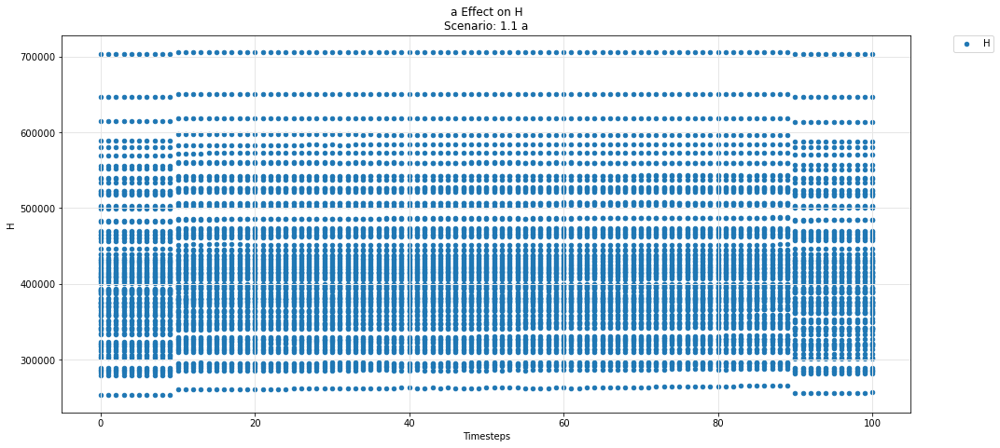

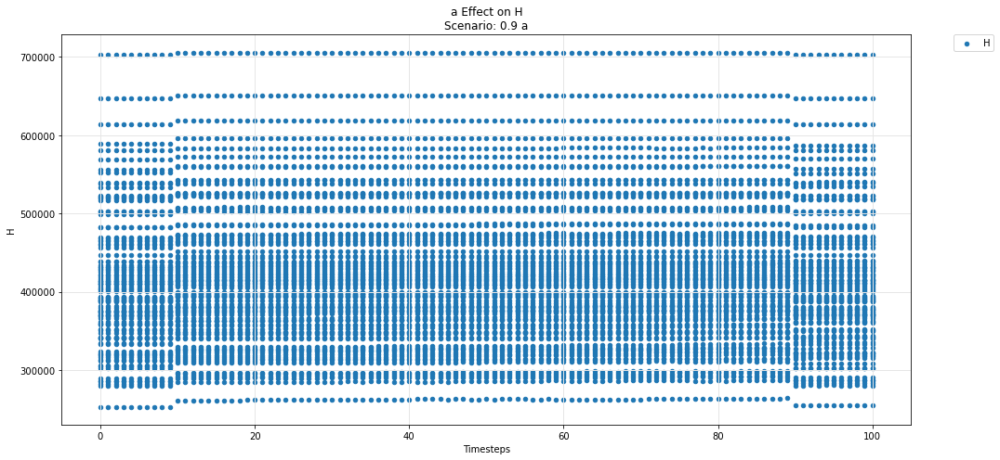

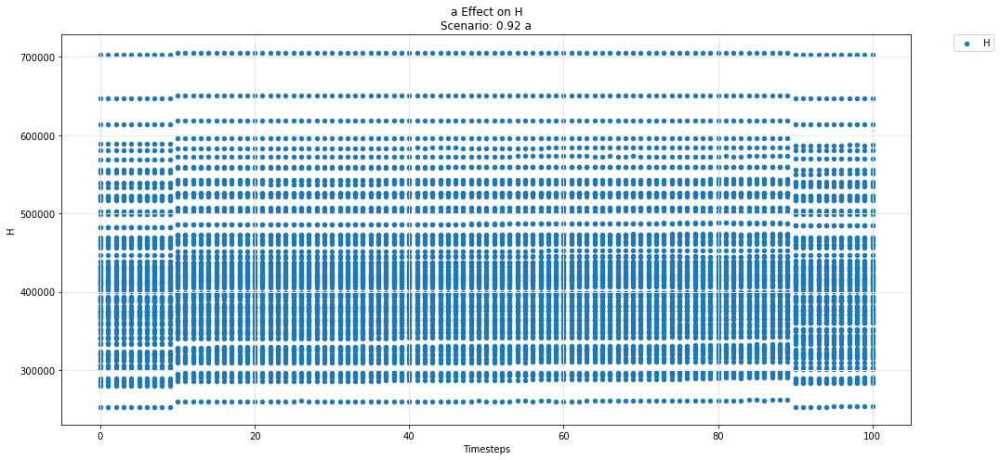

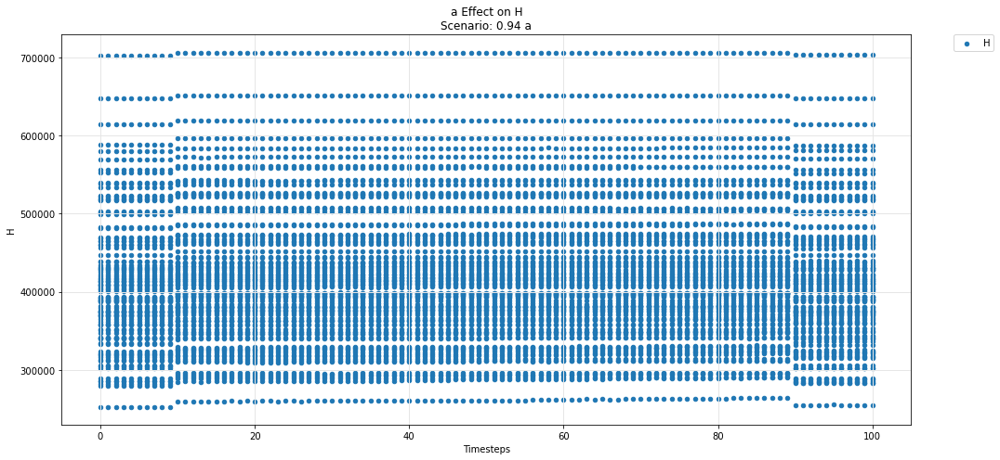

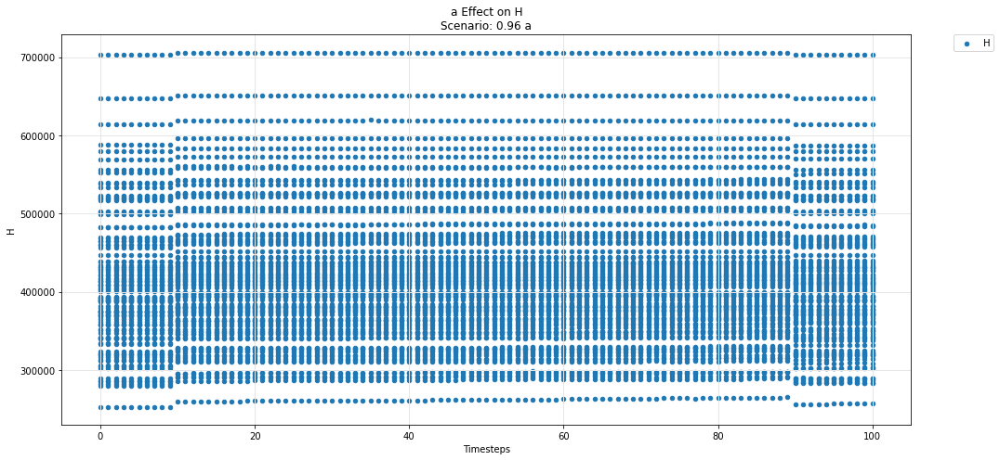

...

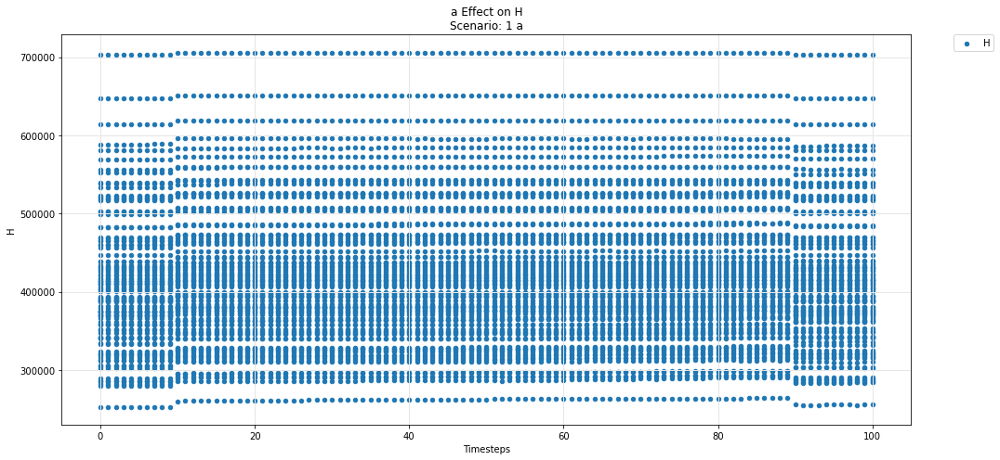

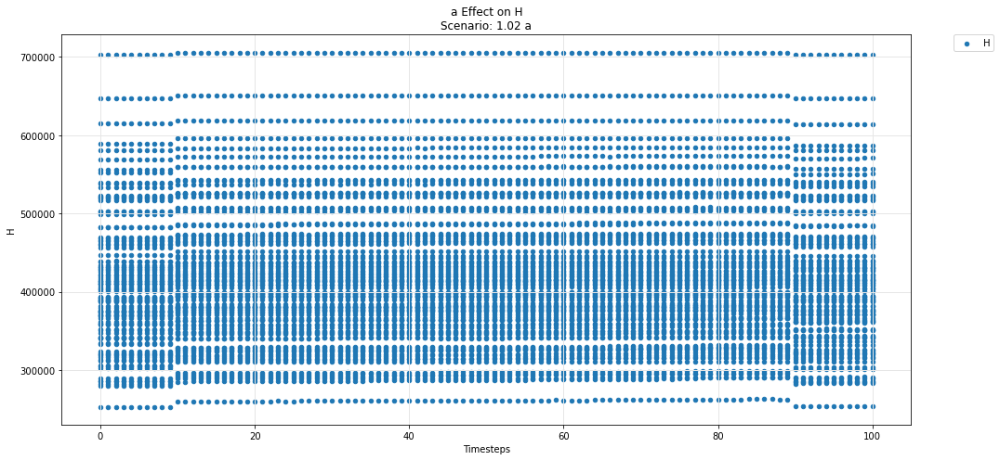

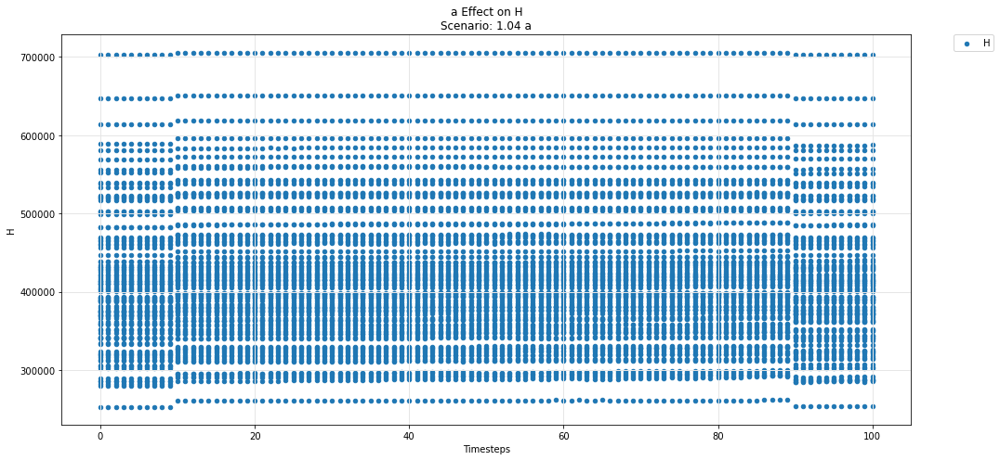

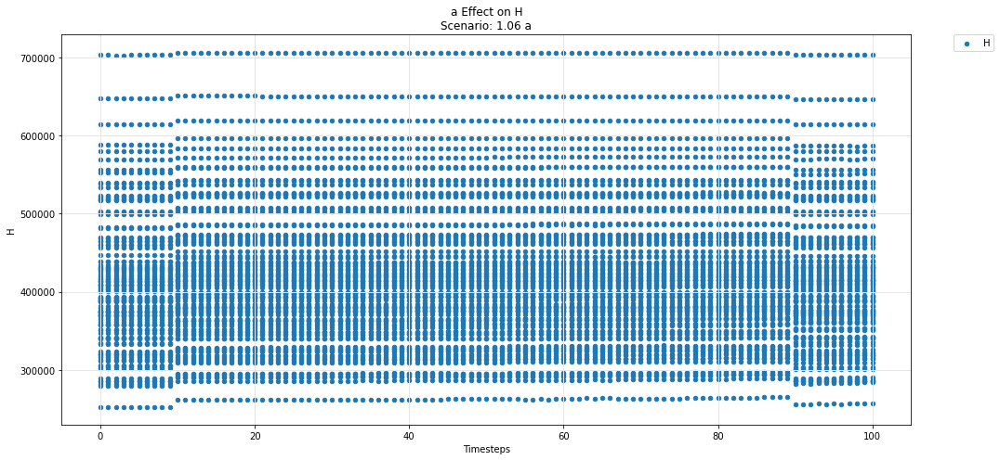

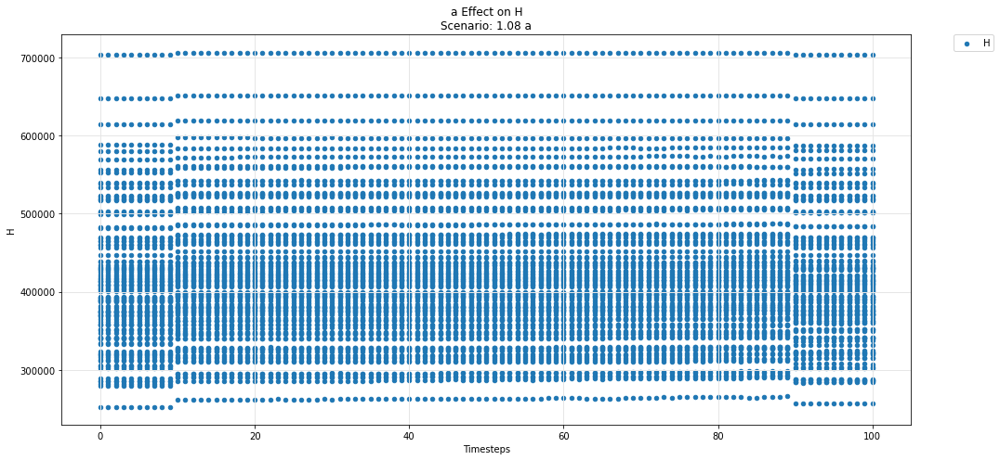

In [53]:
param_test_plot(experiments, config_ids, 'a', 'H')

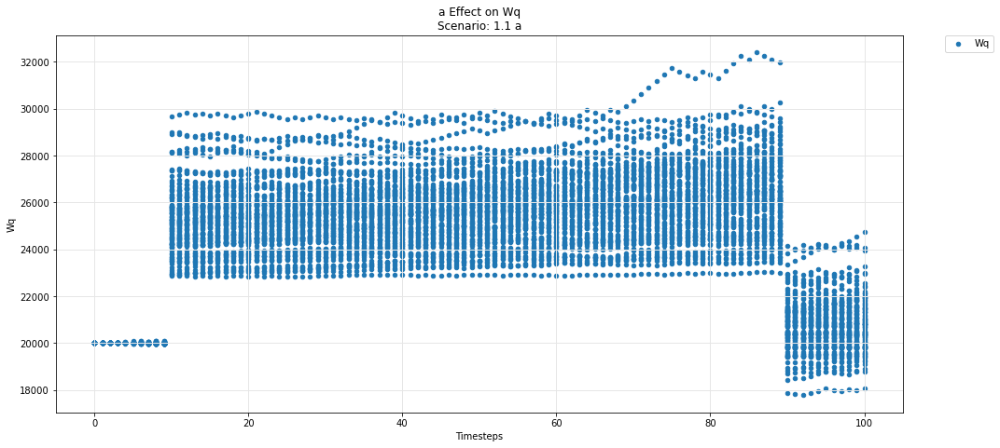

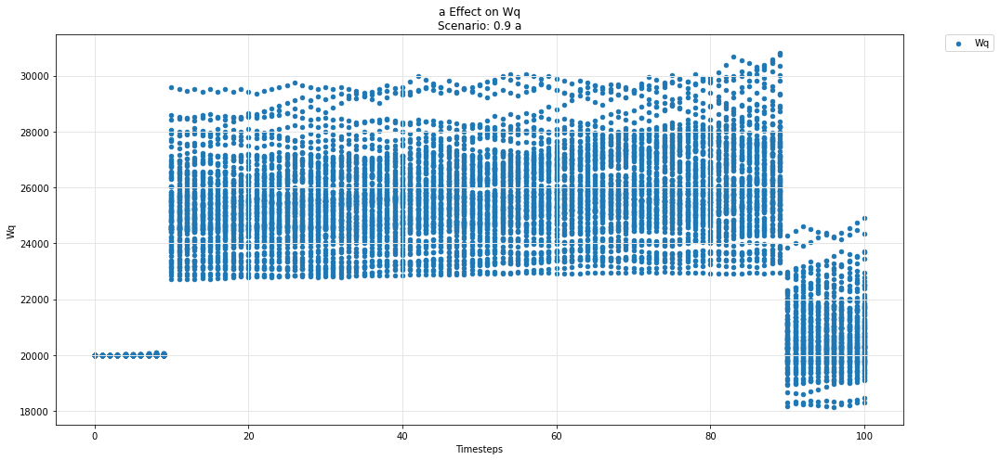

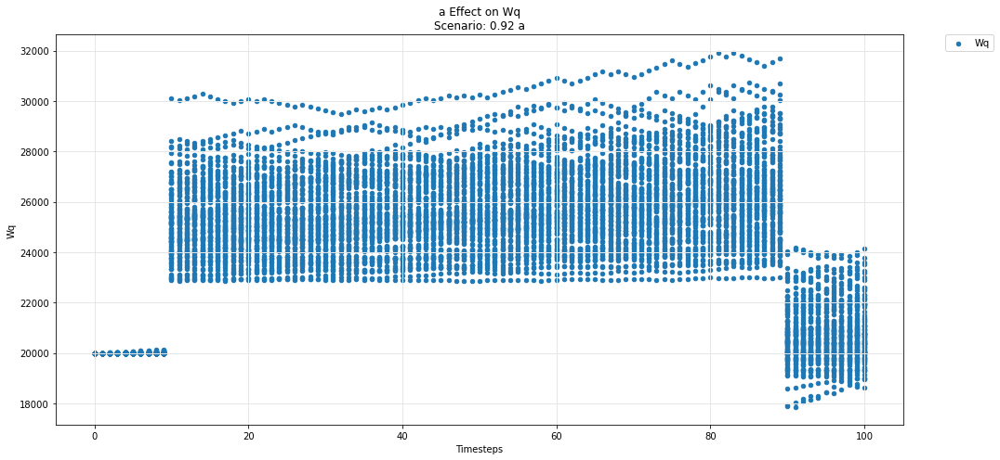

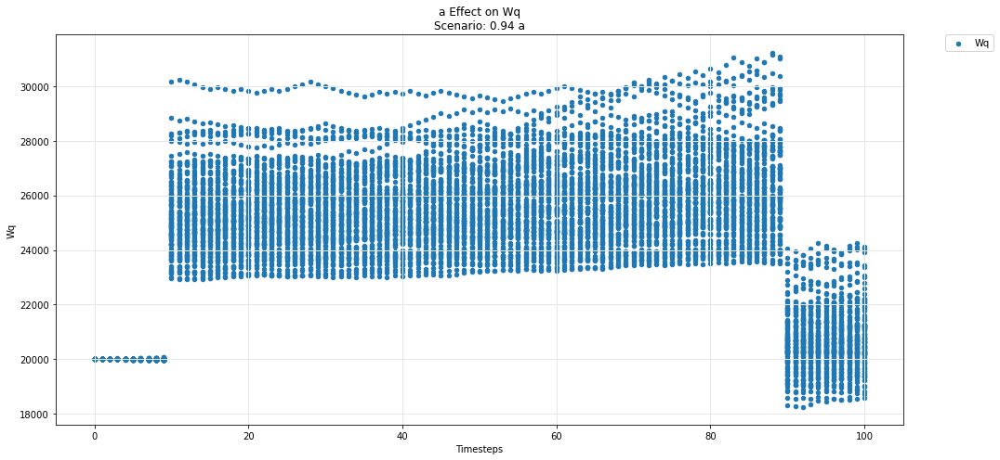

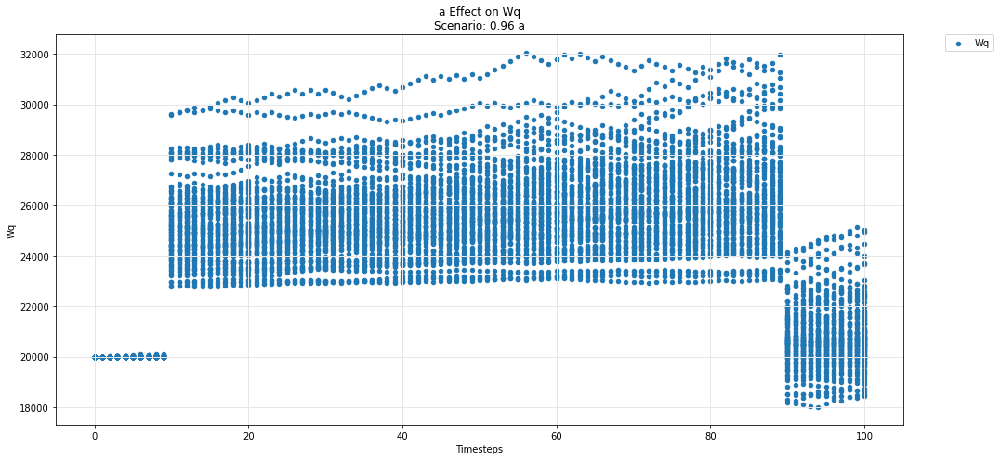

...

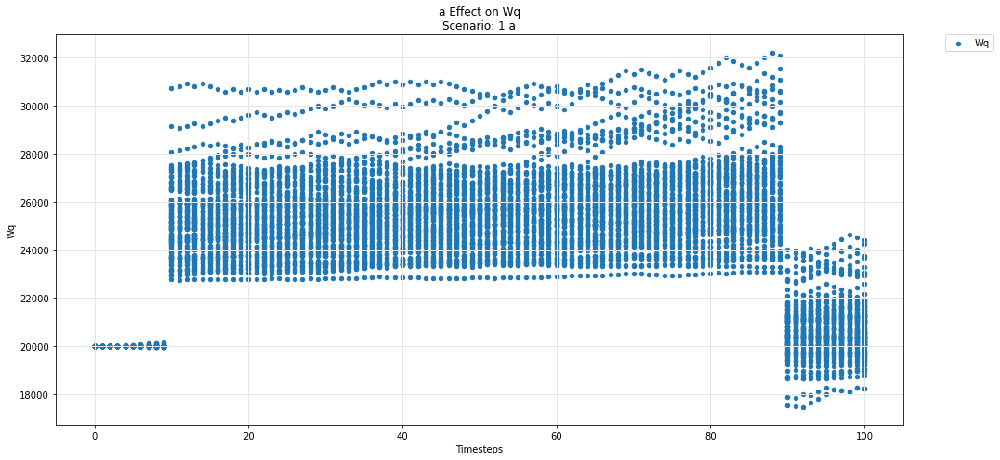

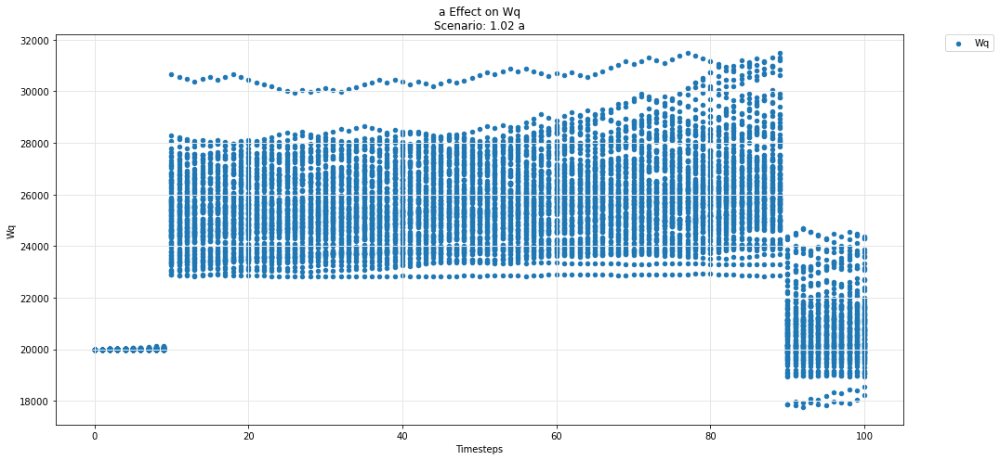

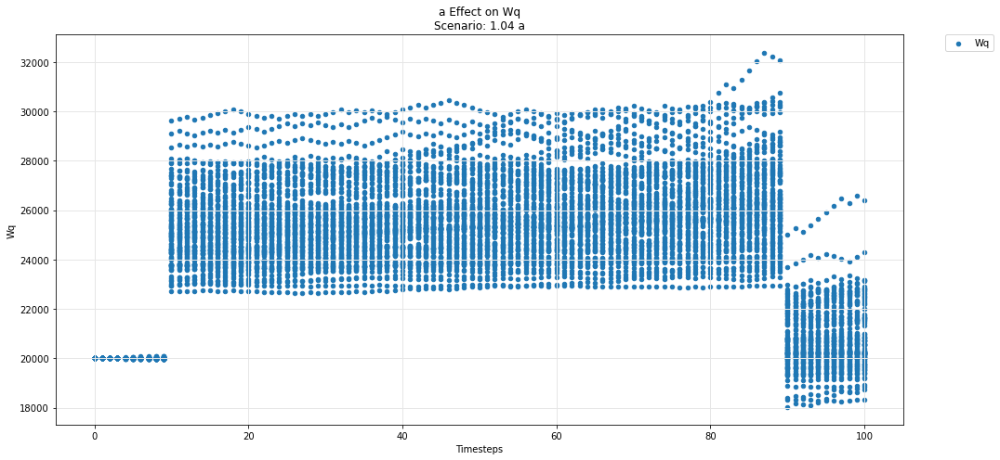

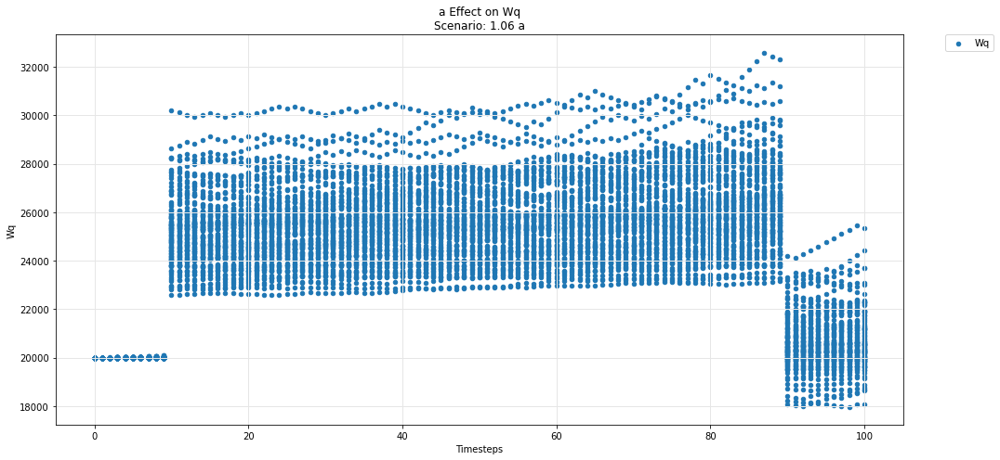

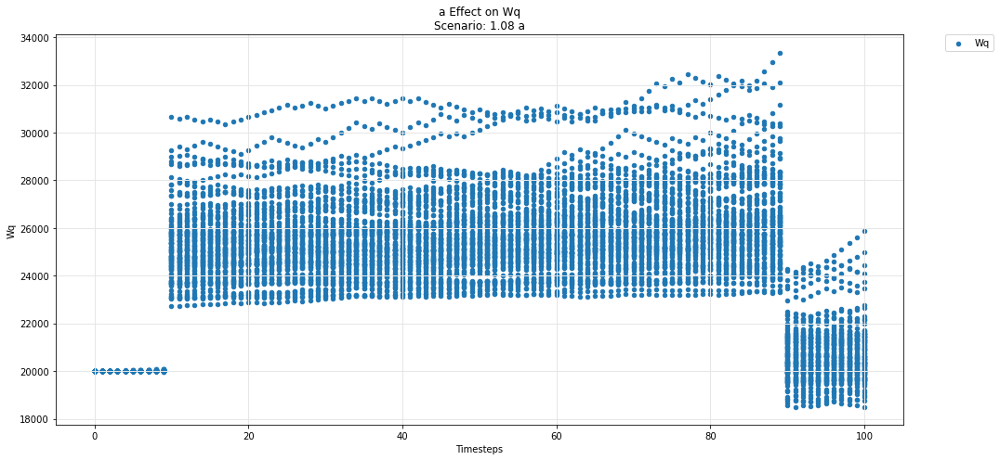

In [54]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

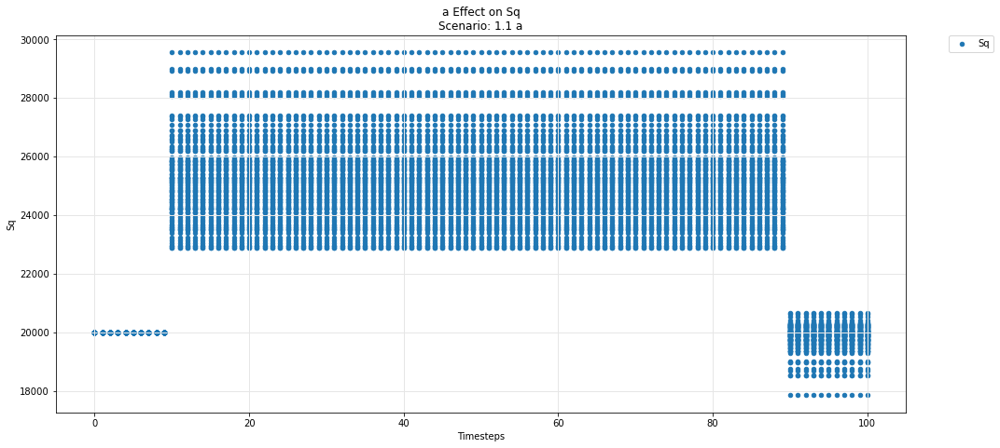

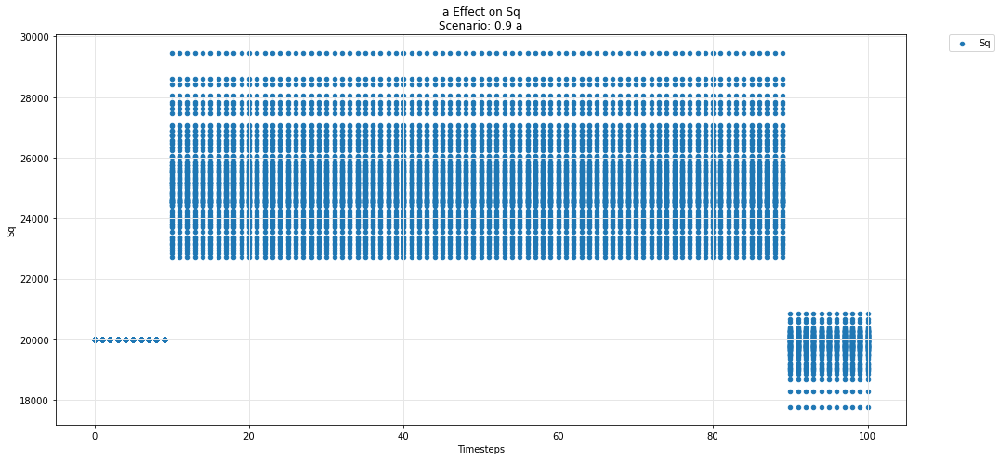

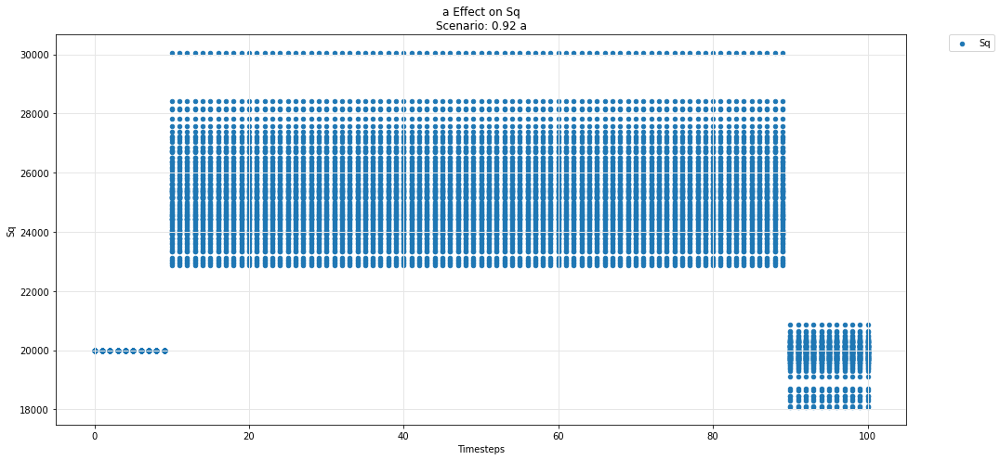

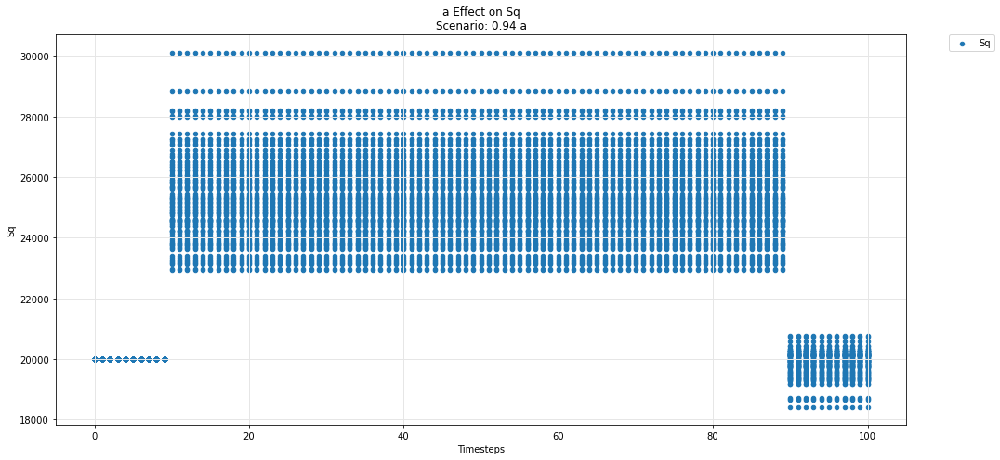

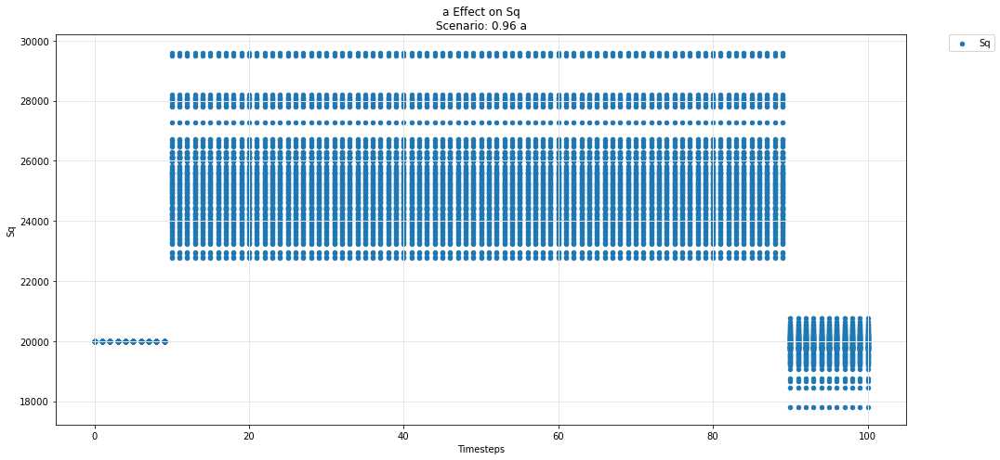

...

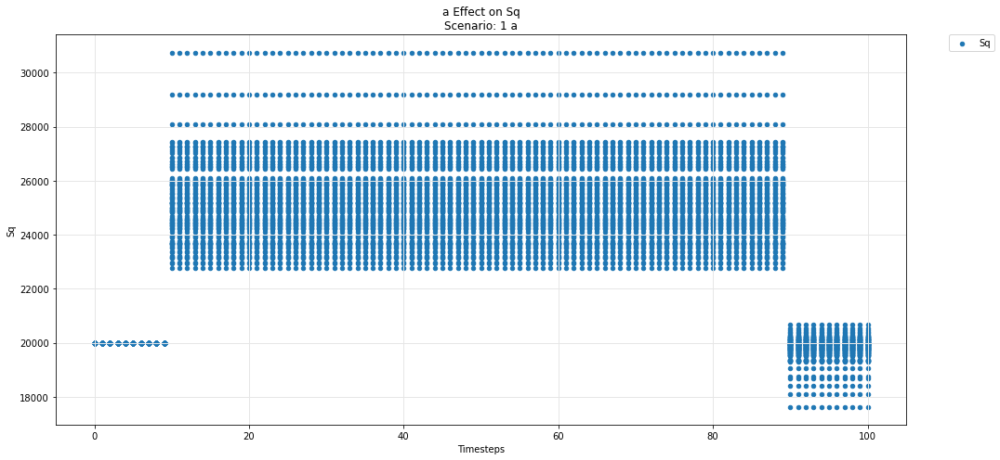

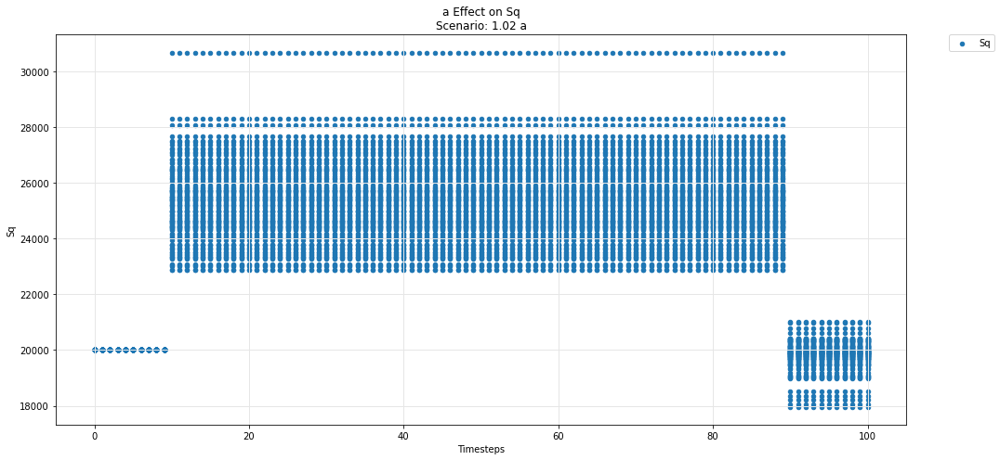

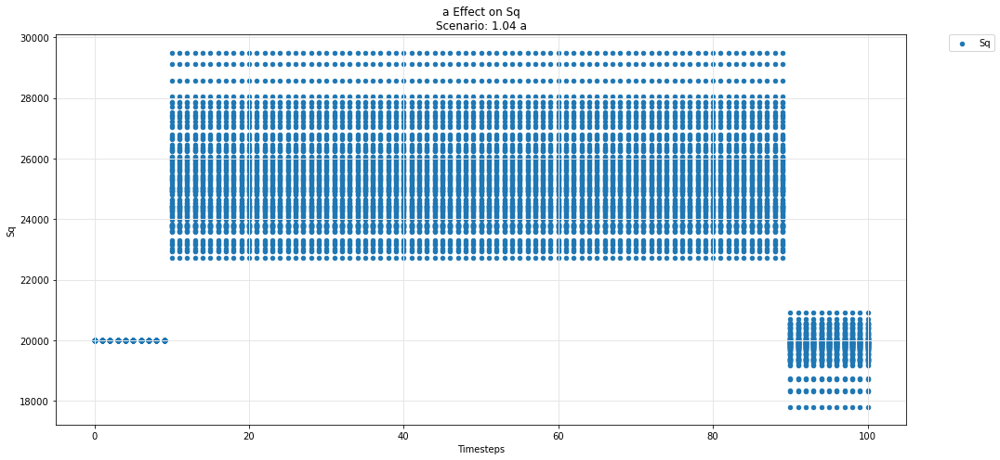

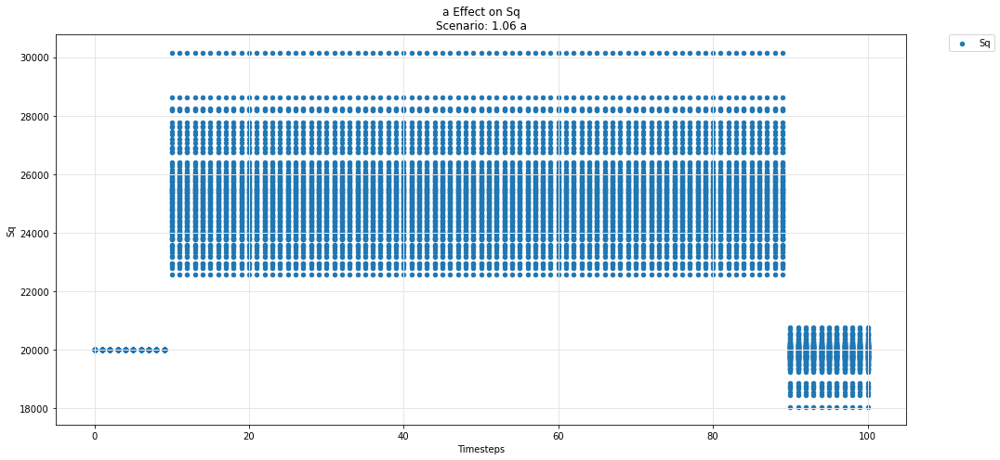

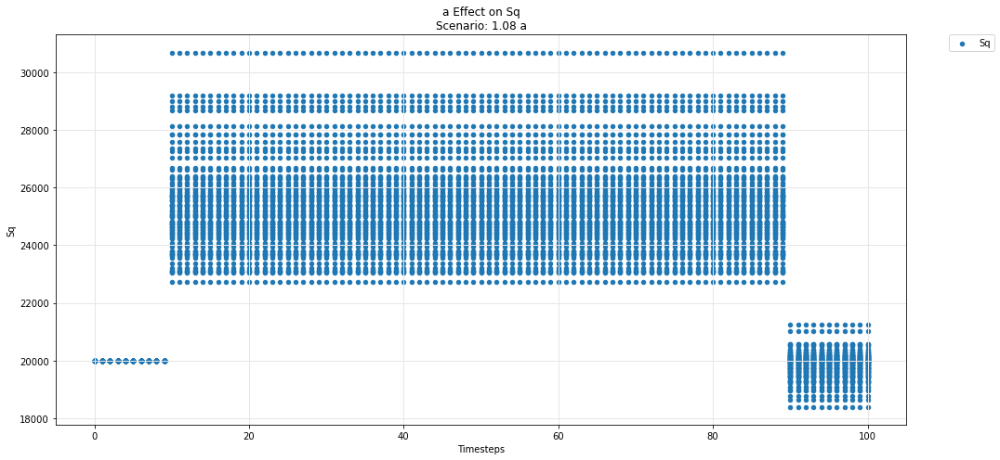

In [55]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [56]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

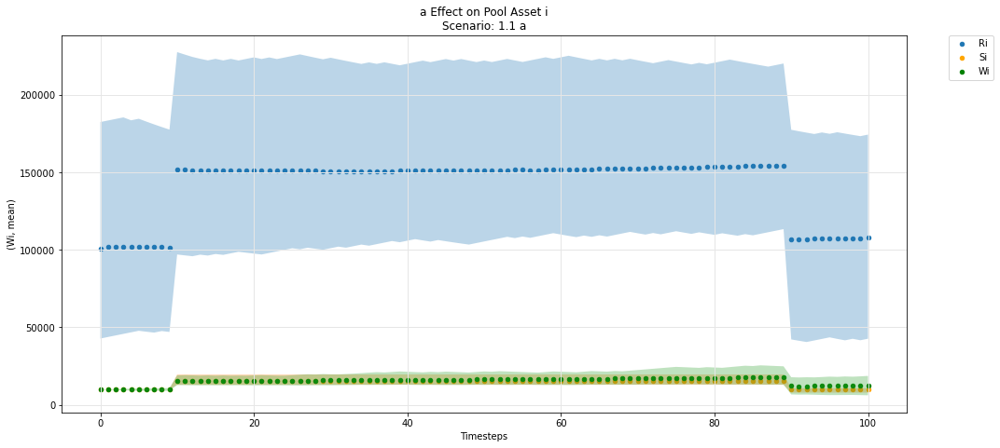

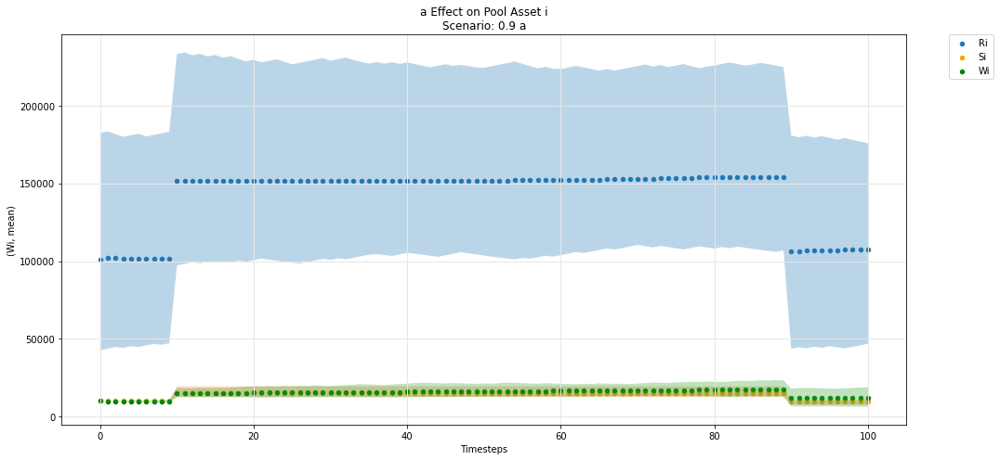

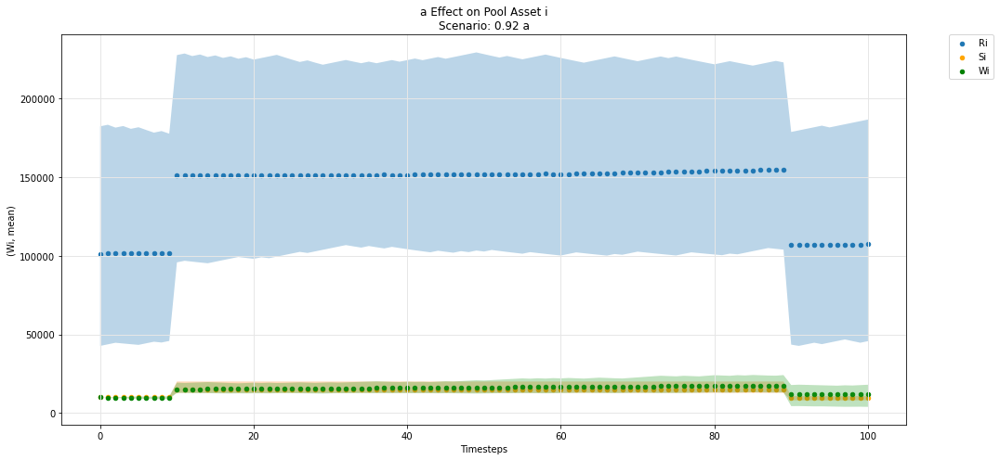

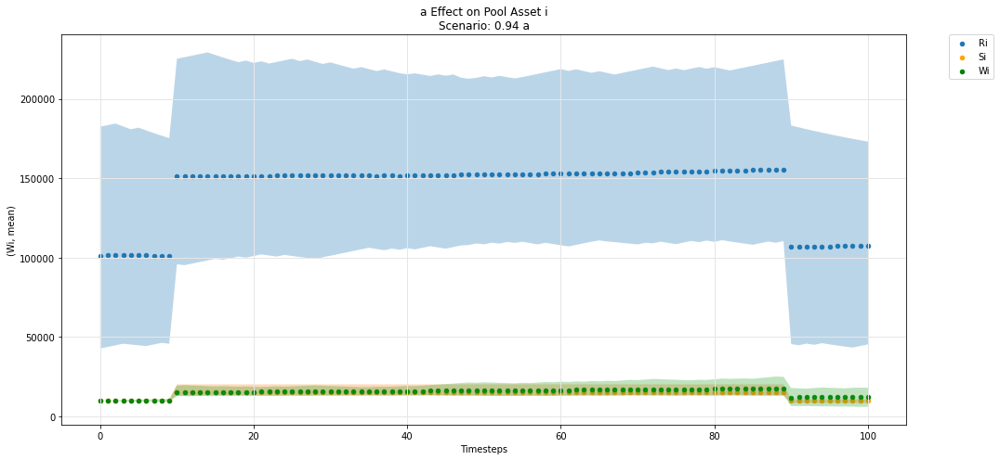

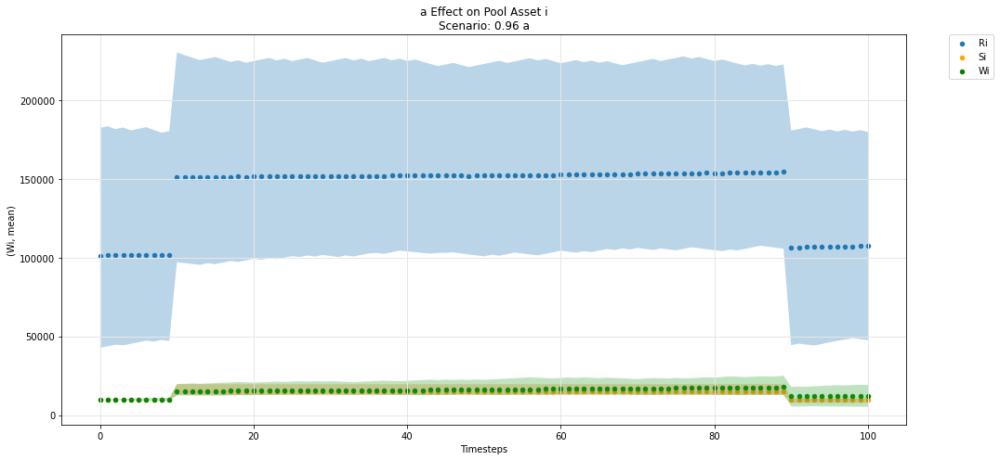

...

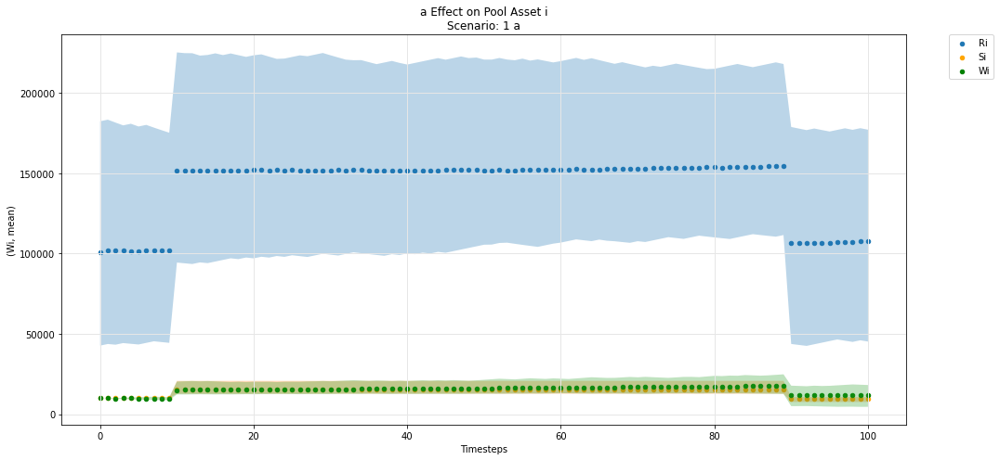

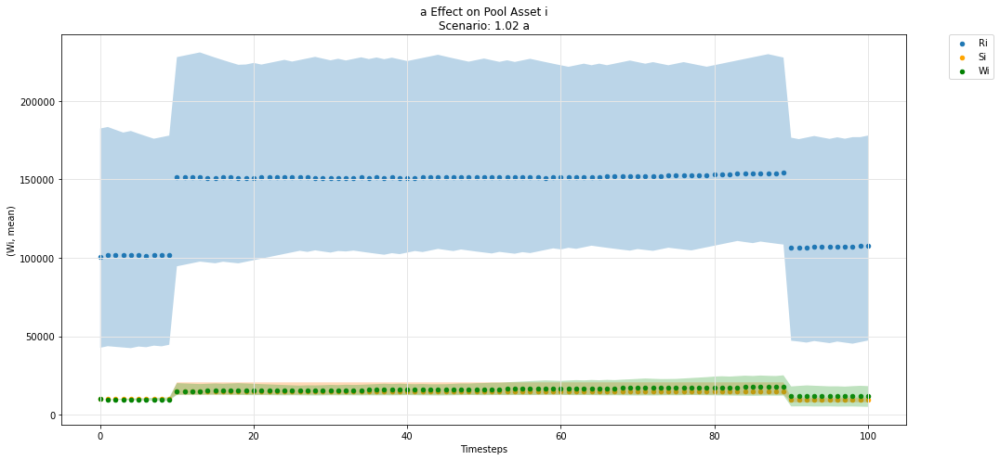

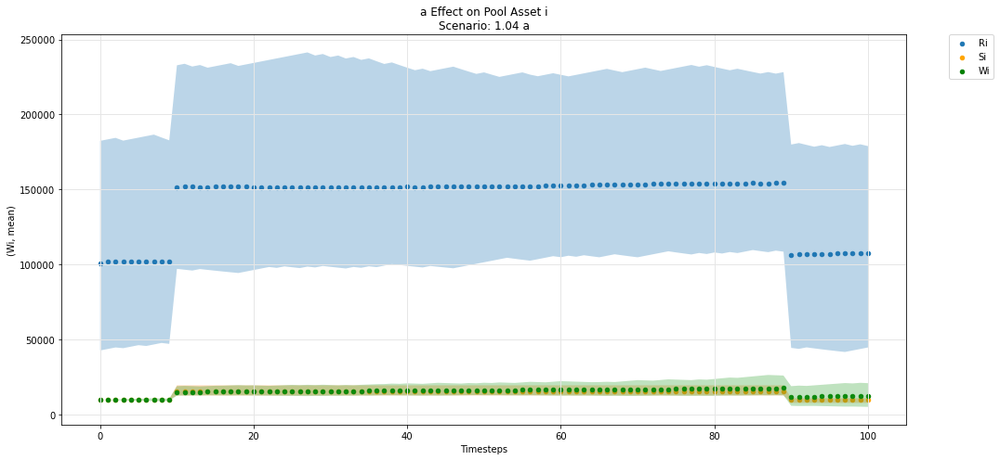

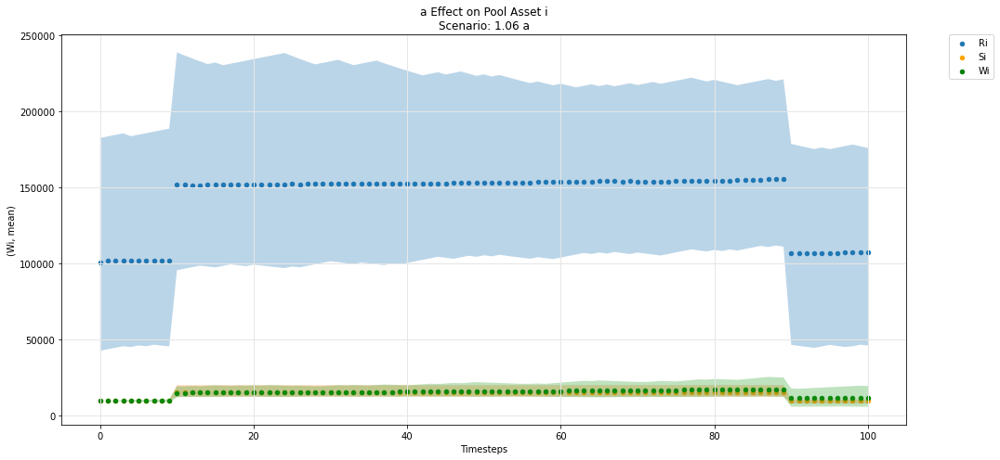

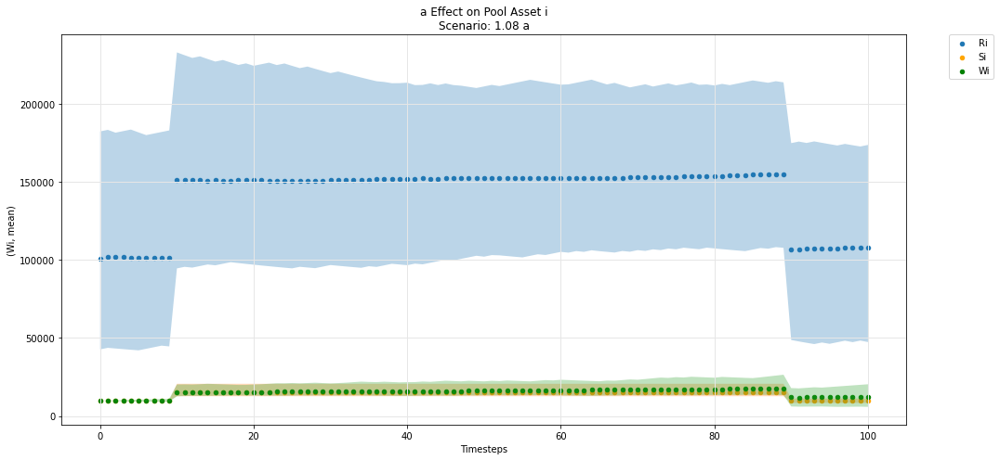

In [57]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

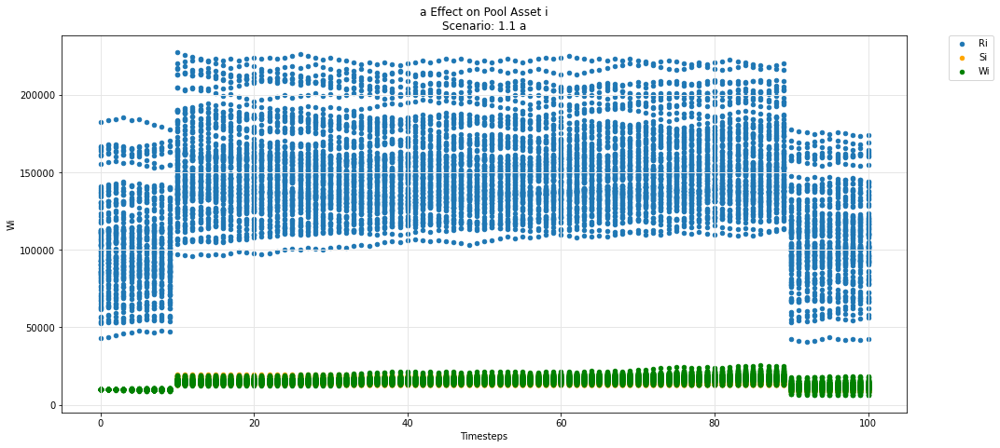

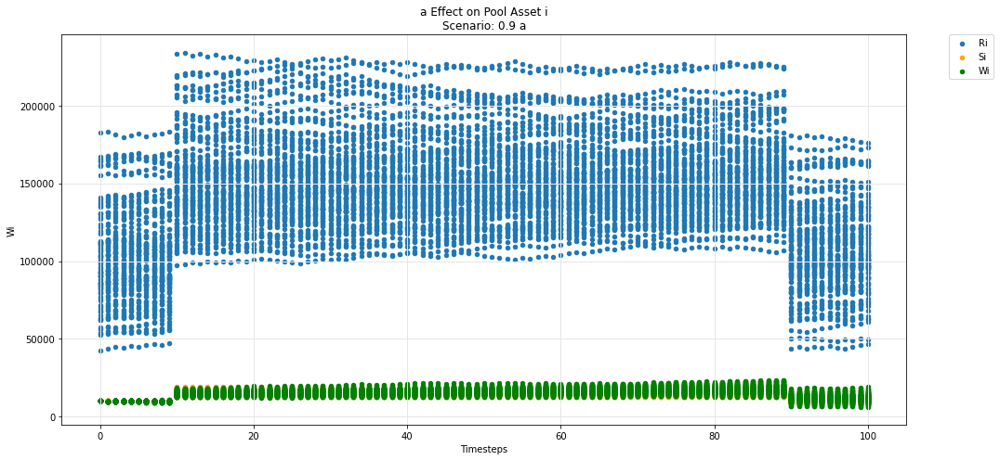

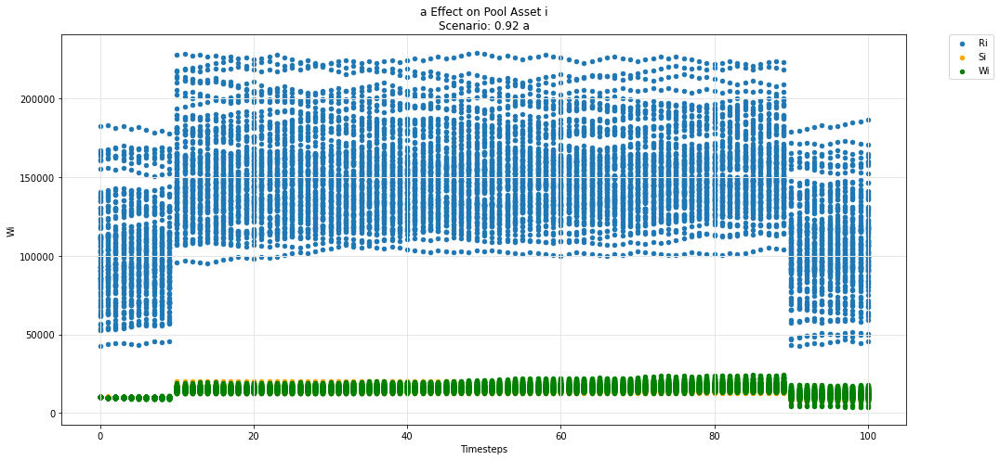

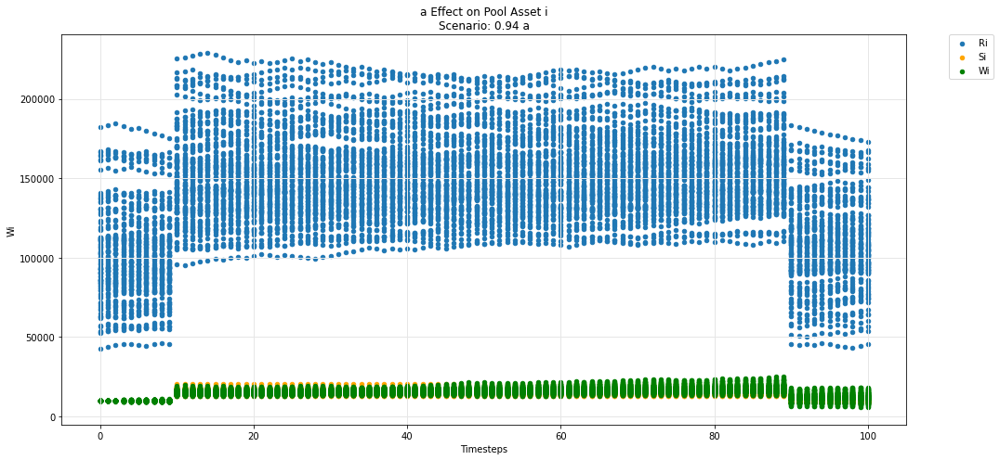

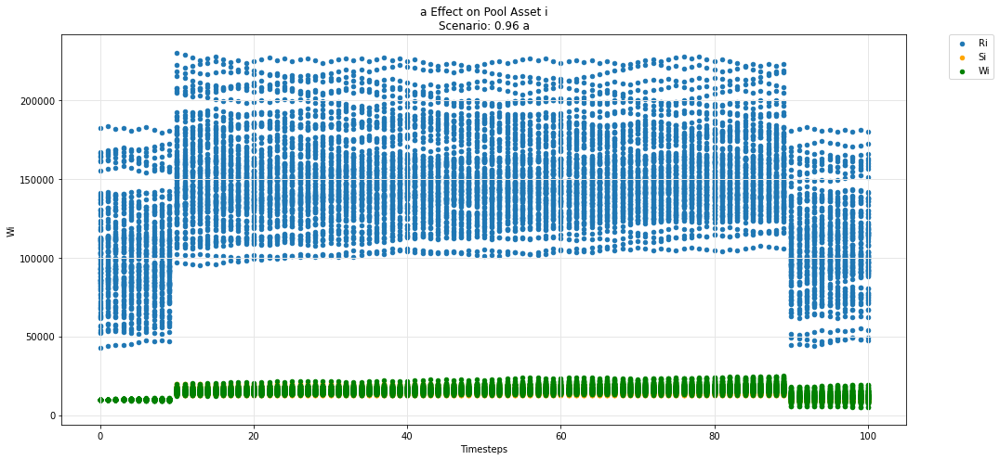

...

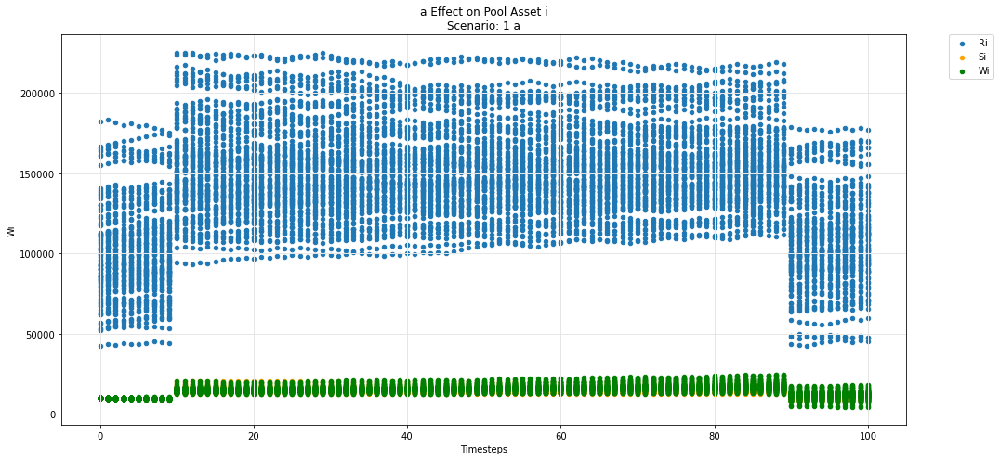

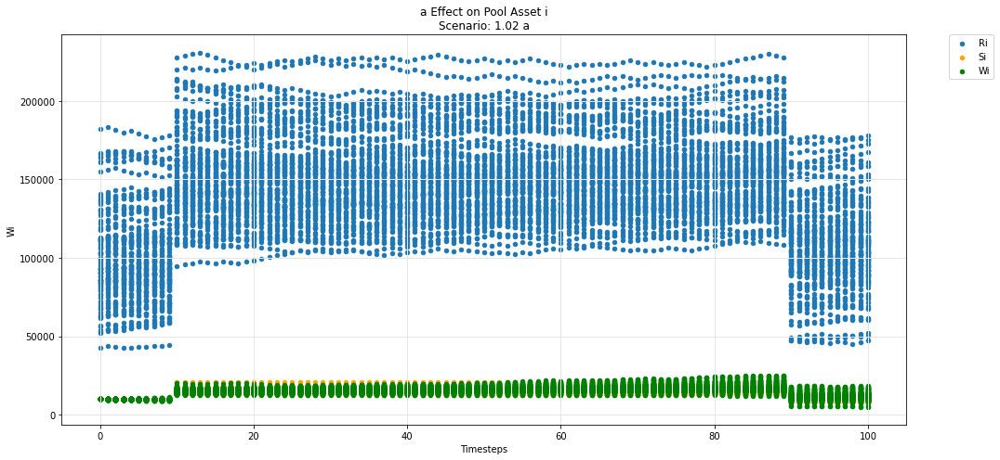

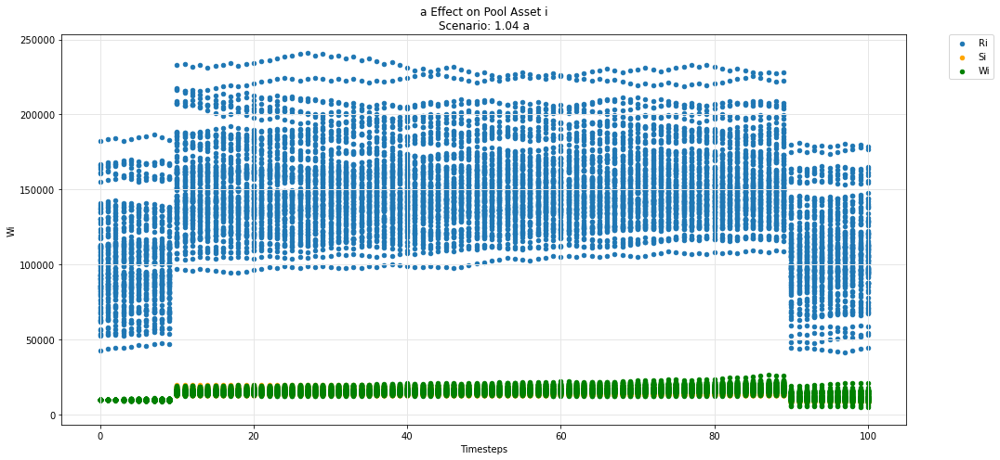

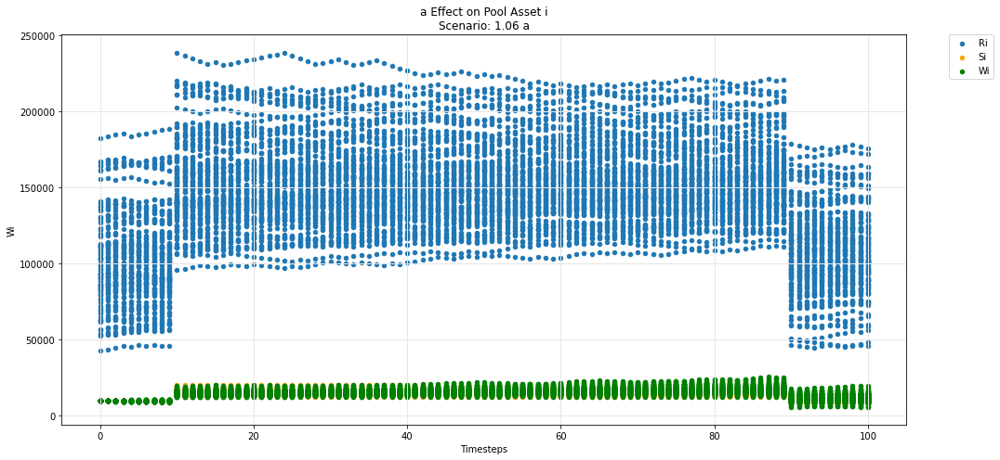

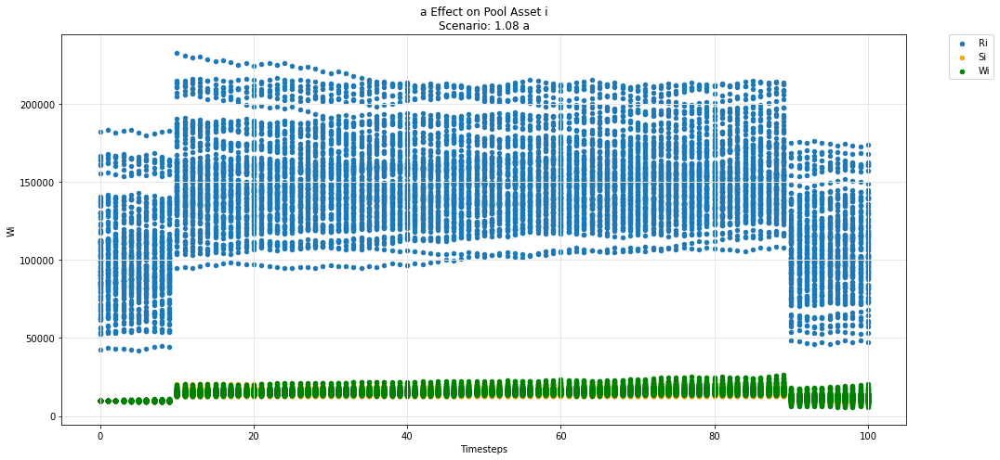

In [58]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

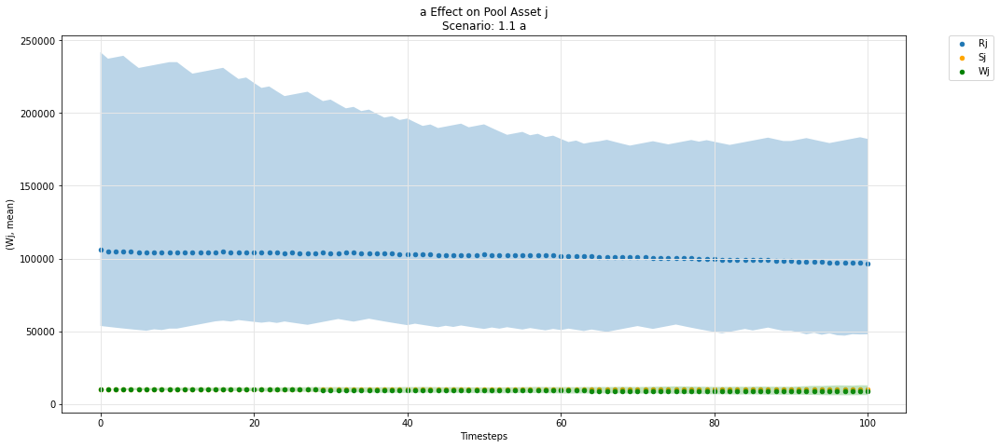

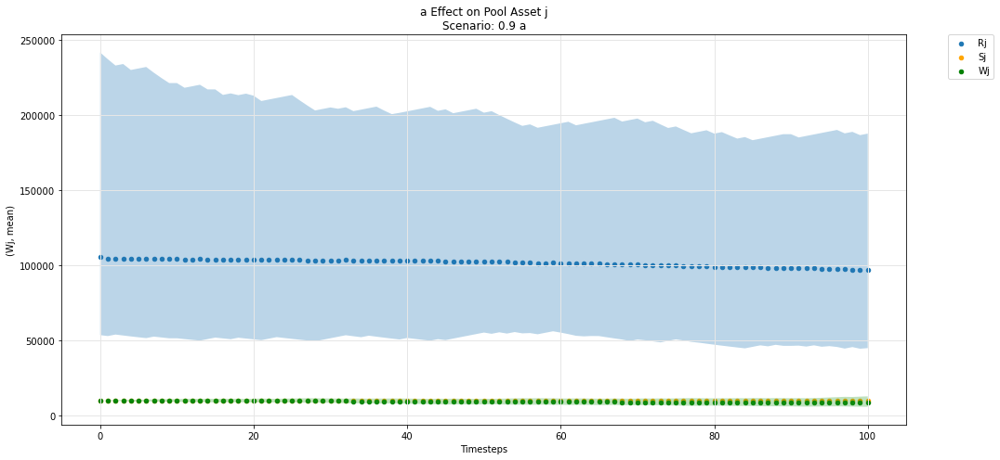

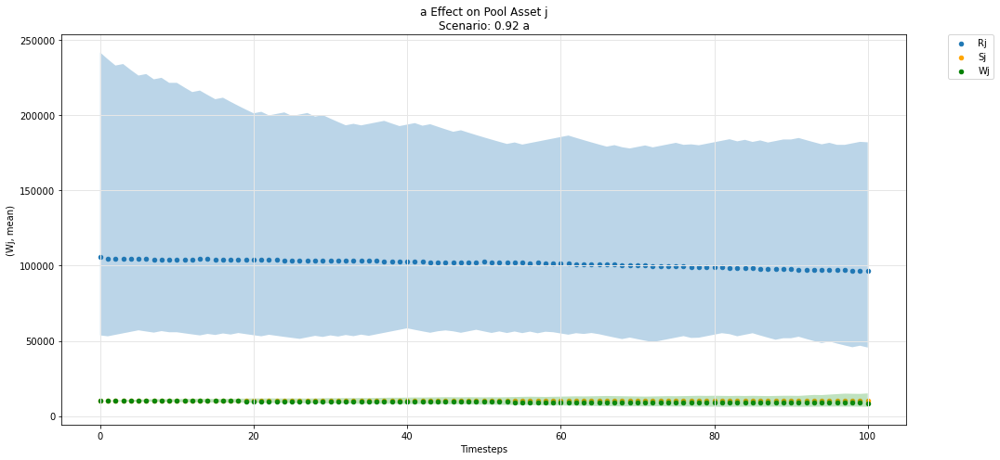

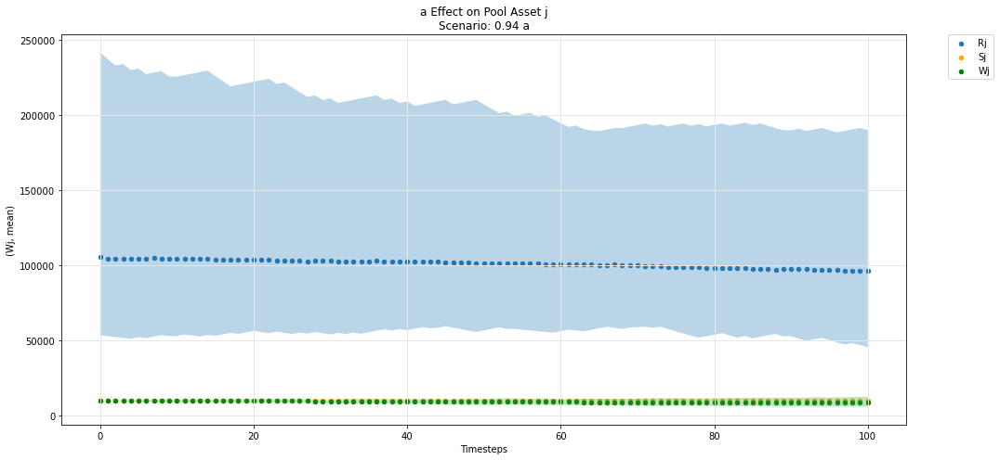

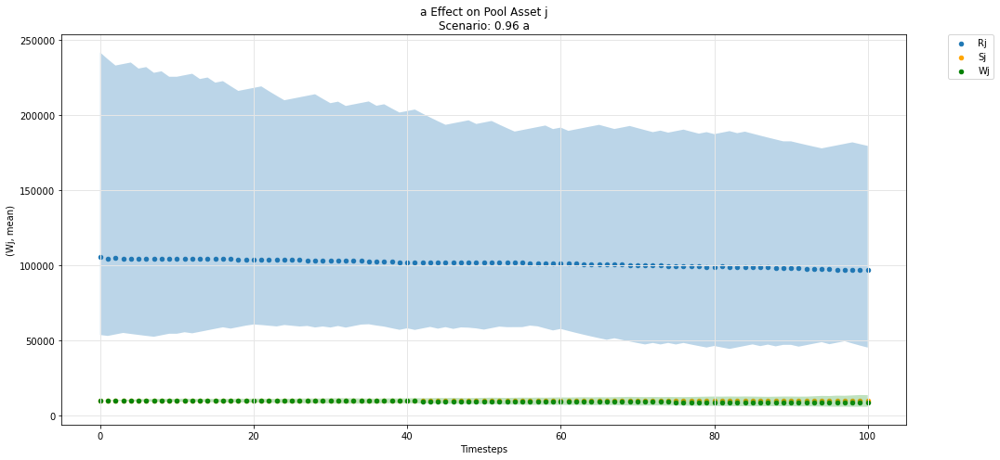

...

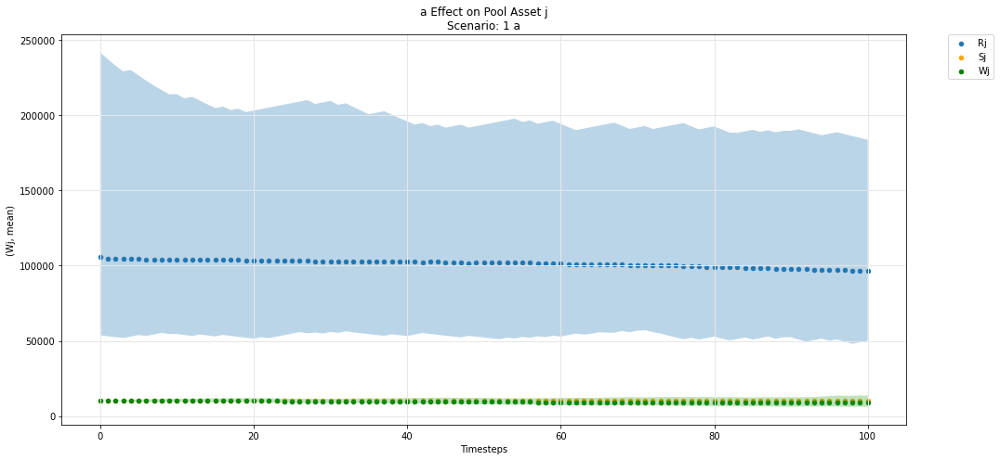

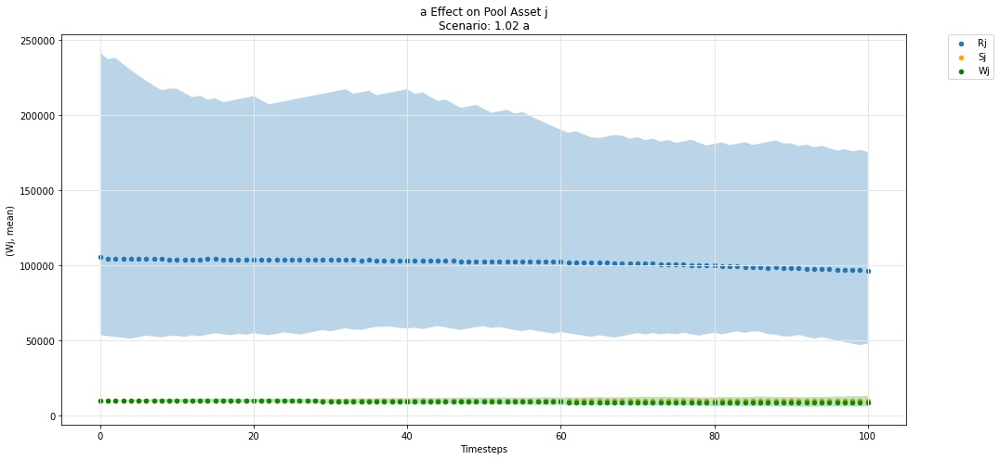

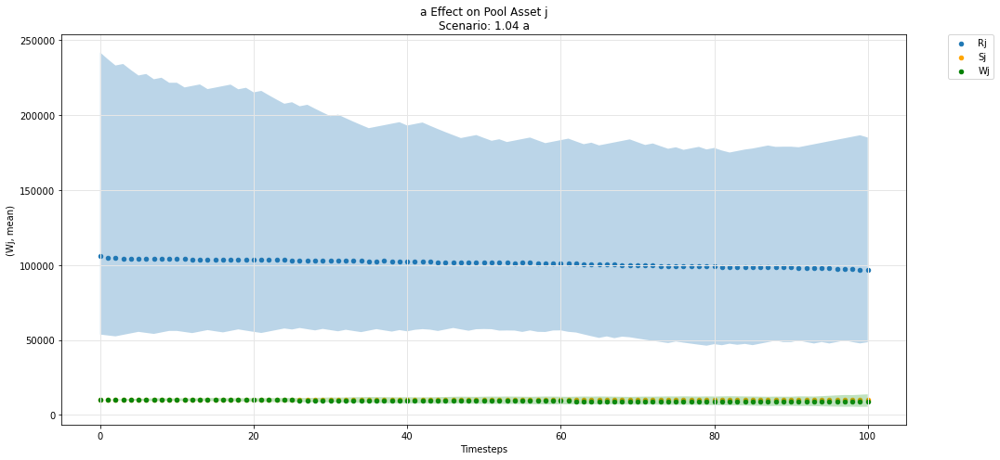

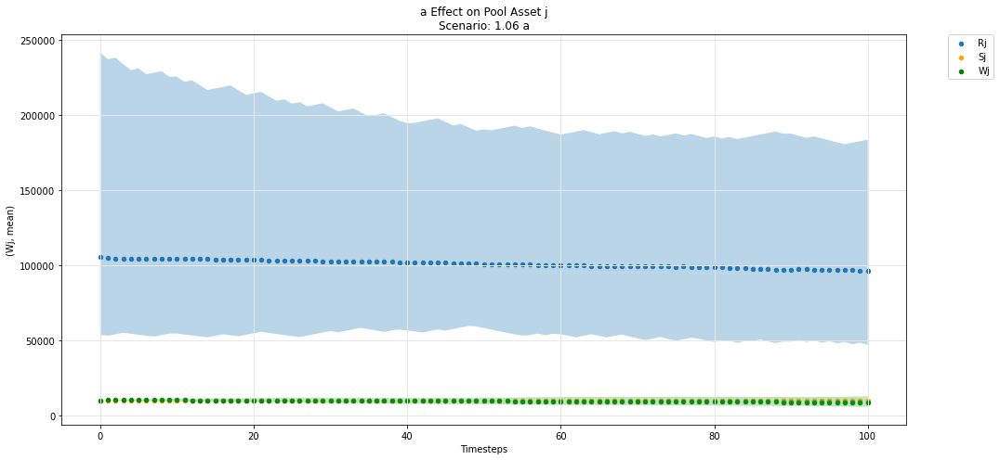

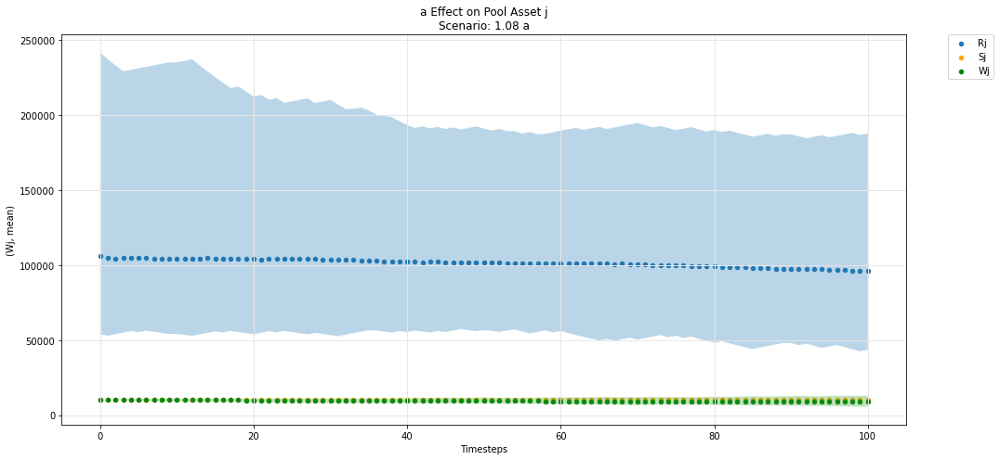

In [59]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

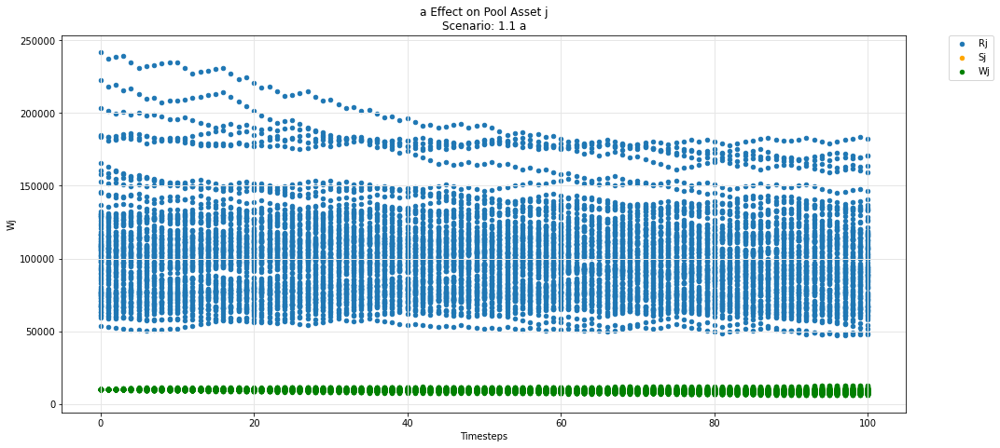

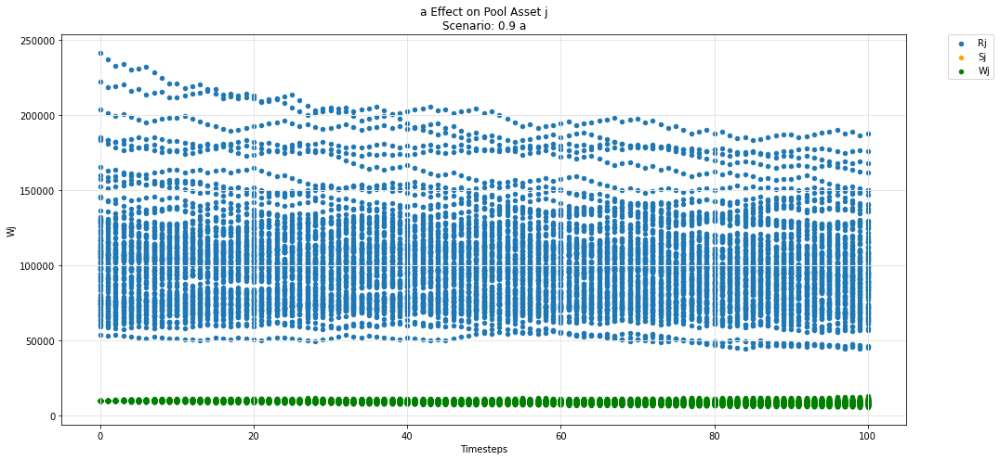

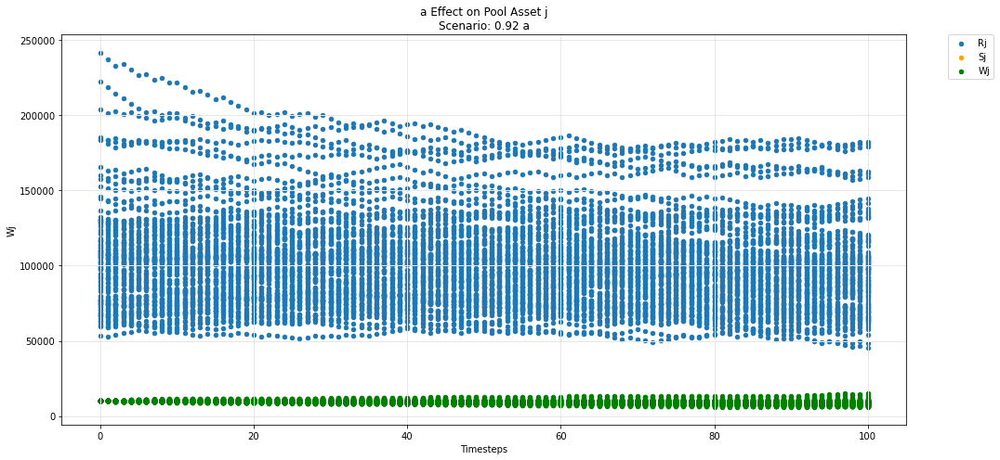

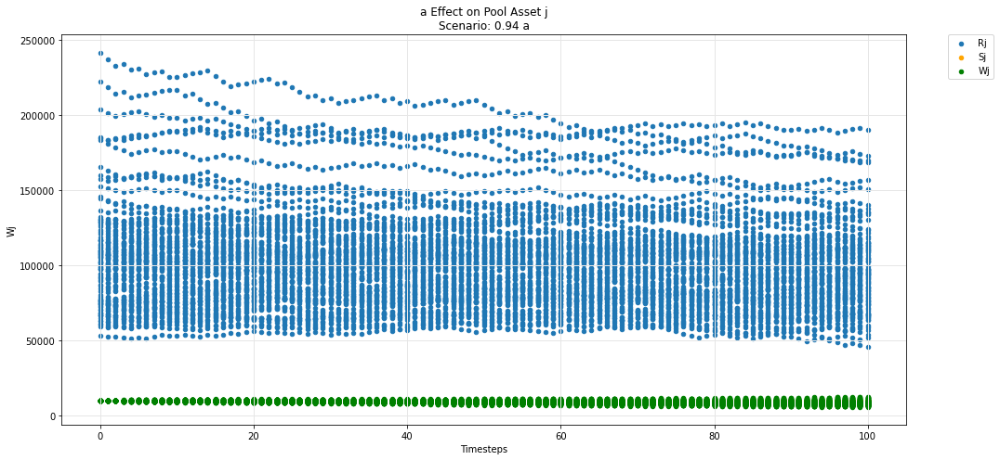

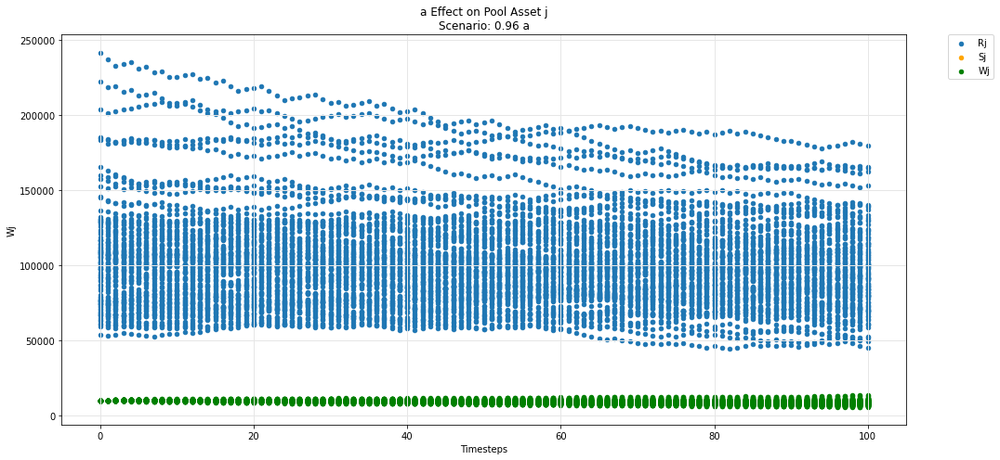

...

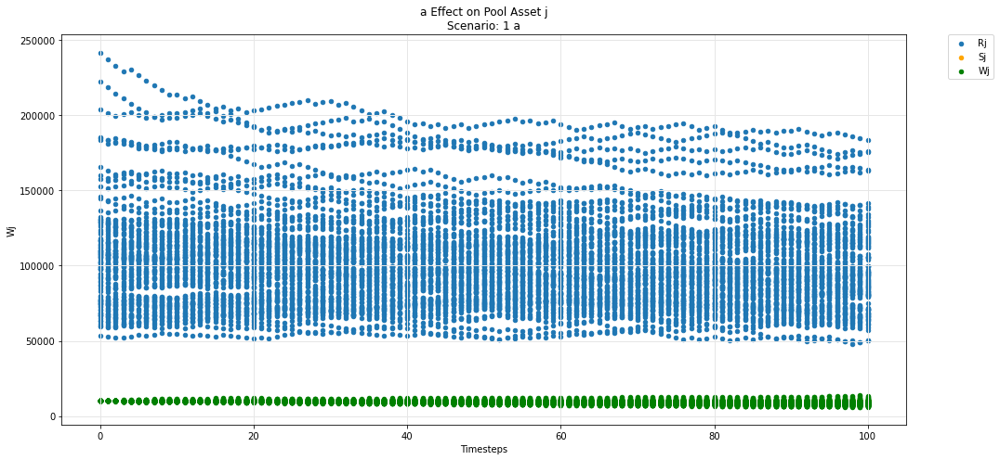

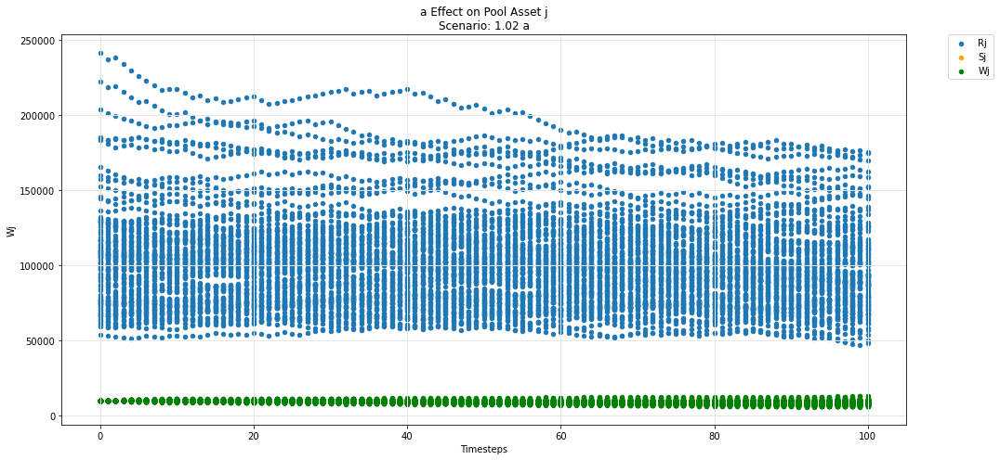

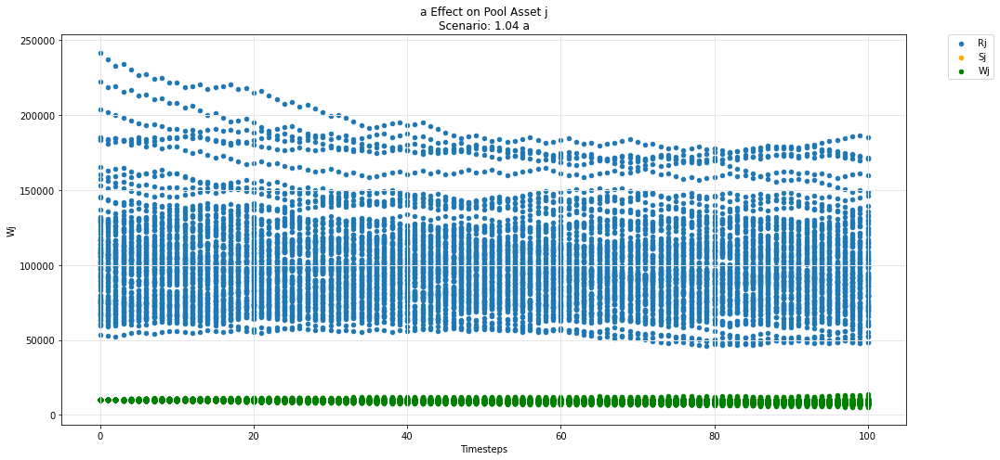

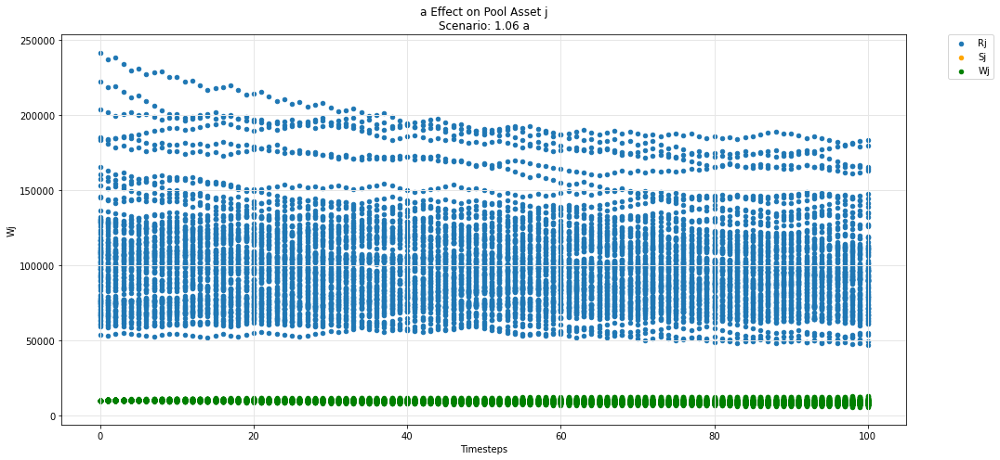

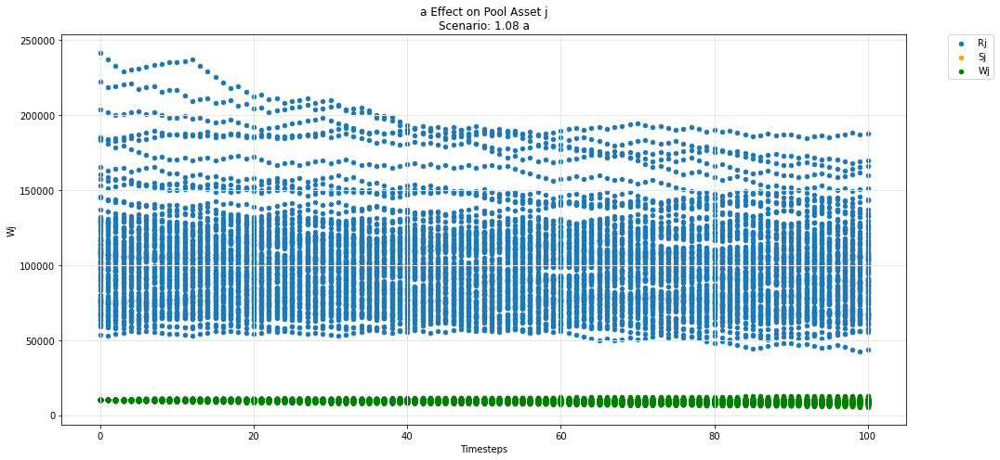

In [60]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

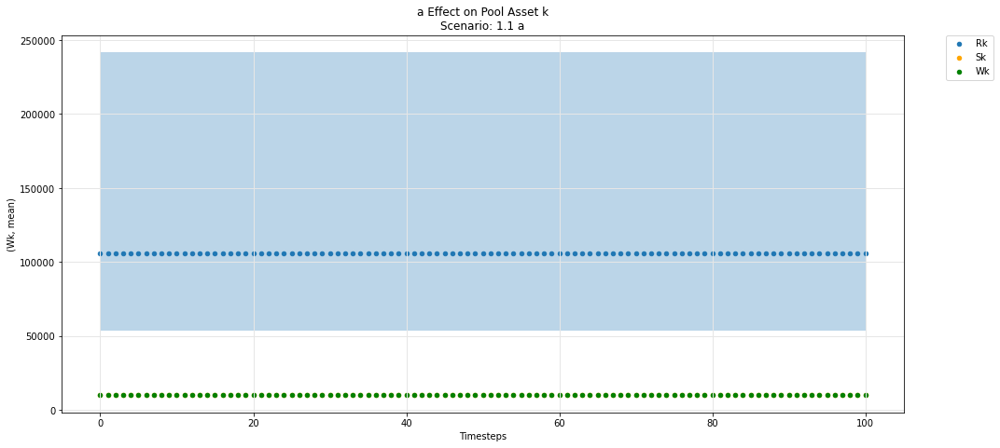

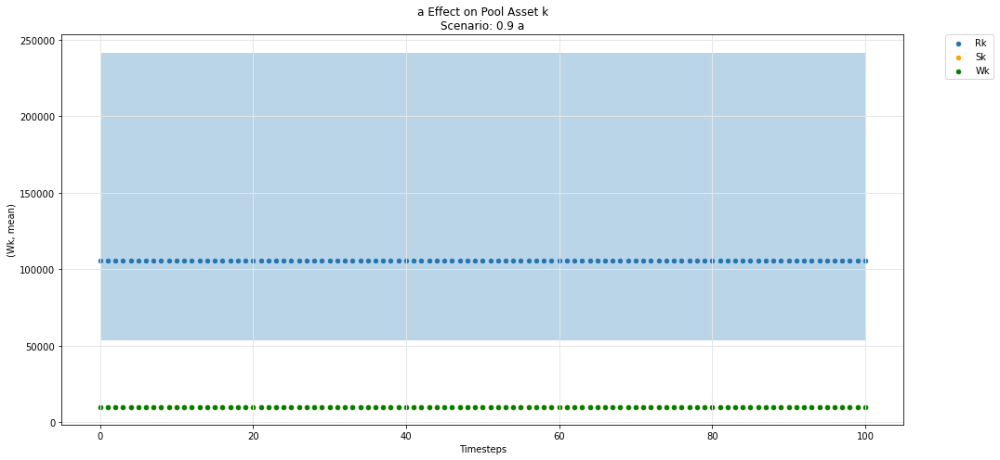

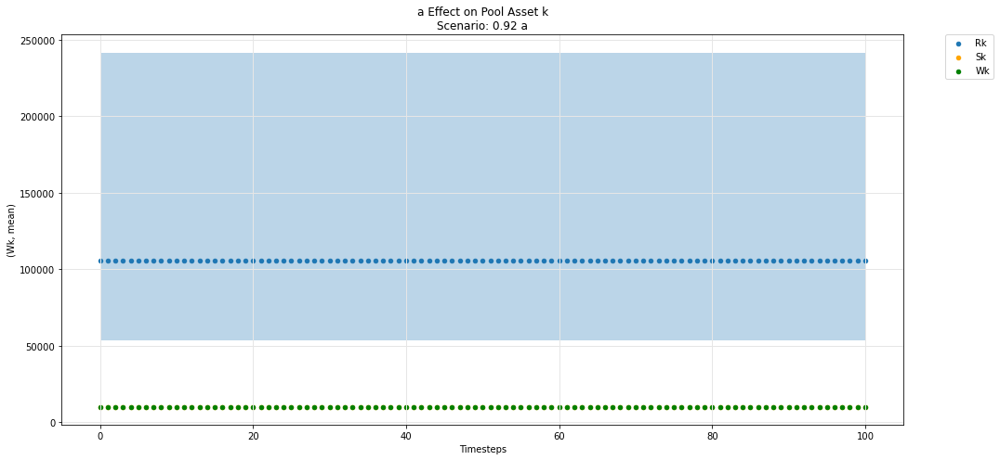

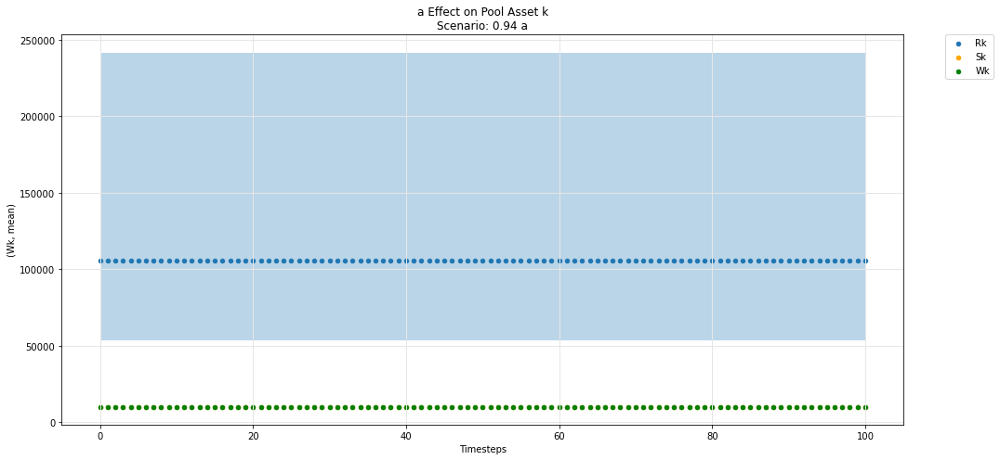

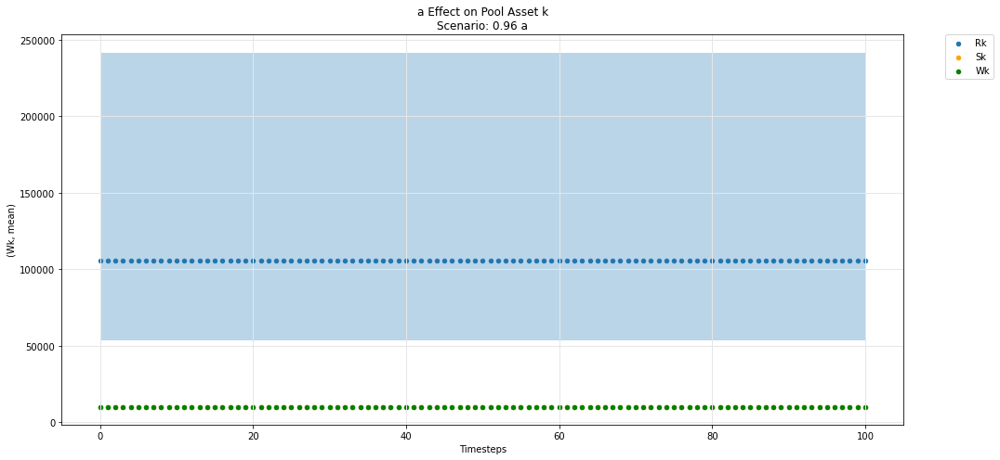

...

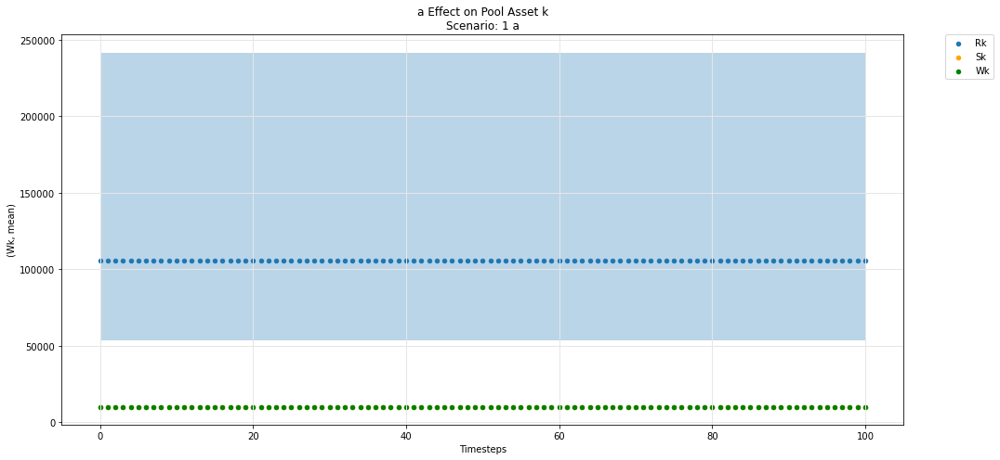

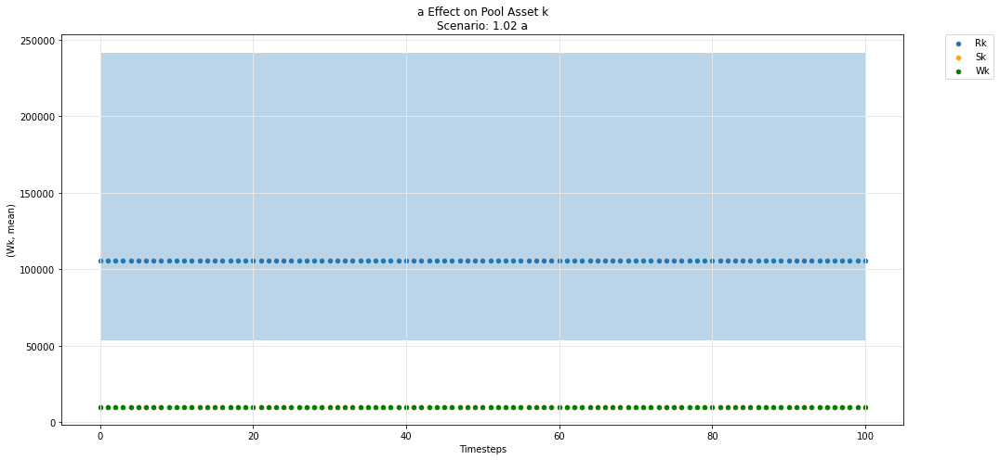

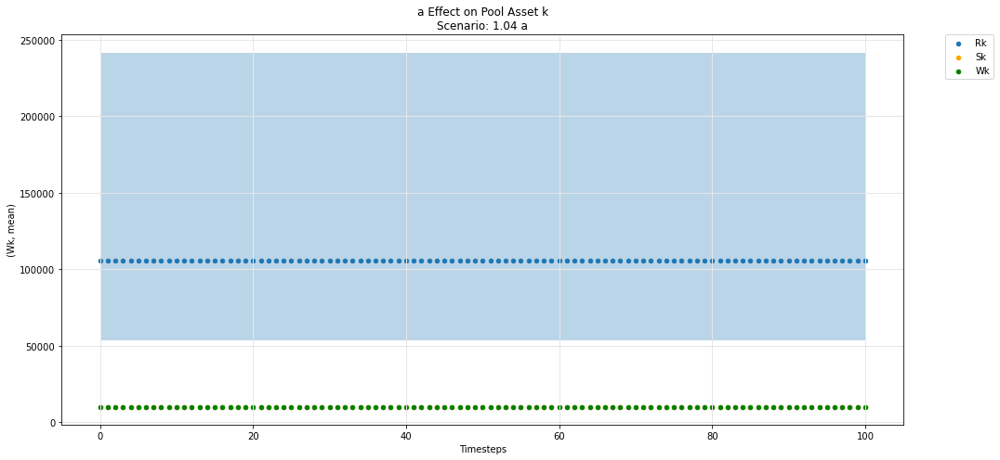

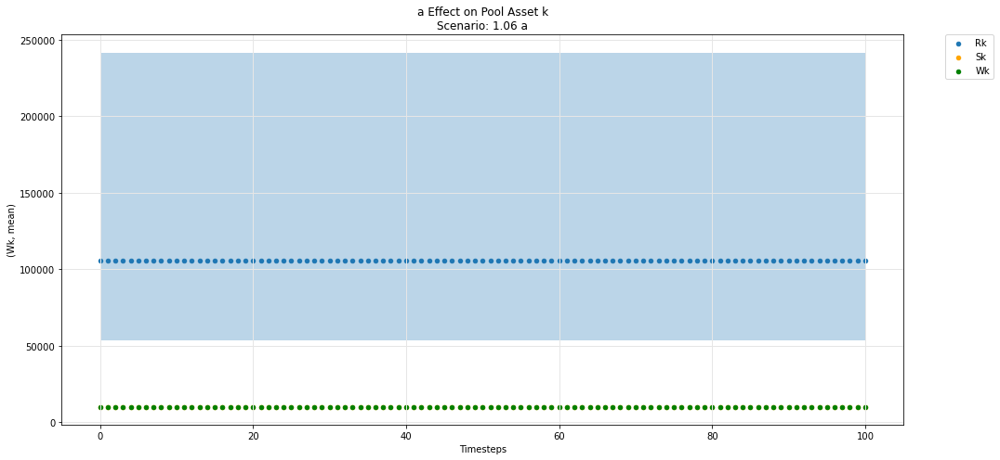

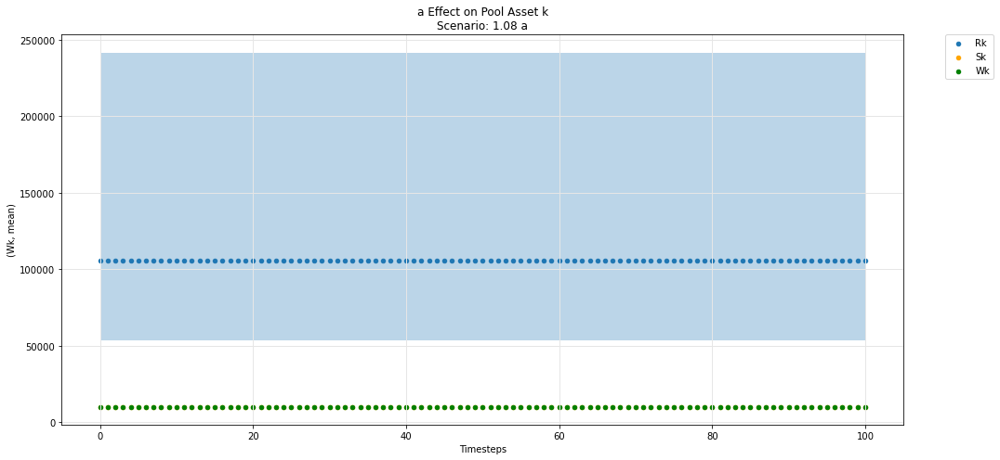

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

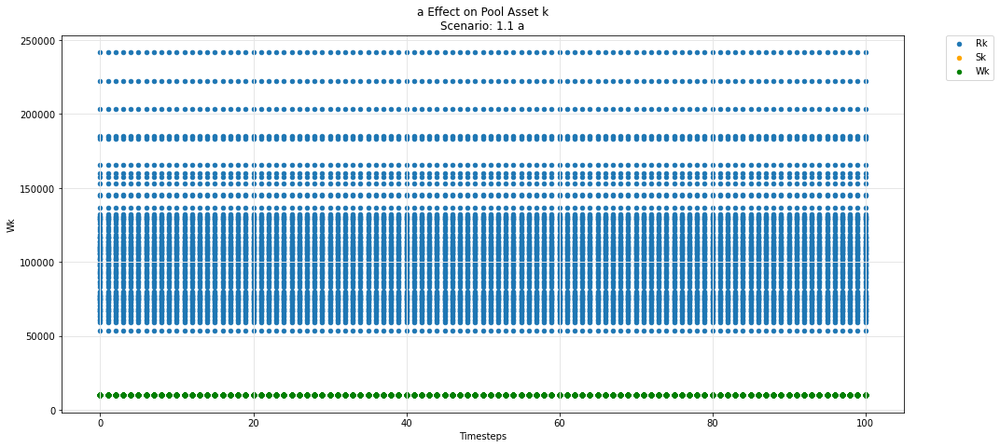

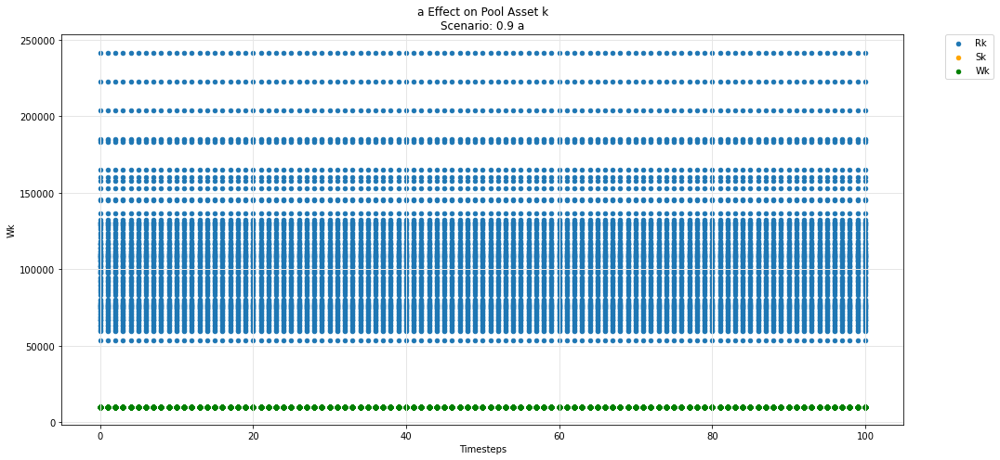

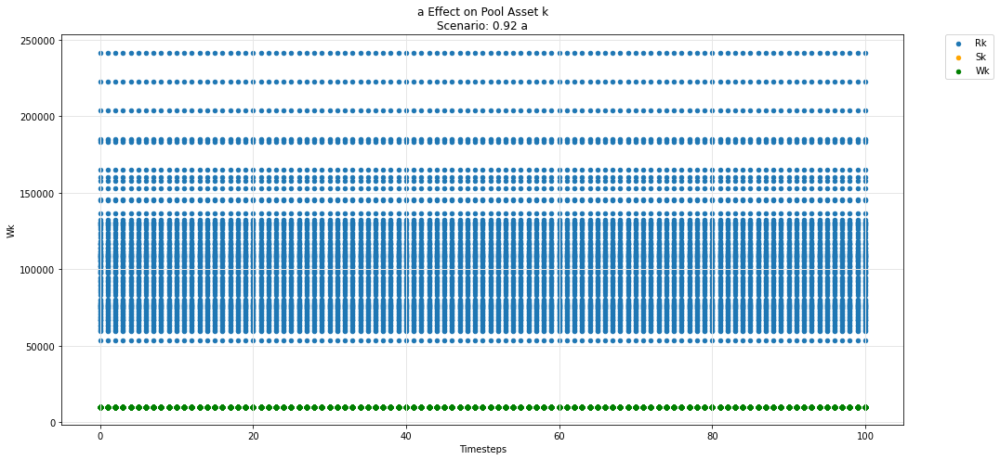

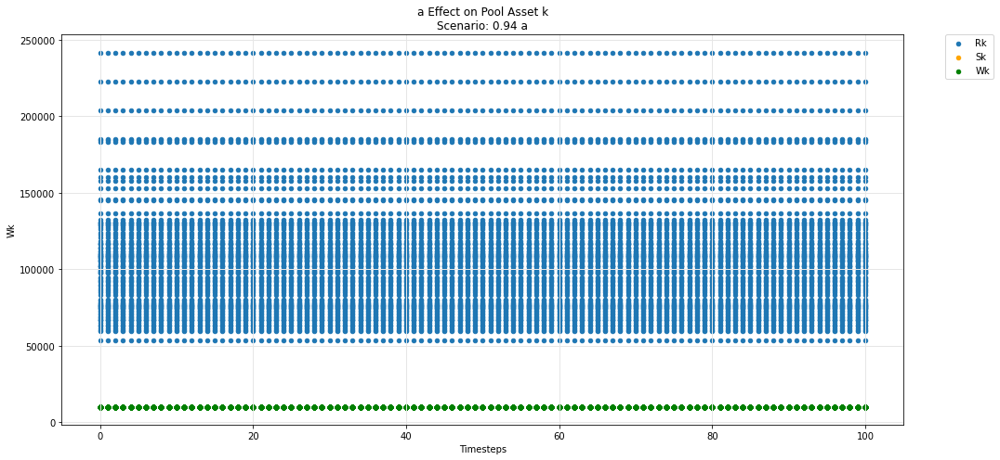

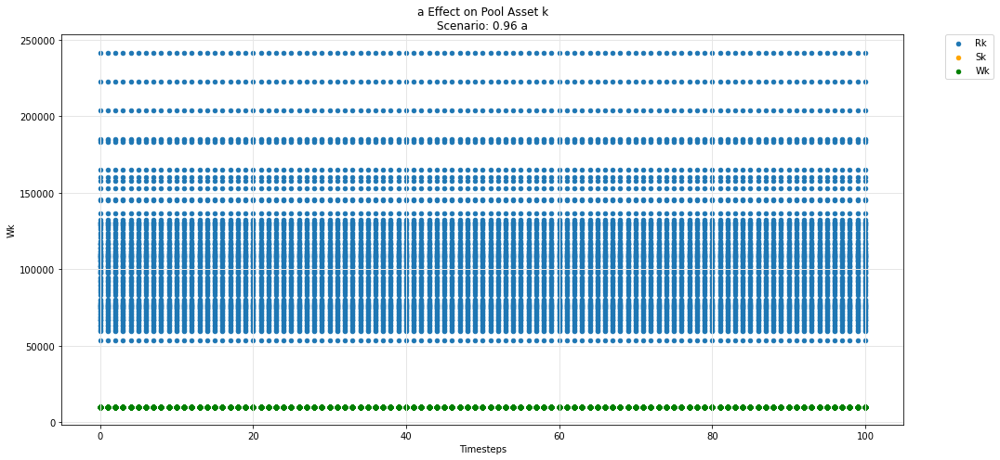

...

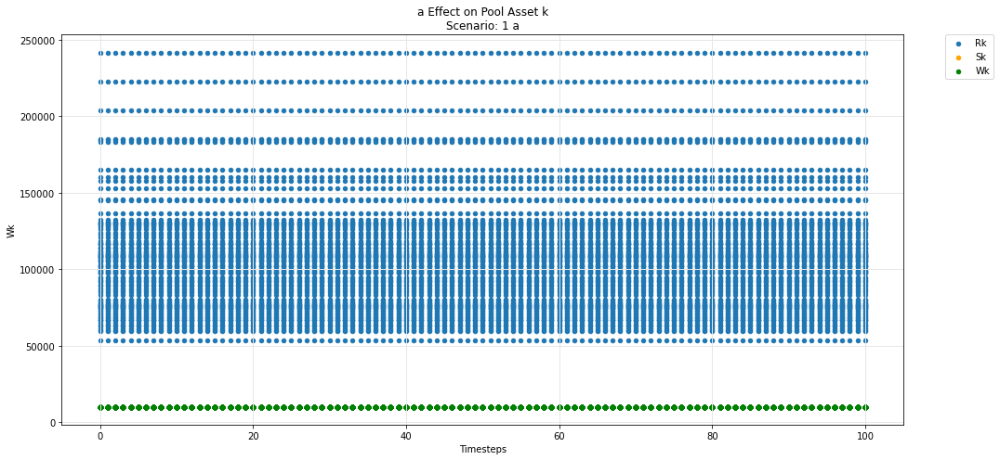

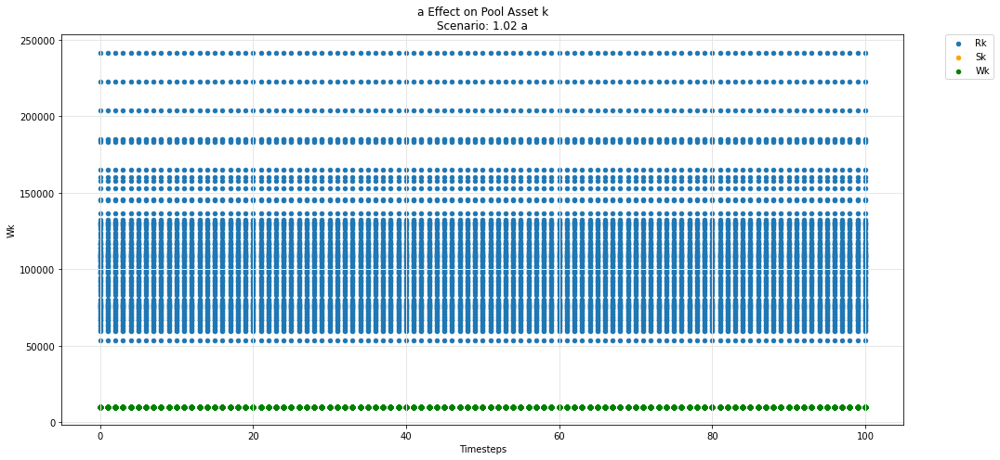

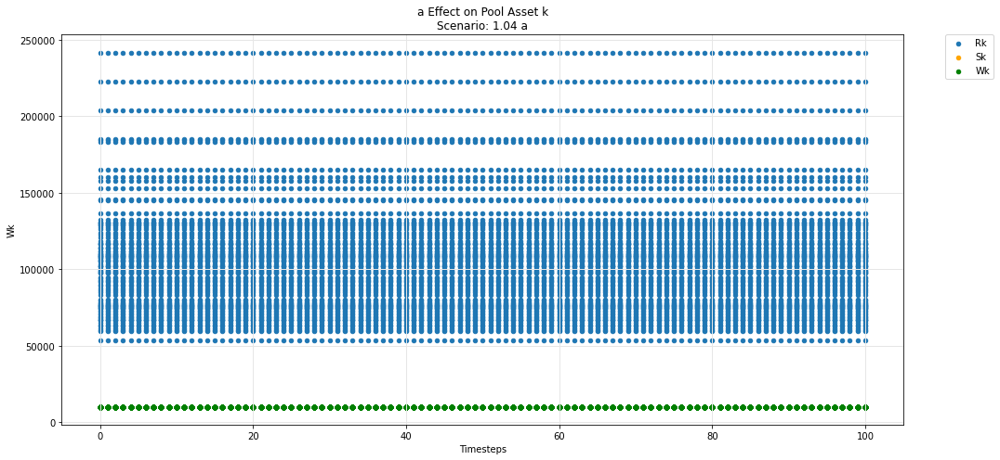

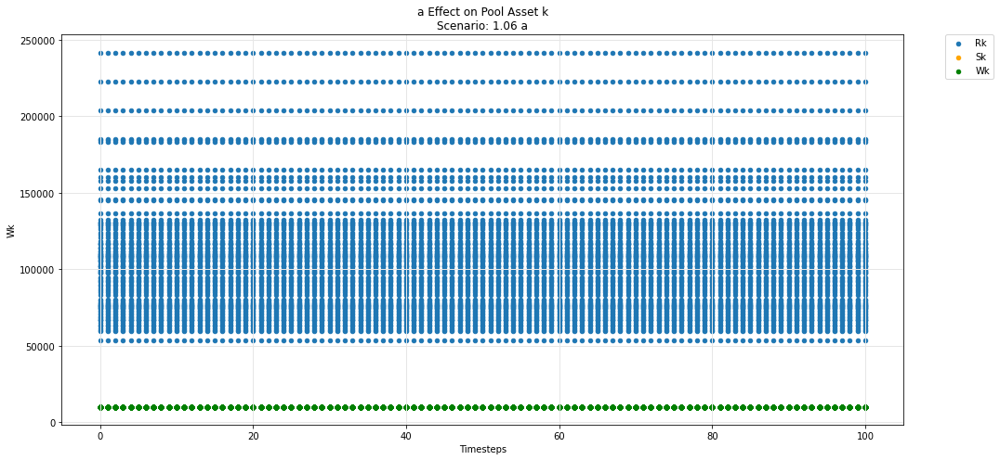

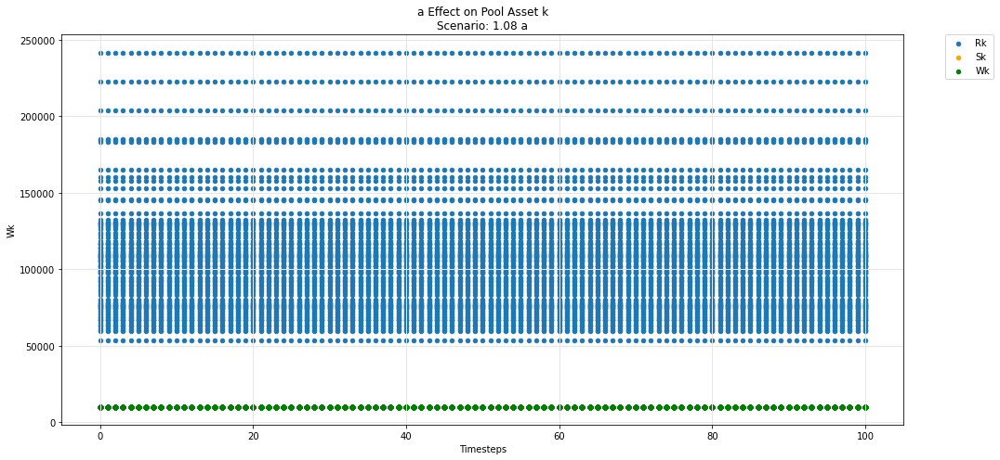

In [62]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [63]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

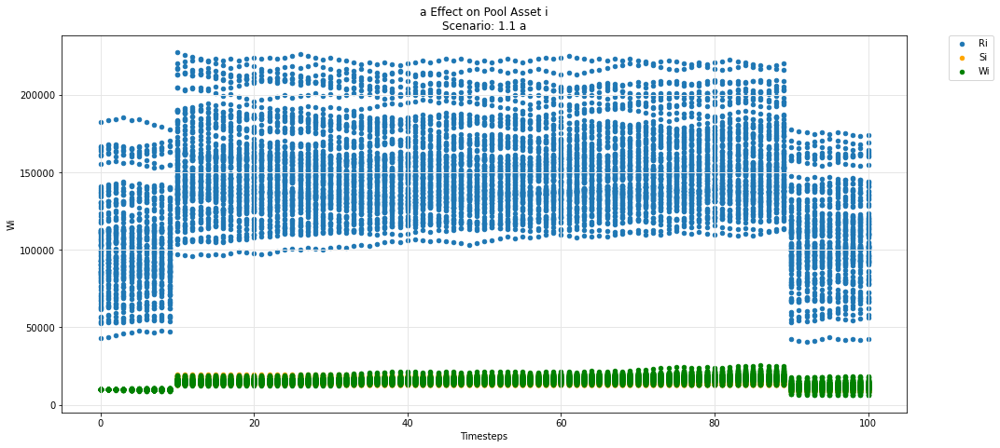

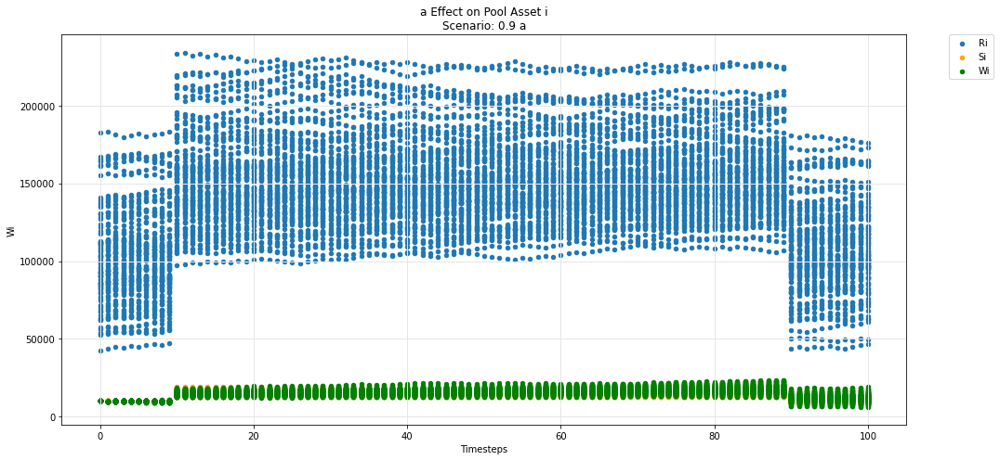

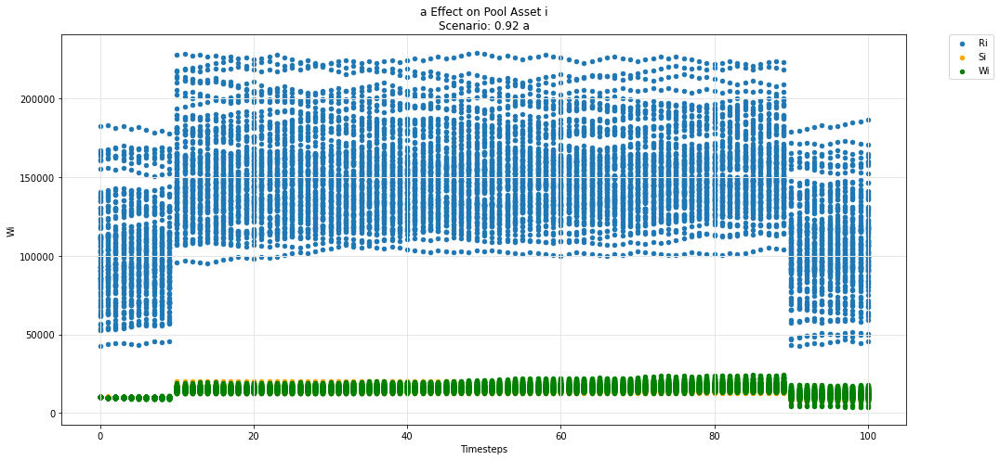

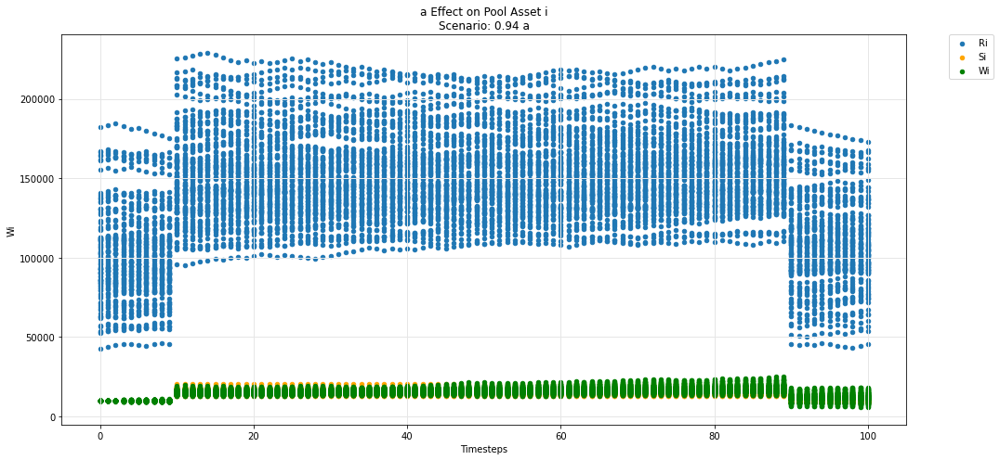

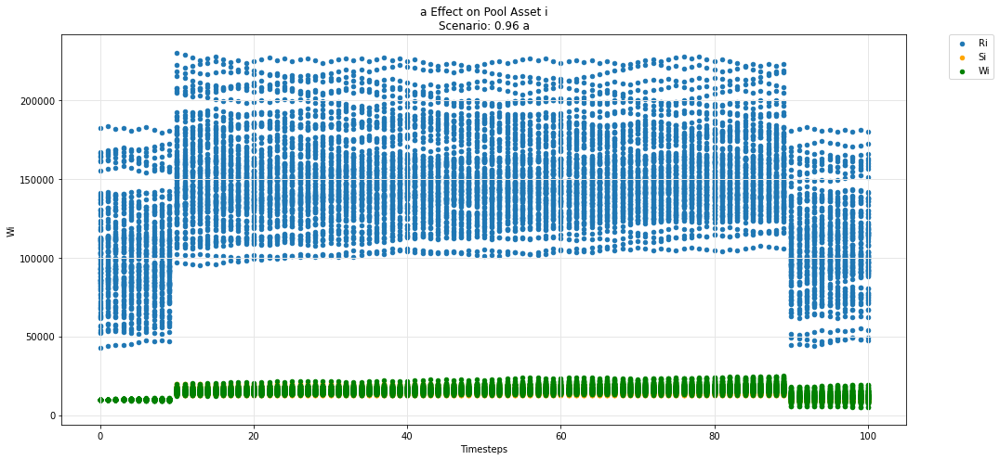

...

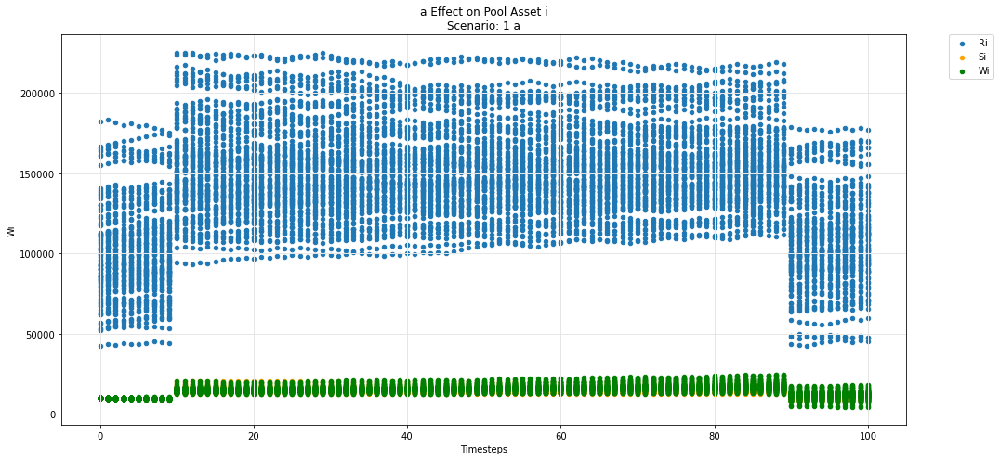

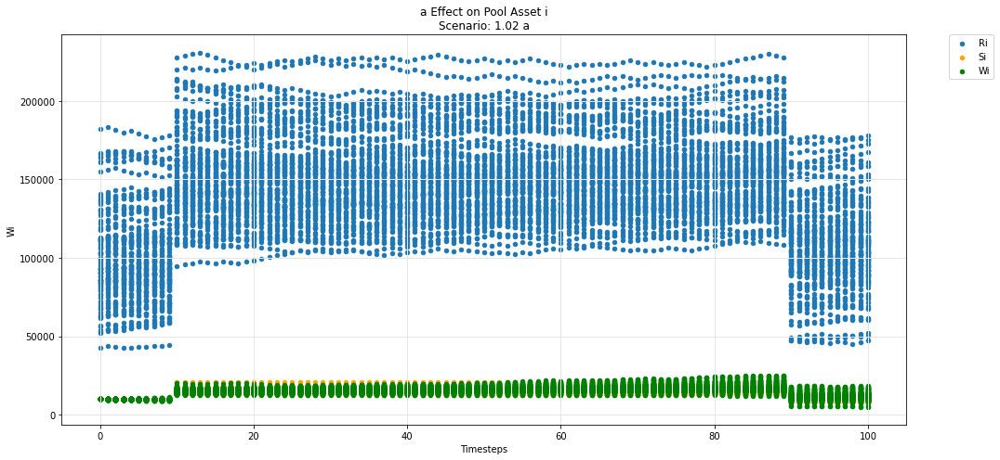

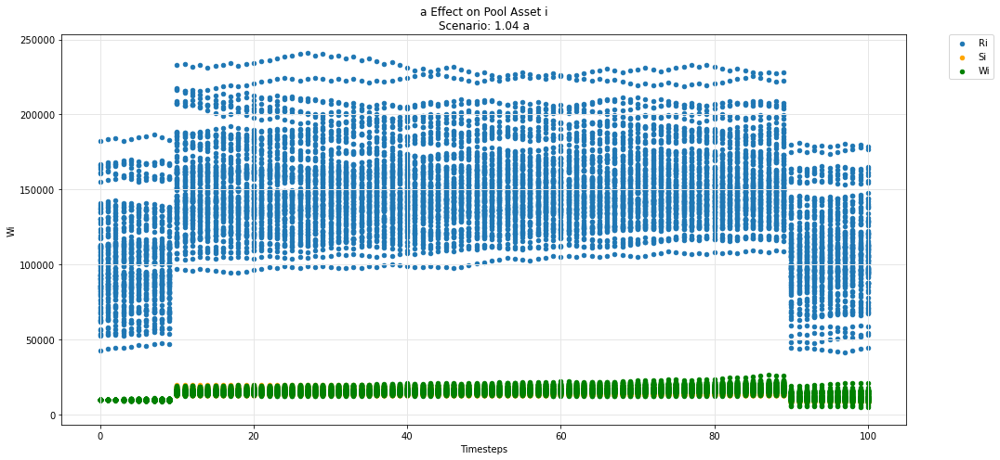

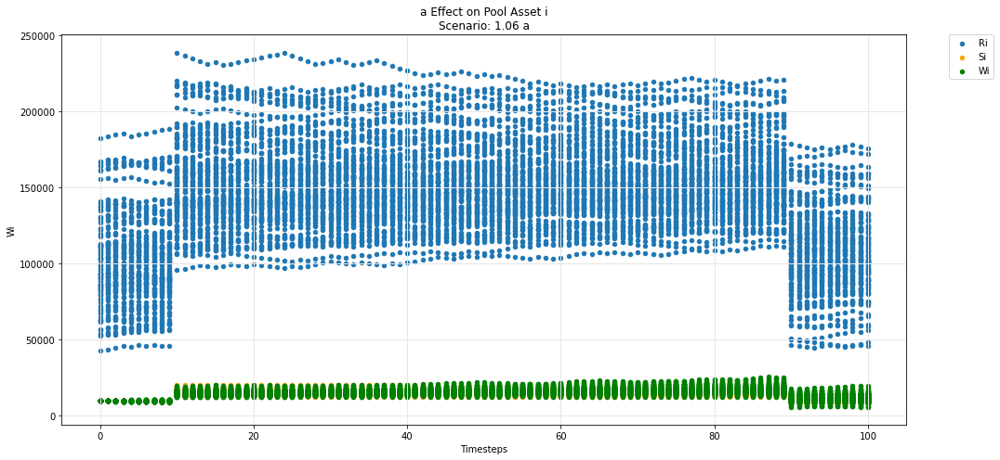

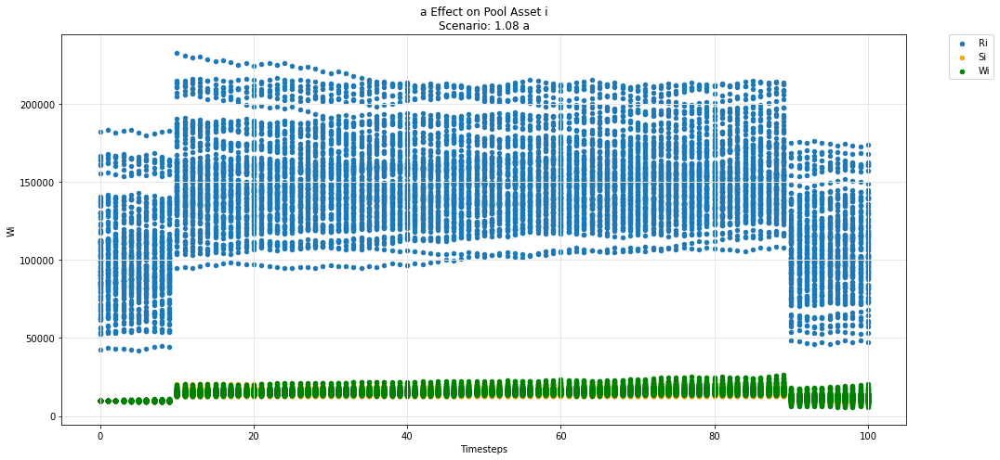

In [64]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

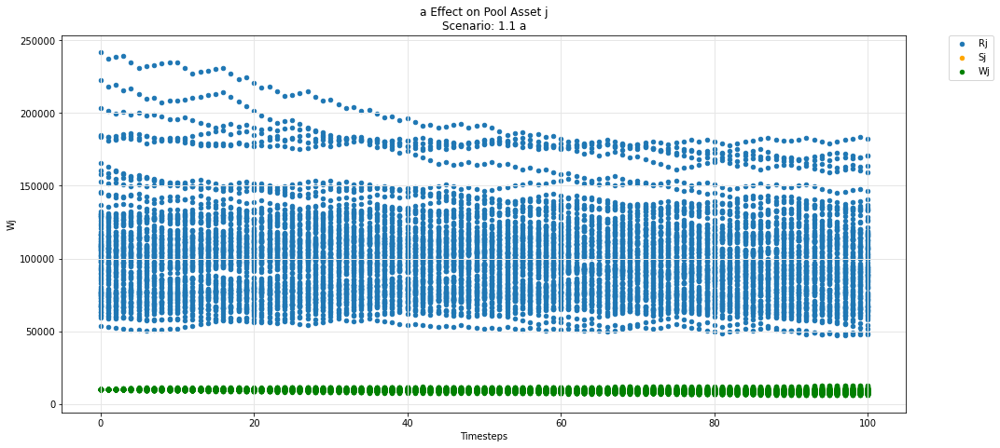

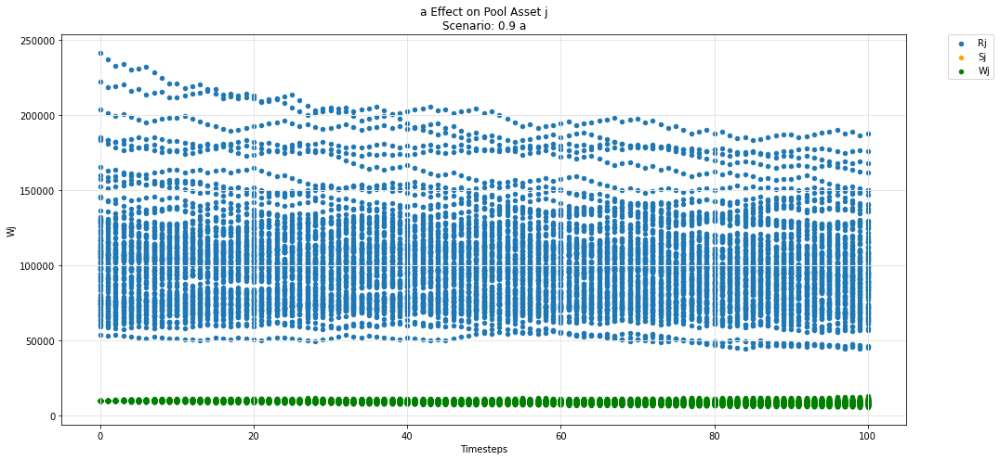

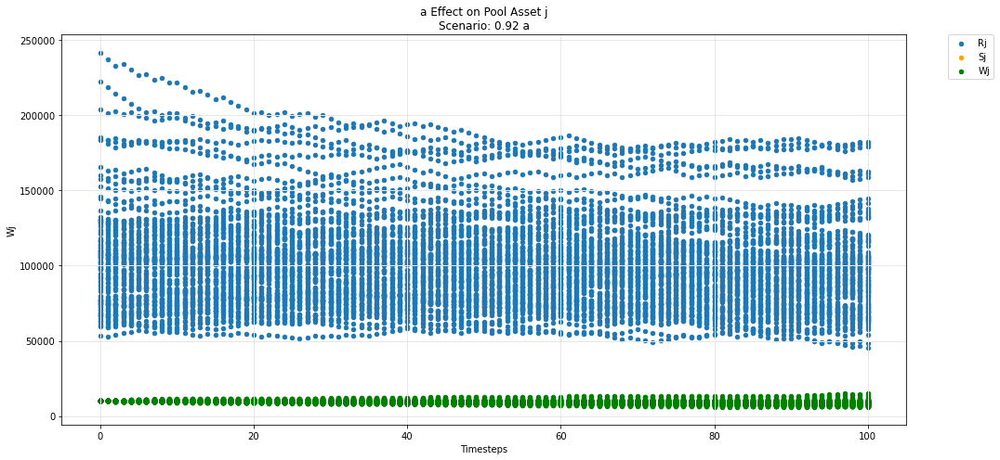

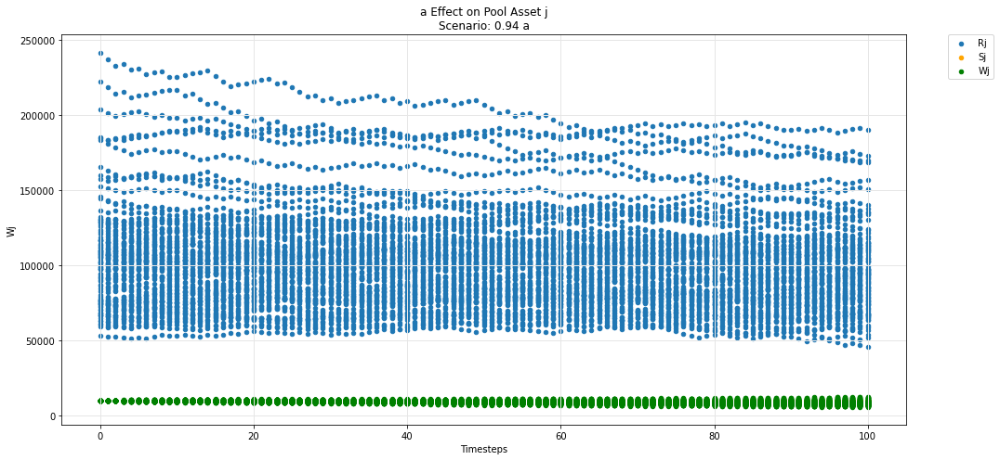

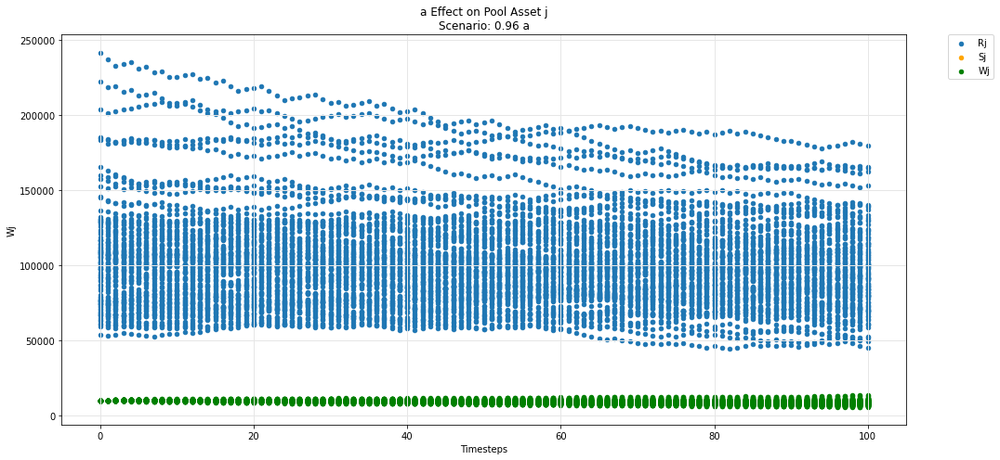

...

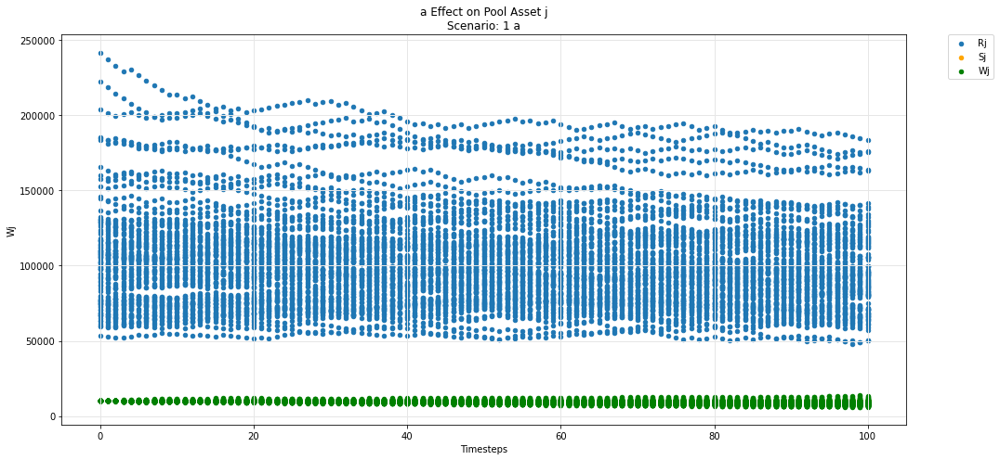

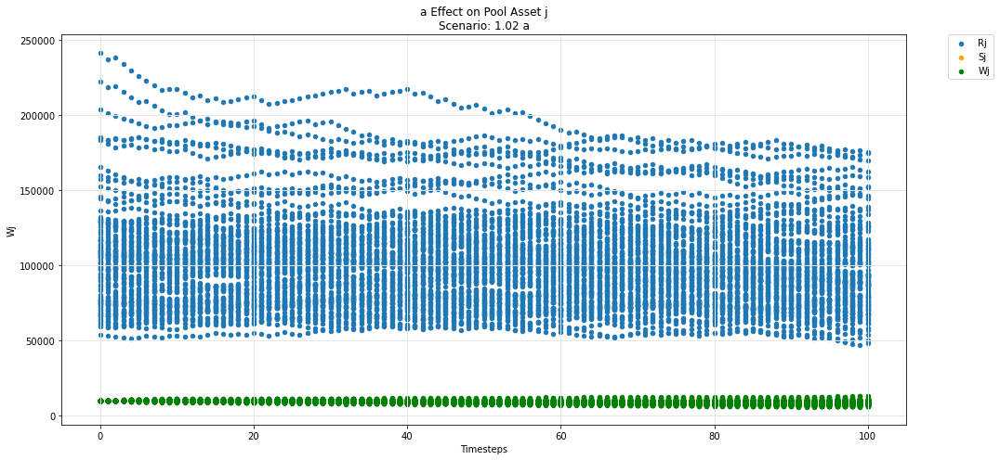

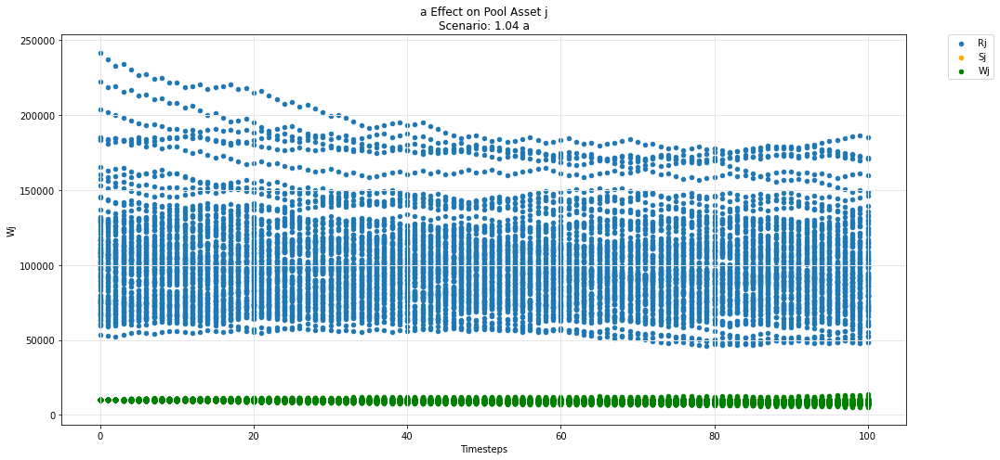

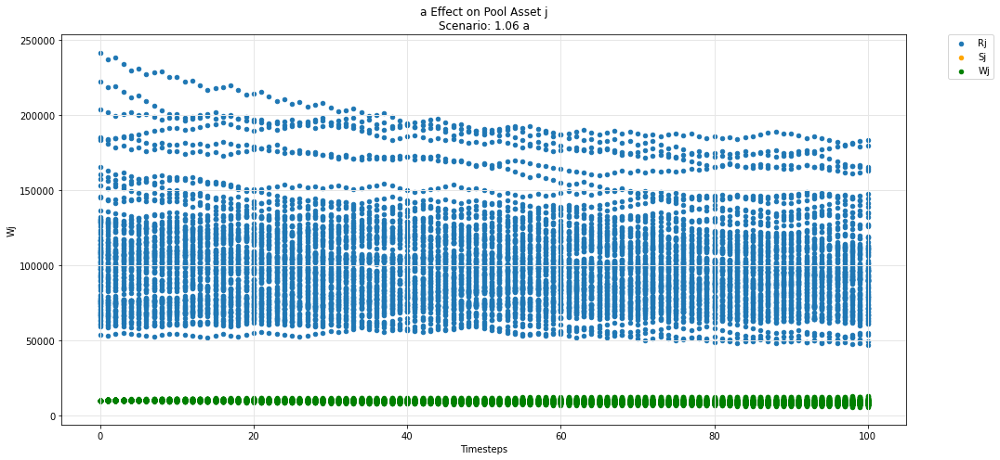

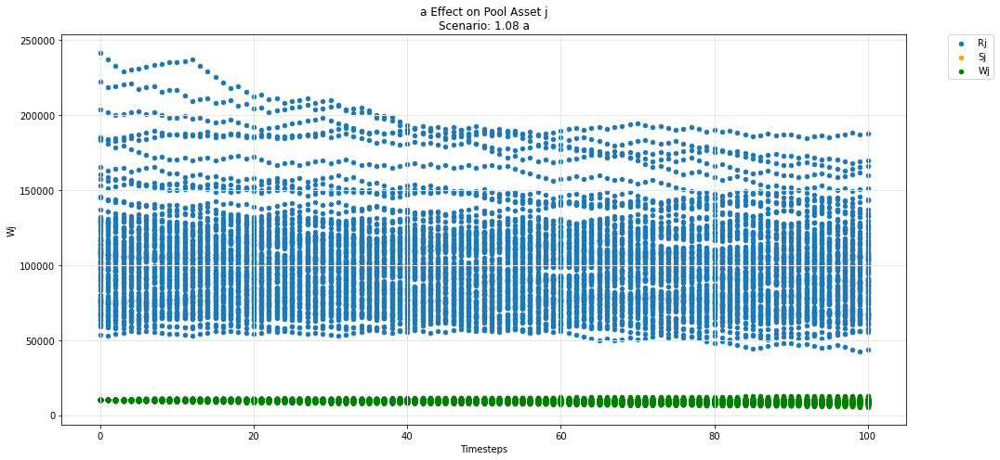

In [65]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [66]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

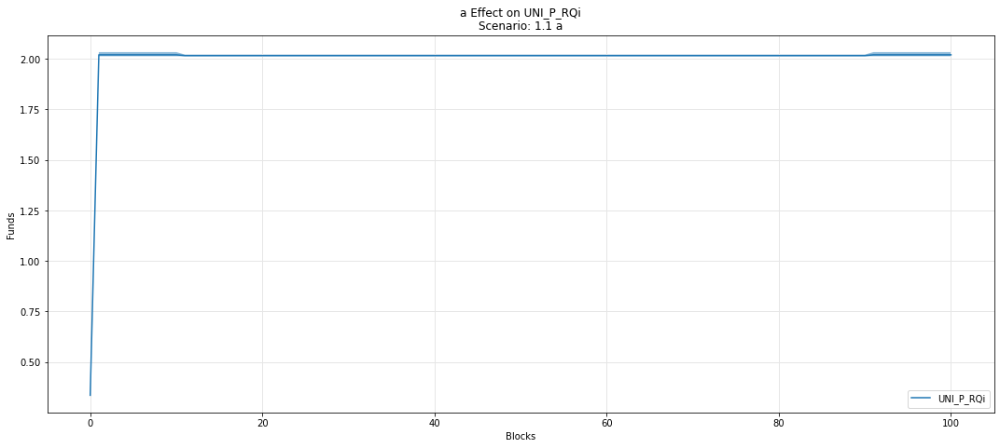

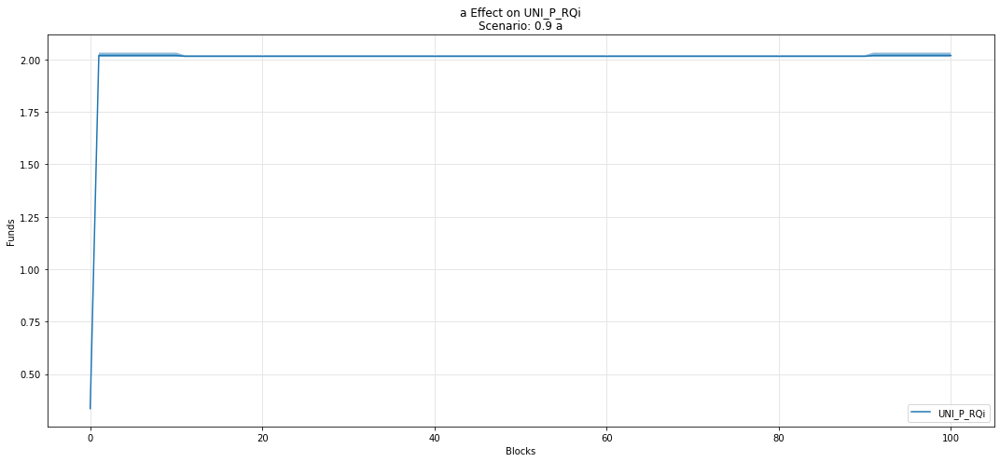

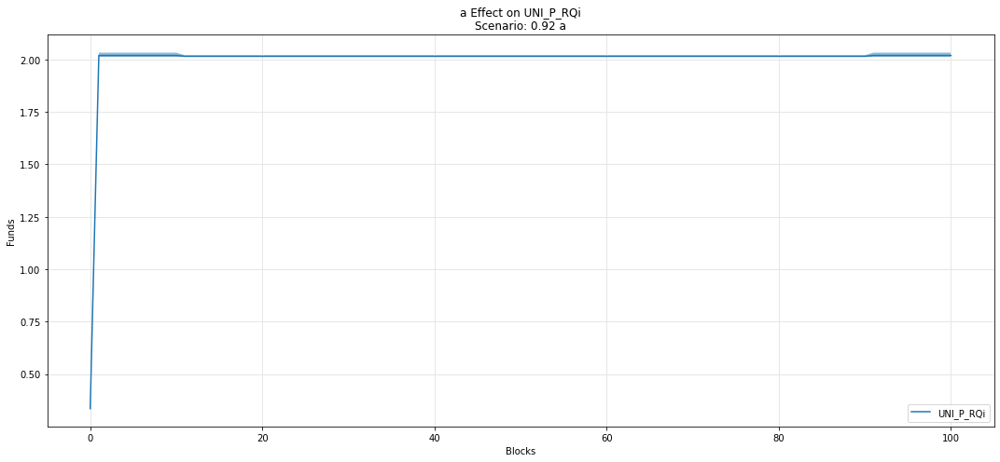

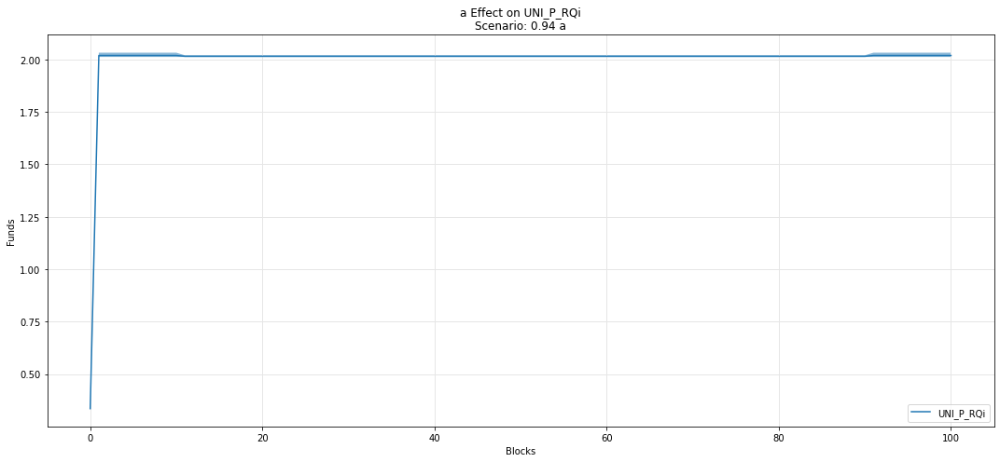

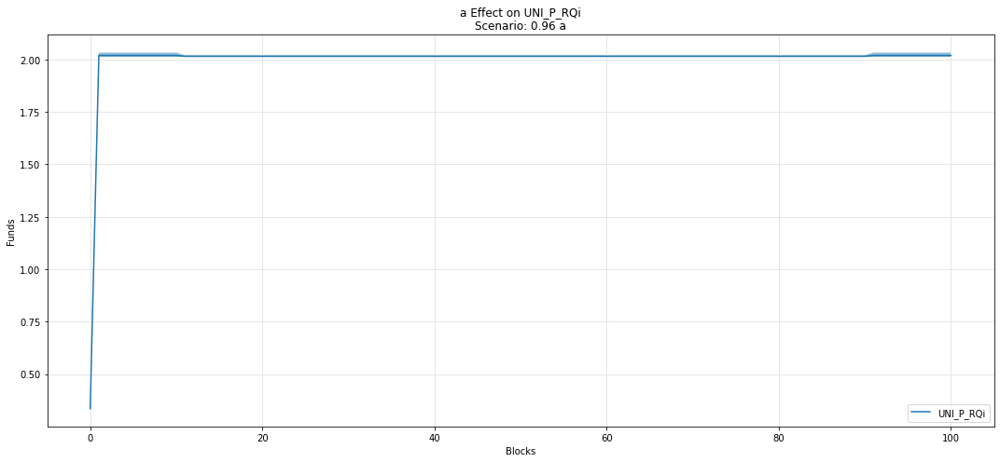

...

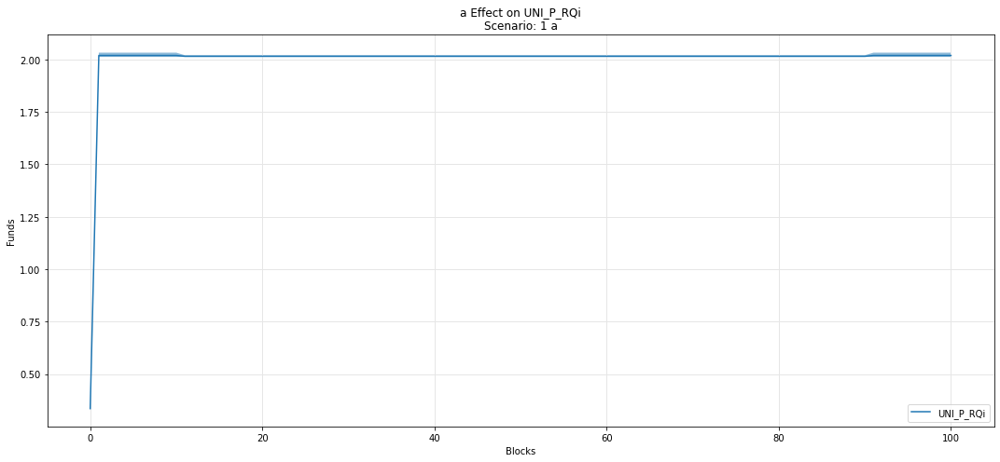

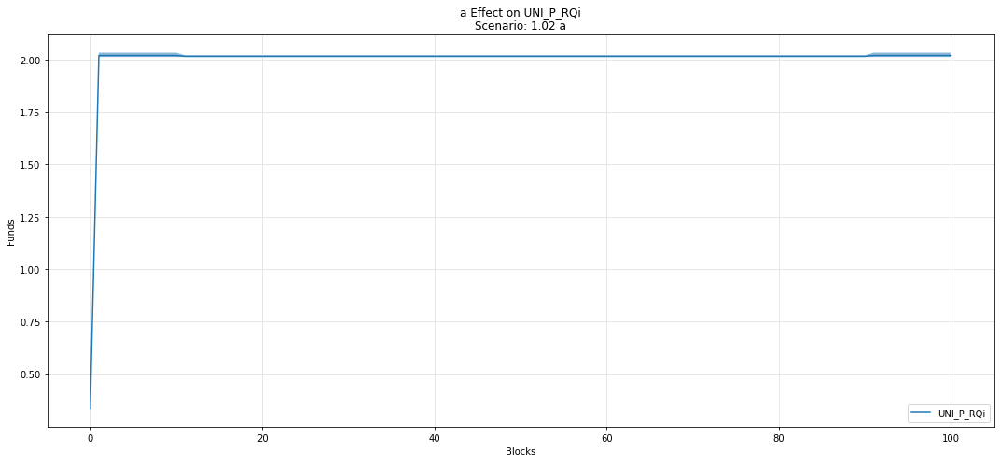

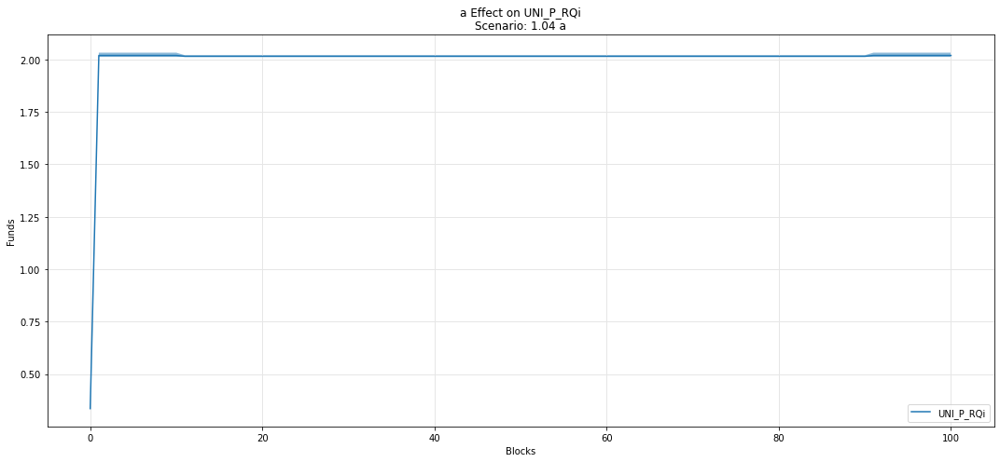

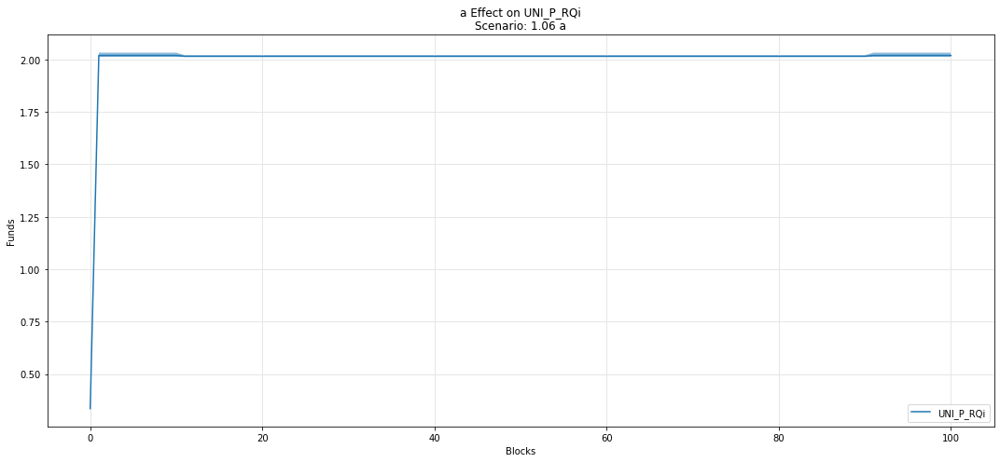

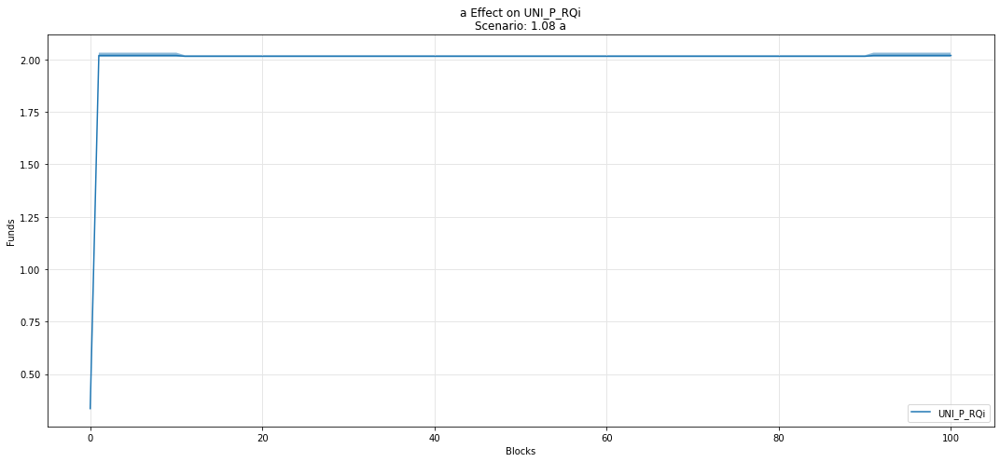

In [67]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

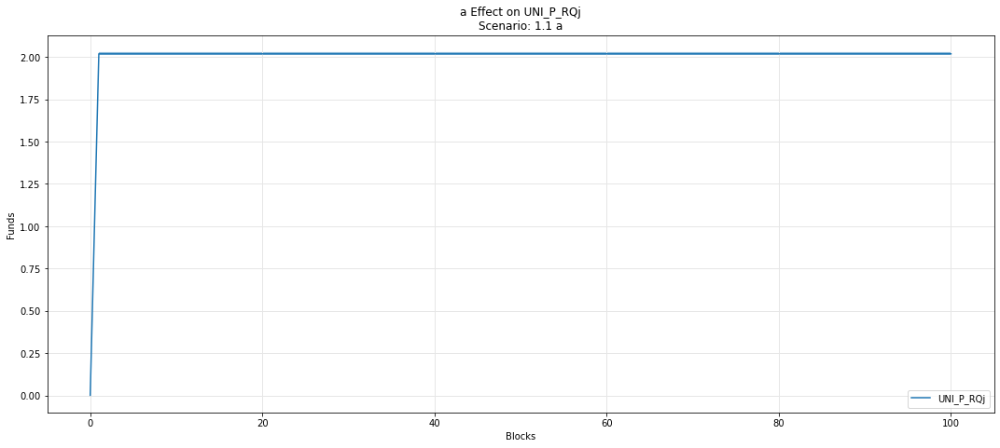

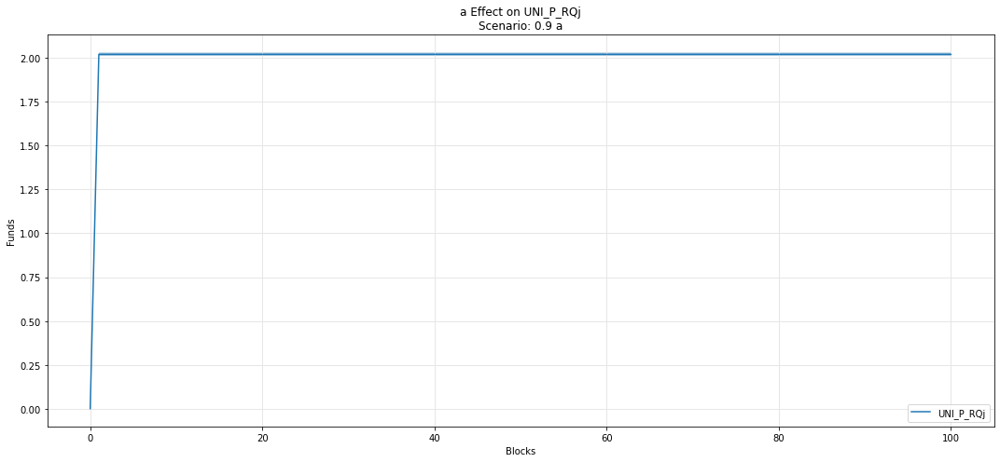

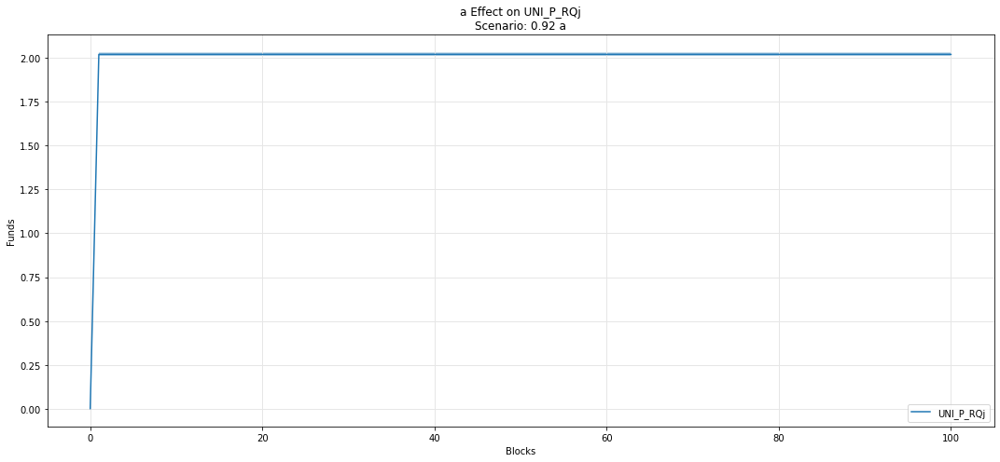

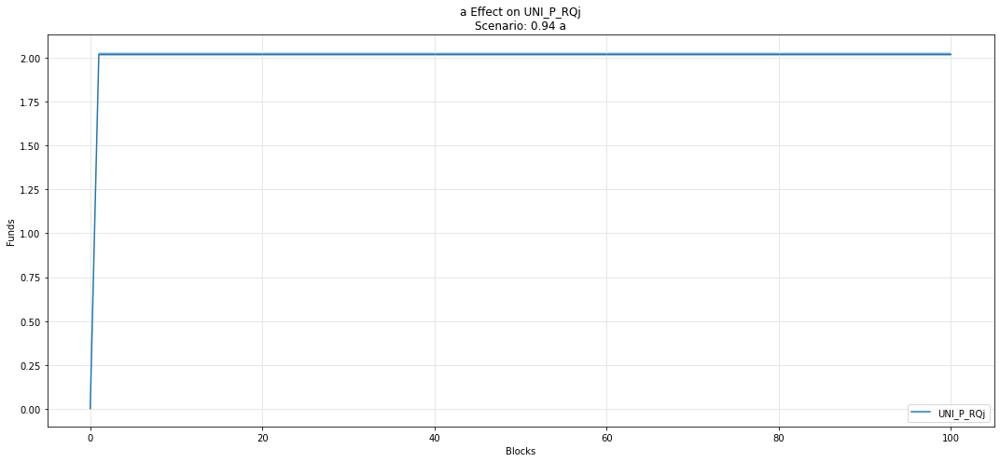

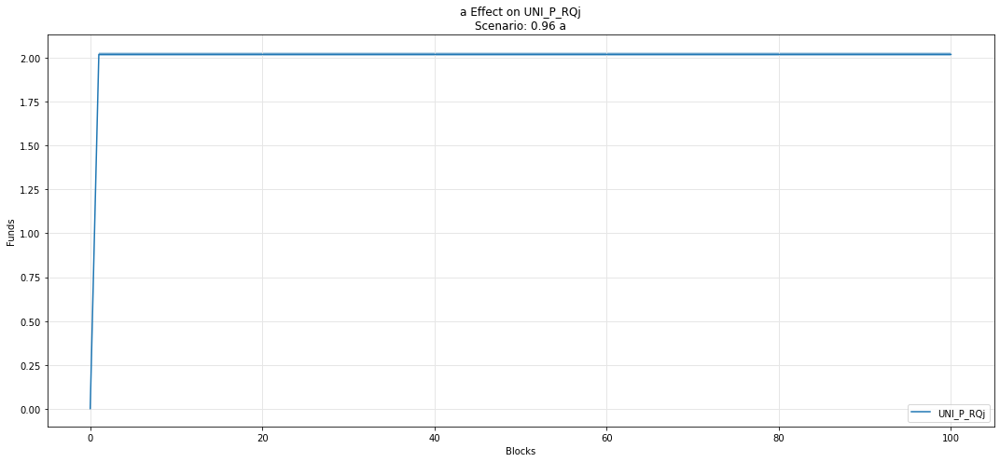

...

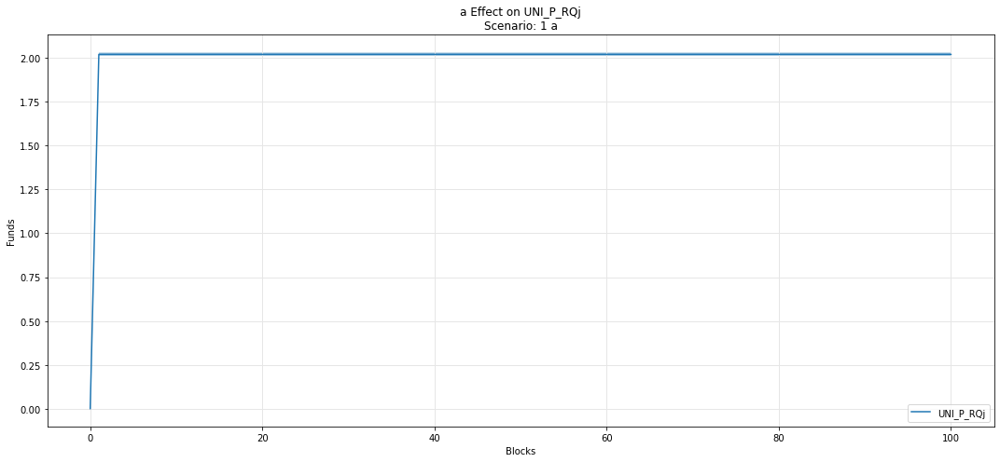

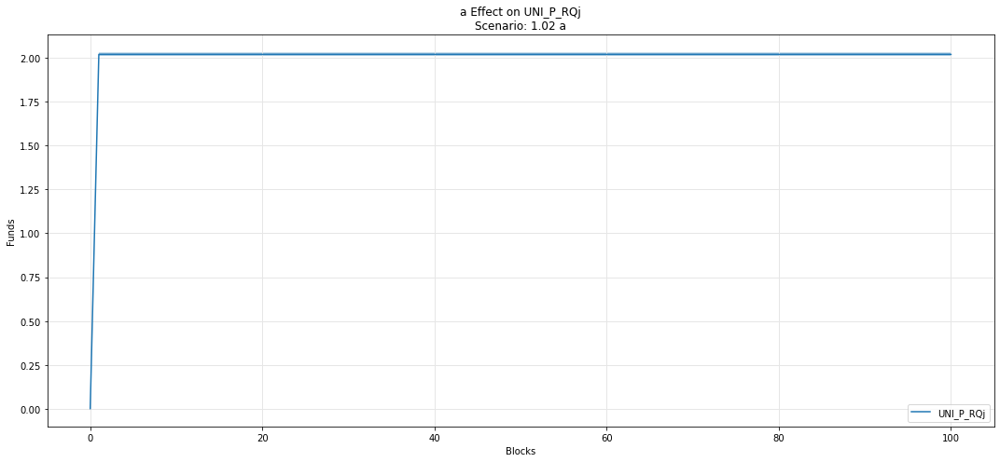

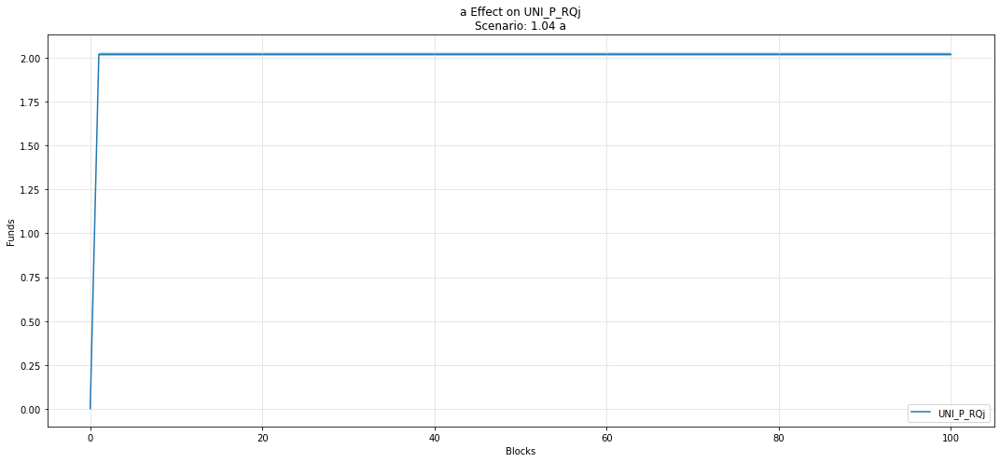

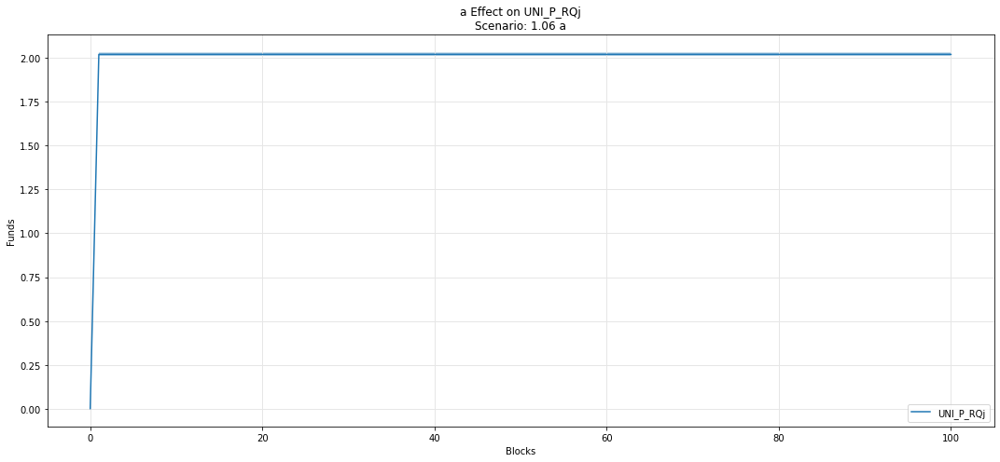

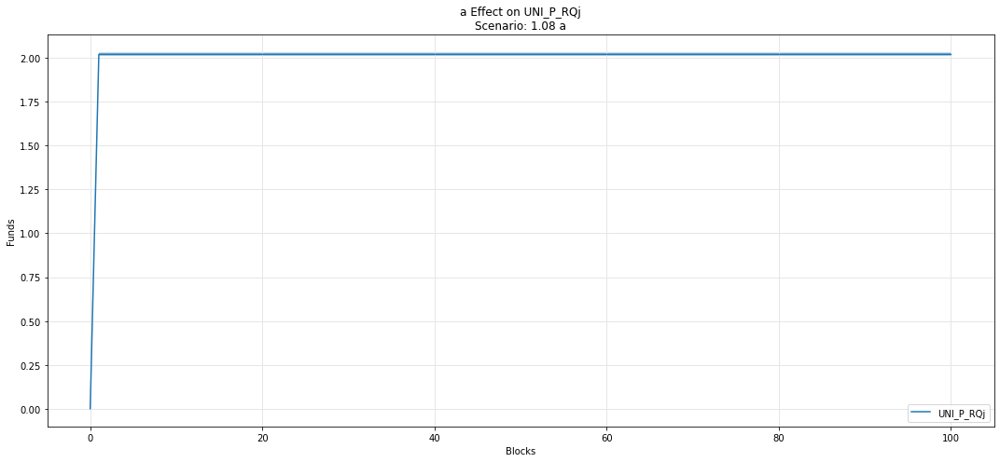

In [68]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

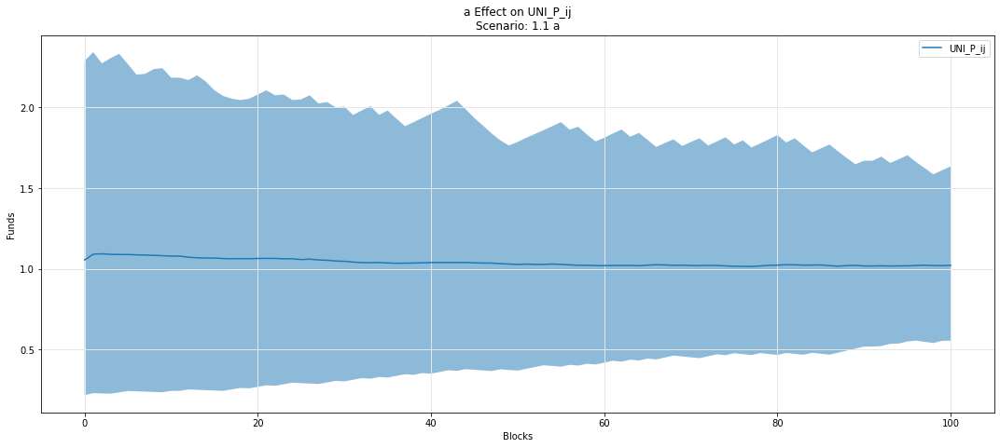

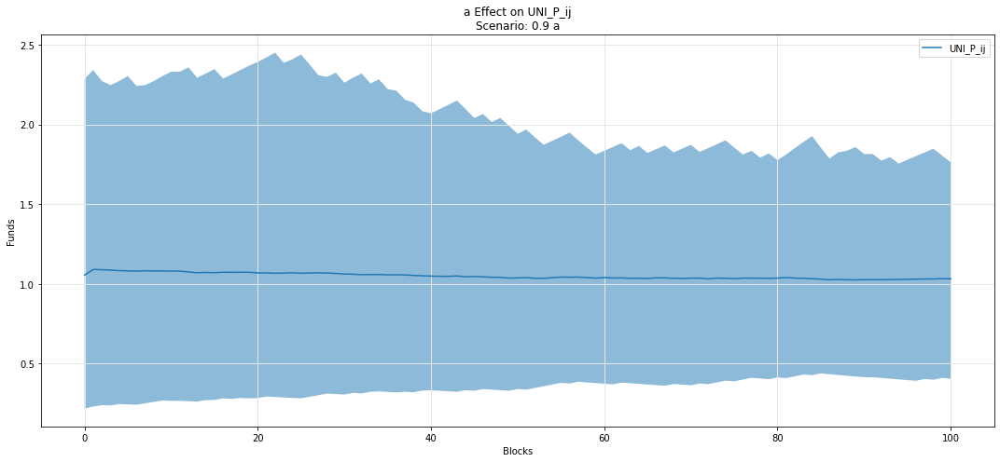

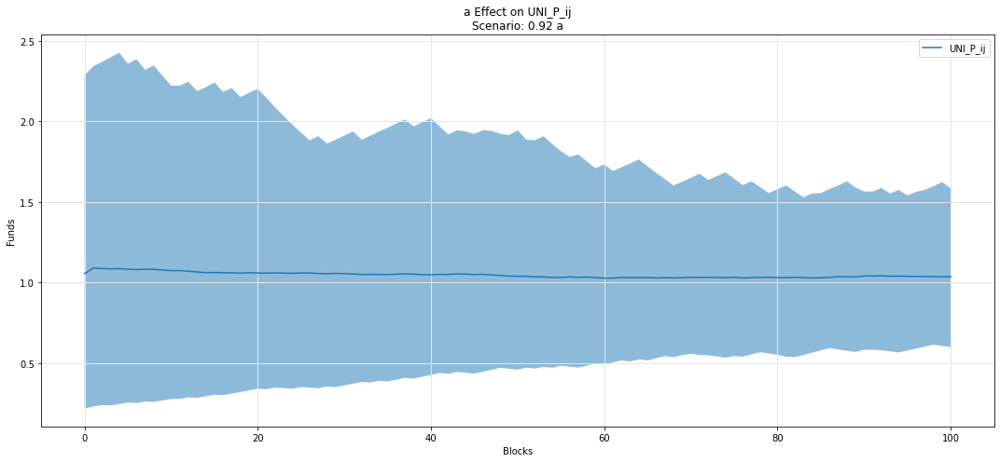

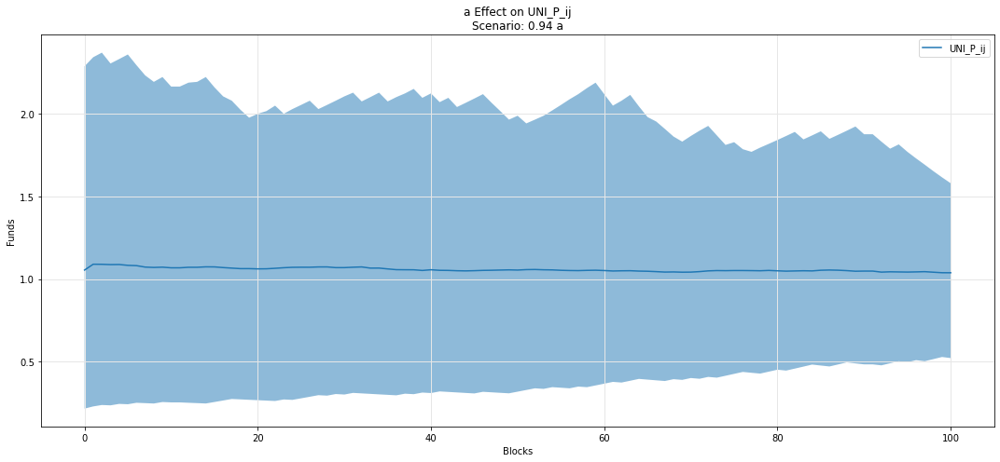

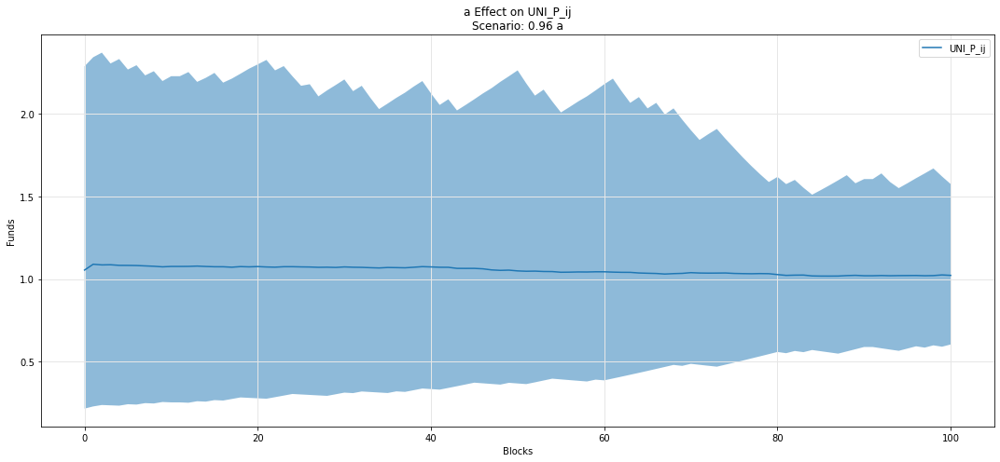

...

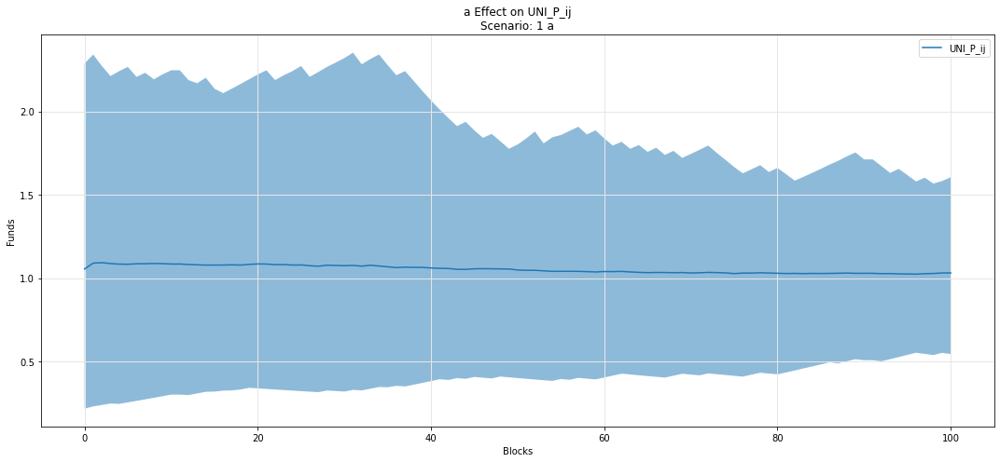

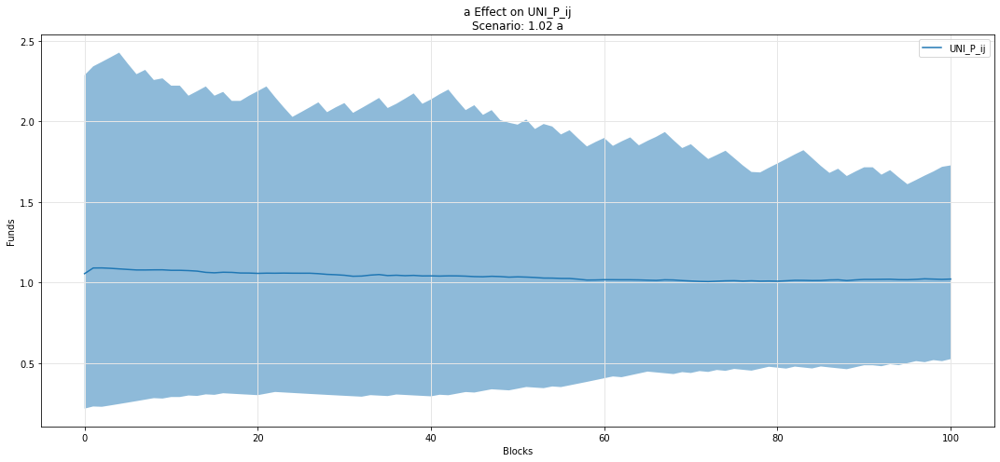

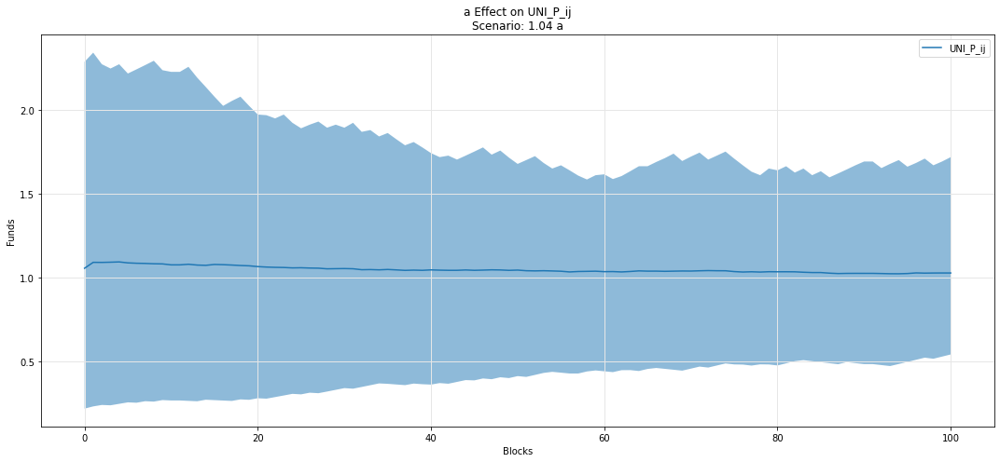

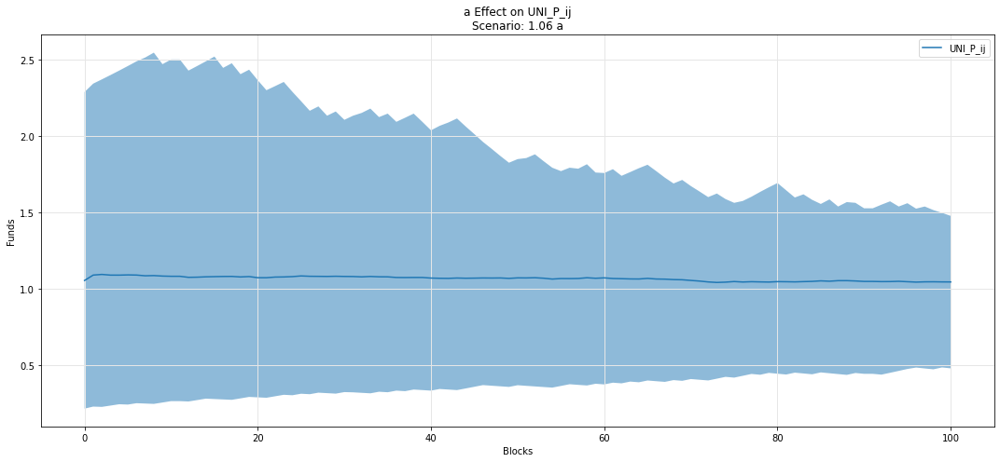

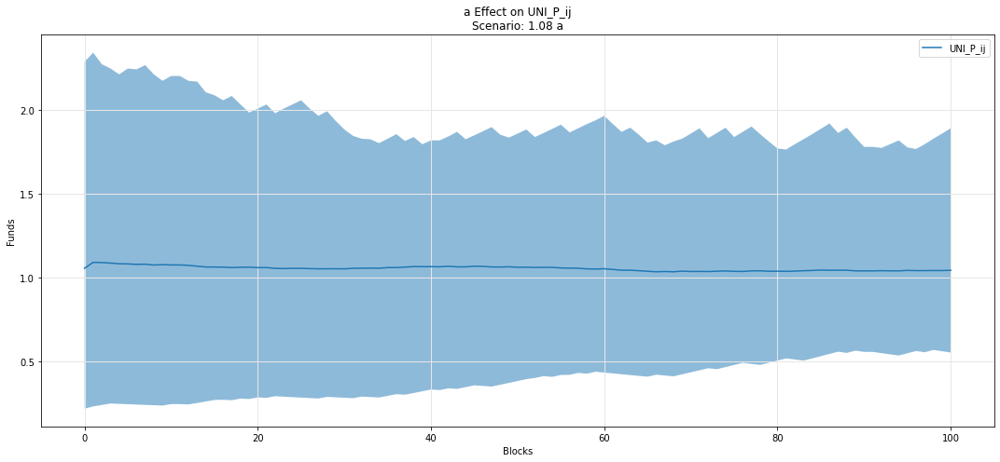

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

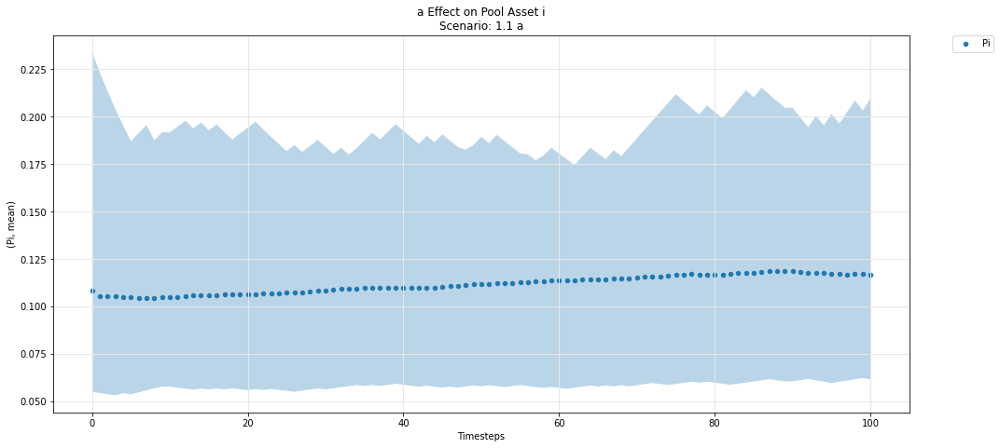

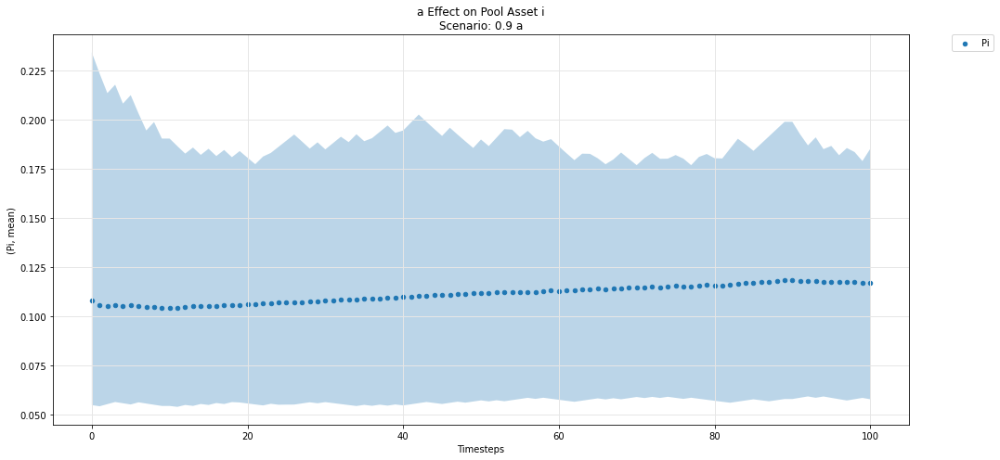

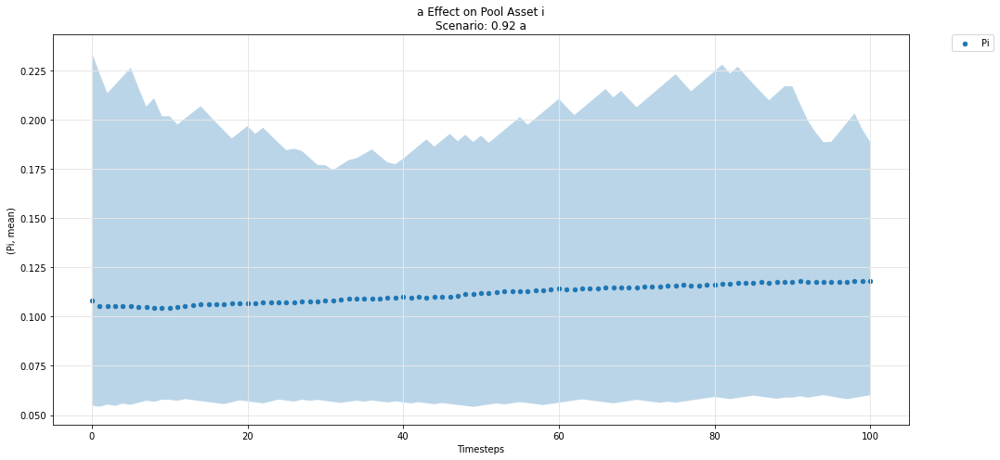

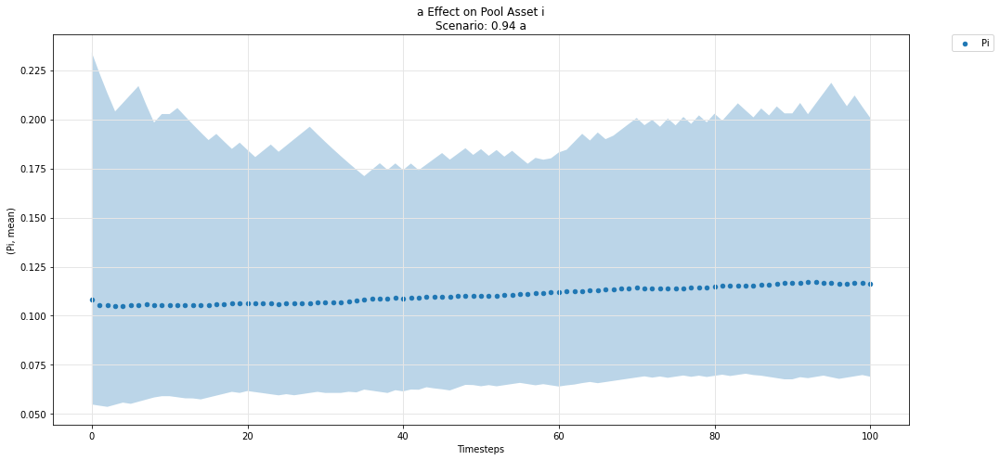

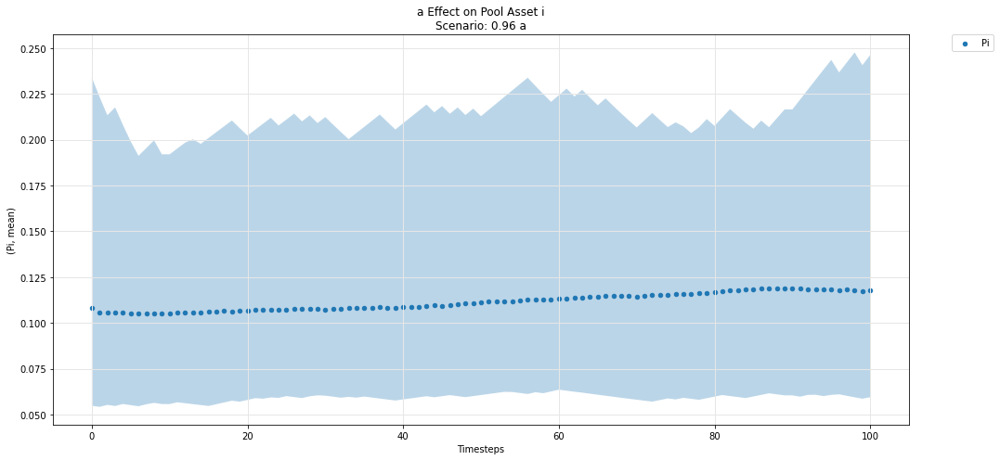

...

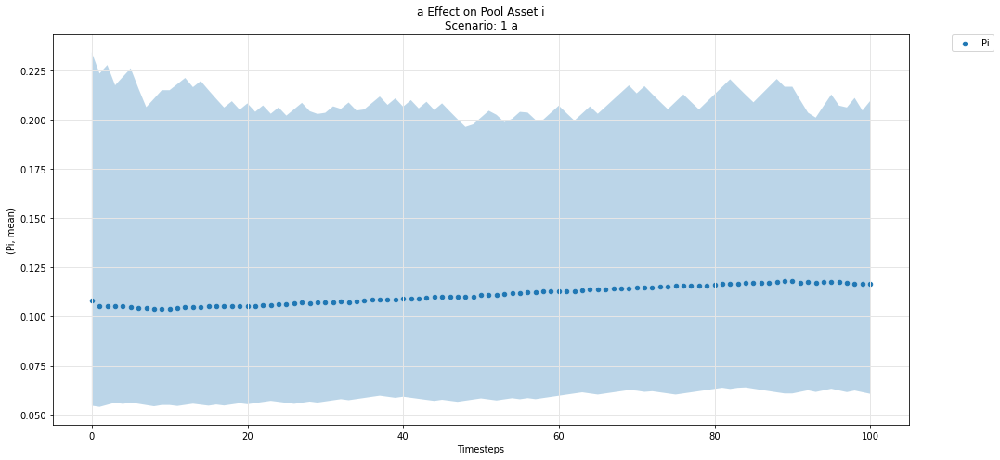

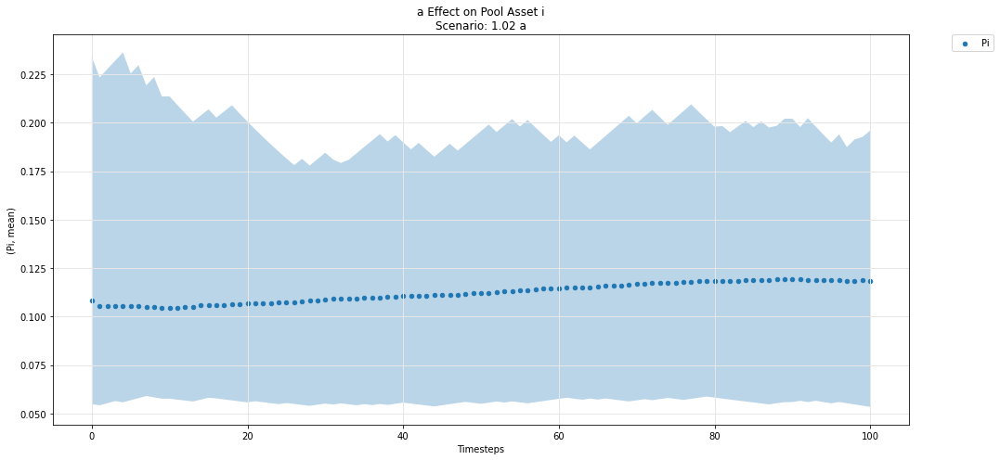

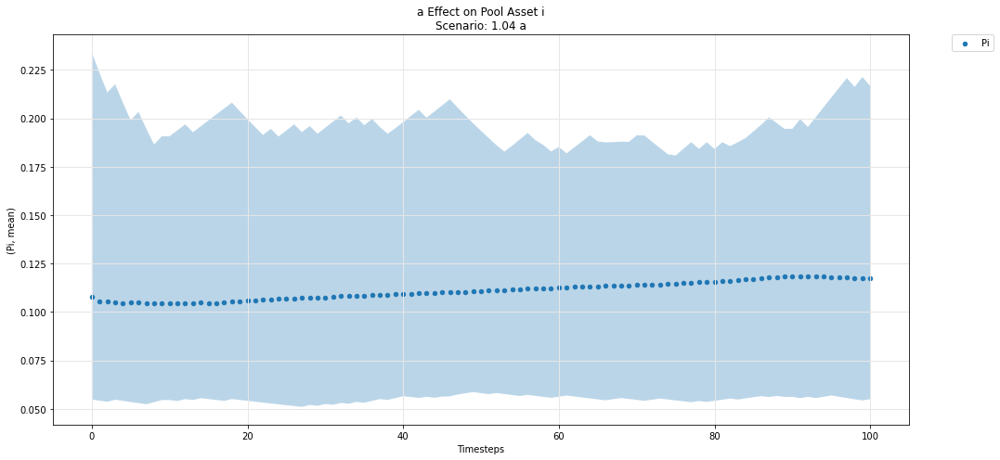

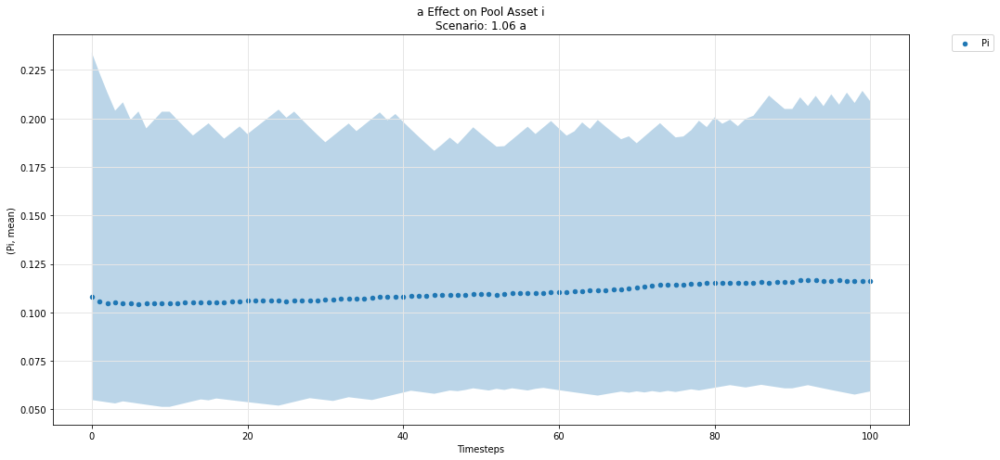

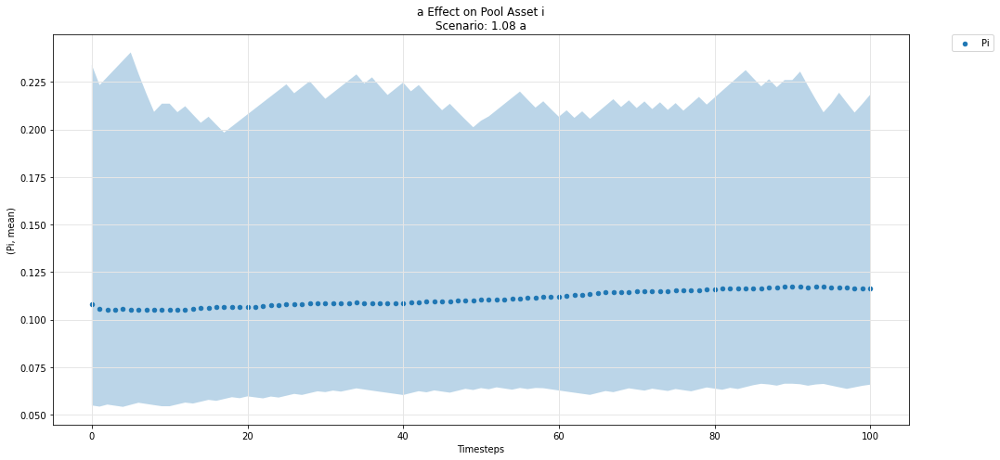

In [70]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

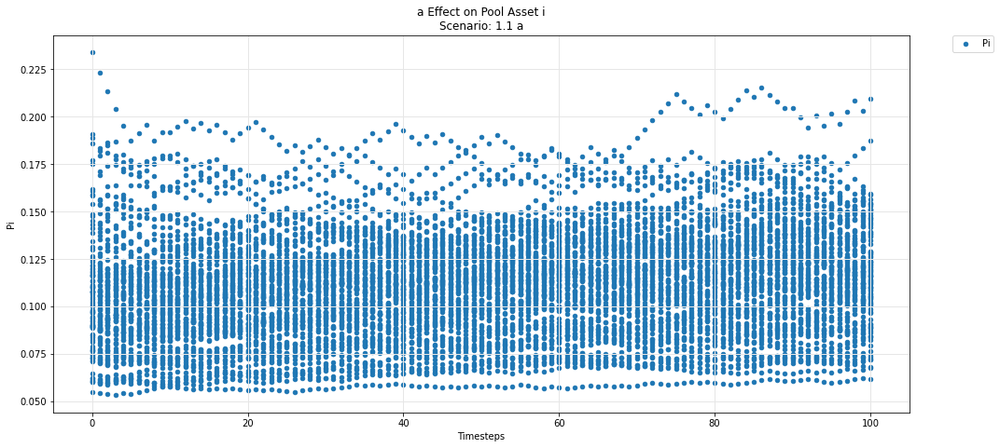

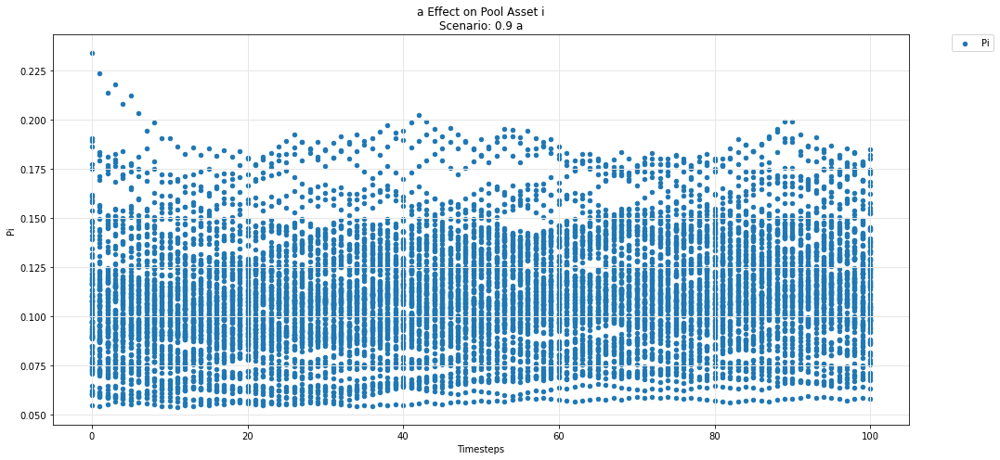

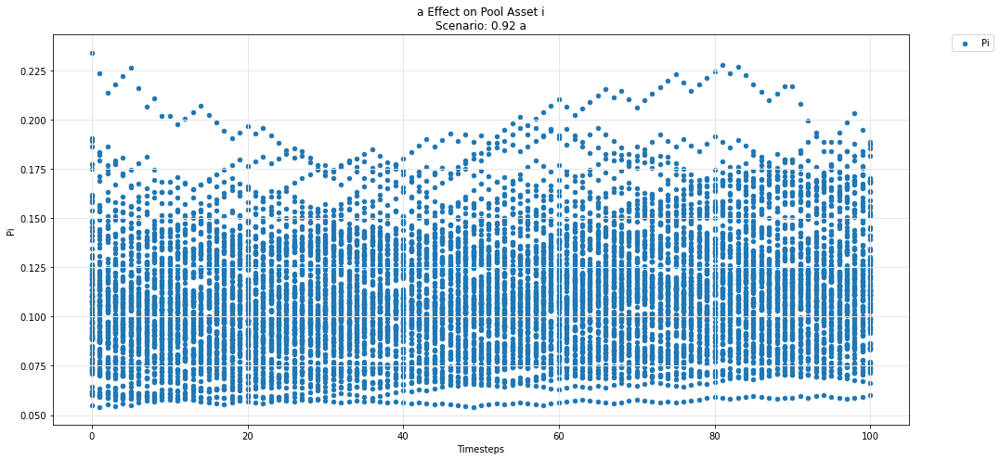

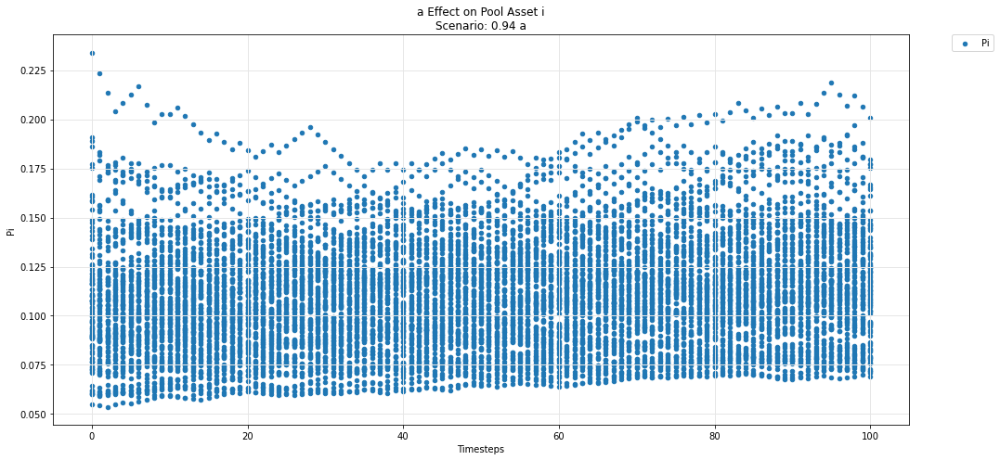

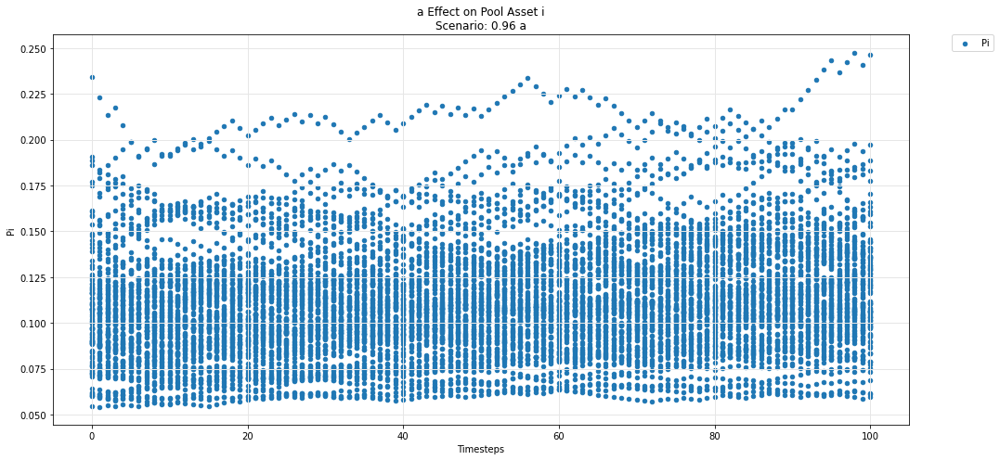

...

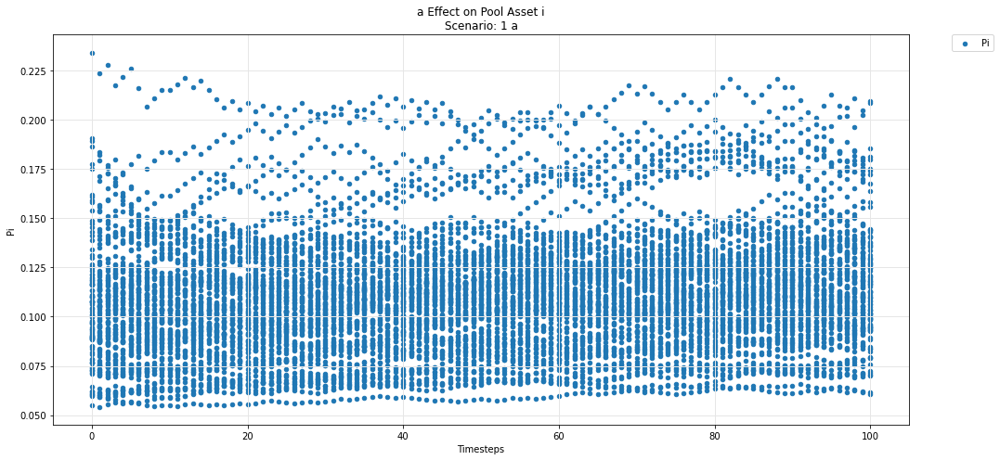

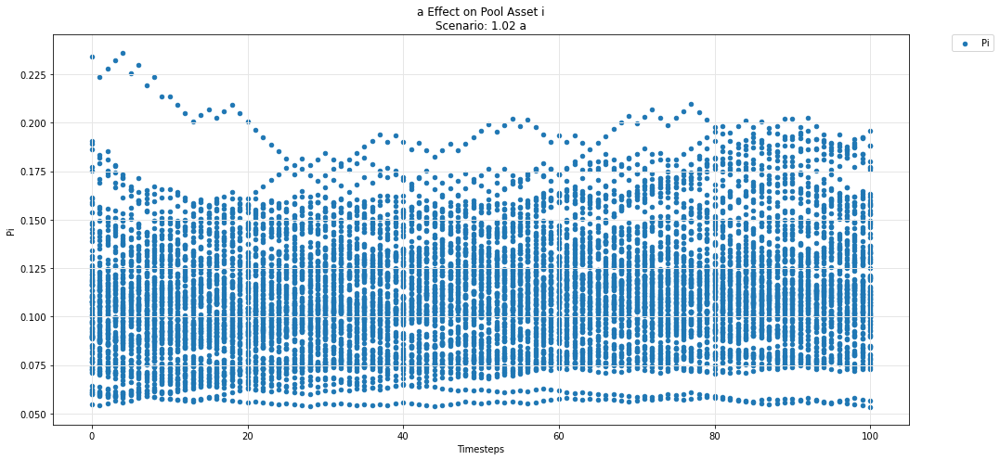

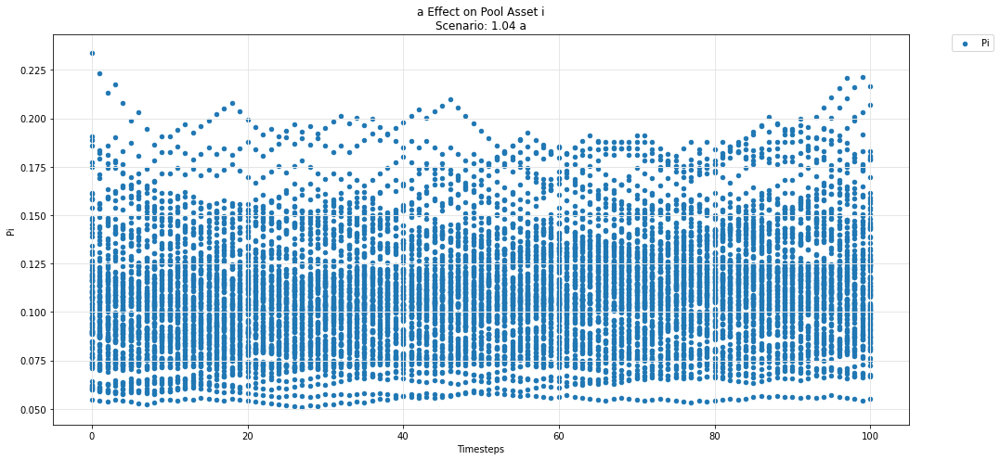

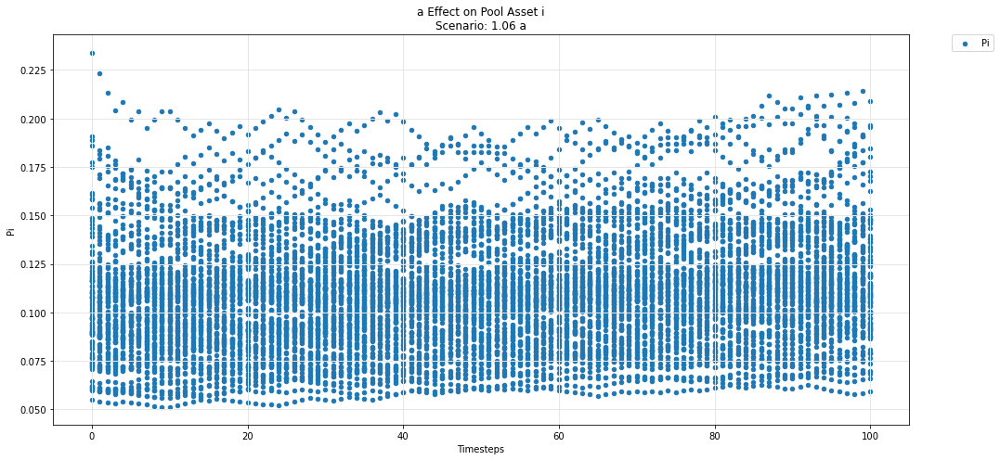

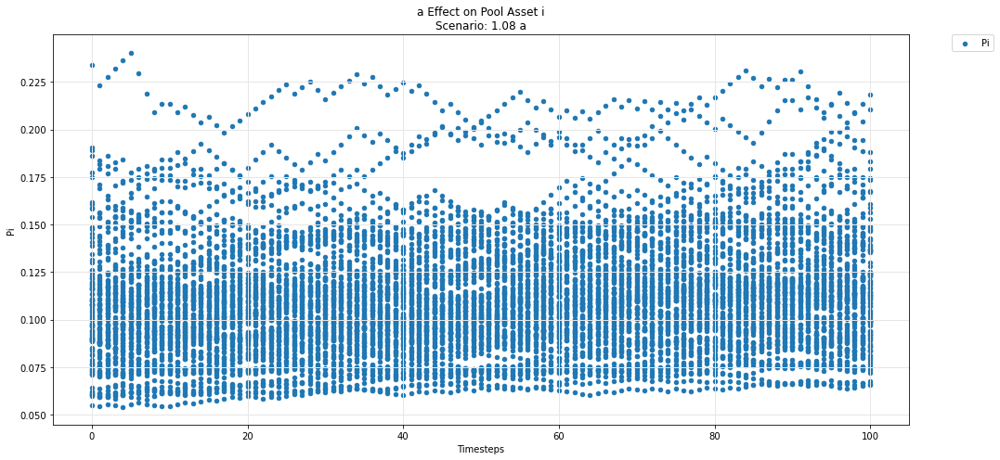

In [71]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

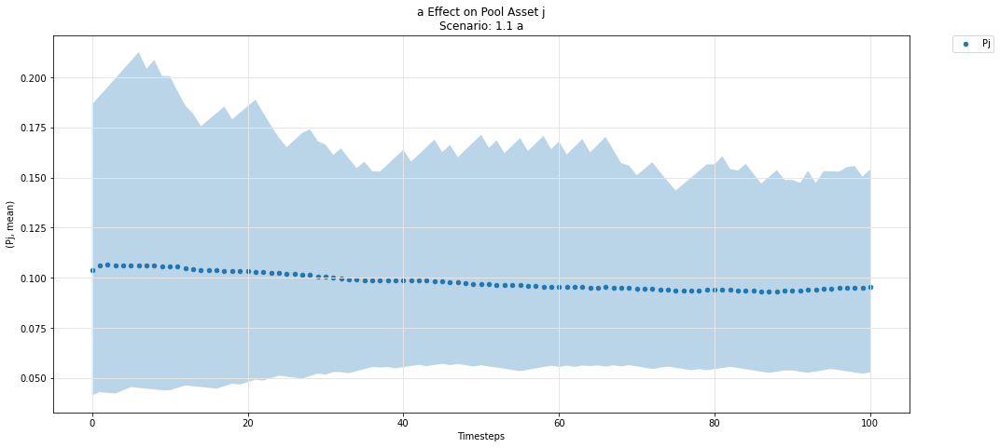

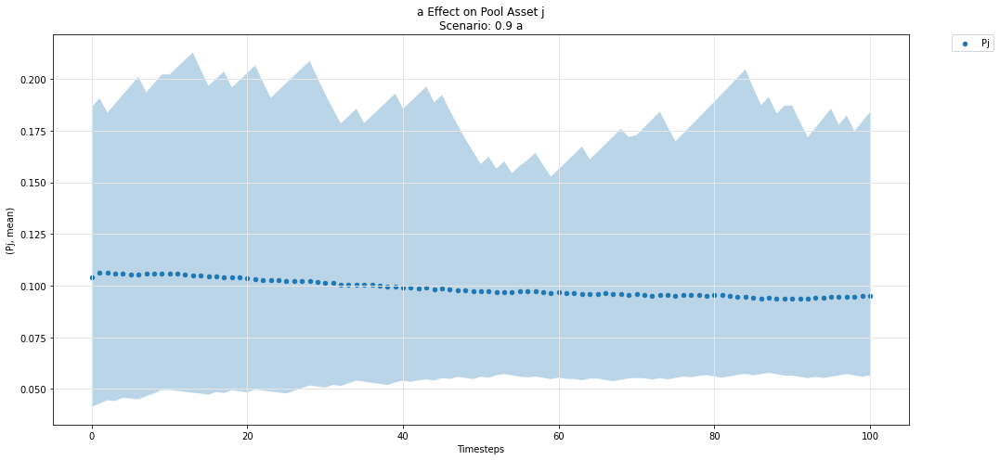

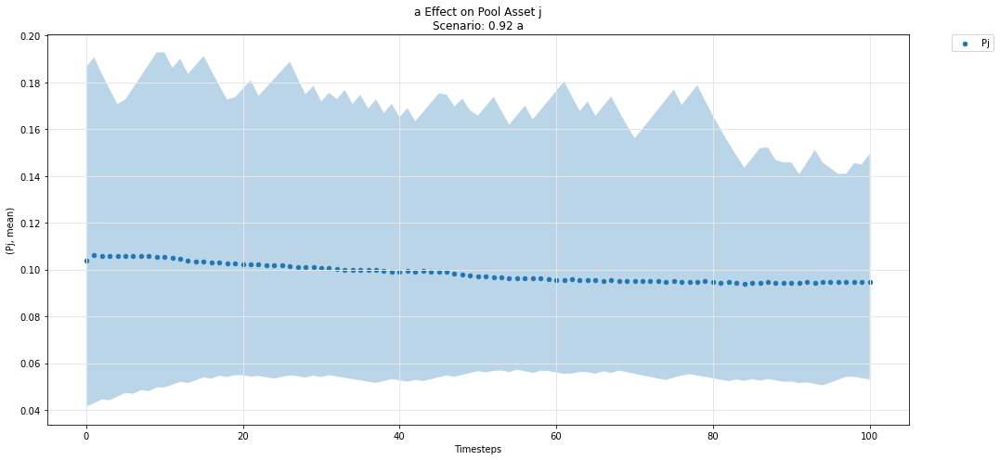

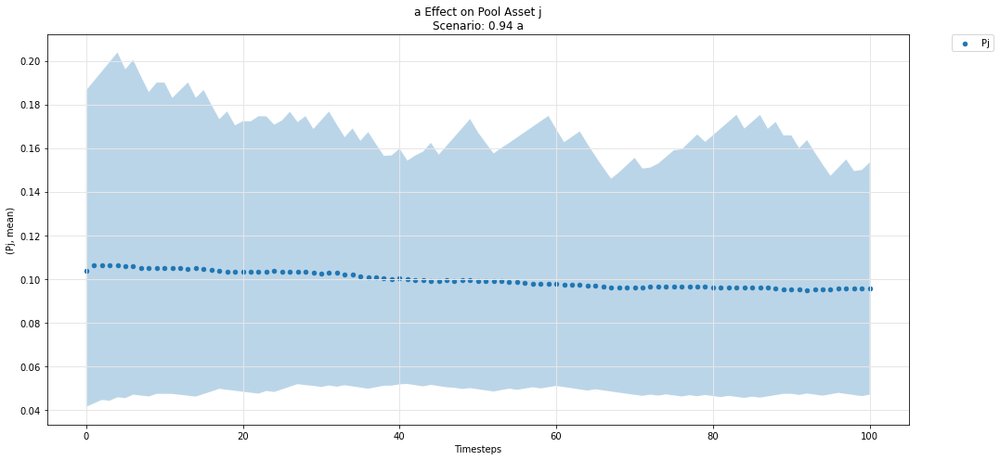

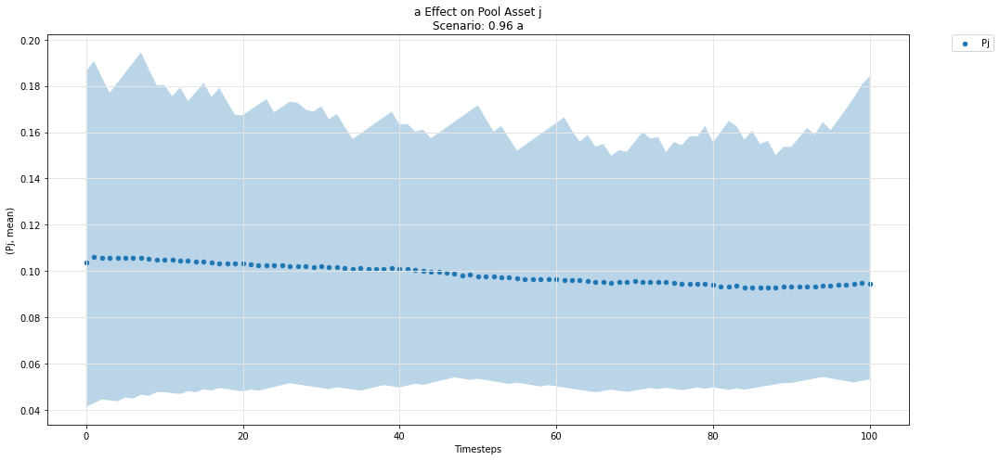

...

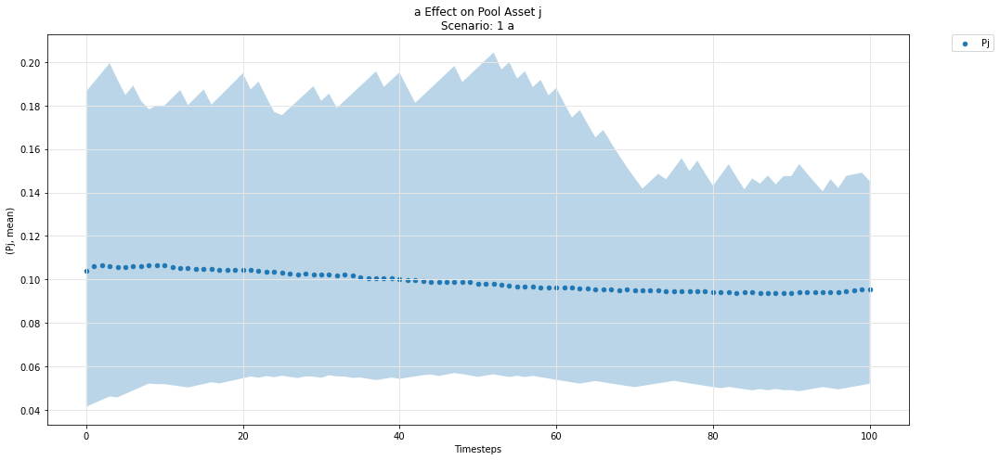

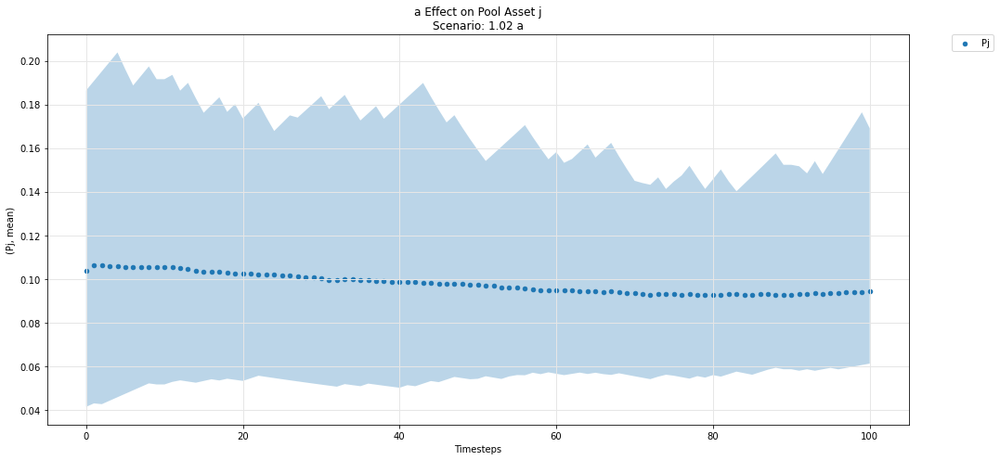

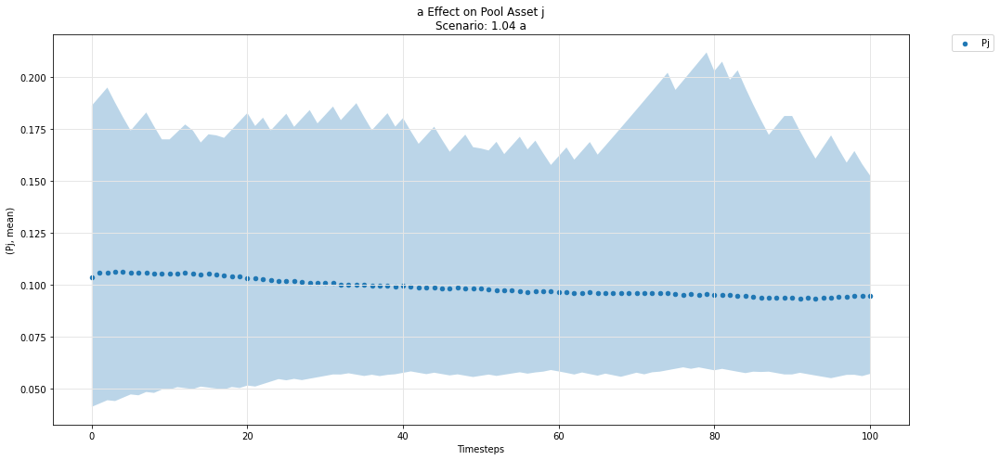

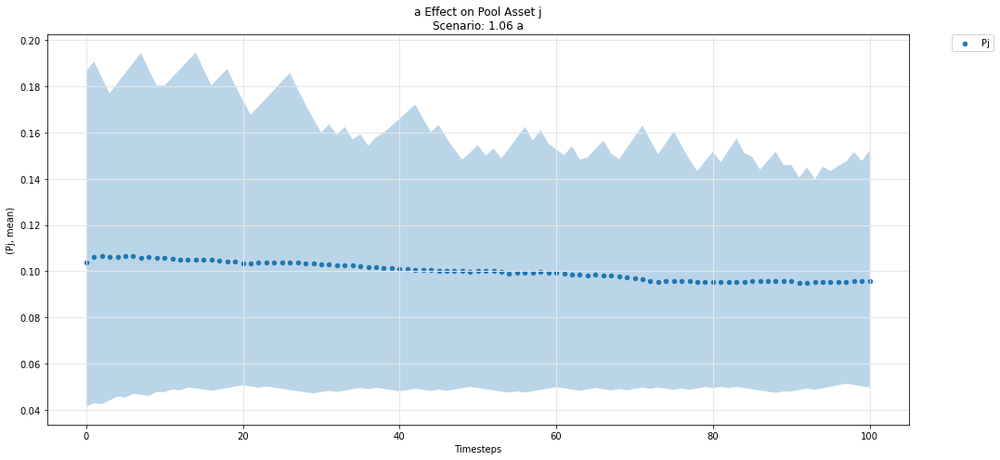

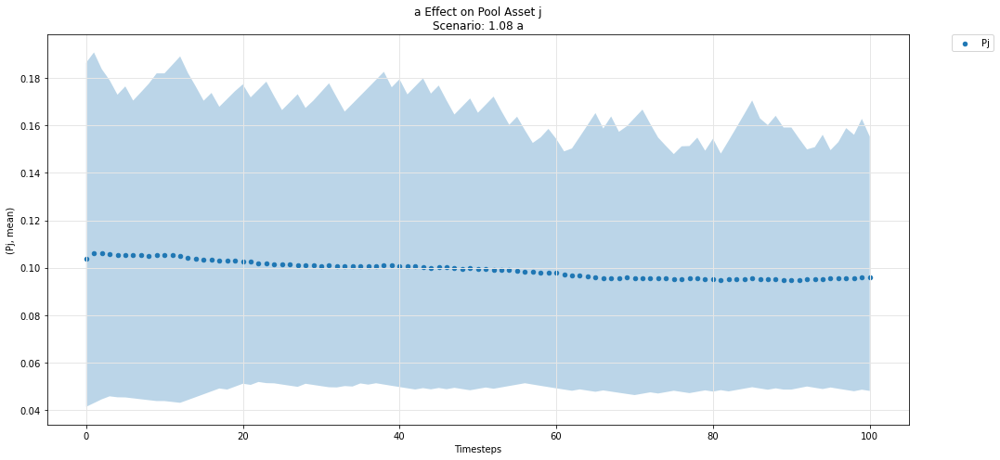

In [72]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

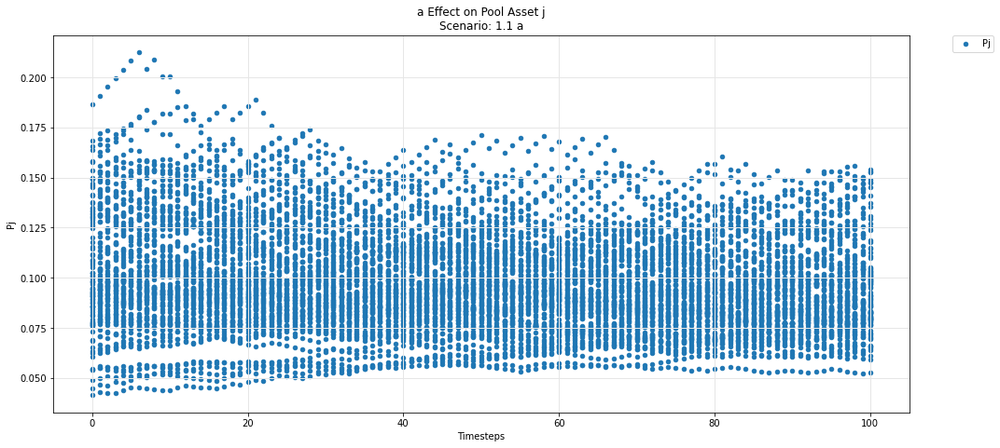

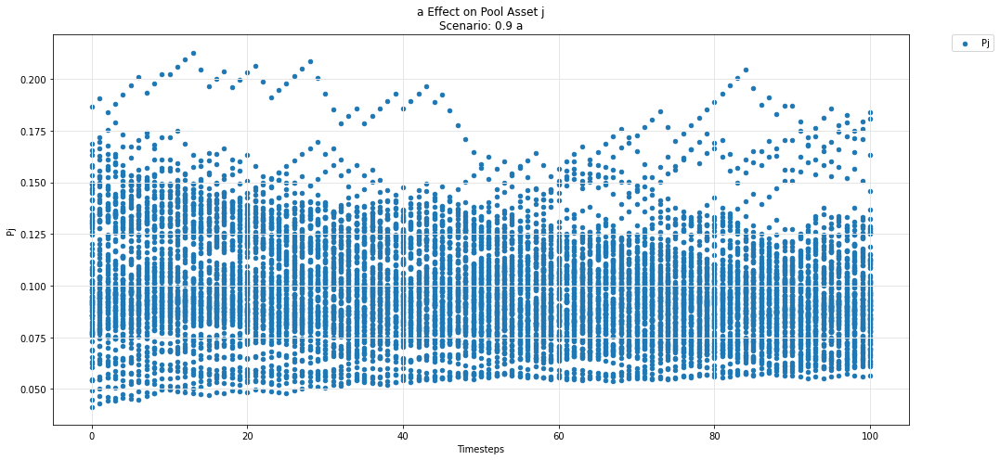

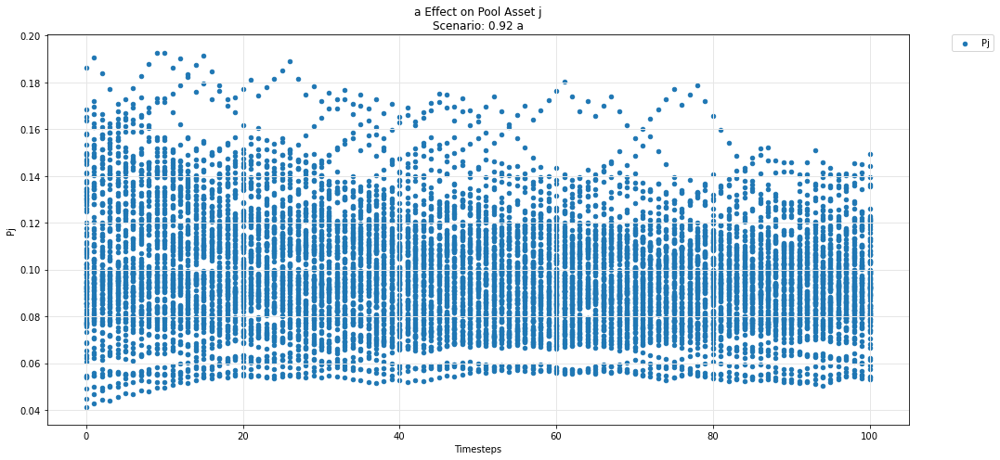

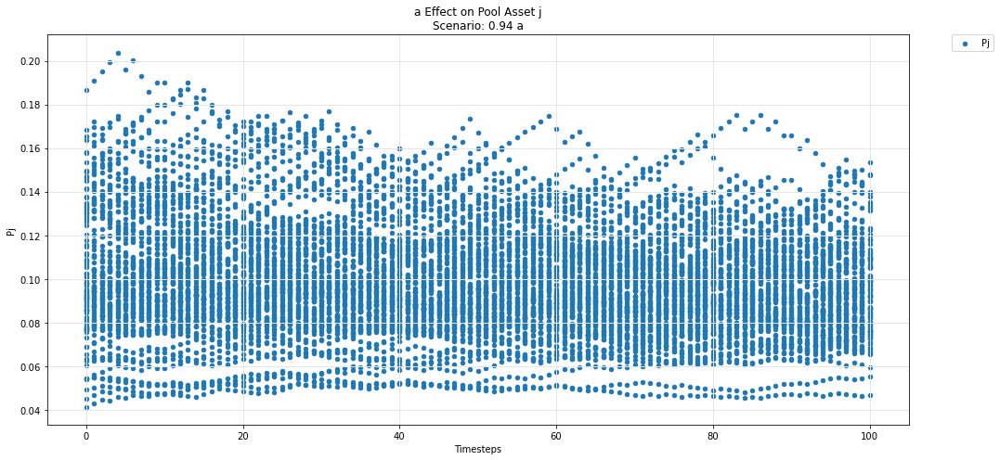

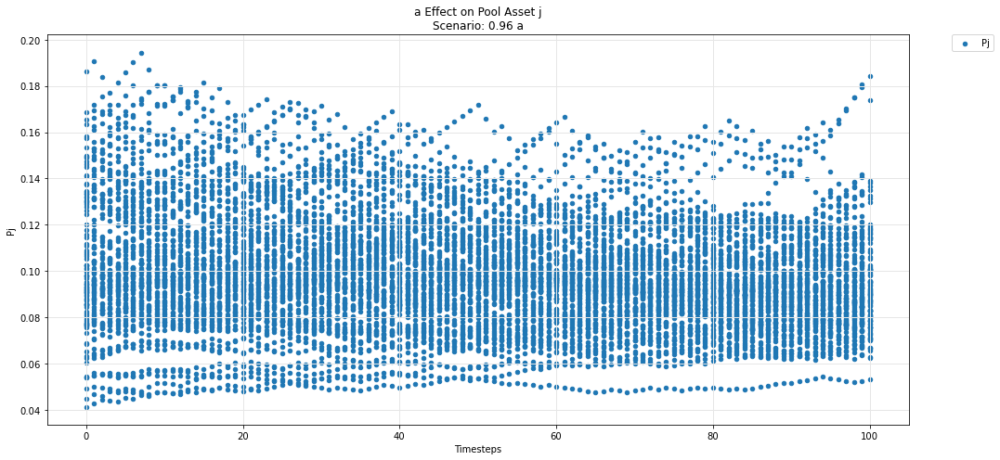

...

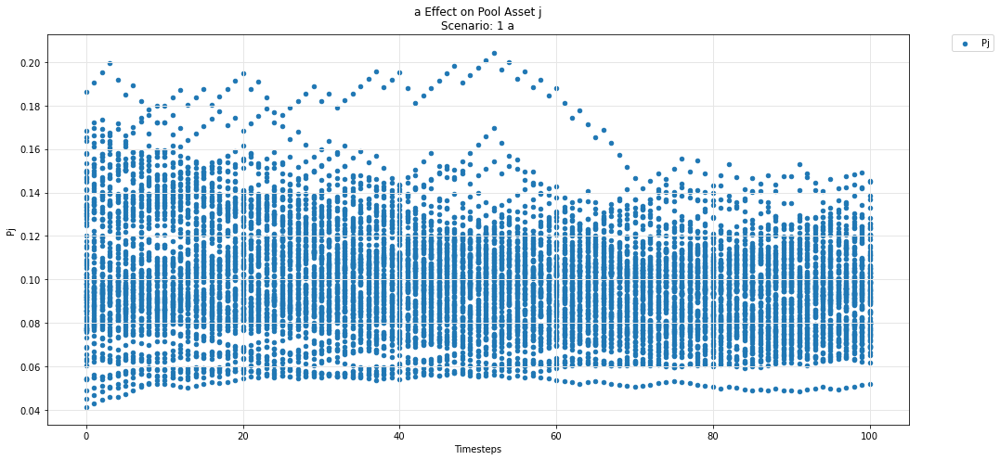

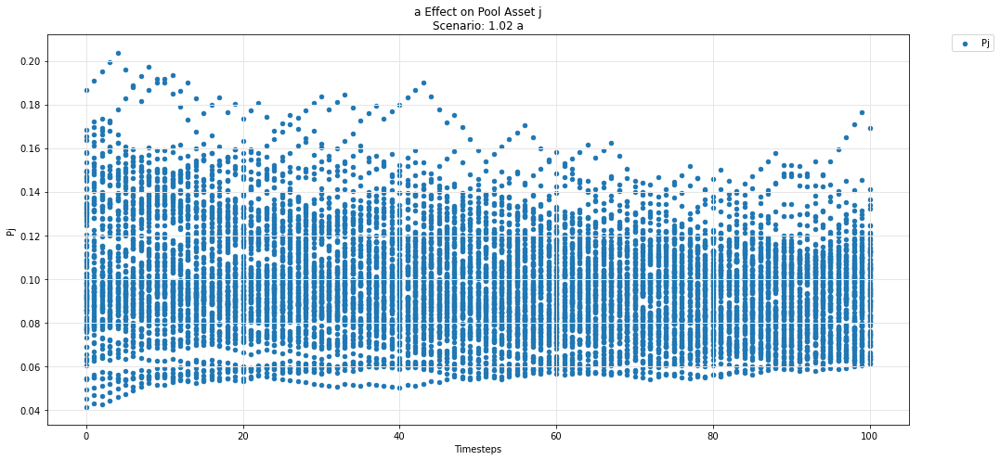

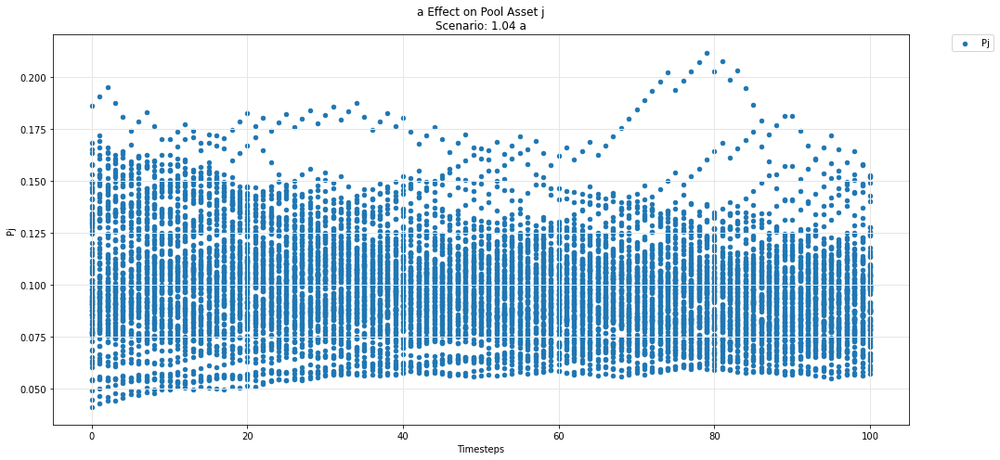

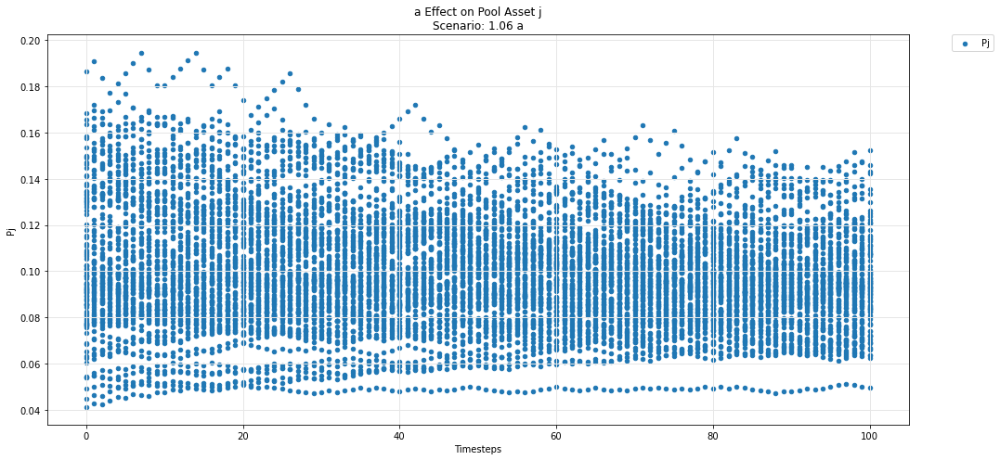

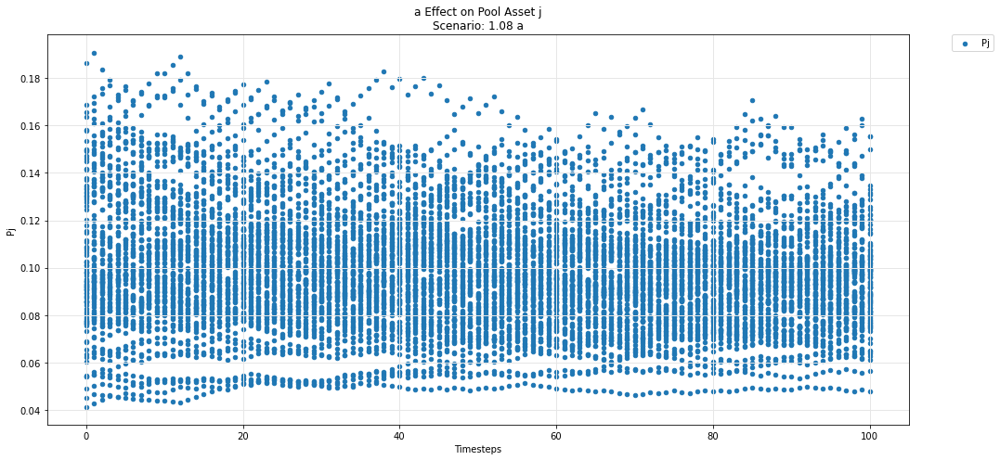

In [73]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

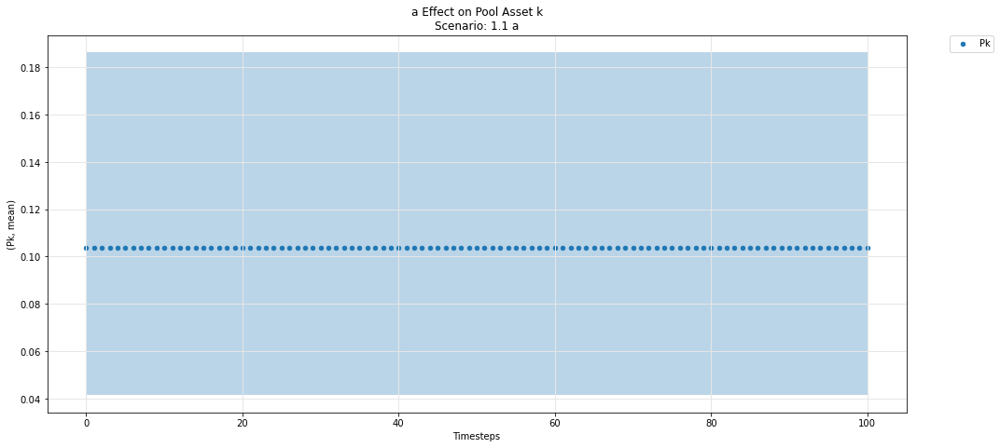

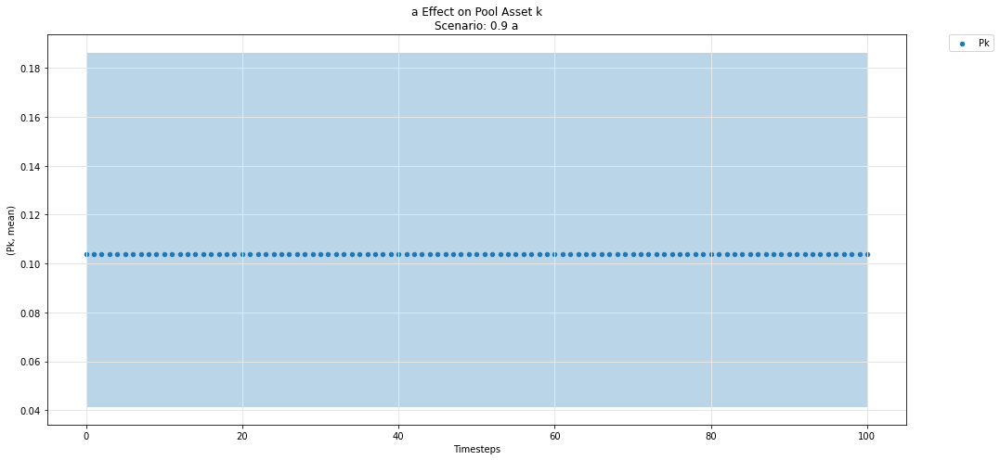

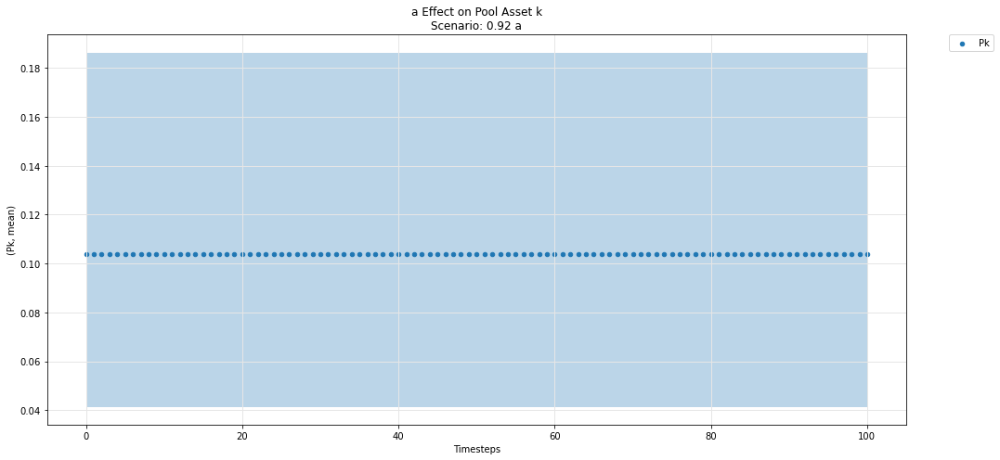

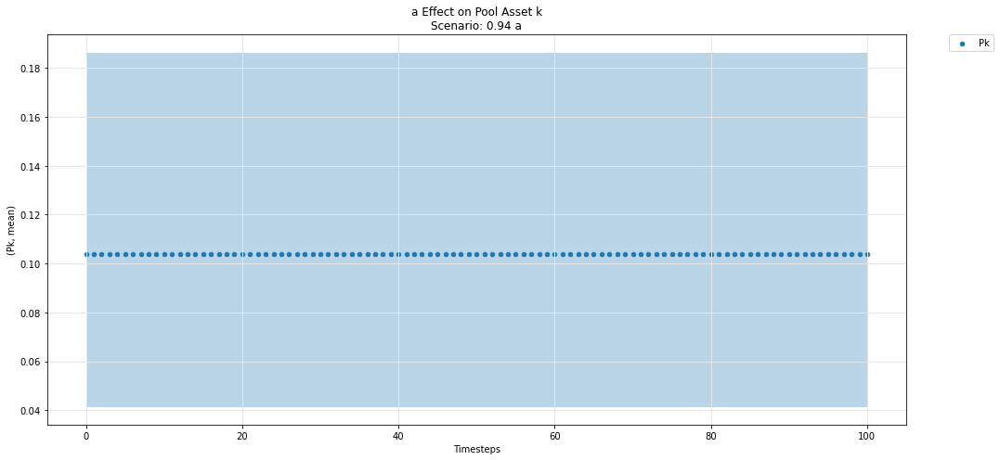

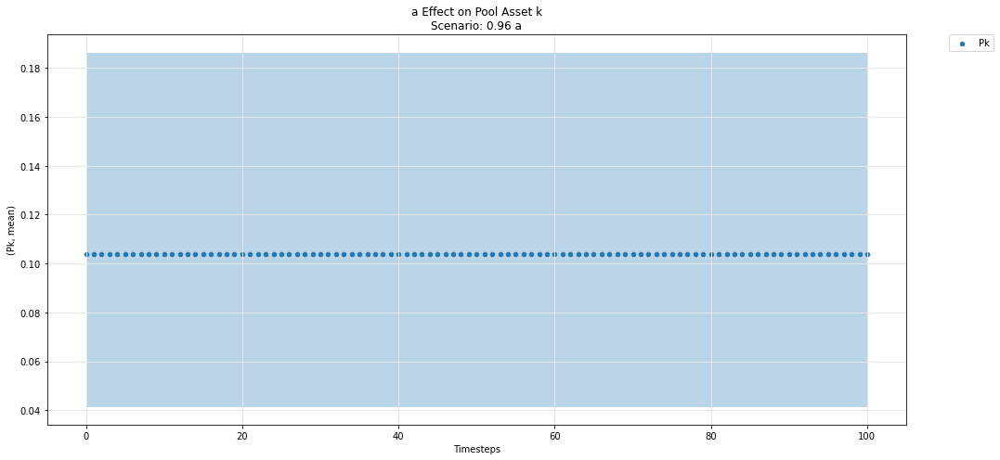

...

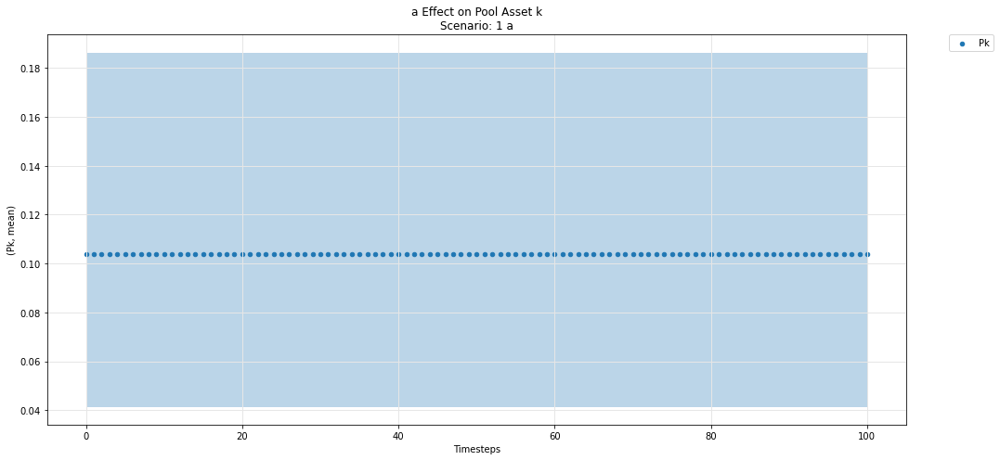

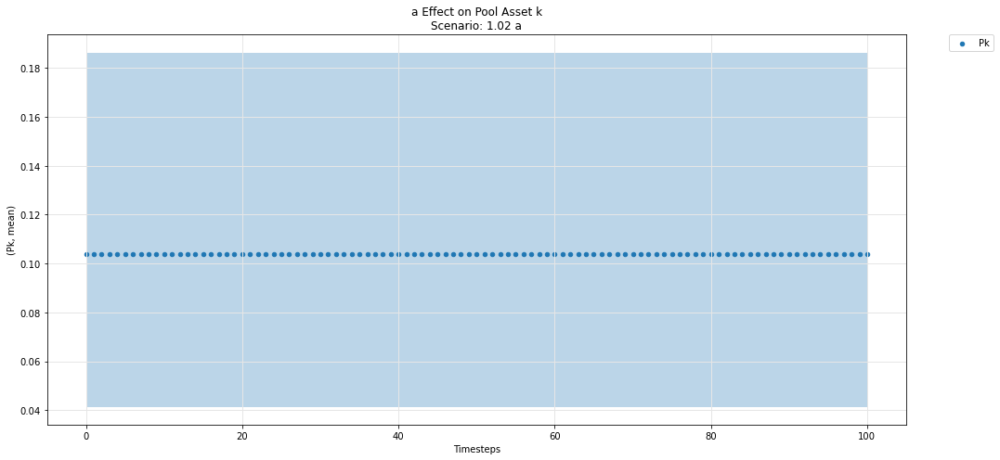

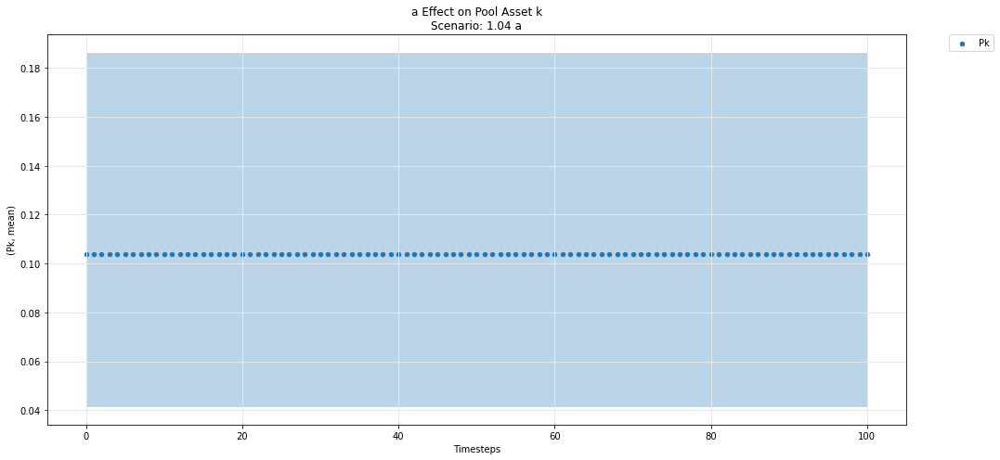

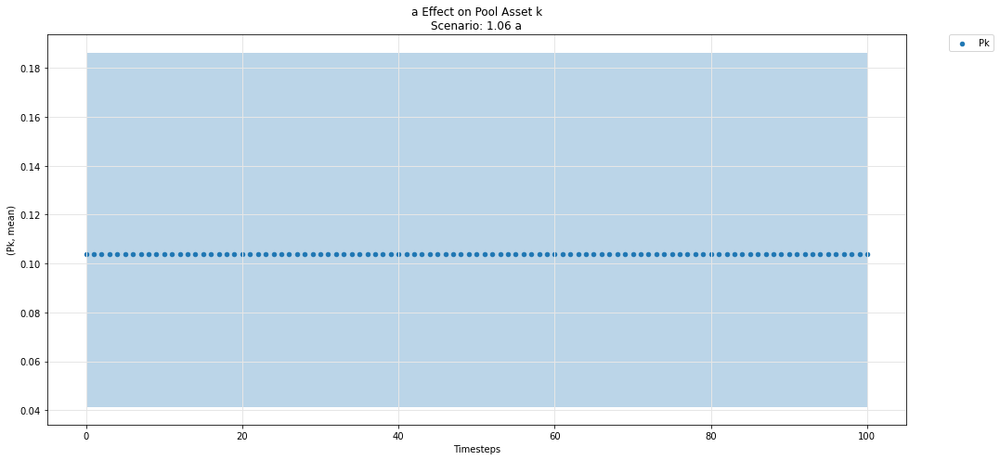

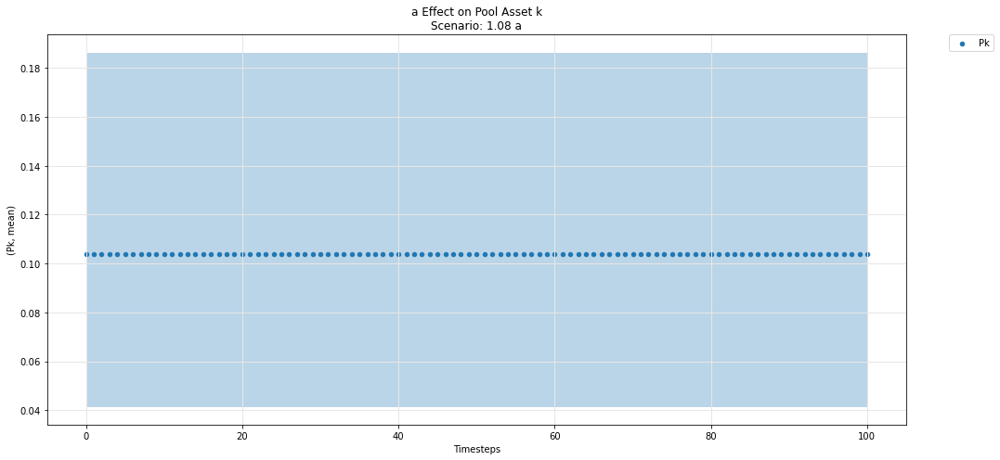

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

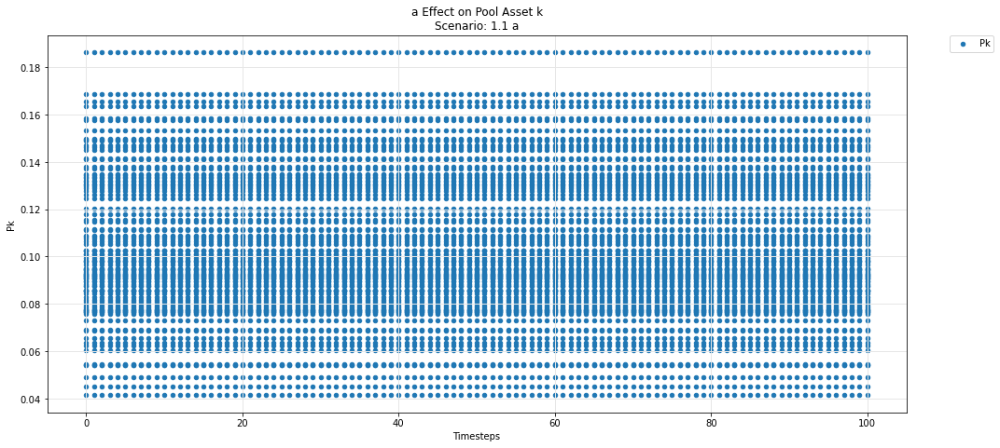

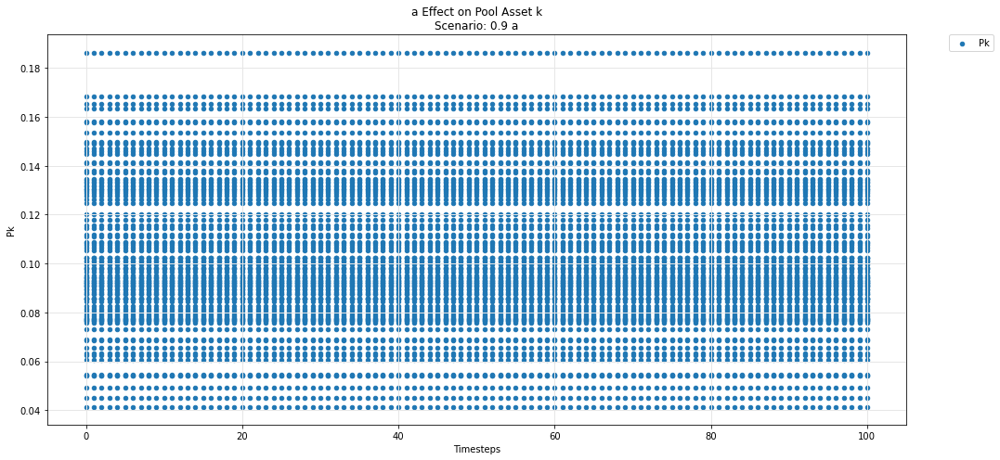

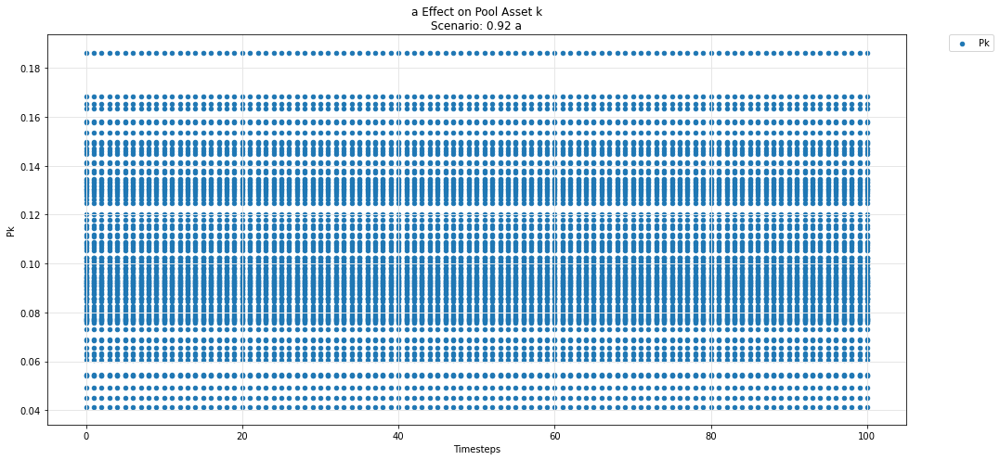

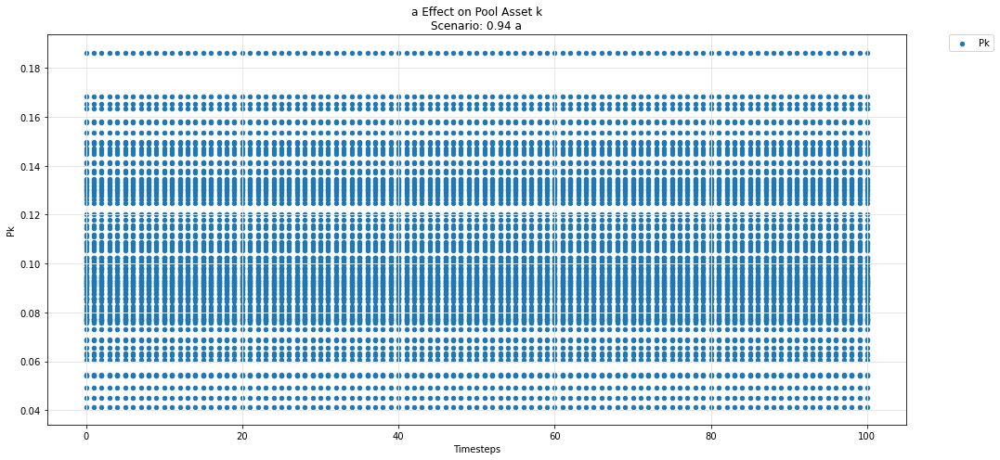

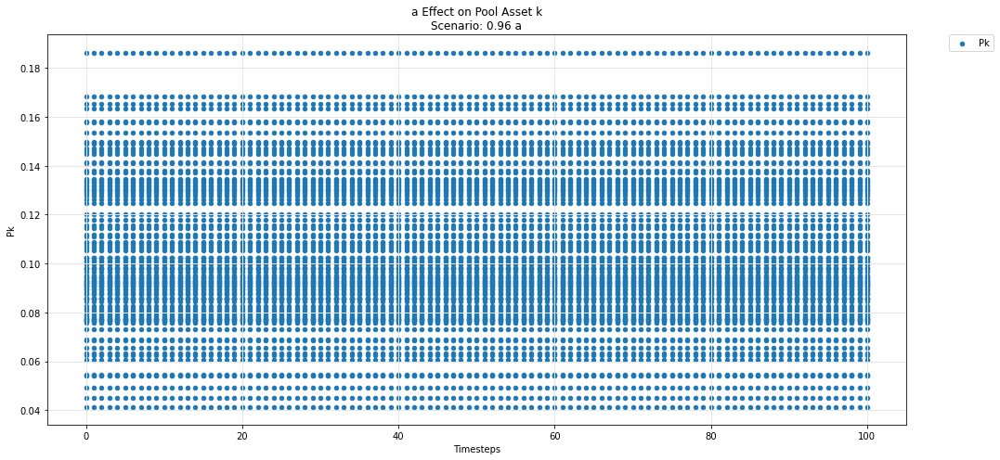

...

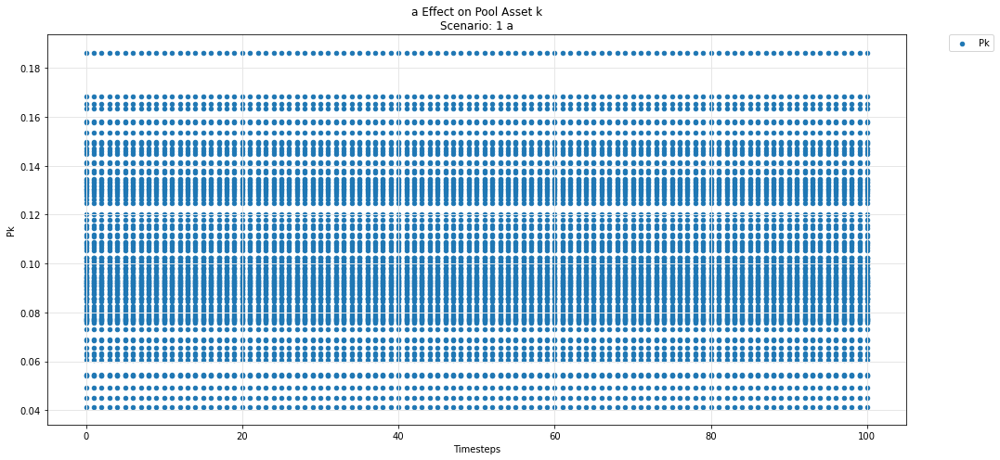

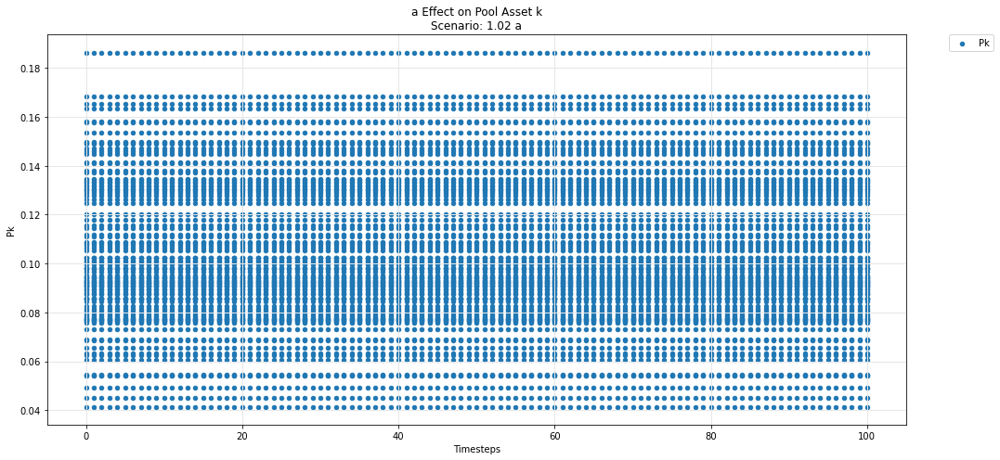

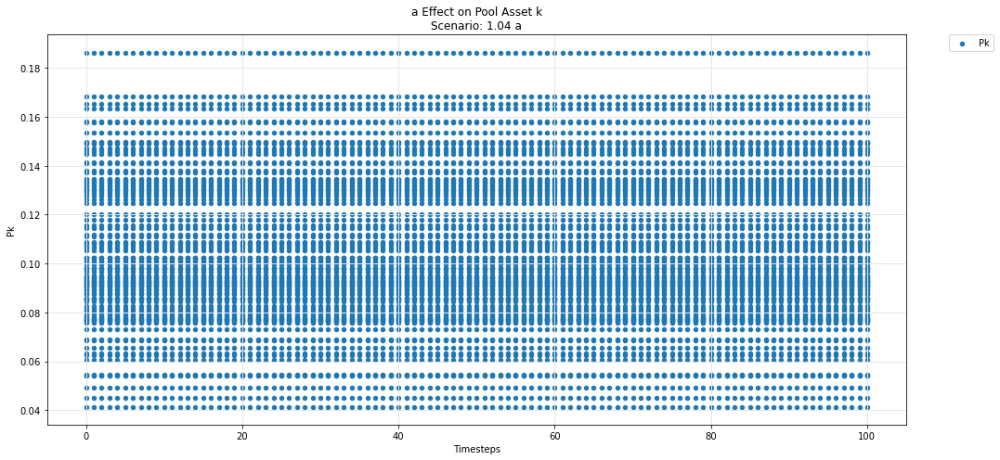

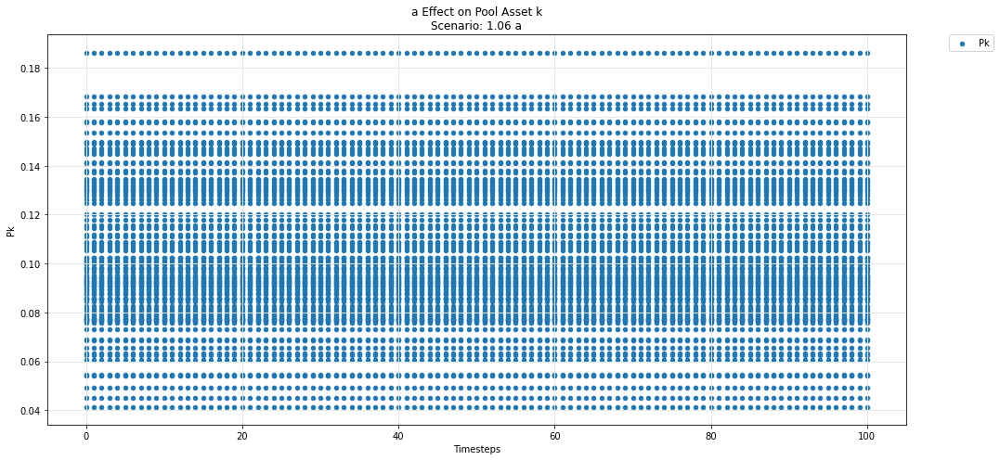

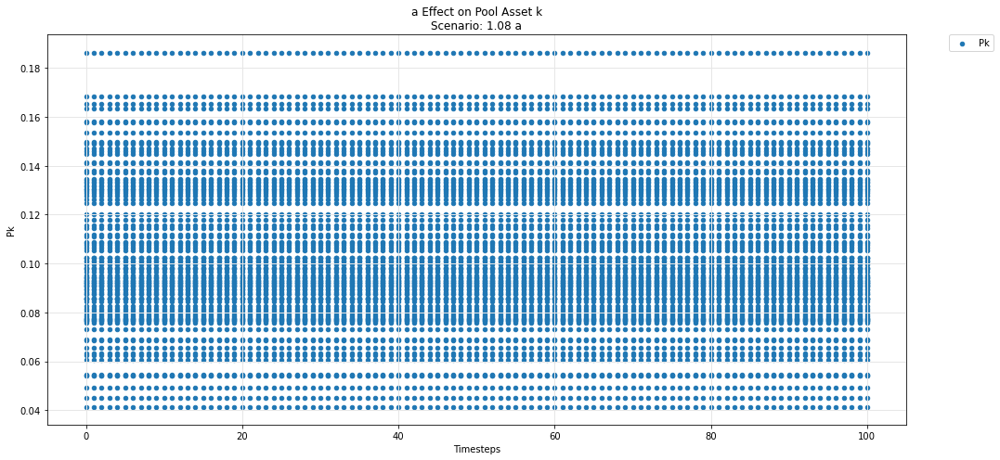

In [75]:
param_pool_plot(experiments, config_ids, 'a','k','P')